In [1]:
import pandas as pd
import datetime
import json
import pandas_datareader as pdr
import numpy as np
import matplotlib.pyplot as plt
from keras import models
from keras import layers
from keras import optimizers
from matplotlib.image import imread
from keras.preprocessing import image
from sklearn.metrics import r2_score
import seaborn as sns

Using TensorFlow backend.


### Pulling stock list from Virtus LifeSci Biotech ETF

In [2]:
stocks = ['ITCI', 'AXSM', 'CVM', 'KRTX', 'APLS', 'PRVB', 'CRTX', 'EPZM',
       'CRBP', 'CCXI', 'TGTX', 'IMGN', 'FATE', 'AKBA', 'DNLI', 'RIGL', 
       'PRNB', 'ARVN', 'ZYME', 'MRNA', 'CYTK', 'FTSV', 'ASND',
       'XBIT', 'ALEC', 'ORTX', 'ADVM', 'MGNX', 'AKRO', 'ESPR', 'BHVN',
       'YMAB', 'RGNX', 'MYOK', 'TPTX', 'ATNX', 'BLUE', 'AGEN', 'AVRO',
       'DCPH', 'CTMX', 'SRNE', 'ARDX', 'BCRX', 'RETA', 'KOD', 'DTIL',
       'RARX', 'AUTL', 'GTHX', 'CARA', 'KDMN', 'XNCR', 'ACHN', 'ARNA',
       'RCKT', 'TBIO', 'VYGR', 'SGMO', 'ODT', 'ANAB', 'ATRA', 'CNST',
       'GERN', 'BPMC', 'ALLO', 'BBIO', 'FGEN', 'PGNX', 'MGTX', 'NXTC',
       'IMMU', 'ZIOP', 'CRSP', 'IOVA', 'VKTX', 'EIDX', 'MYOV', 'AMRS',
       'KRYS', 'KURA', 'MDGL', 'UBX', 'TCDA', 'QURE', 'MRTX', 'ASMB',
       'GLYC', 'RYTM', 'FIXX', 'DRNA', 'ARWR', 'ALLK', 'GOSS', 'WVE']

In [3]:
data= {}
for stock in stocks: 

    df = pdr.get_data_yahoo(stock, start='2000-01-01')
    # Change inde to a date  string
    df['Date'] = df.index.strftime("%Y-%m-%d %H:%M:%S")
    
    data[stock] = df.to_dict('records')

### Creating the Target

In [4]:
#Next Day Max/Min Value (% Difference from Closing Price)¶
start = datetime.datetime.now()
period = [1, 2]
for stock in stocks:
    
    stock_dict_list = data[stock]
    num_days = len(stock_dict_list)
    for index, dict_ in enumerate(stock_dict_list):
        _open = dict_['Open']
        if index+period[1] >= num_days:
            _low = None
            _max = None
        else:
            _low = np.min([dict_['Low'] for dict_ in stock_dict_list[index+period[0]:index+period[1]]])/ _open -1
            _max = np.max([dict_['High'] for dict_ in stock_dict_list[index+period[0]:index+period[1]]])/ _open -1
        stock_dict_list[index]['Low_1'] = _low
        stock_dict_list[index]['Max_1'] = _max
    data[stock] = stock_dict_list

# 3 Day Max/Min Value (% Difference from Closing Price)
# The range is from the 2nd day to the 3rd after the input day
start = datetime.datetime.now()
period = [2, 4]
for stock in stocks:
    
    stock_dict_list = data[stock]
    num_days = len(stock_dict_list)
    for index, dict_ in enumerate(stock_dict_list):
        _open = dict_['Open']
        if index+period[1] >= num_days:
            _low = None
            _max = None
        else:
            _low = np.min([dict_['Low'] for dict_ in stock_dict_list[index+period[0]:index+period[1]]])/ _open -1
            _max = np.max([dict_['High'] for dict_ in stock_dict_list[index+period[0]:index+period[1]]])/ _open -1
        stock_dict_list[index]['Low_3'] = _low
        stock_dict_list[index]['Max_3'] = _max
    data[stock] = stock_dict_list

# 10 Day Max/Min Value (% Difference from Closing Price)
# The range is from the 4th day to the 10th after the input day

start = datetime.datetime.now()
period = [4, 11]
for stock in stocks:
    
    stock_dict_list = data[stock]
    num_days = len(stock_dict_list)
    for index, dict_ in enumerate(stock_dict_list):
        _open = dict_['Open']
        if index+period[1] >= num_days:
            _low = None
            _max = None
        else:
            _low = np.min([dict_['Low'] for dict_ in stock_dict_list[index+period[0]:index+period[1]]])/ _open -1
            _max = np.max([dict_['High'] for dict_ in stock_dict_list[index+period[0]:index+period[1]]])/ _open -1
        stock_dict_list[index]['Low_10'] = _low
        stock_dict_list[index]['Max_10'] = _max
    data[stock] = stock_dict_list

# 30 Day Max/Min Value (% Difference from Closing Price)
# The range is from the 11th day to the 30th after the input day
start = datetime.datetime.now()
period = [11, 31]
for stock in stocks:
    
    stock_dict_list = data[stock]
    num_days = len(stock_dict_list)
    for index, dict_ in enumerate(stock_dict_list):
        _open = dict_['Open']
        if index+period[1] >= num_days:
            _low = None
            _max = None
        else:
            _low = np.min([dict_['Low'] for dict_ in stock_dict_list[index+period[0]:index+period[1]]])/ _open -1
            _max = np.max([dict_['High'] for dict_ in stock_dict_list[index+period[0]:index+period[1]]])/ _open -1
        stock_dict_list[index]['Low_30'] = _low
        stock_dict_list[index]['Max_30'] = _max
    data[stock] = stock_dict_list

#### Scaling Input

In [5]:
low_bins = [-(i )/100 for i in range(0, 11)]
low_bins = sorted(low_bins)
high_bins = [(i)/100 for i in range(0, 11)]
high_bins = sorted(high_bins)
low_columns = ['Low_1', 'Low_3', 'Low_10', 'Low_30']
high_columns = ['Max_1',  'Max_3',  'Max_10', 'Max_30'] 
for stock in stocks:
    df = pd.DataFrame(data[stock])
    max_value = df[['High', 'Low', 'Open', 'Close', 'Adj Close']].max()
    min_value = df[['High', 'Low', 'Open', 'Close', 'Adj Close']].min()
    df[['High', 'Low', 'Open', 'Close', 'Adj Close']] = (df[['High', 'Low', 'Open', 'Close', 'Adj Close']]- min_value)/max_value
    df['Volume'] = (df['Volume']- df['Volume'].min())/ df['Volume'].max()

    
    
    for column in low_columns:
        low_array = df[column]
        df[column+'_under_bin'] = (low_array < low_bins[0])*1
        df[column+'_over_bin'] = (low_array >= low_bins[-1])*1
        for i in low_bins:
            df[column+'_'+str(i)] = (low_array<i+ 0.5) & (low_array>= i- 0.5)

           
    for column in high_columns:
        high_array = df[column]
        df[column+'_under_bin'] = (high_array < high_bins[0])*1
        df[column+'_over_bin'] = (high_array >= high_bins[-1])*1
        for i in high_bins:
            df[column+'_'+str(i)] = (high_array<i+ 0.5) & (high_array>= i- 0.5)
    
    
    df= df.dropna()
    data[stock] = df.to_dict('records')

#### Check scaling

In [6]:
data_in_list = []
for stock in stocks:
    stock_dict_list = data[stock]
    for index, dict_ in enumerate(stock_dict_list):
        dict_['Ticker'] = stock
        data_in_list.append(dict_)
df = pd.DataFrame(data_in_list) 
df.describe()

,Adj Close,Close,High,Low,Low_1,Low_10,Low_10_over_bin,Low_10_under_bin,Low_1_over_bin,Low_1_under_bin,...,Max_1_over_bin,Max_1_under_bin,Max_3,Max_30,Max_30_over_bin,Max_30_under_bin,Max_3_over_bin,Max_3_under_bin,Open,Volume
count,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,...,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000,145438.000000
mean,0.189672,0.189672,0.186928,0.192219,14.659278,-0.001624,0.217185,0.380375,0.271738,0.086154,...,0.101892,0.248374,25.653894,60.194856,0.572065,0.199301,0.199576,0.246174,0.188944,0.024762
std,0.189075,0.189075,0.187702,0.189880,242.069864,18.163335,0.412331,0.485481,0.444857,0.280592,...,0.302508,0.432071,330.879056,675.282457,0.494781,0.399476,0.399683,0.430782,0.188319,0.050746
min,0.000000,0.000000,0.000000,0.000000,-0.999869,-0.999948,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,-0.999875,-0.951601,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.045974,0.045974,0.044807,0.047558,-0.056452,-0.140787,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.017806,0.000000,0.000000,0.000000,0.000000,0.046205,0.002387
50%,0.124083,0.124083,0.121645,0.127311,-0.025339,-0.070048,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.033202,0.135802,1.000000,0.000000,0.000000,0.000000,0.123800,0.010373
75%,0.279529,0.279529,0.274769,0.281744,0.000000,-0.010824,0.000000,1.000000,1.000000,0.000000,...,0.000000,0.000000,0.083731,0.308539,1.000000,0.000000,0.000000,0.000000,0.278356,0.028962
max,0.999998,0.999998,0.999997,0.999998,6817.181855,3998.999810,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,29665.666409,38399.000858,1.000000,1.000000,1.000000,1.000000,0.999997,1.000000


#### Scaling High, Low, Open, Close and droping Adj Close

In [7]:
processed_data = {}

for stock in stocks:
    x = []
    target = []
    dict_ = {}
    for i in data[stock]:
        row =np.array([i['High'], i['Low'], i['Open'], i['Close'], i['Adj Close'], i['Volume']])
        x.append(row)
        row = np.array(i['Low_1'])
        target.append(row)
    length_ = (len(x)//25)*25
    dict_['Data'] = x[:length_]
    dict_['Target'] = target[:length_]
    processed_data[stock] = dict_

In [8]:
for stock in stocks:
    length_ = len(processed_data[stock]['Data'])
    length_test = len(processed_data[stock]['Data'])//8
    test_start = length_- 50
    test_end = length_test+ test_start
    processed_data[stock]['data_1'] = np.array(processed_data[stock]['Data'][:test_start])
    processed_data[stock]['data_1'] =   processed_data[stock]['data_1'].reshape(len(processed_data[stock]['data_1']), 1, 6)
    processed_data[stock]['data_test'] = np.array(processed_data[stock]['Data'][test_start:])
    processed_data[stock]['data_test'] = processed_data[stock]['data_test'].reshape(len(processed_data[stock]['data_test']),1,6)
    transfer_list = np.array(processed_data[stock]['Target'][:test_start])
    processed_data[stock]['target_1'] =transfer_list.reshape(len(transfer_list), 1)
    transfer_list = np.array(processed_data[stock]['Target'][test_start:])
    processed_data[stock]['target_test'] = transfer_list.reshape(len(transfer_list),1)

In [9]:
model = models.Sequential()
model.add(layers.GRU(50, return_sequences=True, batch_input_shape=(25, 1,6), stateful= True))
model.add(layers.Dropout(0.2))
model.add(layers.GRU(100, return_sequences=True, stateful= True))
model.add(layers.Dropout(0.2))
model.add(layers.GRU(100, return_sequences=False))
model.add(layers.Dropout(0.2))
model.add(layers.Dense(1, activation = "linear"))
model.compile(loss='mse', optimizer='adam')


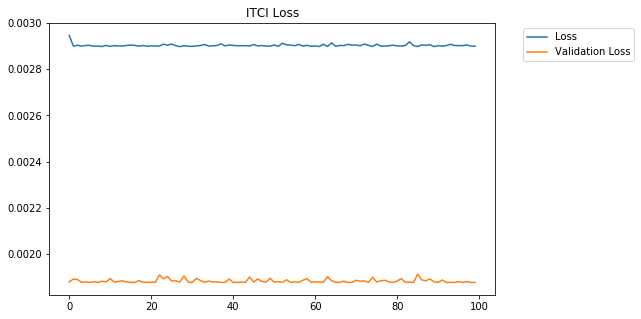

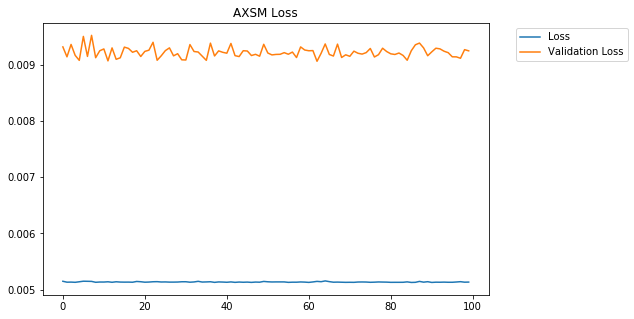

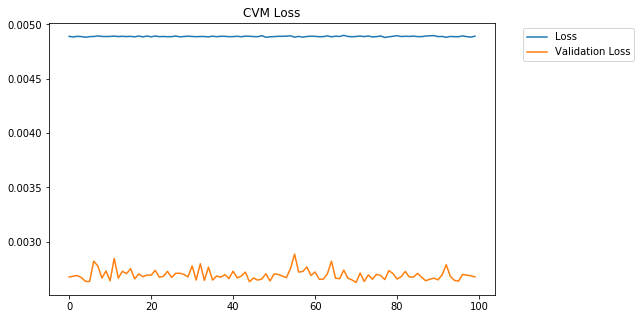

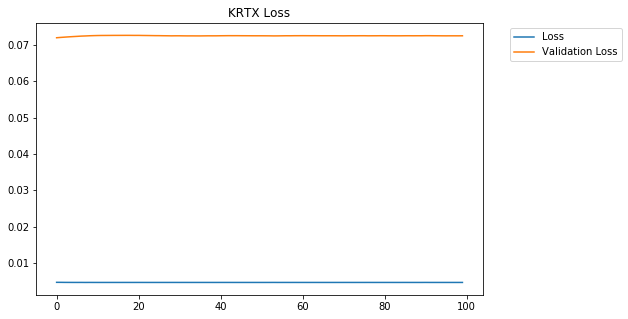

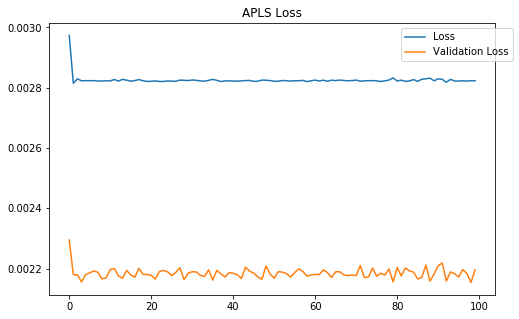

...

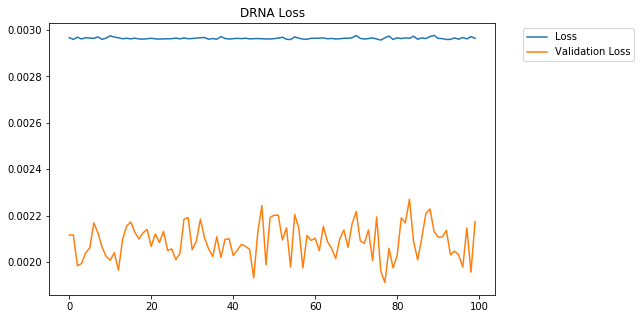

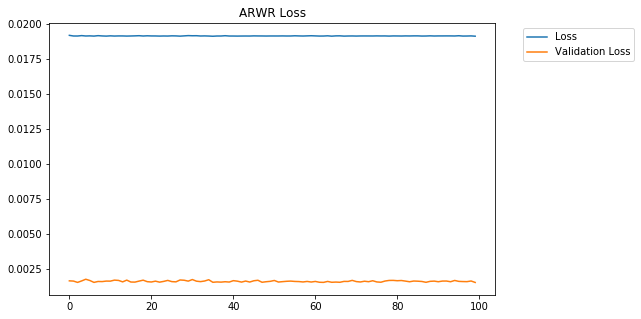

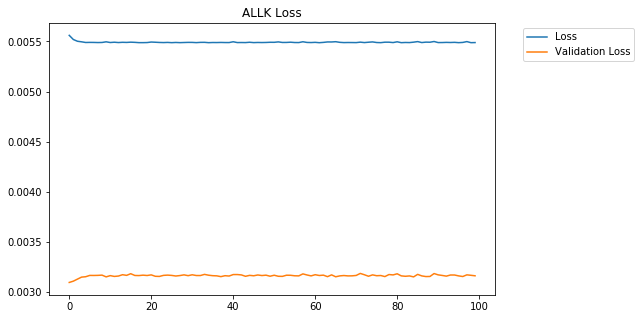

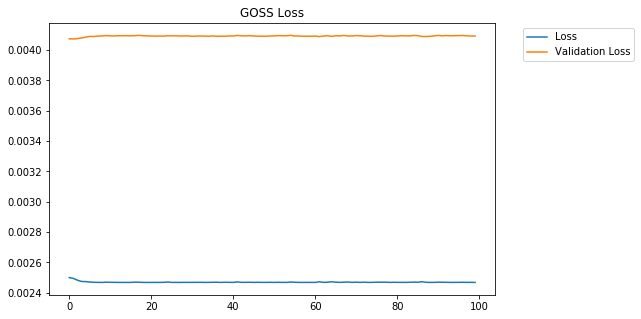

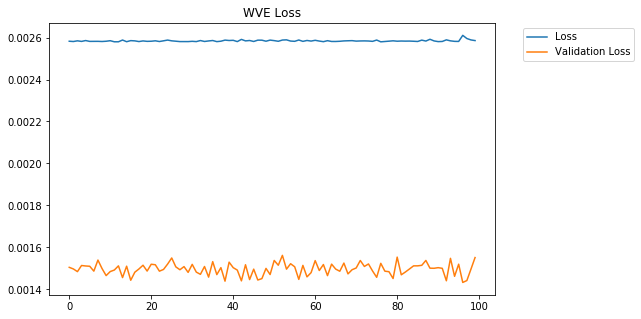

In [18]:
for stock in stocks:

    (feature_train, label_train, feature_test, label_test) = (processed_data[stock]['data_1'],processed_data[stock]['target_1'], 
                                                            processed_data[stock]['data_test'], processed_data[stock]['target_test']) 
    model.fit(feature_train, label_train, batch_size=25, epochs=100, validation_data = (feature_test, label_test), verbose=0)
    dict_ = model.history.history
    plt.figure(figsize=(8,5))
    plt.title(f"{stock} Loss")
    plt.plot(dict_['loss'], label = 'Loss')
    plt.plot(dict_['val_loss'], label= 'Validation Loss')
    plt.legend(bbox_to_anchor=(1.05, 1))
    plt.show()


Train on 4900 samples, validate on 50 samples
Epoch 1/1000
4900/4900 [==============================] - 1s 197us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 2/1000
4900/4900 [==============================] - 1s 212us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 3/1000
4900/4900 [==============================] - 1s 183us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 4/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 5/1000
4900/4900 [==============================] - 1s 224us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 6/1000
4900/4900 [==============================] - 1s 207us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 7/1000
4900/4900 [==============================] - 1s 210us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 8/1000
4900/4900 [==============================] - 1s 201us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 9/1000
4900/4900 [==============================] - 1s 190us/step - loss: 0.0036 - val_loss: 0.0022


Epoch 77/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 78/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 79/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 80/1000
4900/4900 [==============================] - 1s 181us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 81/1000
4900/4900 [==============================] - 1s 178us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 82/1000
4900/4900 [==============================] - 1s 178us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 83/1000
4900/4900 [==============================] - 1s 178us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 84/1000
4900/4900 [==============================] - 1s 180us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 85/1000
4900/4900 [==============================] - 1s 178us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 86/1000
4900/4900 [============

4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 154/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 155/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 156/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 157/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 158/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 159/1000
4900/4900 [==============================] - 1s 184us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 160/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 161/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 162/1000
4900/4900 [=================

Epoch 229/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 230/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 231/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 232/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 233/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 234/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 235/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 236/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 237/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 238/1000
4900/4900 [==

4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 305/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 306/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 307/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 308/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 309/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 310/1000
4900/4900 [==============================] - ETA: 0s - loss: 0.003 - 1s 174us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 311/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 312/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 313/1000
4900

Epoch 380/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 381/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 382/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 383/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 384/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 385/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 386/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 387/1000
4900/4900 [==============================] - 1s 178us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 388/1000
4900/4900 [==============================] - 1s 179us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 389/1000
4900/4900 [==

4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 456/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 457/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 458/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 459/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 460/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 461/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 462/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 463/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 464/1000
4900/4900 [=================

4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 531/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 532/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 533/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 534/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 535/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 536/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 537/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 538/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 539/1000
4900/4900 [=================

Epoch 606/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 607/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 608/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 609/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 610/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 611/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 612/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 613/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 614/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 615/1000
4900/4900 [==

4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 682/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 683/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 684/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 685/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 686/1000
4900/4900 [==============================] - 1s 187us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 687/1000
4900/4900 [==============================] - 1s 180us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 688/1000
4900/4900 [==============================] - 1s 182us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 689/1000
4900/4900 [==============================] - 1s 187us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 690/1000
4900/4900 [=================

Epoch 757/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 758/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 759/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 760/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 761/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 762/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 763/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 764/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 765/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 766/1000
4900/4900 [==

4900/4900 [==============================] - 1s 198us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 833/1000
4900/4900 [==============================] - 1s 183us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 834/1000
4900/4900 [==============================] - 1s 224us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 835/1000
4900/4900 [==============================] - 1s 212us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 836/1000
4900/4900 [==============================] - 1s 178us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 837/1000
4900/4900 [==============================] - 1s 197us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 838/1000
4900/4900 [==============================] - 1s 205us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 839/1000
4900/4900 [==============================] - 1s 177us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 840/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 841/1000
4900/4900 [=================

Epoch 908/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 909/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 910/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 911/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 912/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 913/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 914/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 915/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 916/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 917/1000
4900/4900 [==

Epoch 984/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 985/1000
4900/4900 [==============================] - 1s 176us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 986/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 987/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 988/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 989/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 990/1000
4900/4900 [==============================] - 1s 175us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 991/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 992/1000
4900/4900 [==============================] - 1s 174us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 993/1000
4900/4900 [==

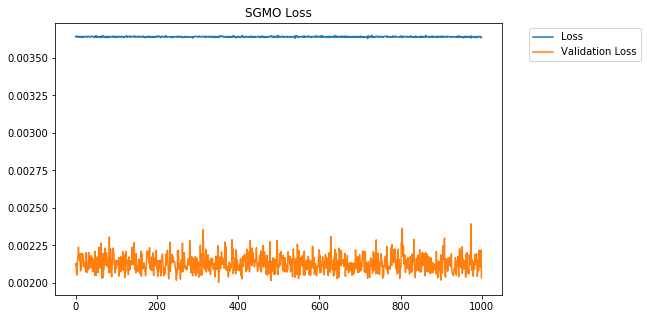

In [19]:

stock = 'SGMO'
(feature_train, label_train, feature_test, label_test) = (processed_data[stock]['data_1'],processed_data[stock]['target_1'], 
                                                                    processed_data[stock]['data_test'], processed_data[stock]['target_test']) 
model.fit(feature_train, label_train, batch_size=25, epochs=1000, validation_data = (feature_test, label_test))
dict_ = model.history.history
plt.figure(figsize=(8,5))
plt.title(f"{stock} Loss")
plt.plot(dict_['loss'], label = 'Loss')
plt.plot(dict_['val_loss'], label= 'Validation Loss')
plt.legend(bbox_to_anchor=(1.05, 1))
plt.show()
model.save('model_stateful.h5')

SGMO -586443465114160.9 -1054992863776479.9


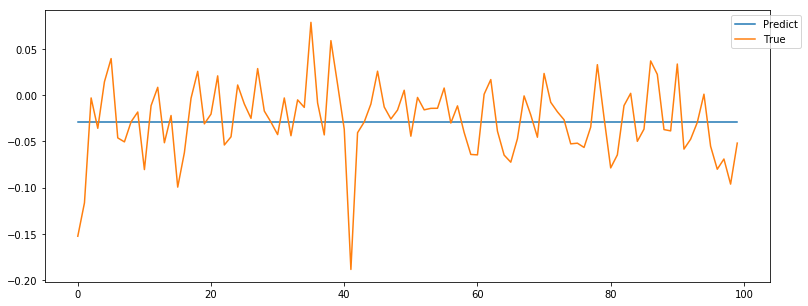

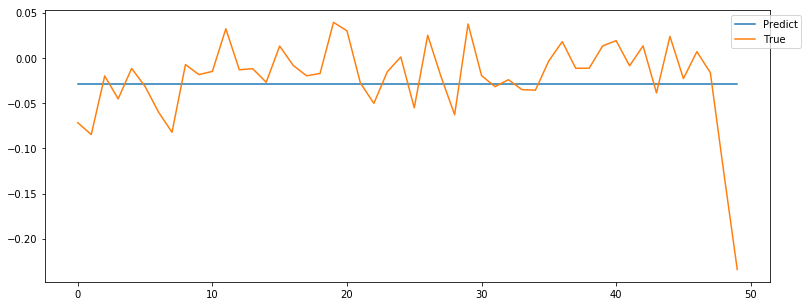

In [20]:
predict_train = model.predict(feature_train, batch_size=25)
predict_test = model.predict(feature_test, batch_size=25)
print(stock,r2_score(predict_test, label_test), r2_score(predict_train, label_train))
plt.figure(figsize=(13,5))
plt.plot(predict_train[-100:], label = 'Predict')
plt.plot(label_train[-100:], label= 'True')
plt.legend(bbox_to_anchor=(1.05, 1))
plt.show()

plt.figure(figsize=(13,5))
plt.plot(predict_test[-100:], label = 'Predict')
plt.plot(label_test[-100:], label= 'True')
plt.legend(bbox_to_anchor=(1.05, 1))
plt.show()

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


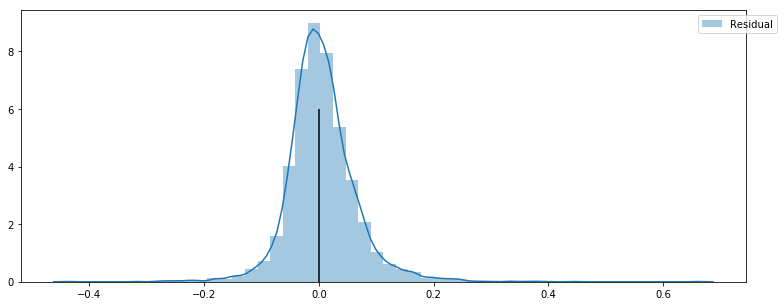

In [21]:
plt.figure(figsize=(13,5))
sns.distplot(predict_train- label_train, label = 'Residual')
plt.vlines(0,0,6)
plt.legend(bbox_to_anchor=(1.05, 1))       
plt.show()

ITCI -0.019850172347994022 -0.007318031181849927


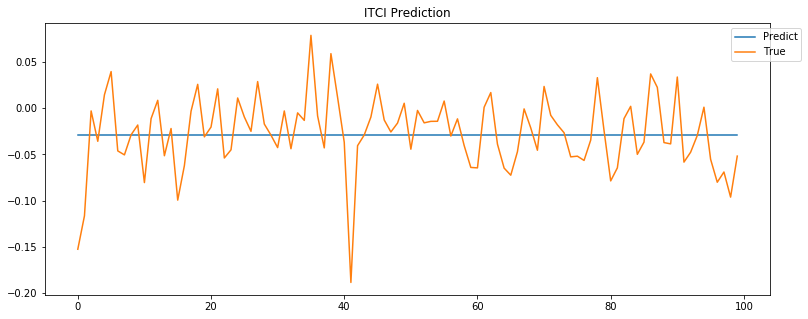

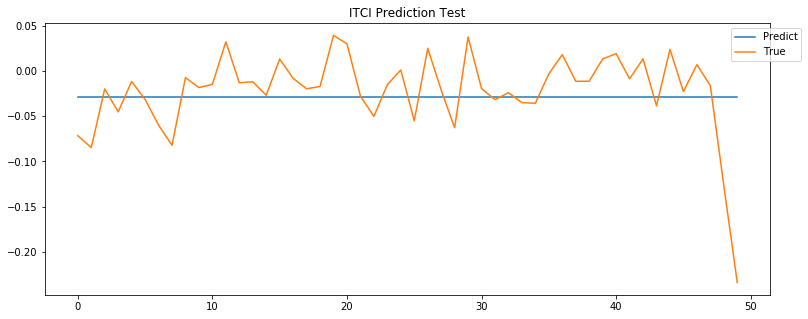

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


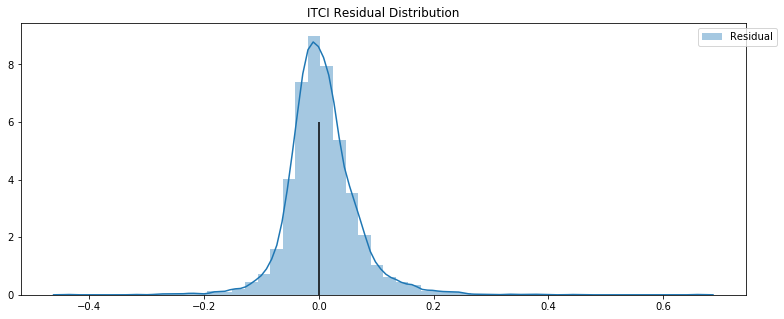

AXSM -0.019850172347994022 -0.007318031181849927


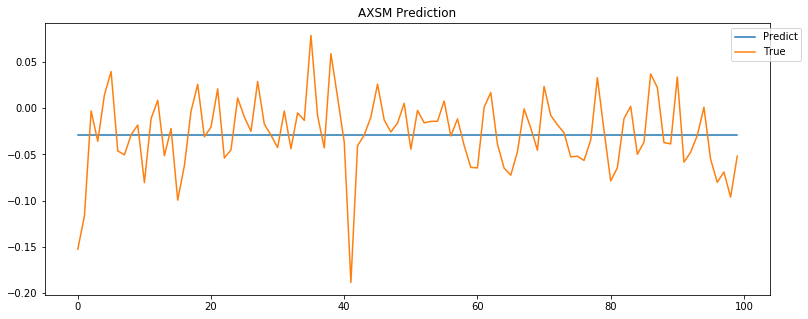

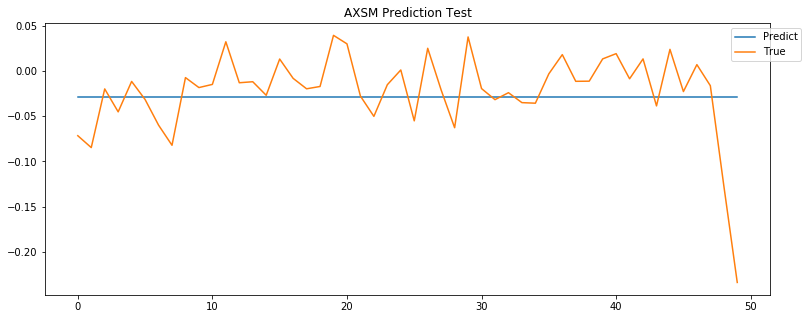

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


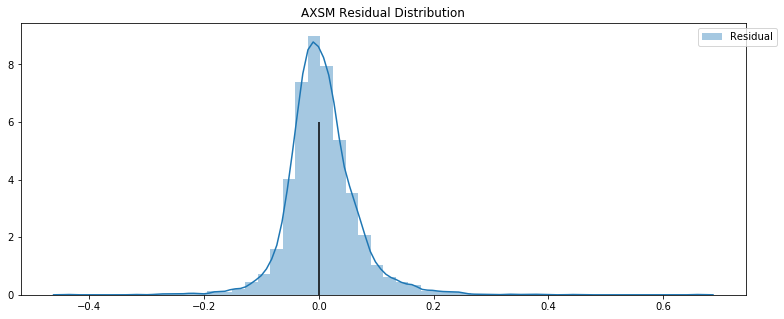

CVM -0.019850172347994022 -0.007318031181849927


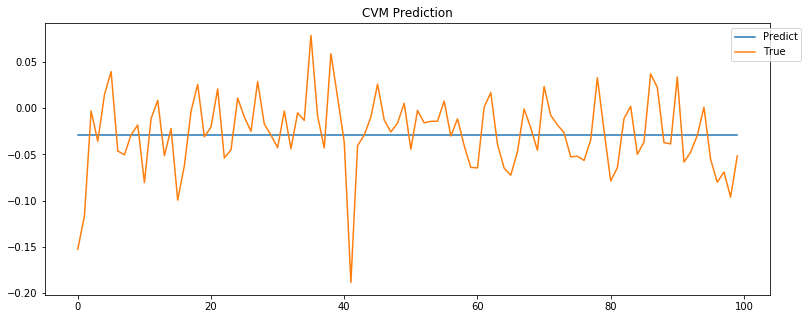

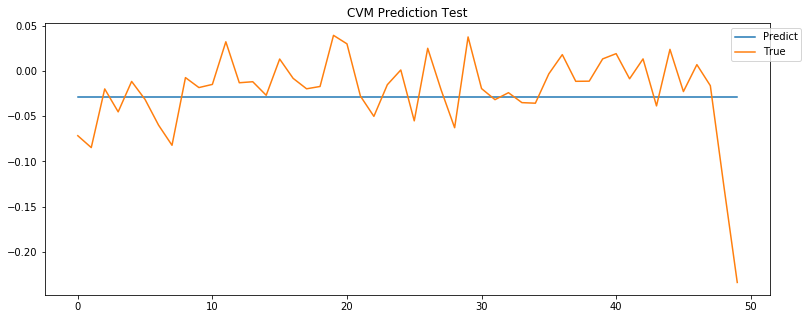

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


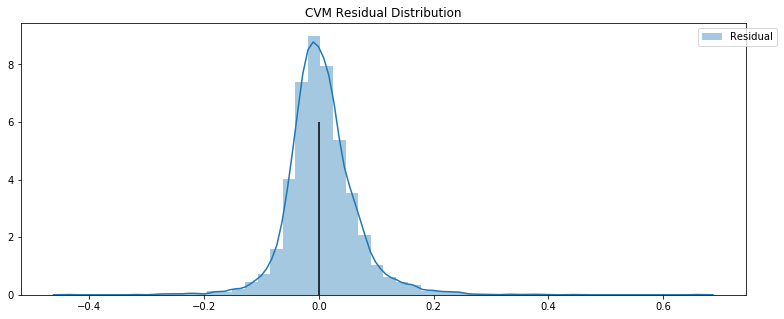

KRTX -0.019850172347994022 -0.007318031181849927


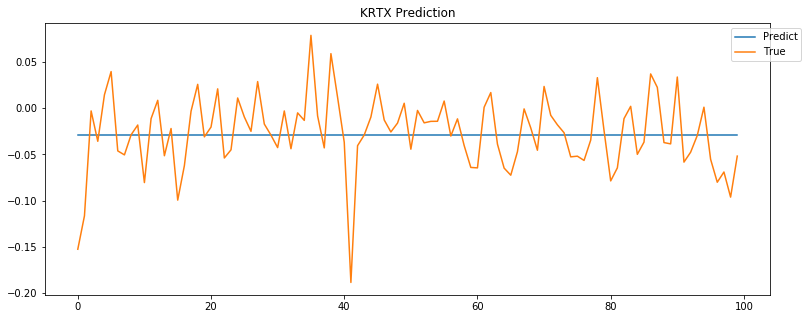

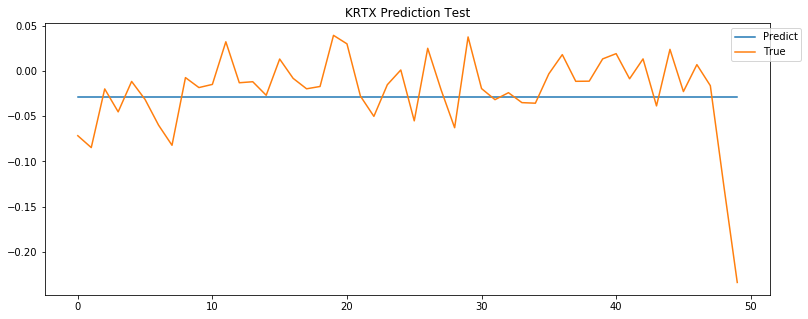

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


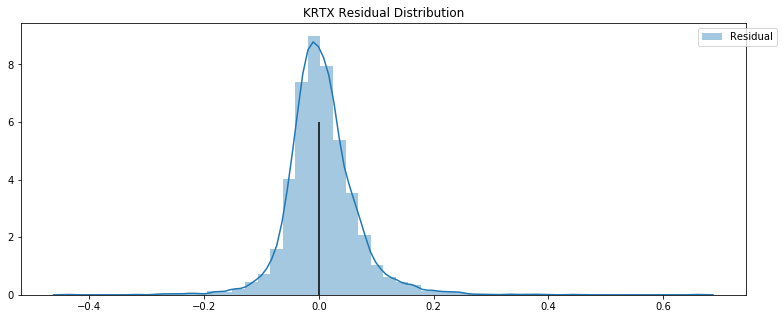

APLS -0.019850172347994022 -0.007318031181849927


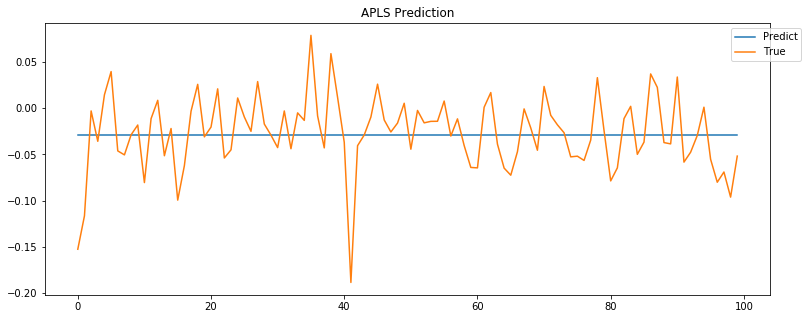

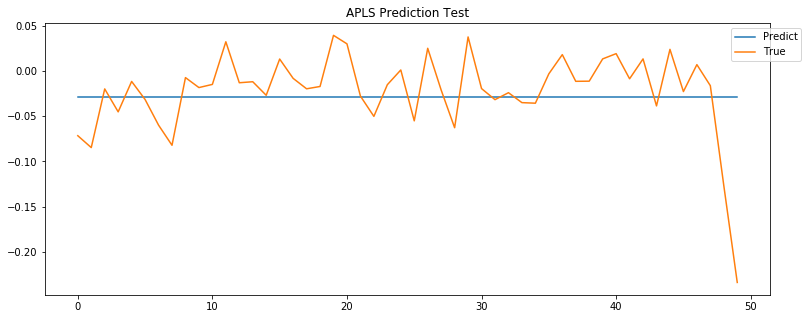

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


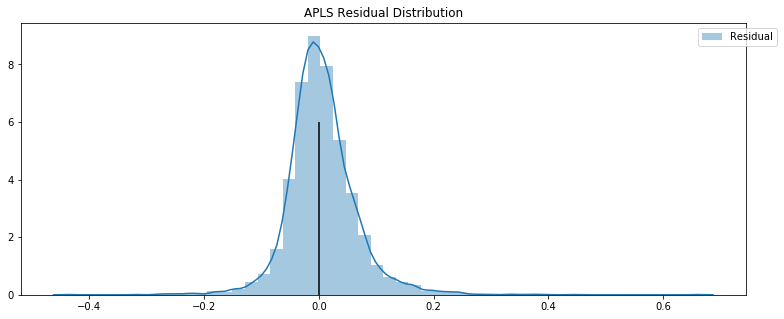

PRVB -0.019850172347994022 -0.007318031181849927


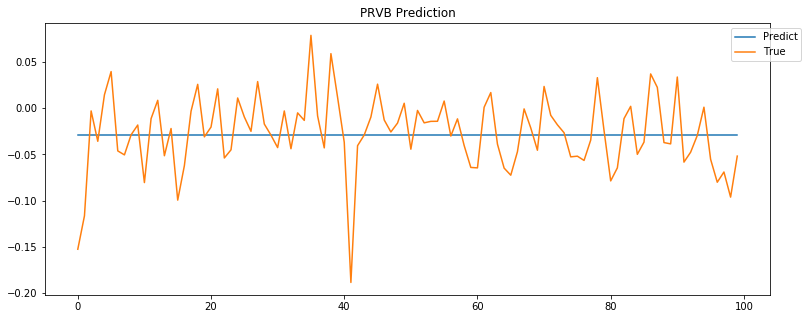

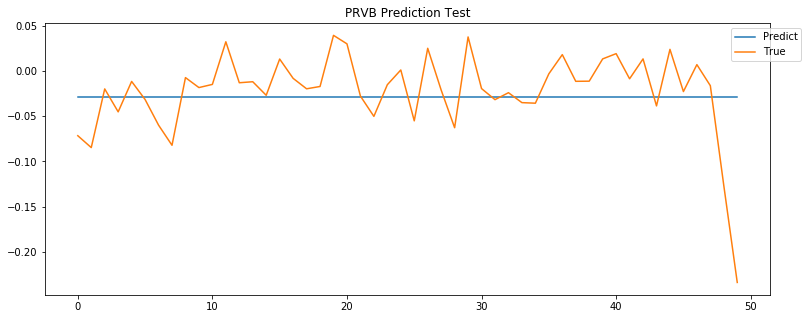

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


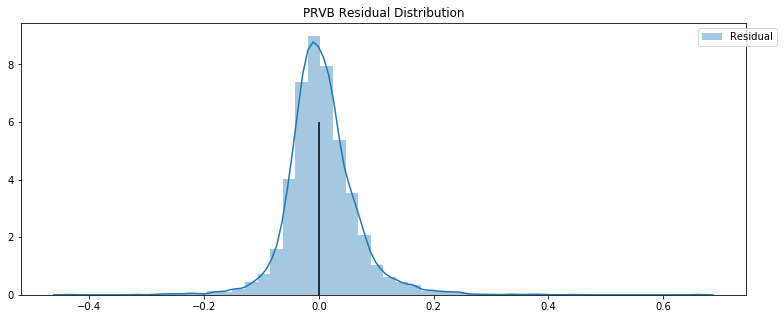

CRTX -0.019850172347994022 -0.007318031181849927


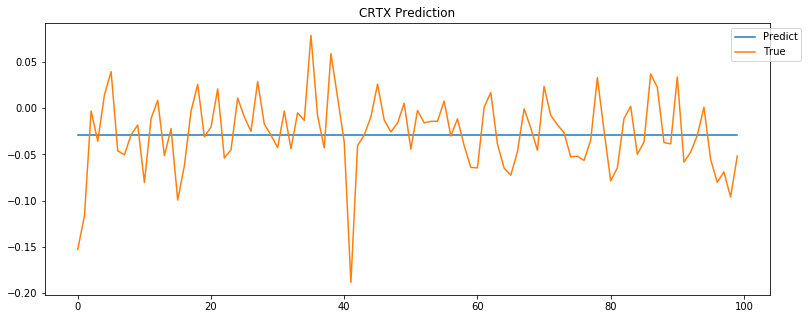

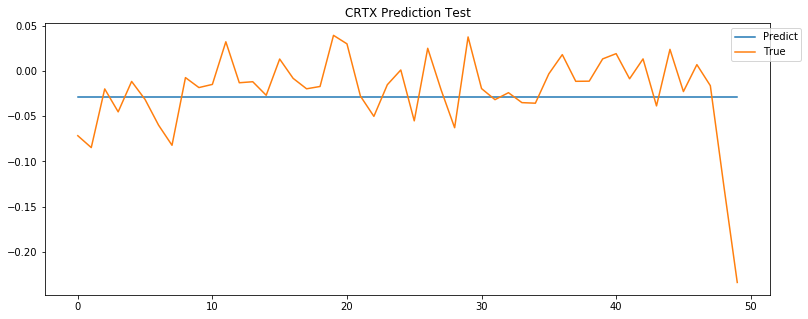

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


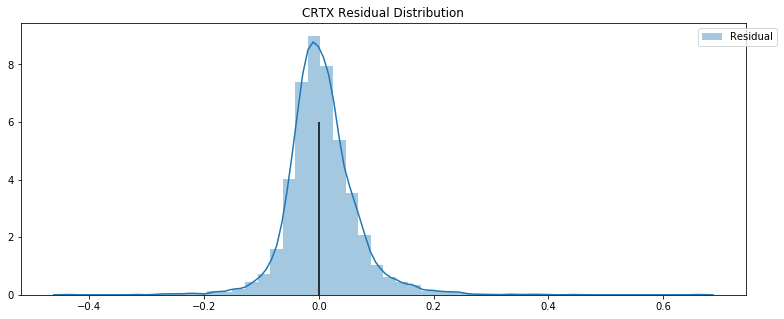

EPZM -0.019850172347994022 -0.007318031181849927


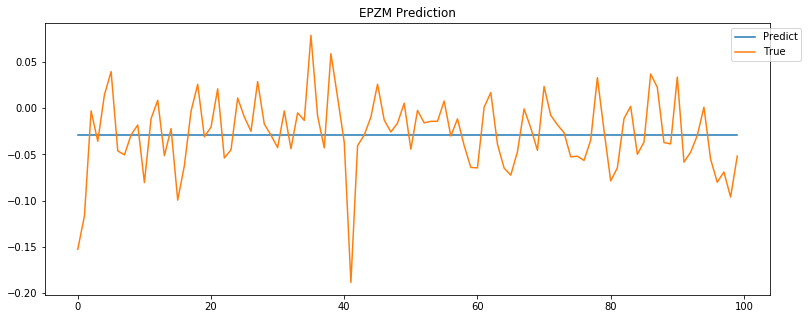

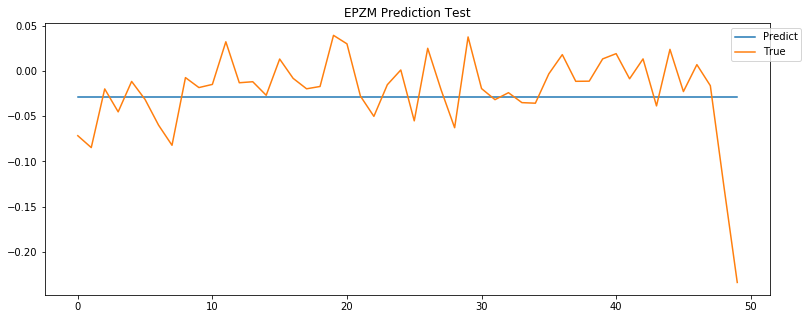

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


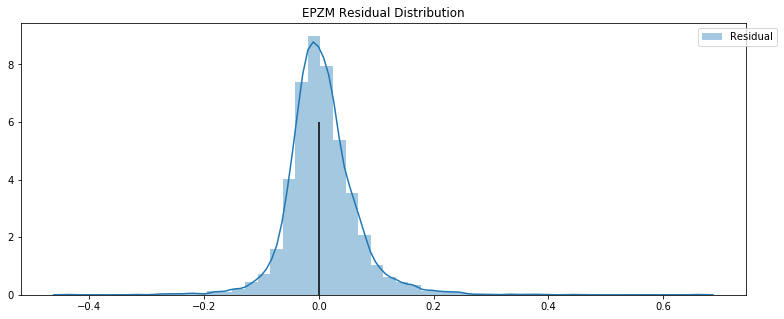

CRBP -0.019850172347994022 -0.007318031181849927


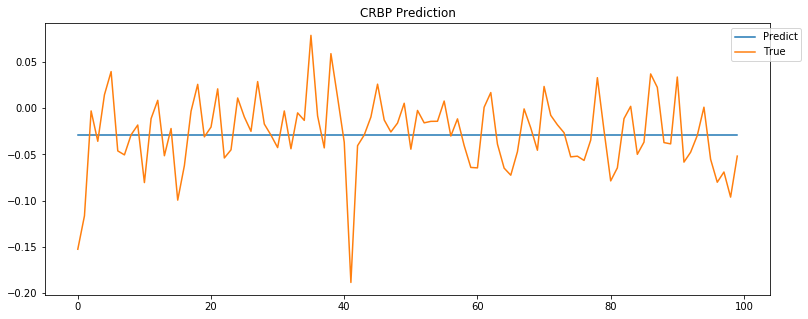

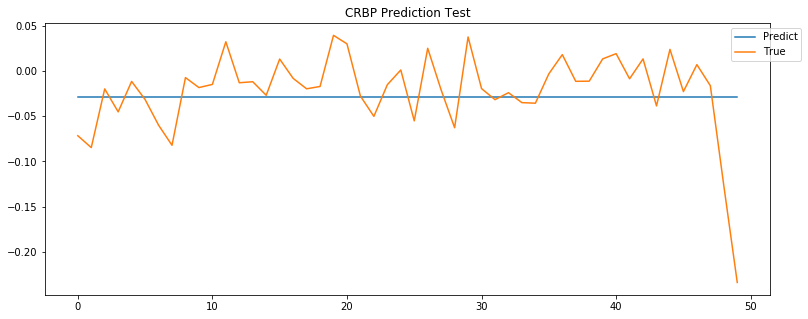

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


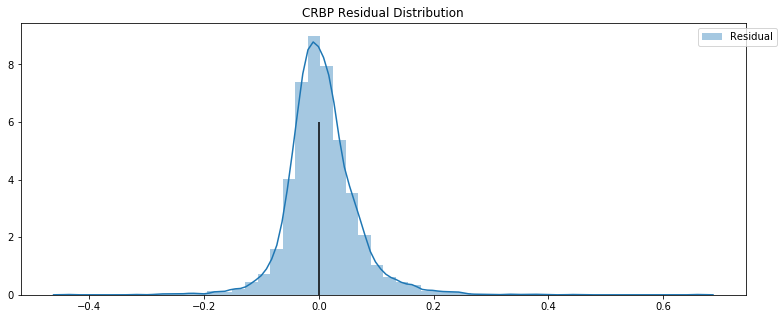

CCXI -0.019850172347994022 -0.007318031181849927


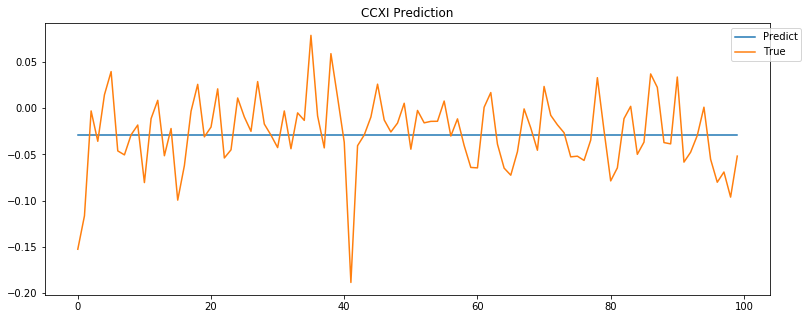

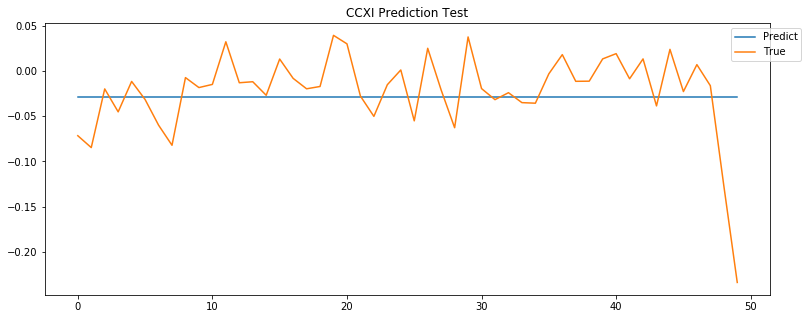

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


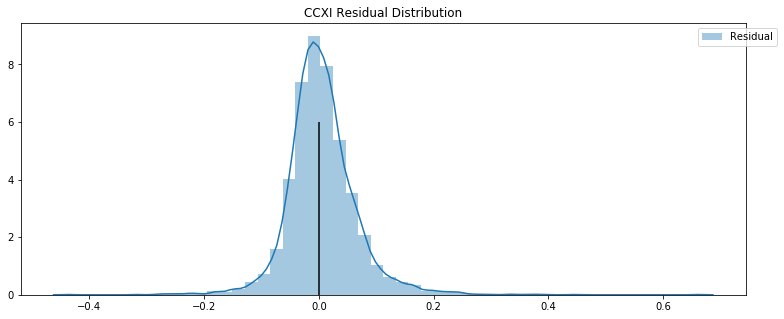

TGTX -0.019850172347994022 -0.007318031181849927


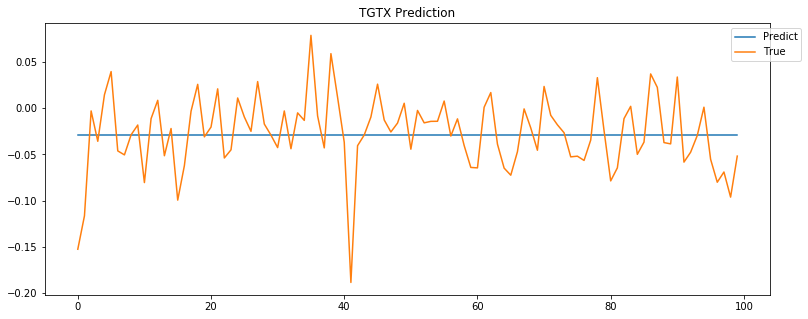

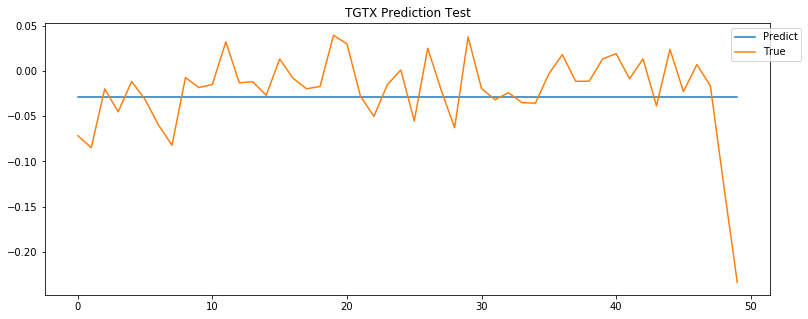

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


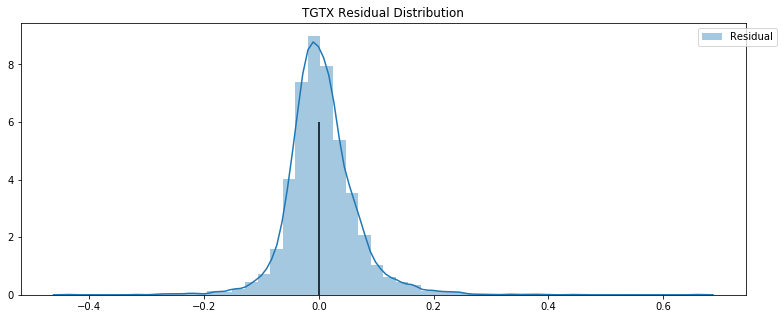

IMGN -0.019850172347994022 -0.007318031181849927


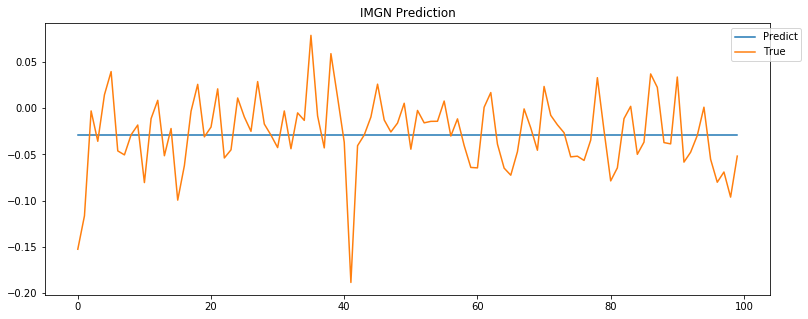

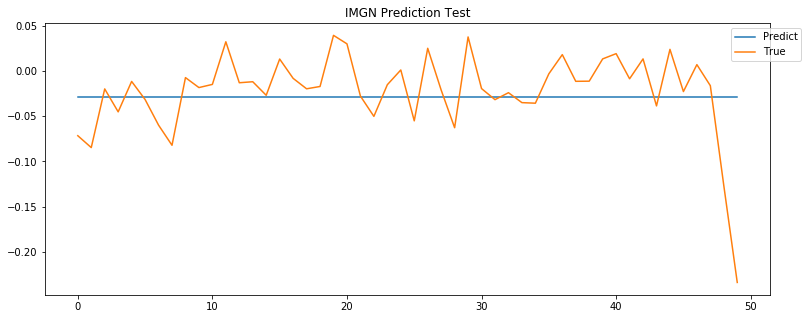

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


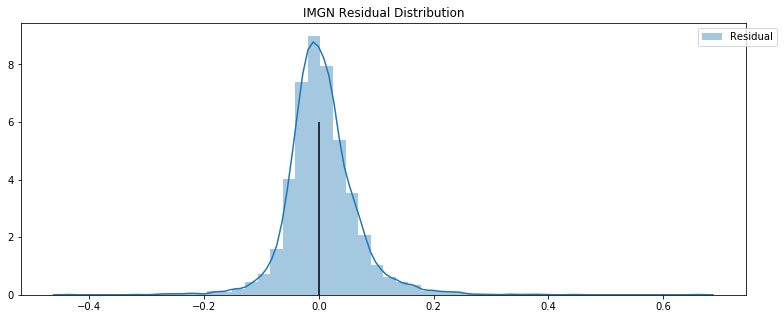

FATE -0.019850172347994022 -0.007318031181849927


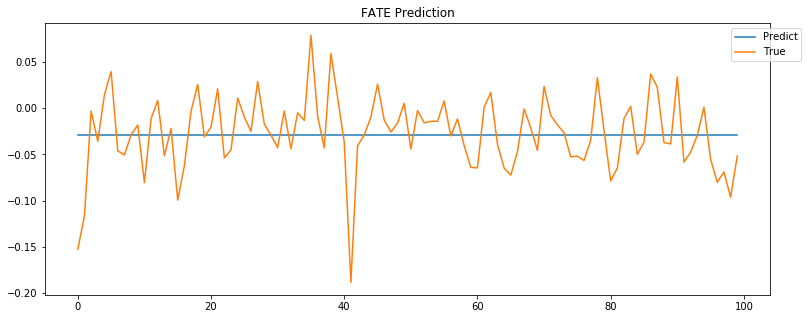

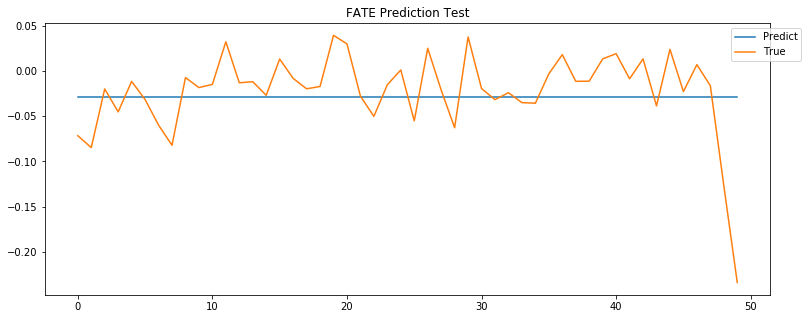

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


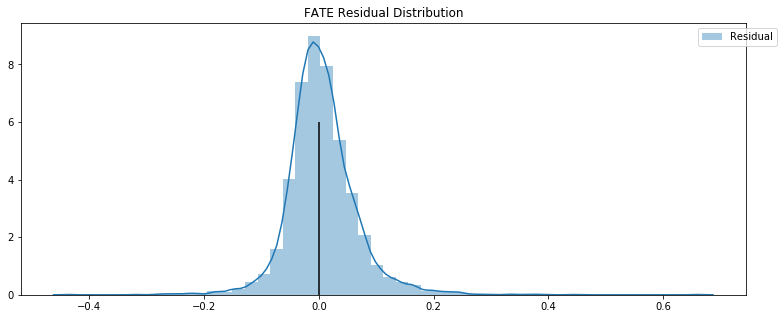

AKBA -0.019850172347994022 -0.007318031181849927


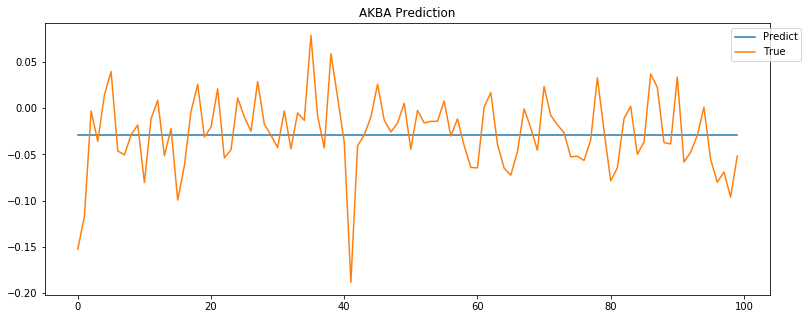

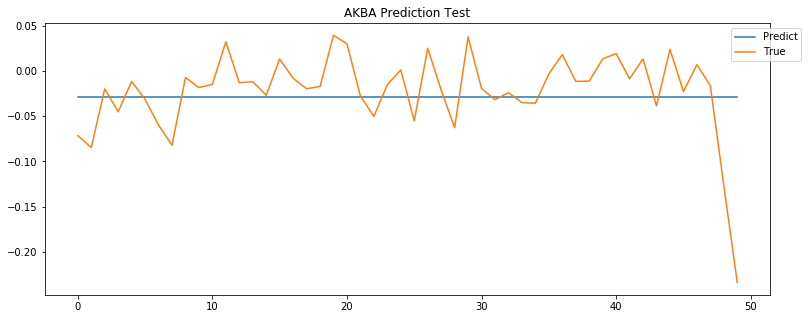

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


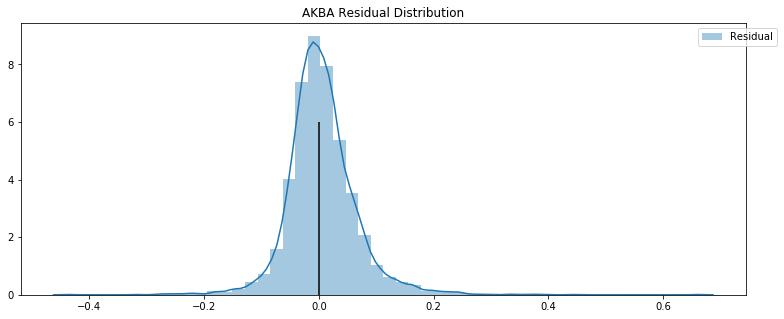

DNLI -0.019850172347994022 -0.007318031181849927


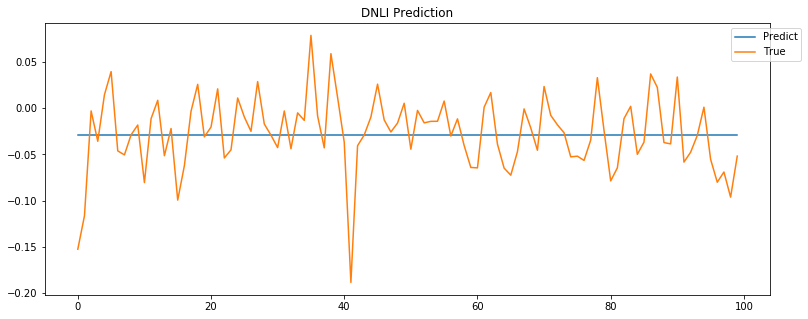

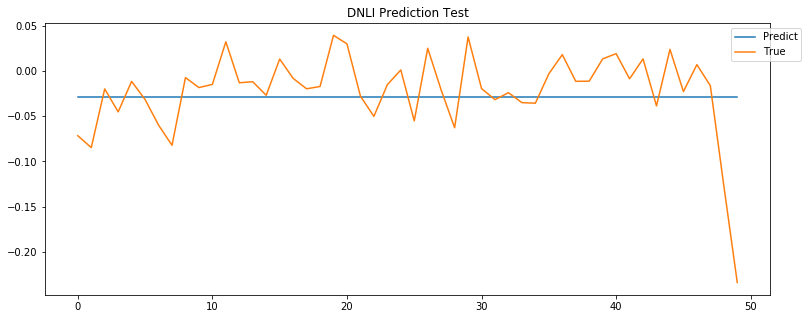

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


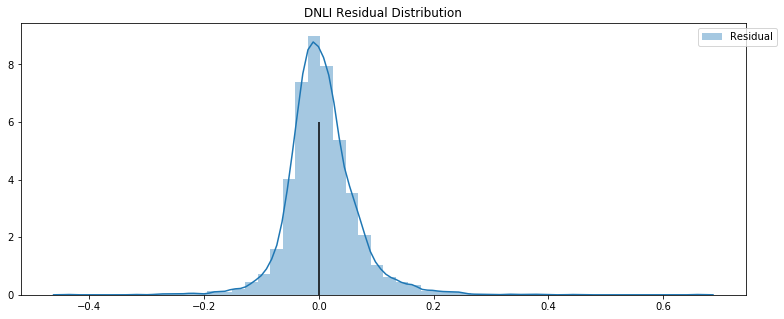

RIGL -0.019850172347994022 -0.007318031181849927


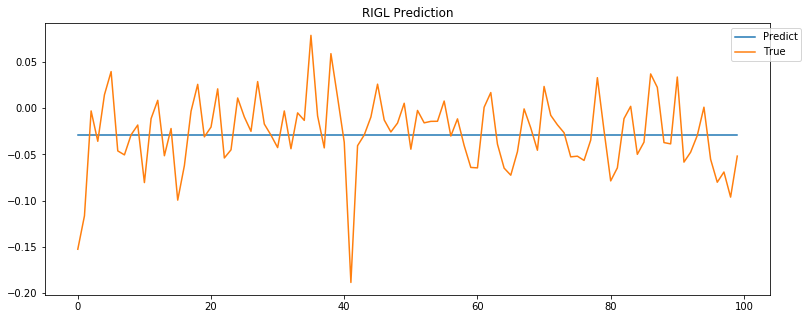

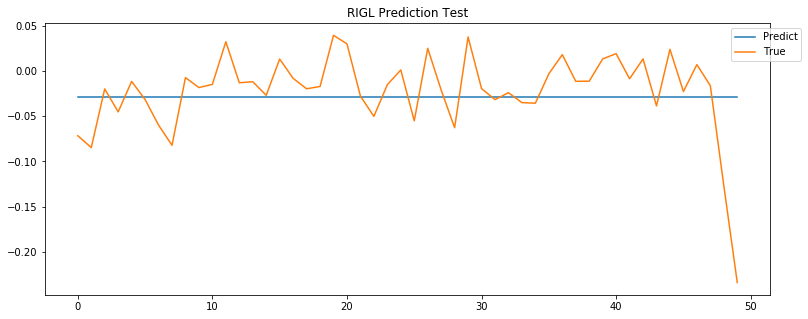

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


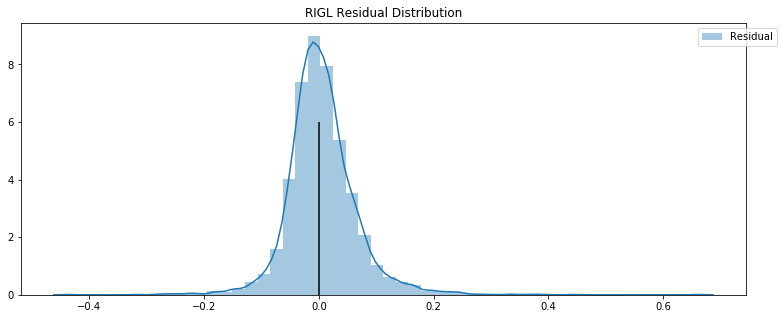

PRNB -0.019850172347994022 -0.007318031181849927


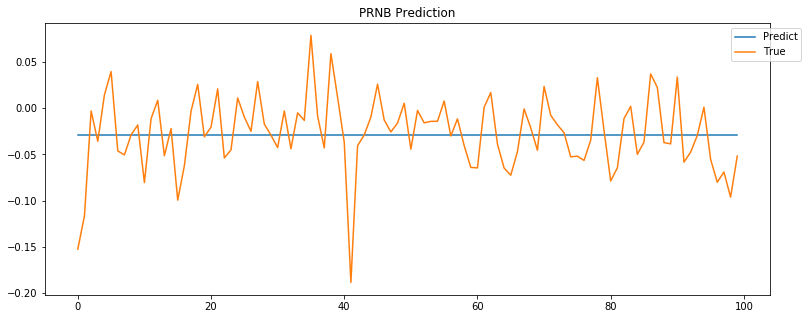

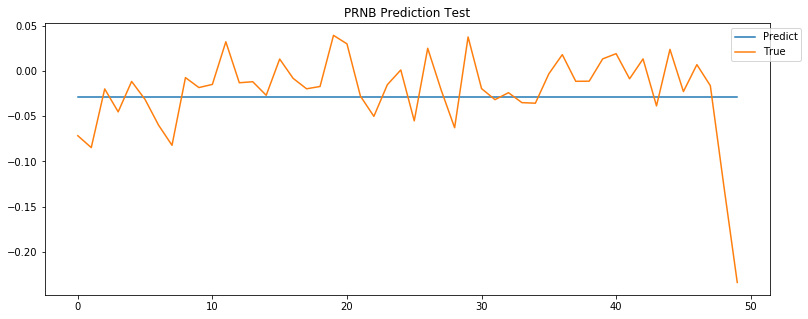

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


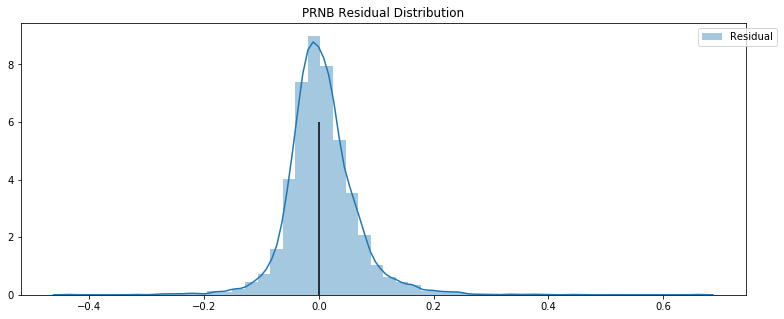

ARVN -0.019850172347994022 -0.007318031181849927


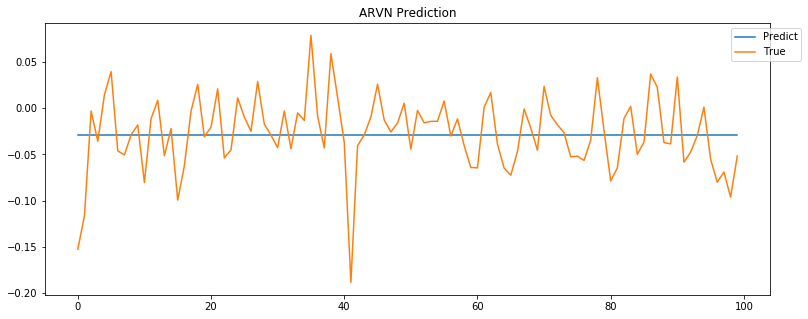

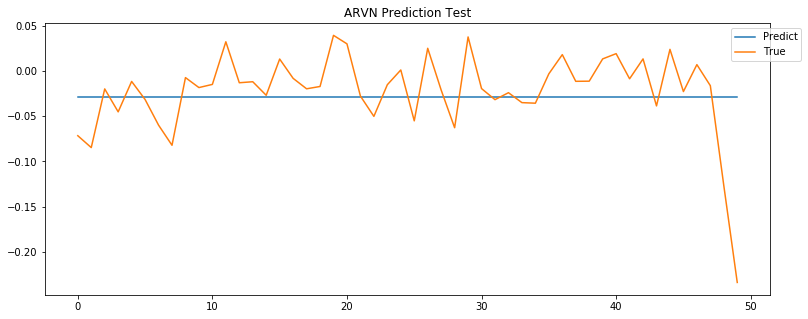

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


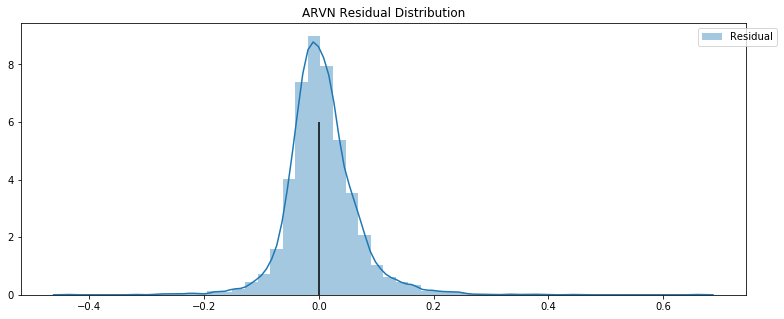

ZYME -0.019850172347994022 -0.007318031181849927


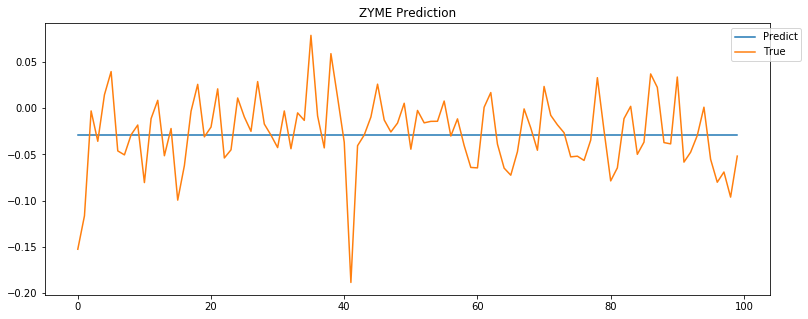

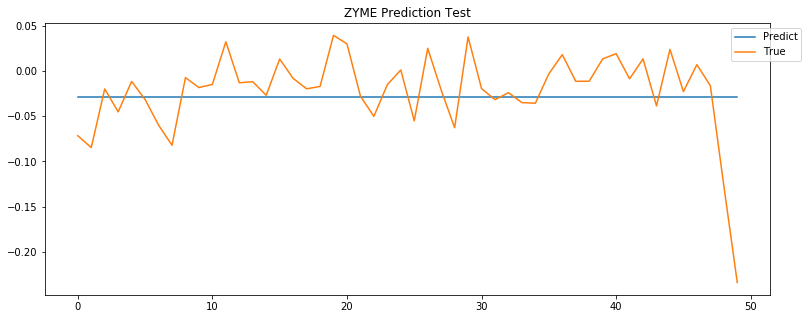

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


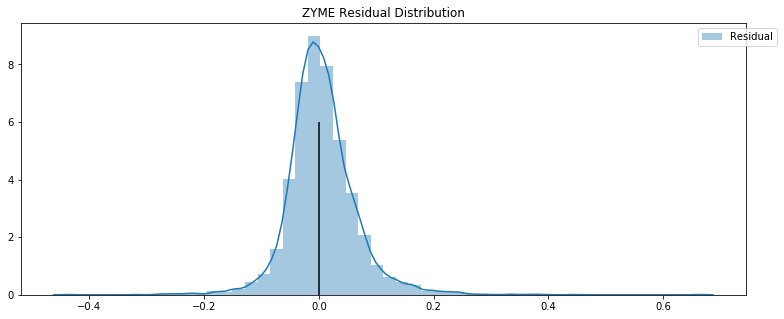

MRNA -0.019850172347994022 -0.007318031181849927


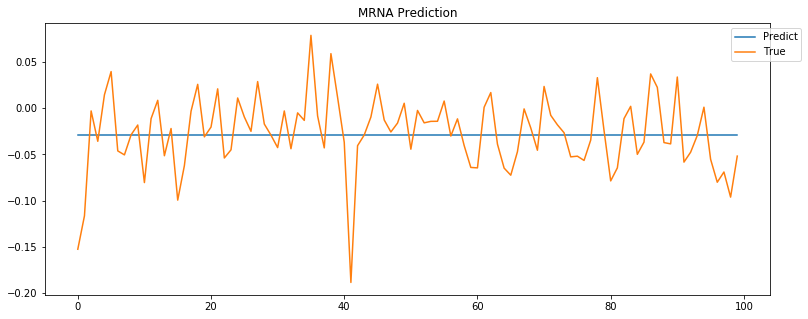

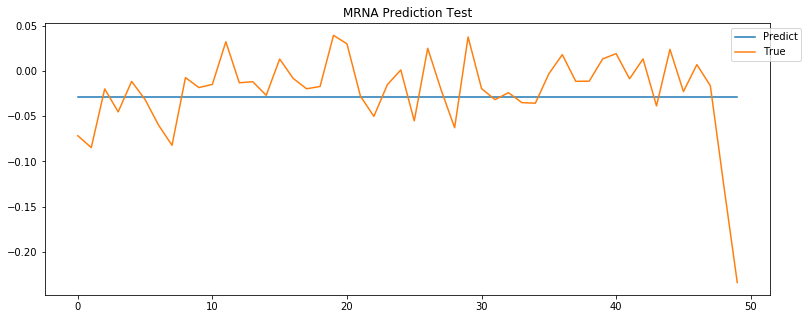

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


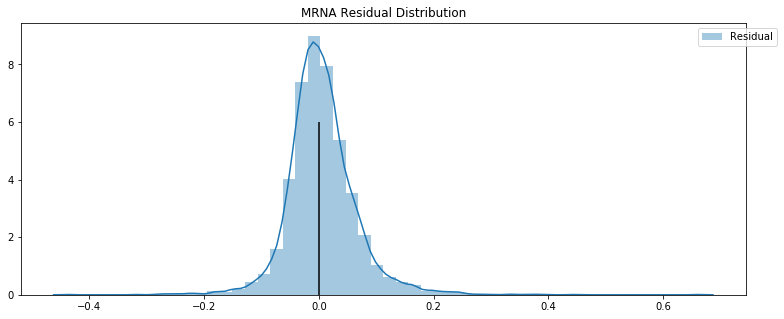

CYTK -0.019850172347994022 -0.007318031181849927


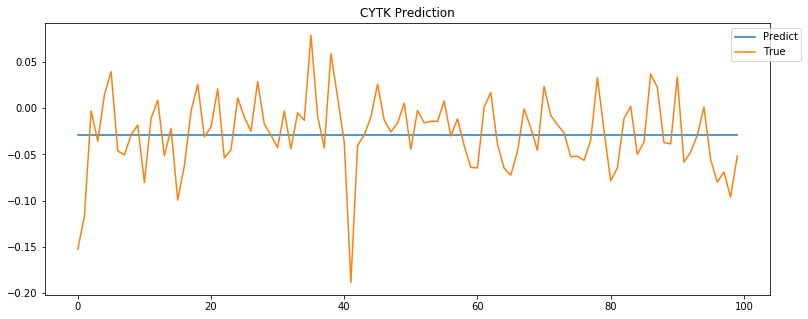

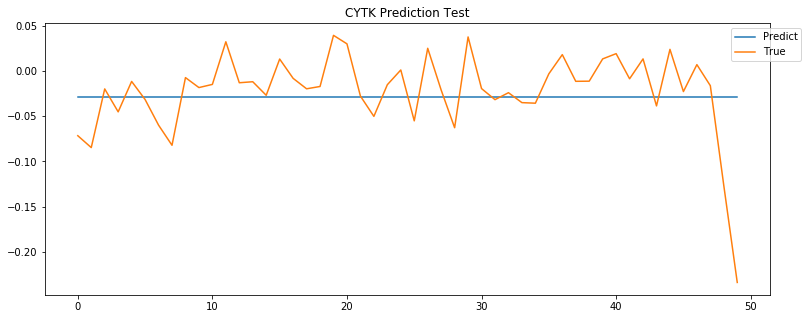

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


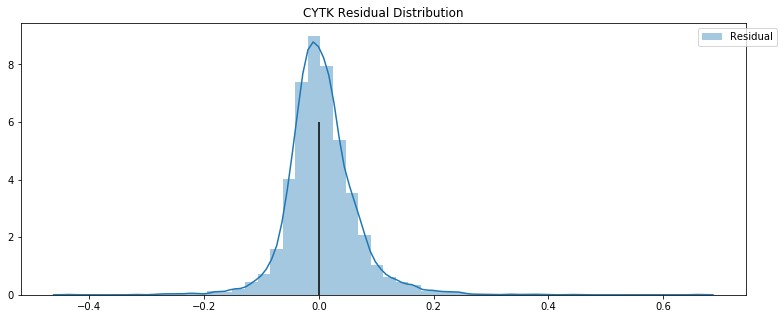

FTSV -0.019850172347994022 -0.007318031181849927


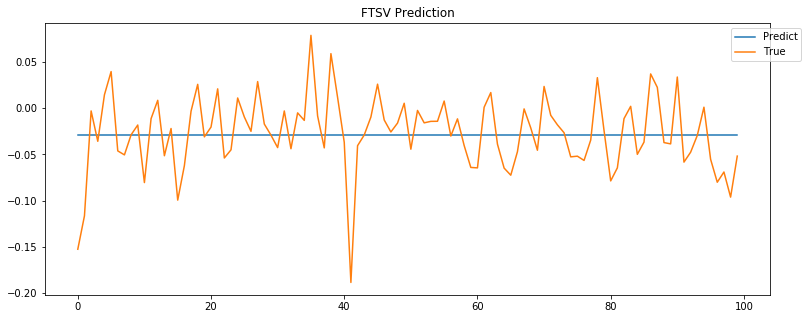

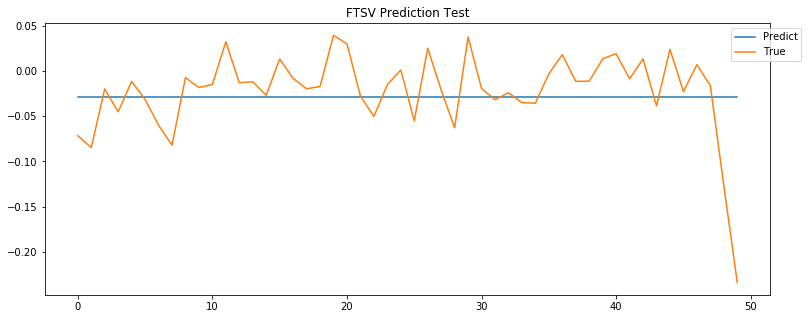

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


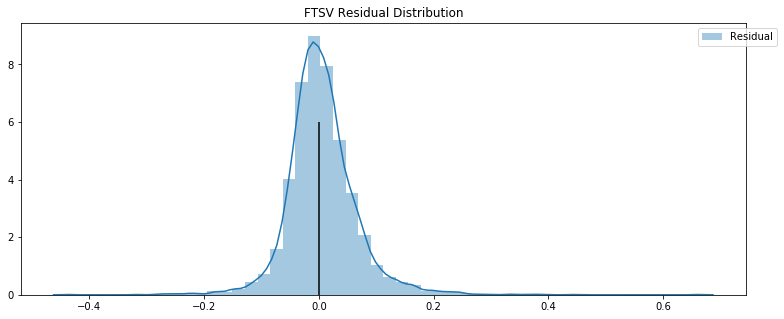

ASND -0.019850172347994022 -0.007318031181849927


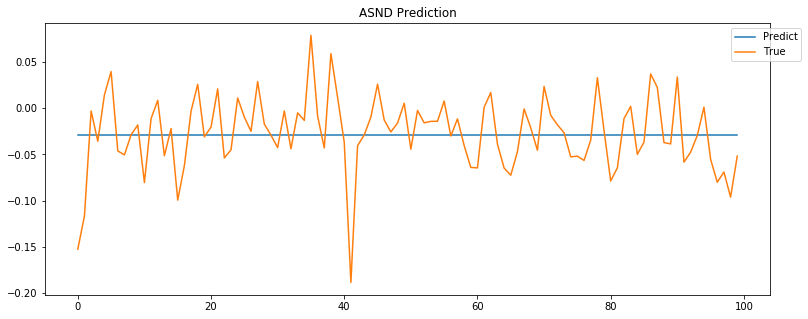

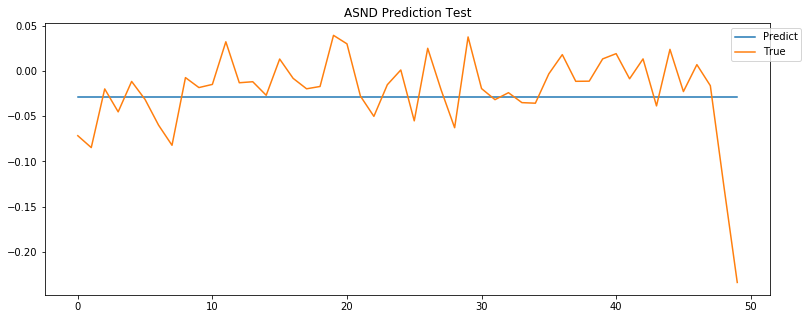

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


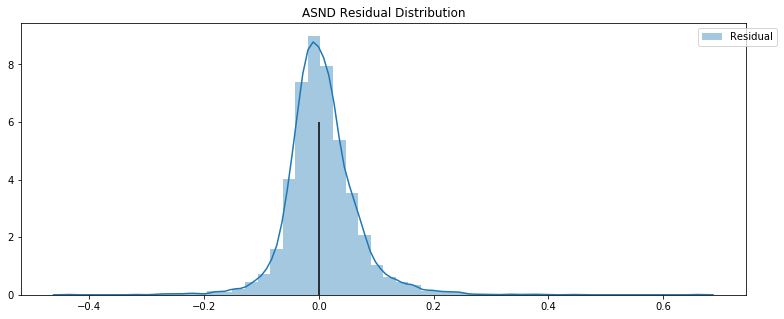

XBIT -0.019850172347994022 -0.007318031181849927


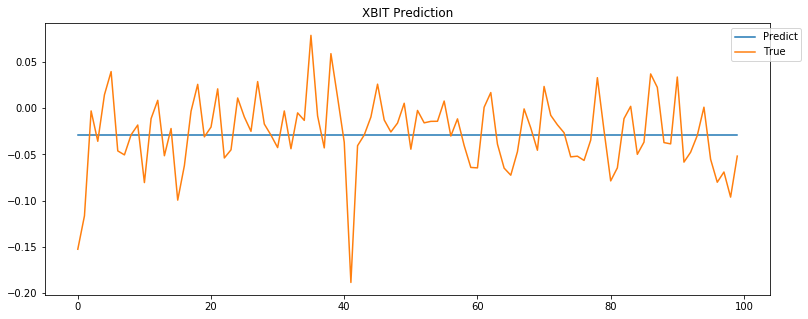

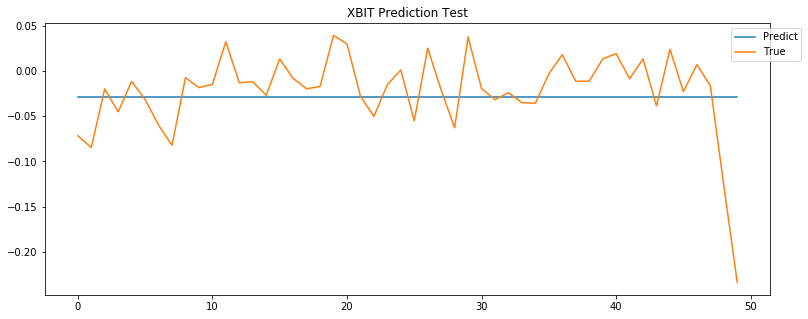

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


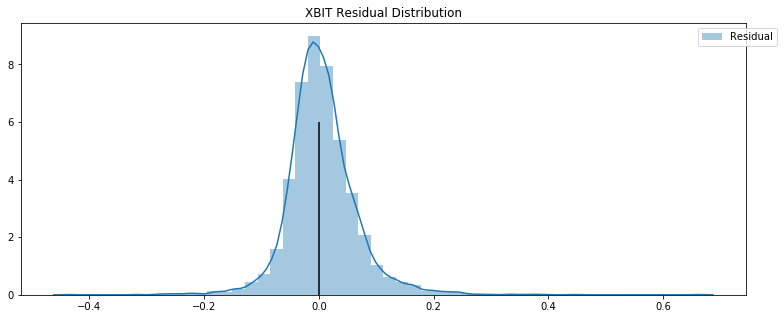

ALEC -0.019850172347994022 -0.007318031181849927


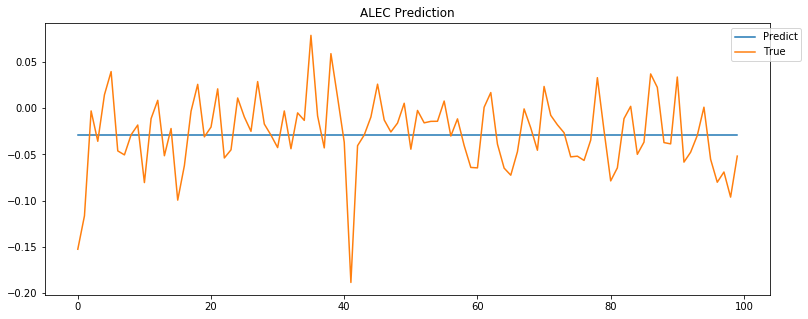

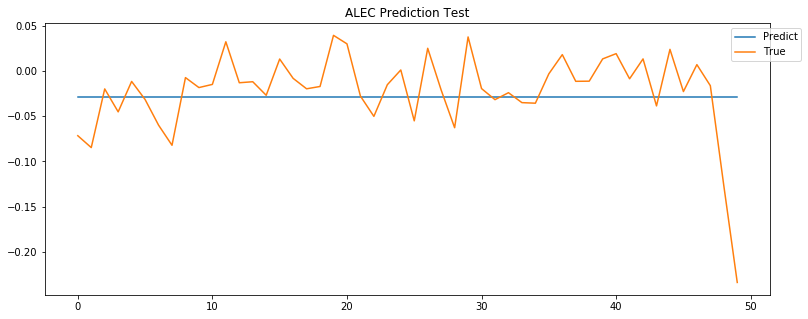

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


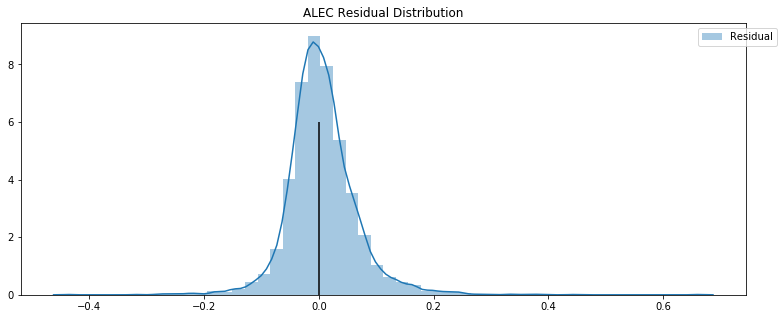

ORTX -0.019850172347994022 -0.007318031181849927


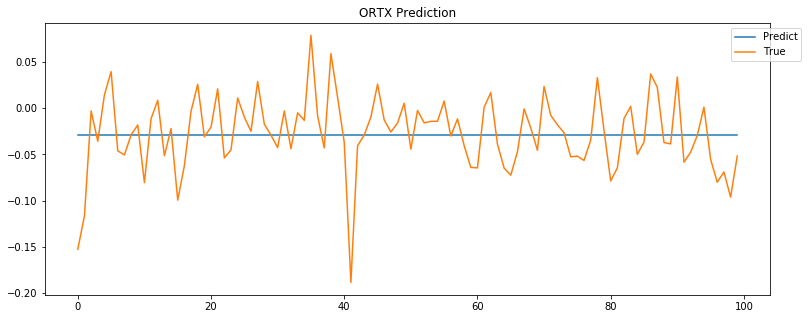

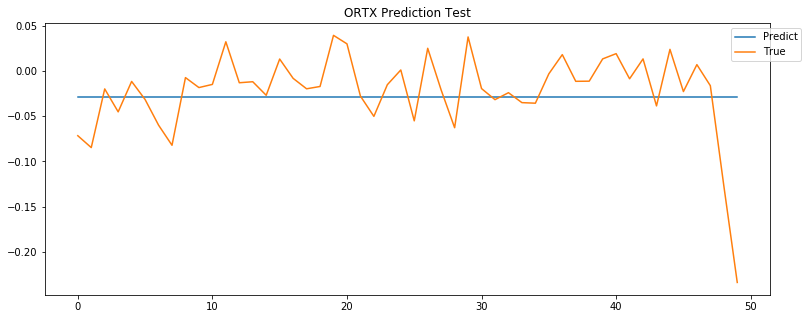

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


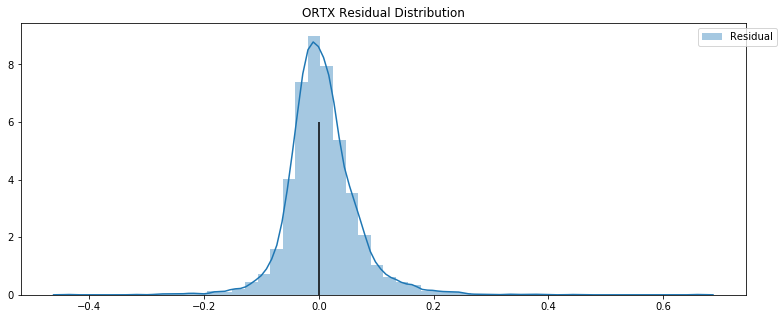

ADVM -0.019850172347994022 -0.007318031181849927


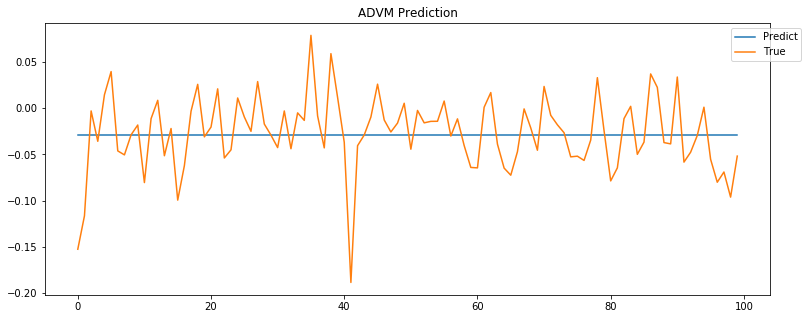

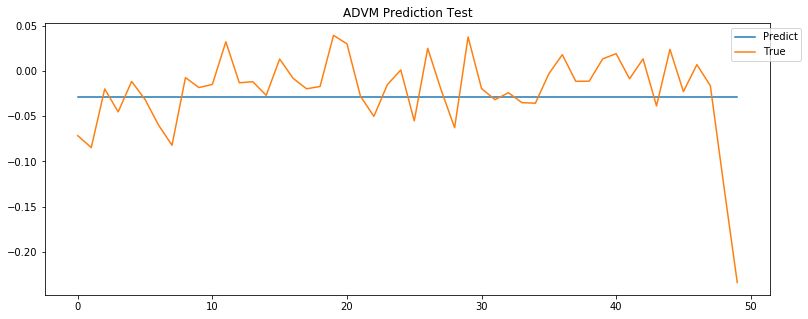

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


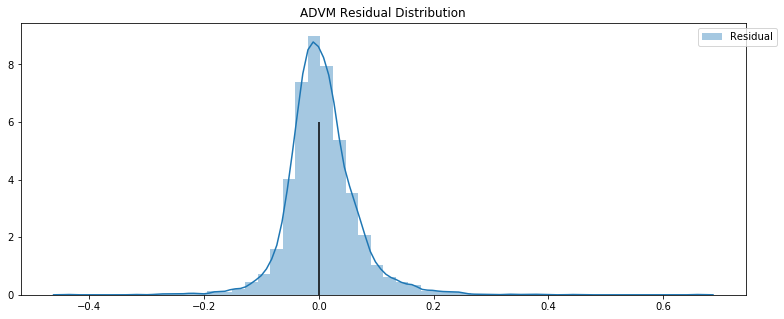

MGNX -0.019850172347994022 -0.007318031181849927


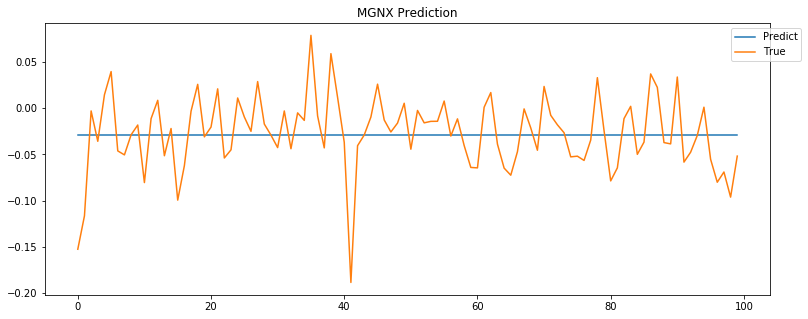

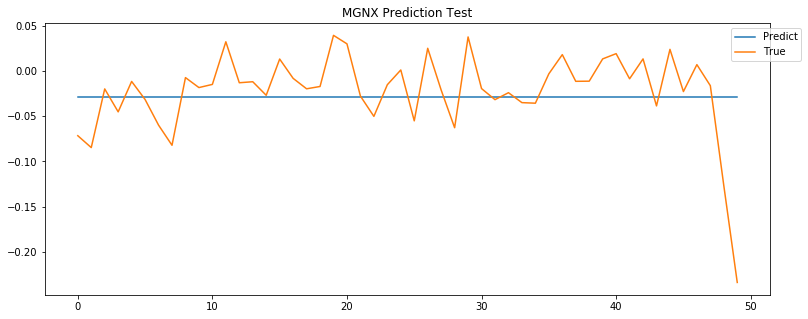

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


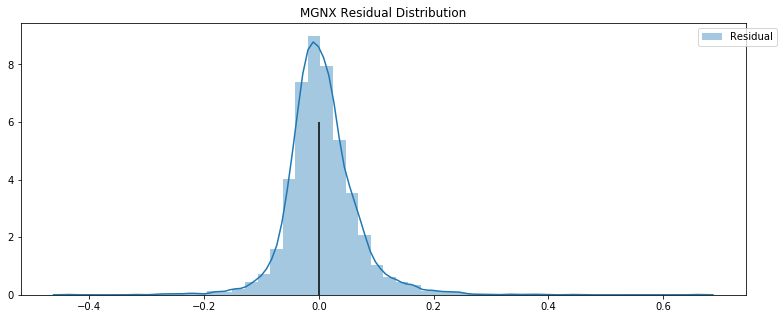

AKRO -0.019850172347994022 -0.007318031181849927


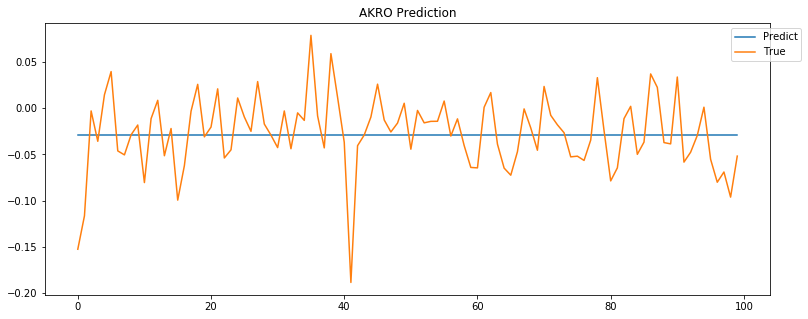

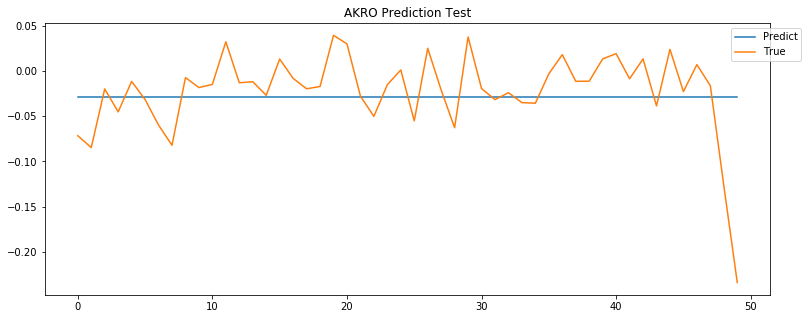

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


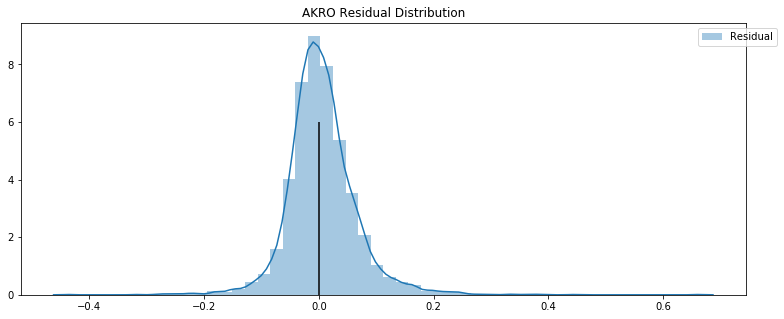

ESPR -0.019850172347994022 -0.007318031181849927


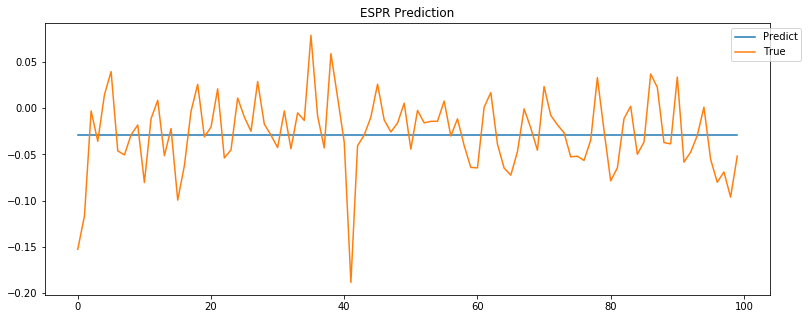

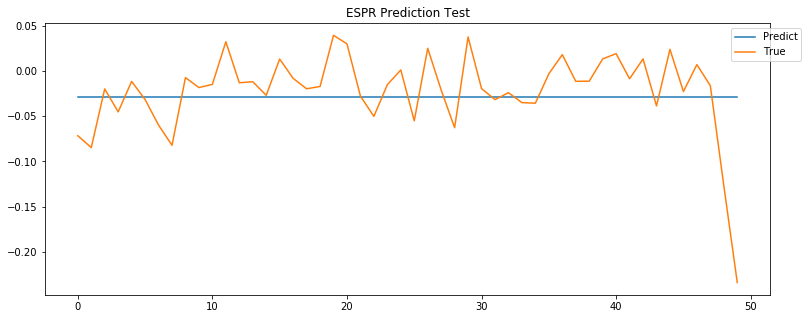

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


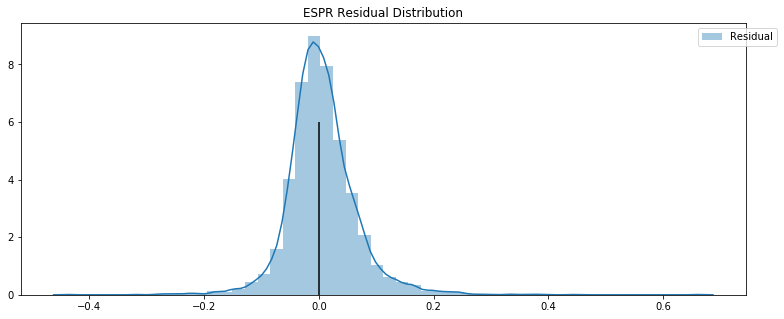

BHVN -0.019850172347994022 -0.007318031181849927


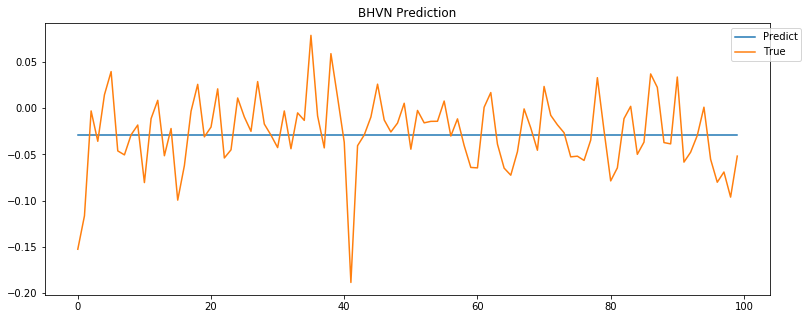

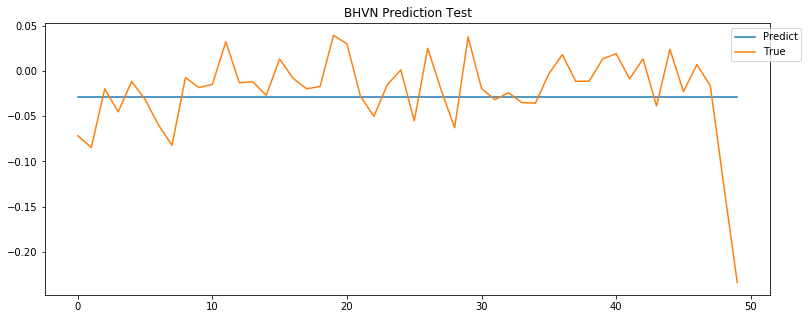

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


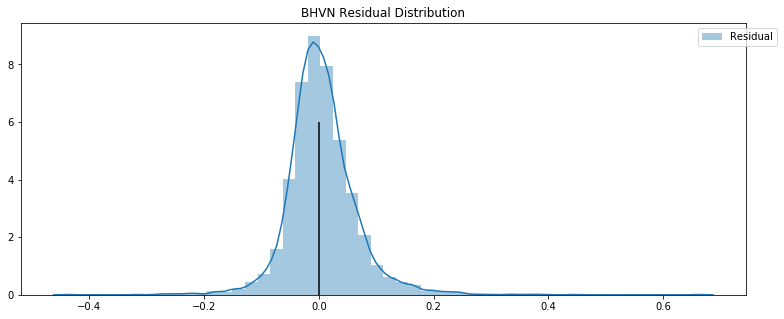

YMAB -0.019850172347994022 -0.007318031181849927


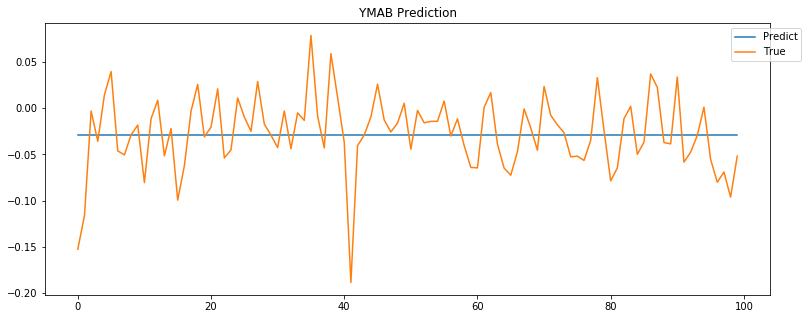

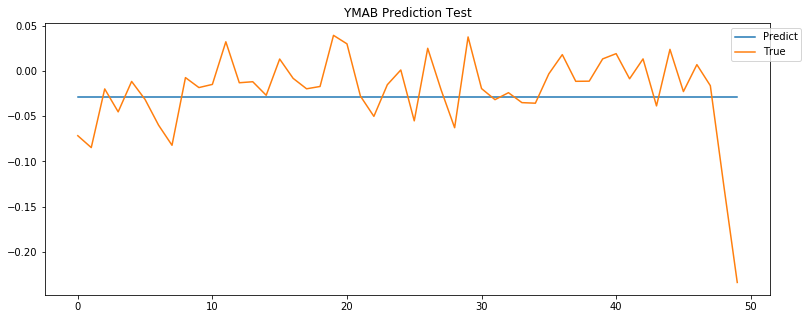

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


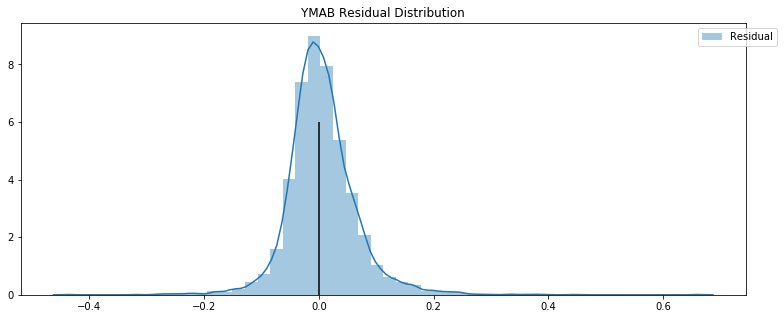

RGNX -0.019850172347994022 -0.007318031181849927


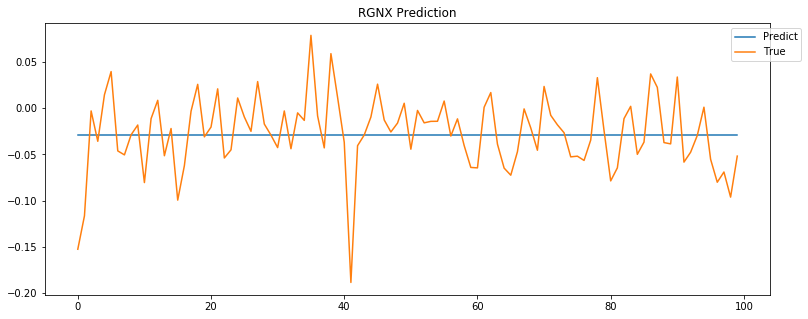

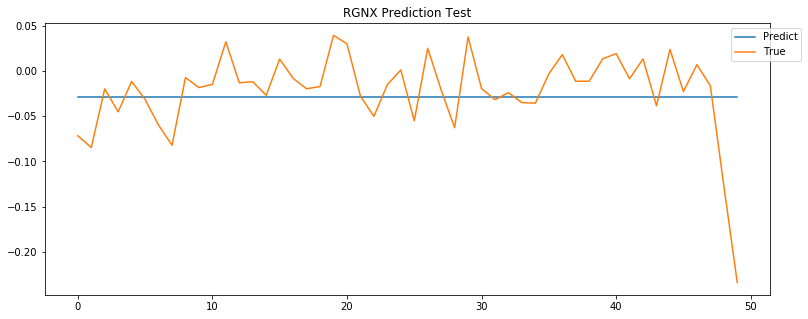

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


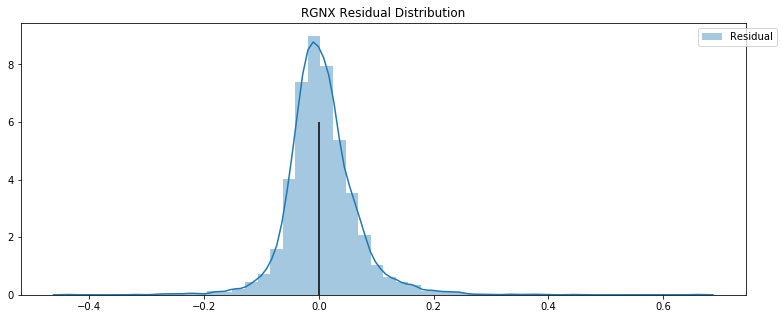

MYOK -0.019850172347994022 -0.007318031181849927


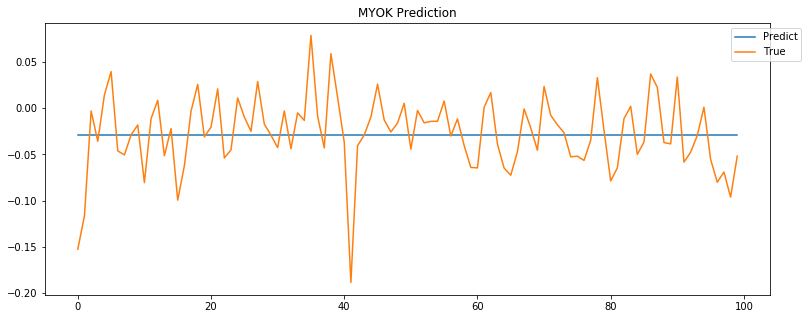

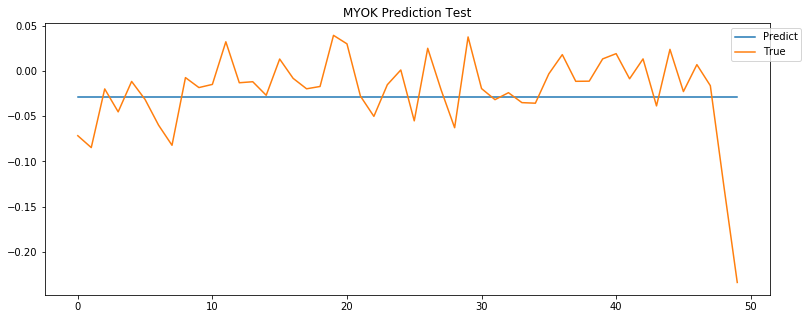

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


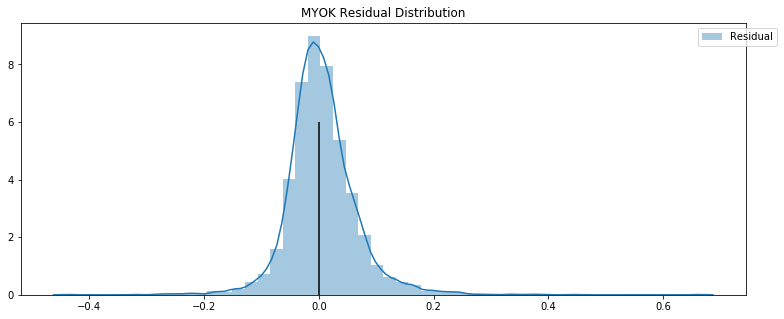

TPTX -0.019850172347994022 -0.007318031181849927


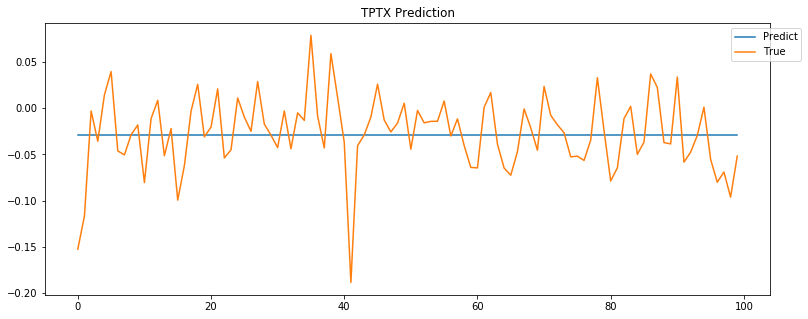

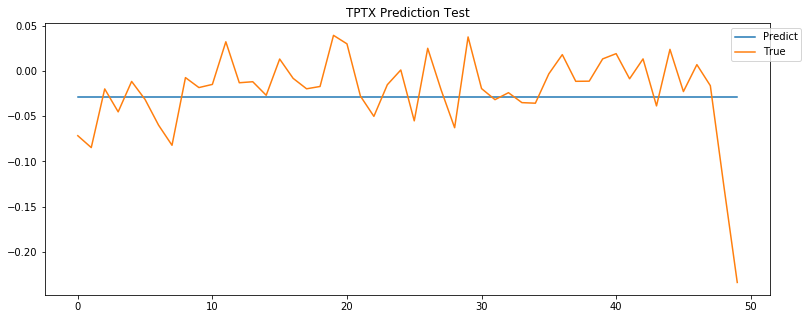

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


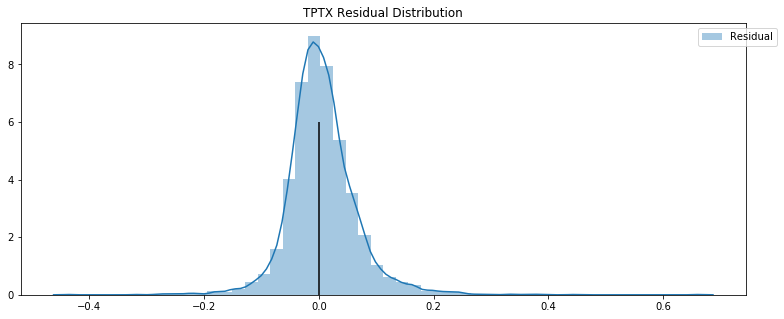

ATNX -0.019850172347994022 -0.007318031181849927


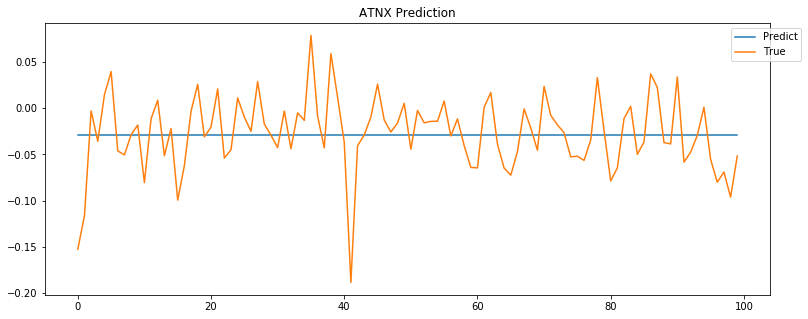

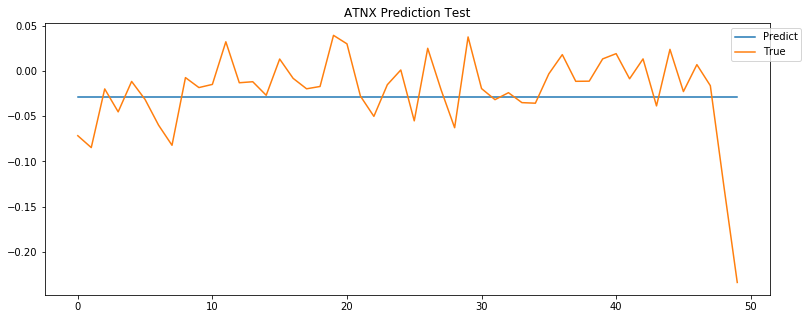

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


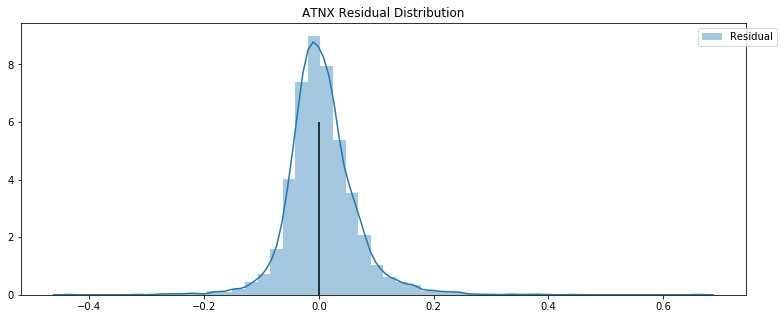

BLUE -0.019850172347994022 -0.007318031181849927


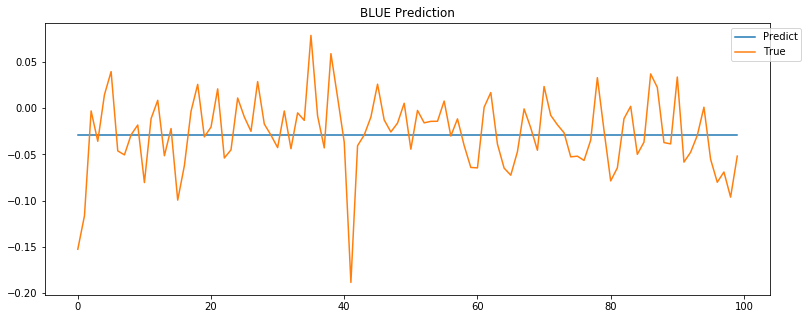

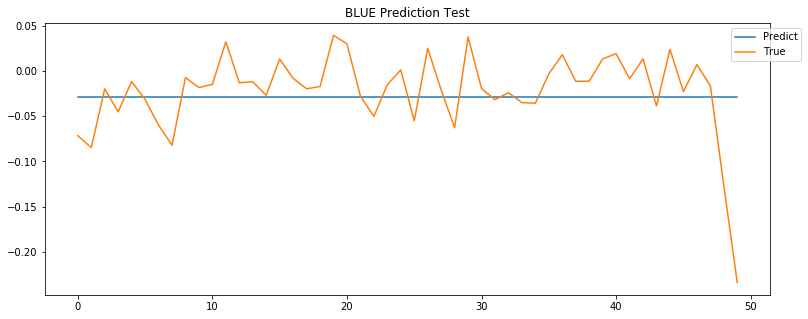

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


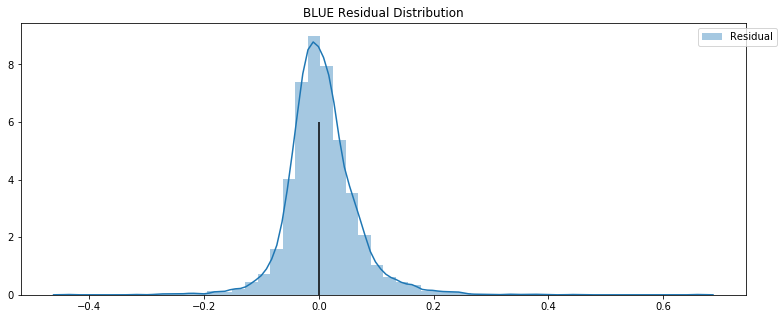

AGEN -0.019850172347994022 -0.007318031181849927


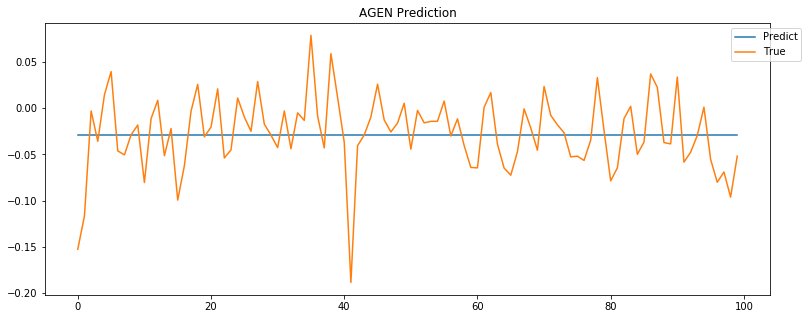

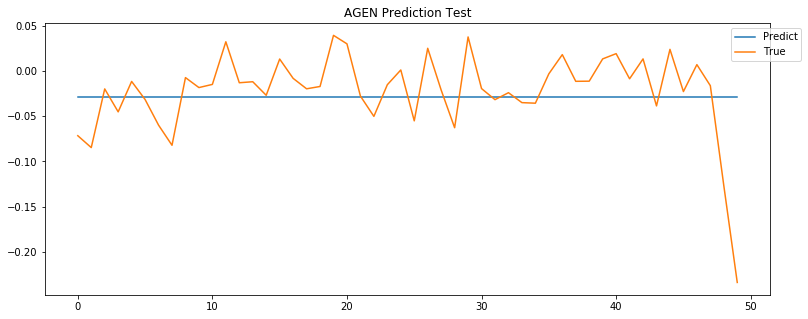

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


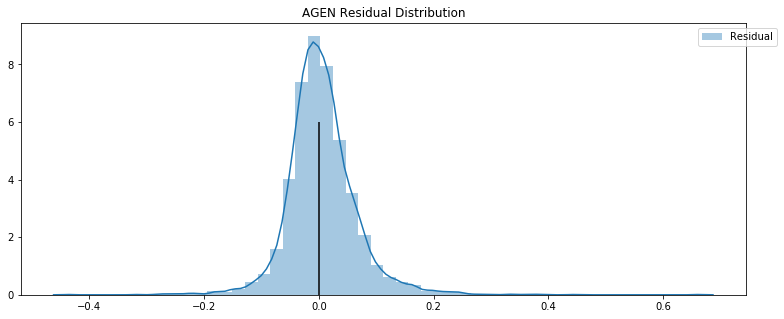

AVRO -0.019850172347994022 -0.007318031181849927


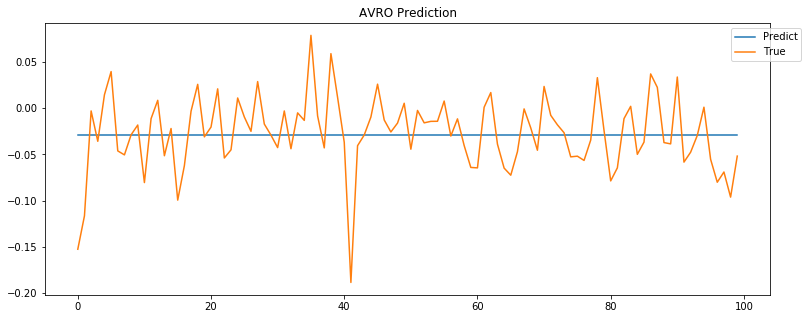

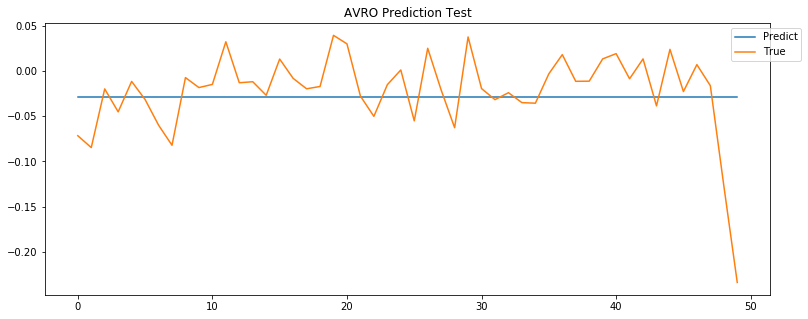

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


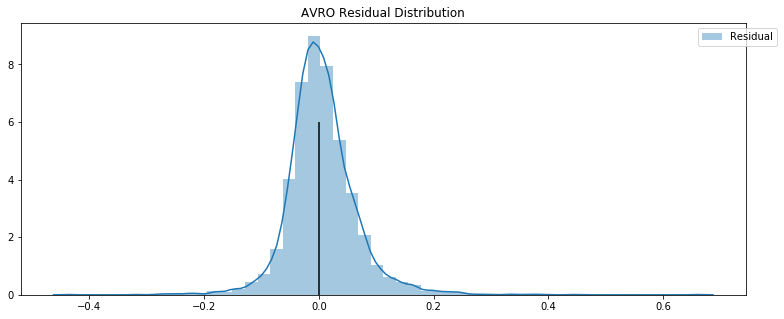

DCPH -0.019850172347994022 -0.007318031181849927


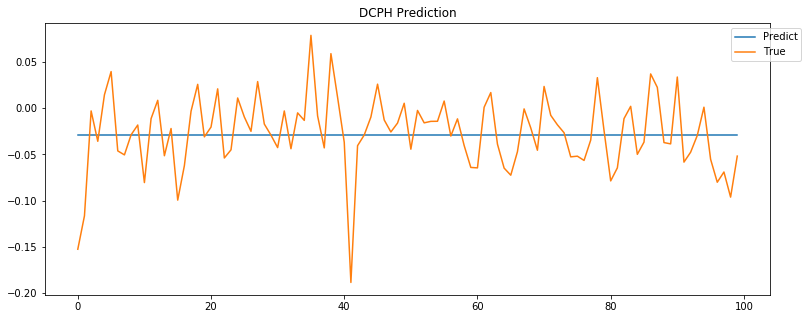

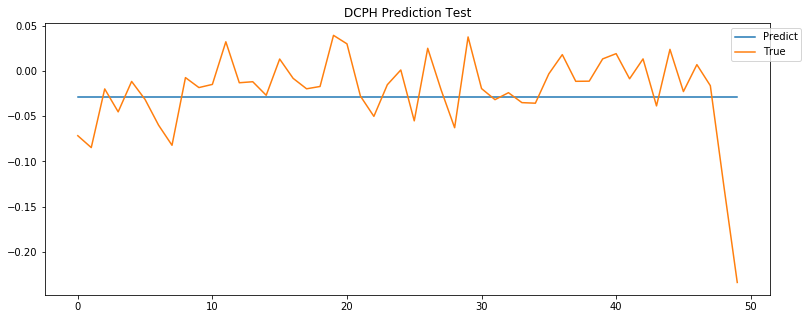

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


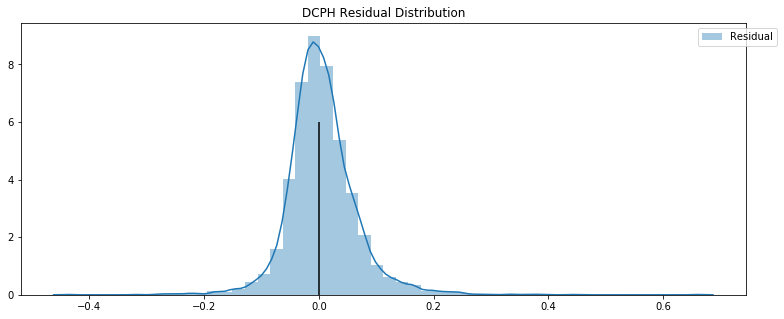

CTMX -0.019850172347994022 -0.007318031181849927


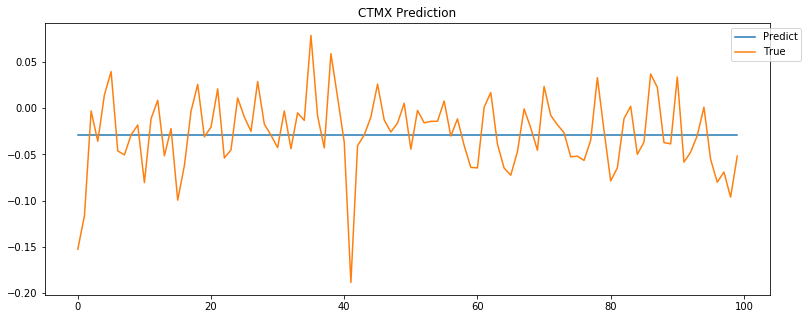

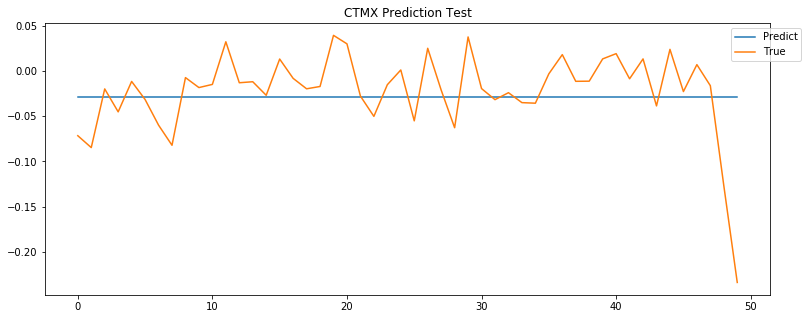

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


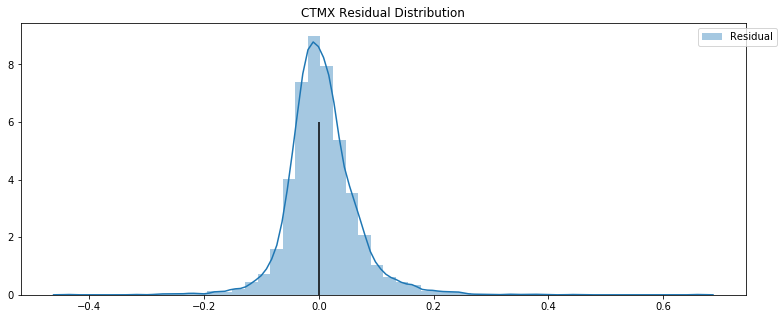

SRNE -0.019850172347994022 -0.007318031181849927


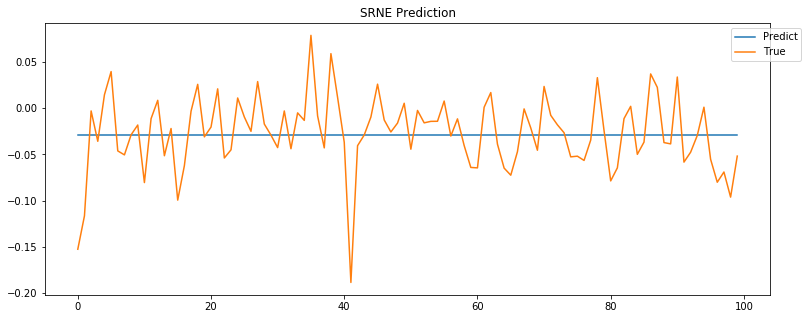

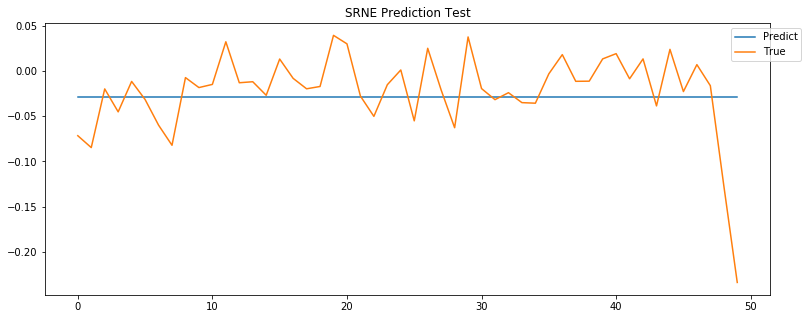

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


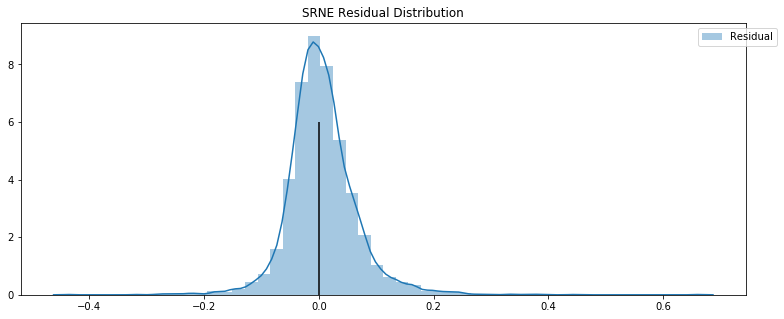

ARDX -0.019850172347994022 -0.007318031181849927


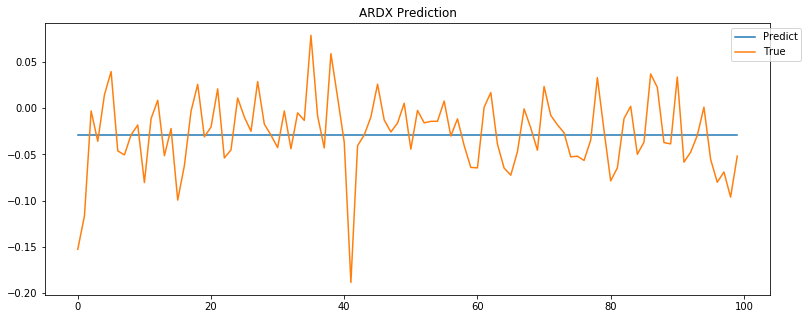

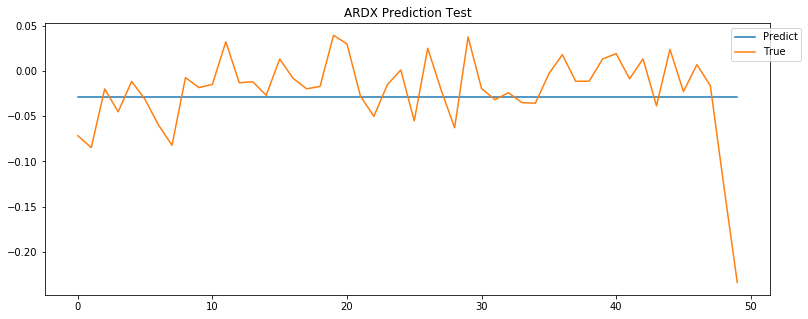

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


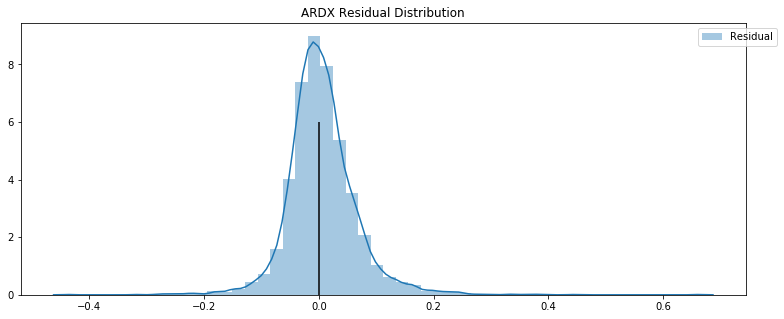

BCRX -0.019850172347994022 -0.007318031181849927


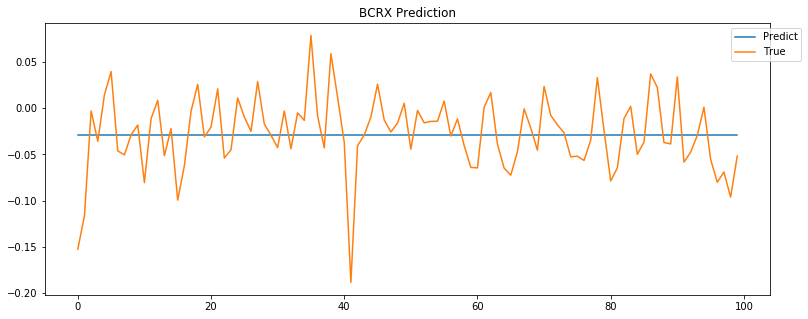

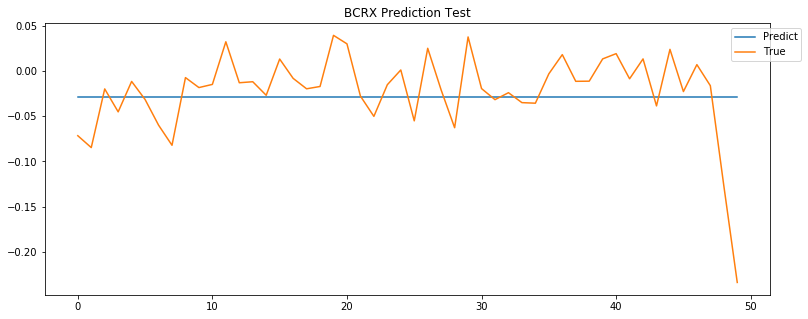

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


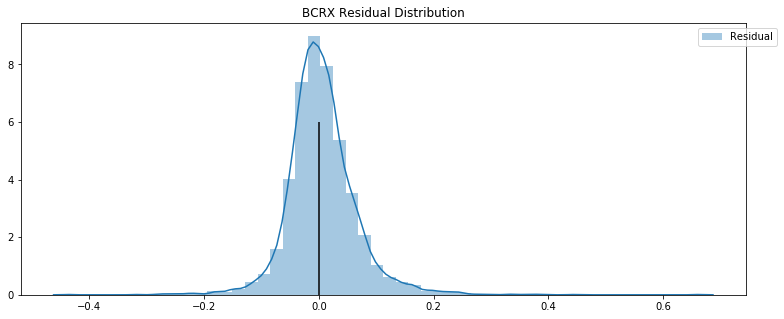

RETA -0.019850172347994022 -0.007318031181849927


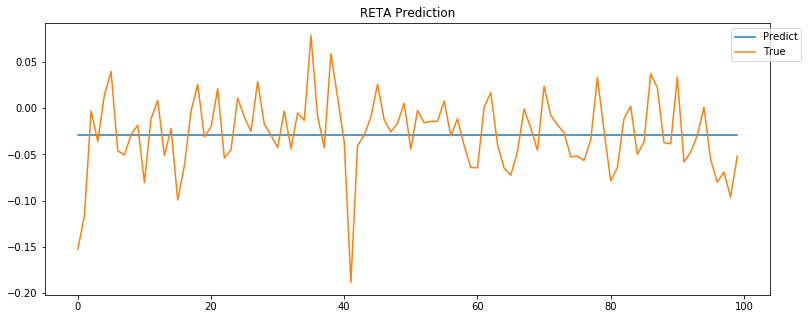

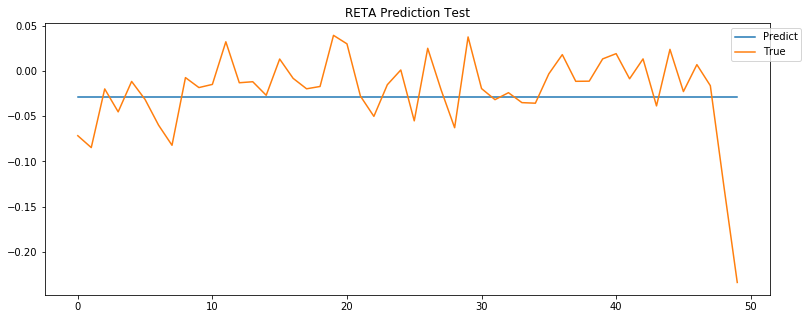

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


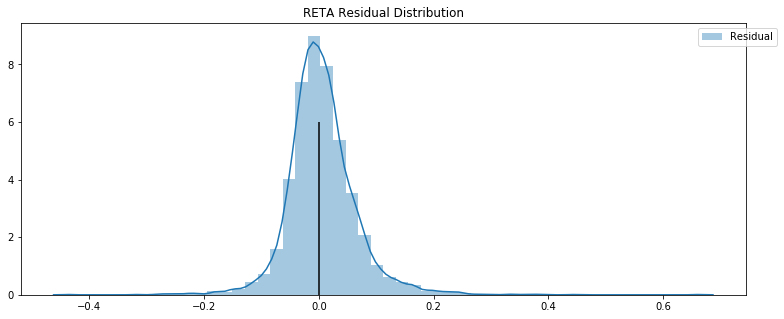

KOD -0.019850172347994022 -0.007318031181849927


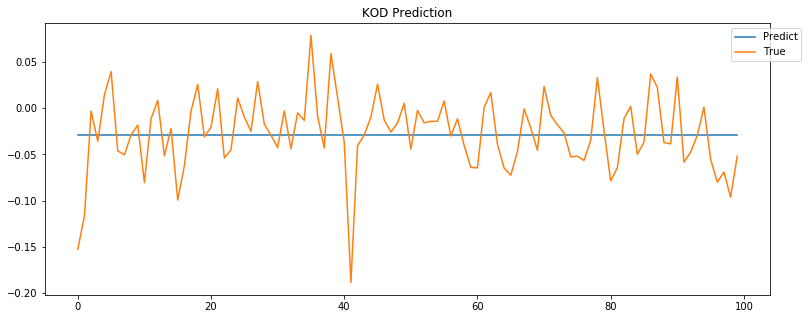

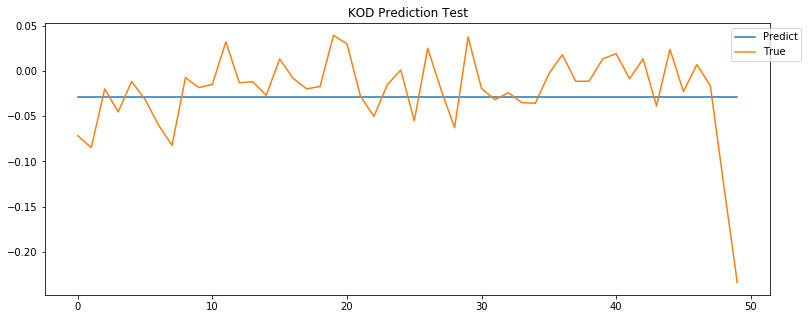

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


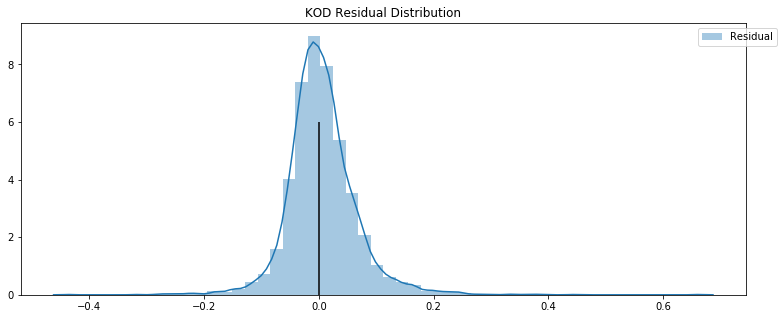

DTIL -0.019850172347994022 -0.007318031181849927


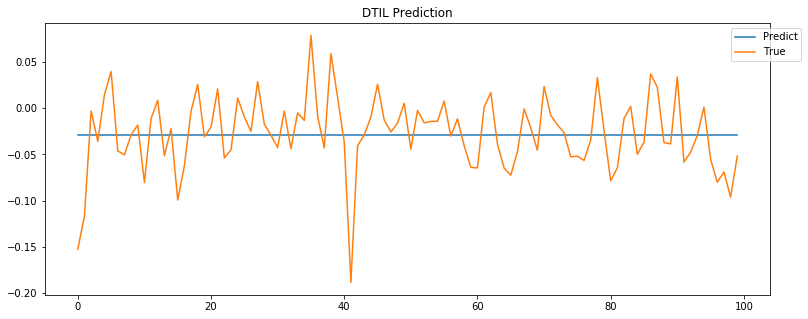

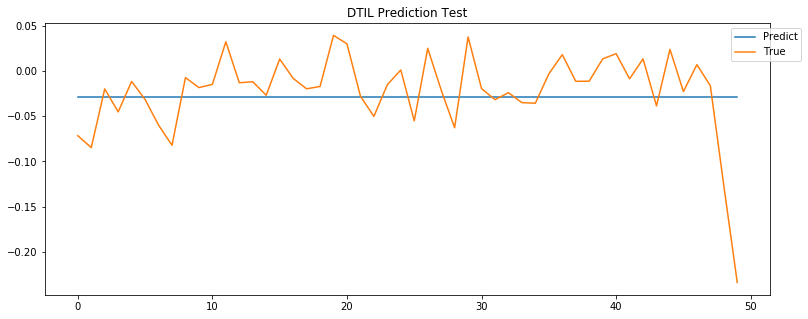

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


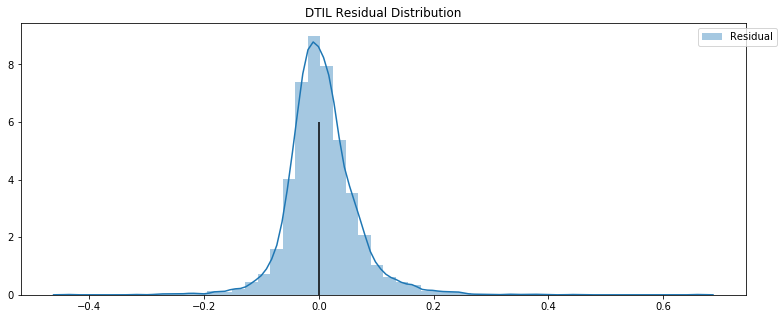

RARX -0.019850172347994022 -0.007318031181849927


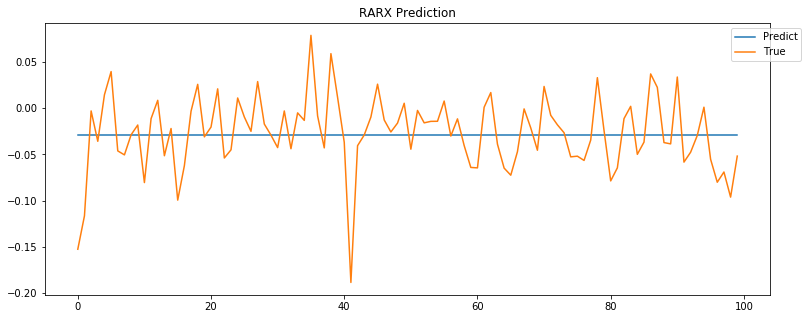

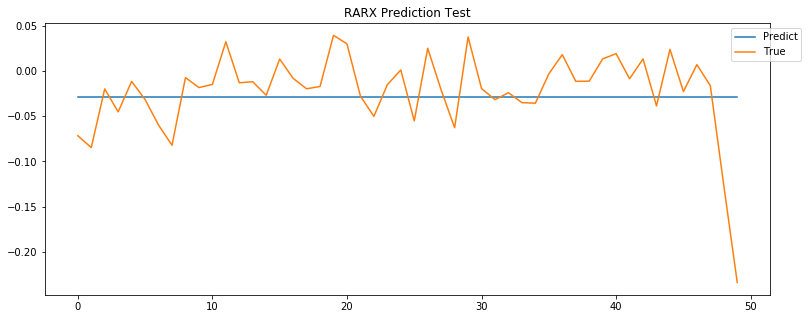

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


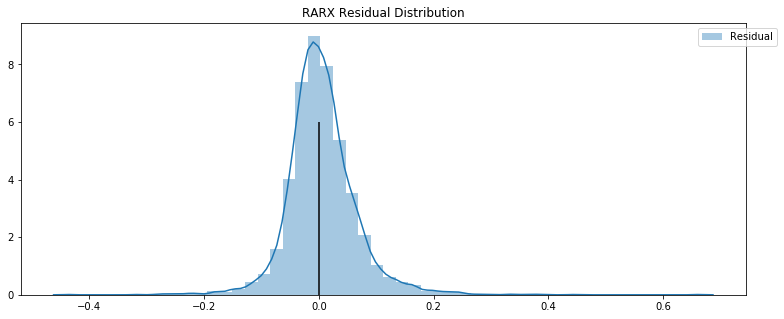

AUTL -0.019850172347994022 -0.007318031181849927


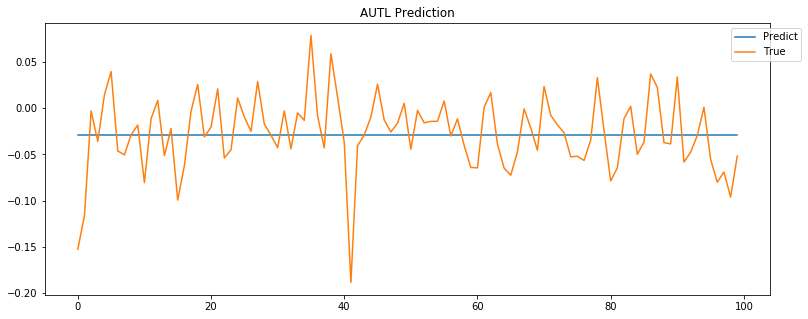

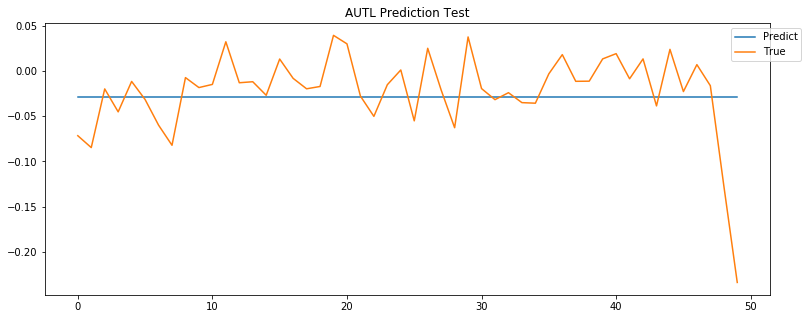

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


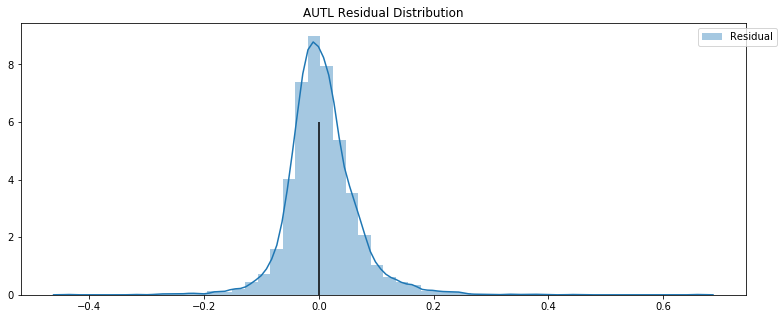

GTHX -0.019850172347994022 -0.007318031181849927


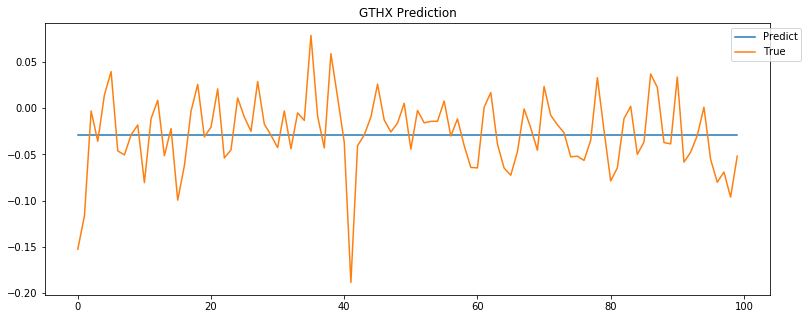

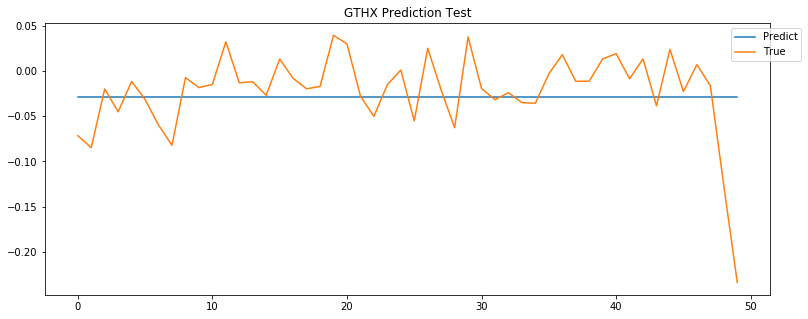

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


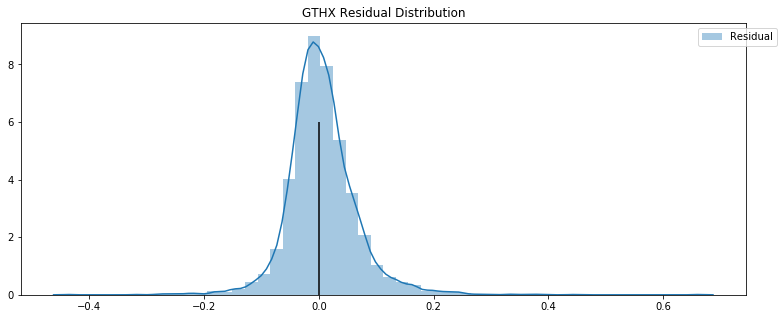

CARA -0.019850172347994022 -0.007318031181849927


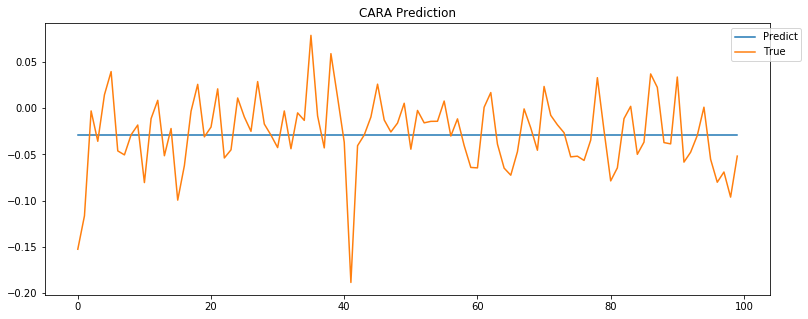

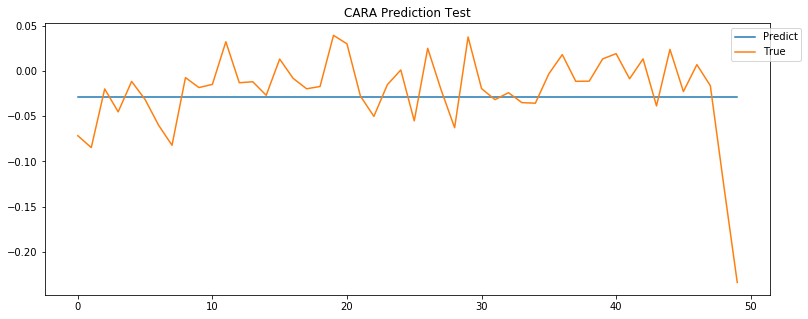

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


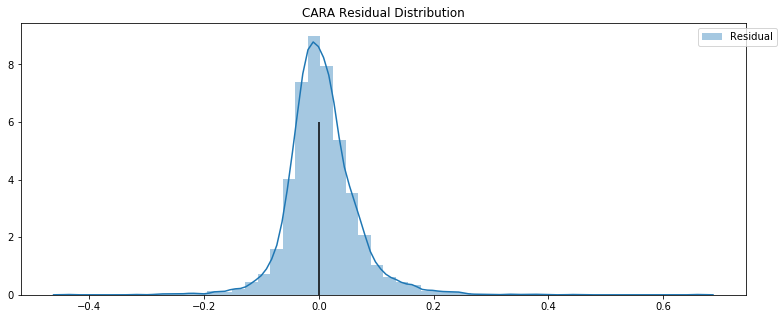

KDMN -0.019850172347994022 -0.007318031181849927


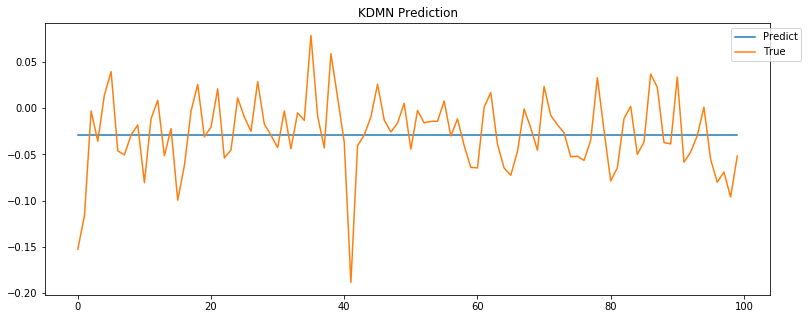

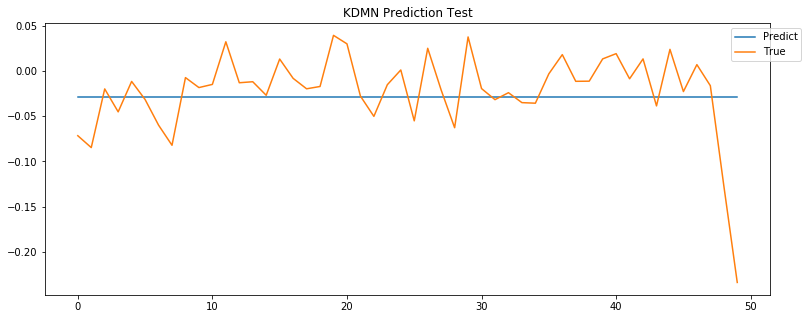

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


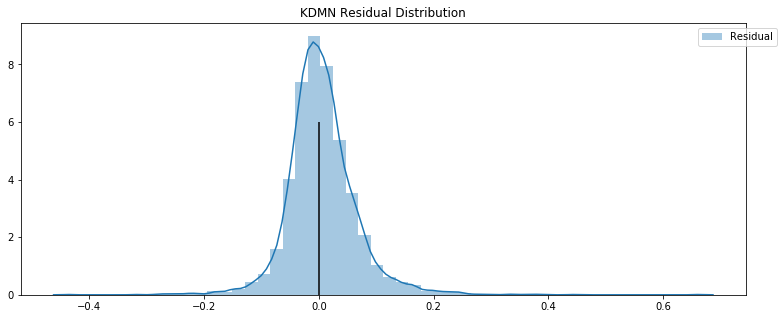

XNCR -0.019850172347994022 -0.007318031181849927


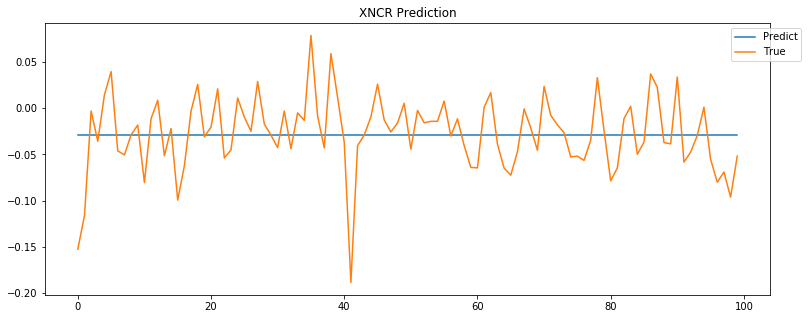

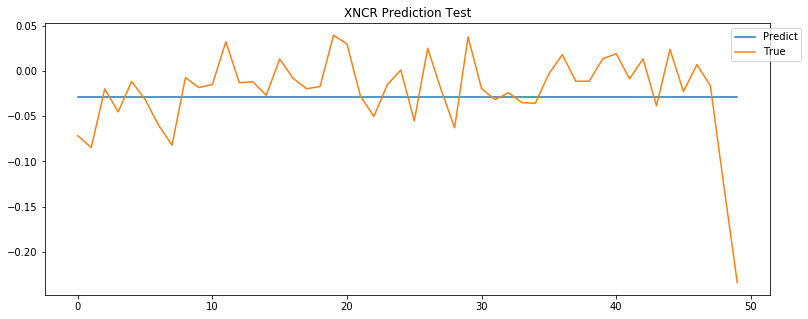

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


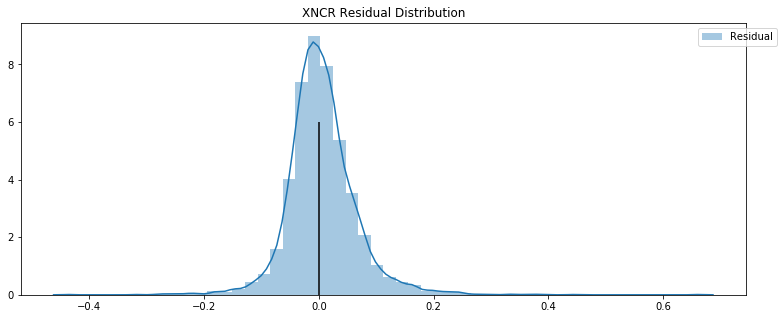

ACHN -0.019850172347994022 -0.007318031181849927


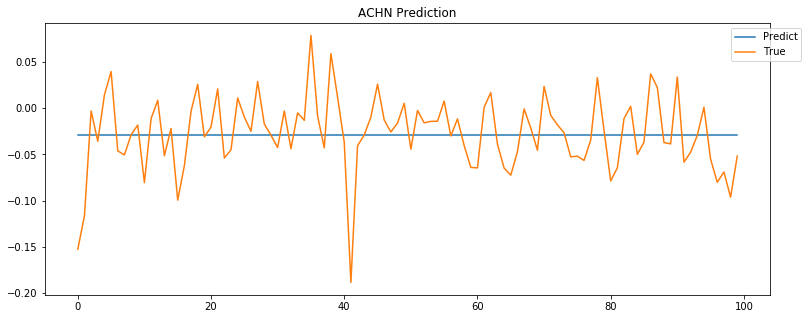

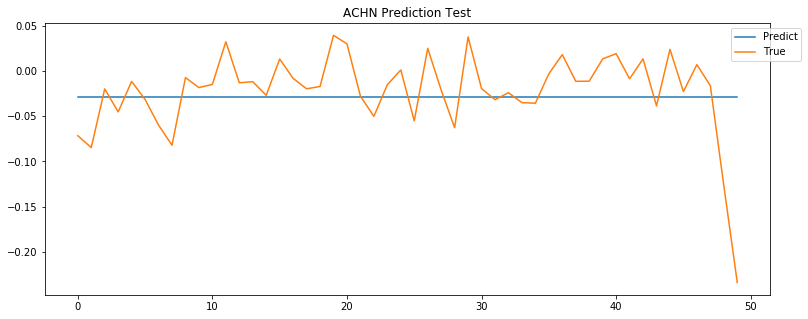

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


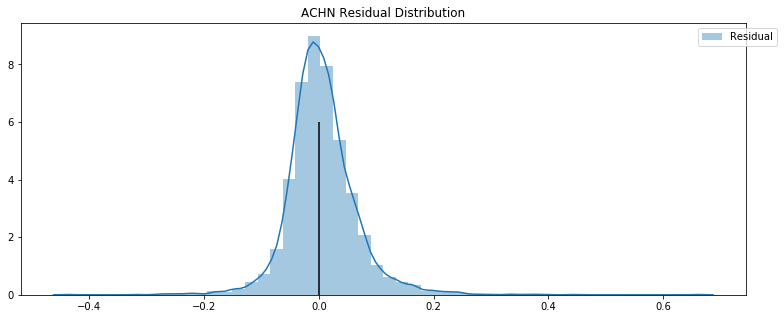

ARNA -0.019850172347994022 -0.007318031181849927


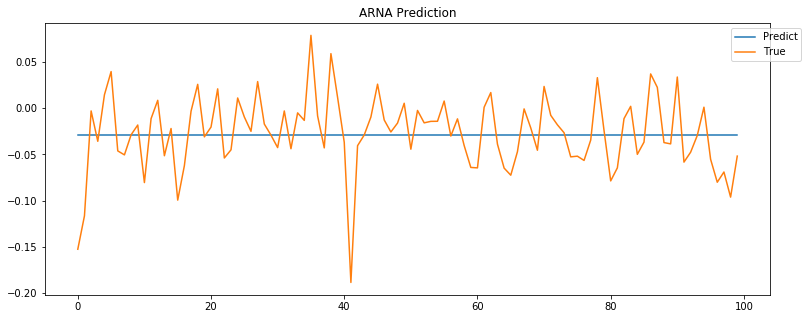

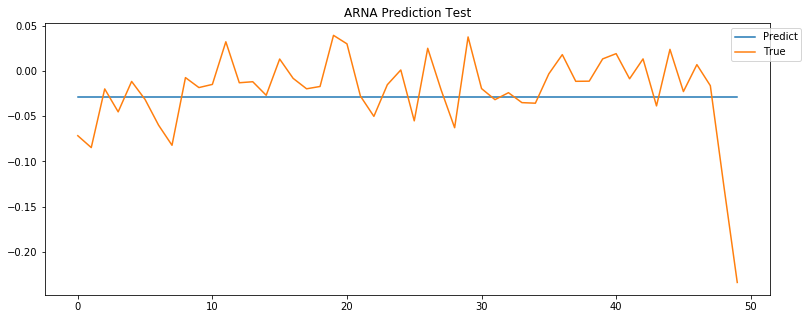

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


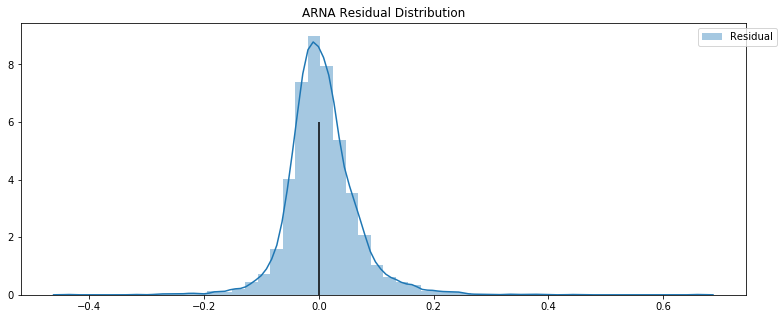

RCKT -0.019850172347994022 -0.007318031181849927


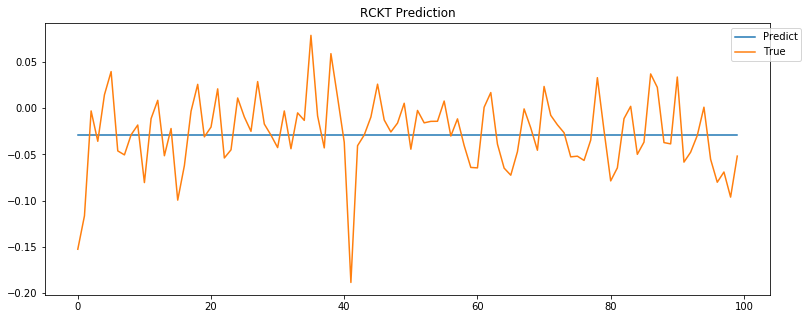

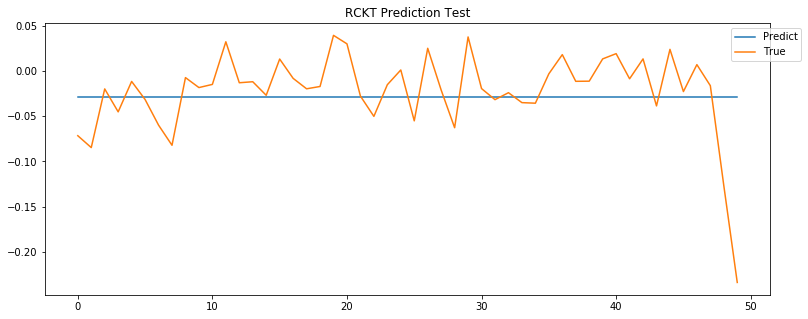

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


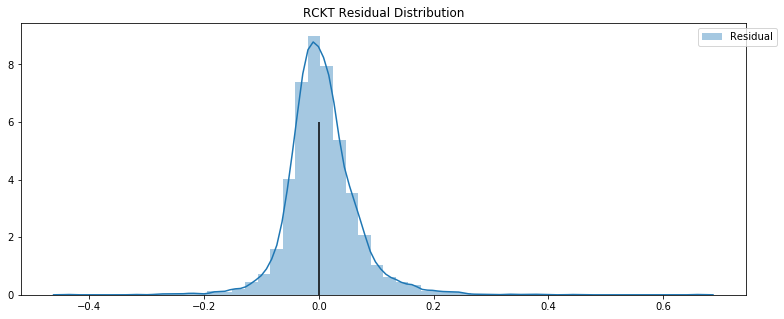

TBIO -0.019850172347994022 -0.007318031181849927


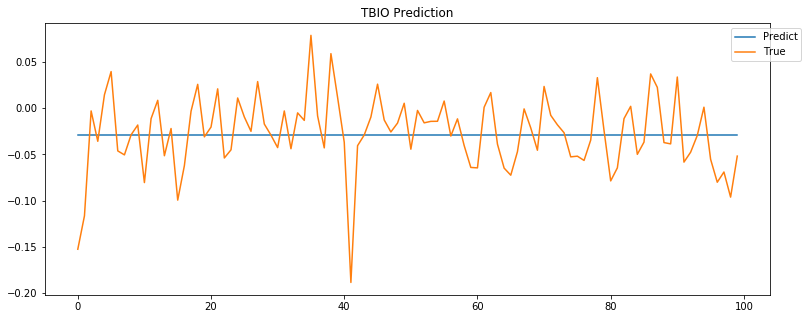

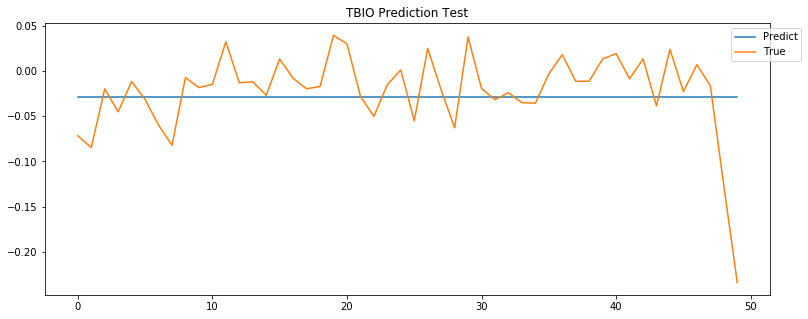

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


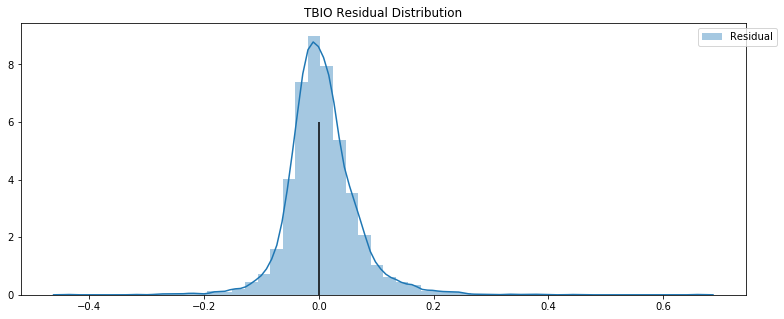

VYGR -0.019850172347994022 -0.007318031181849927


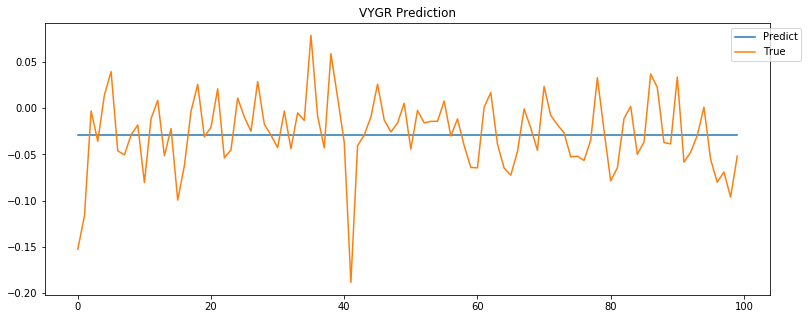

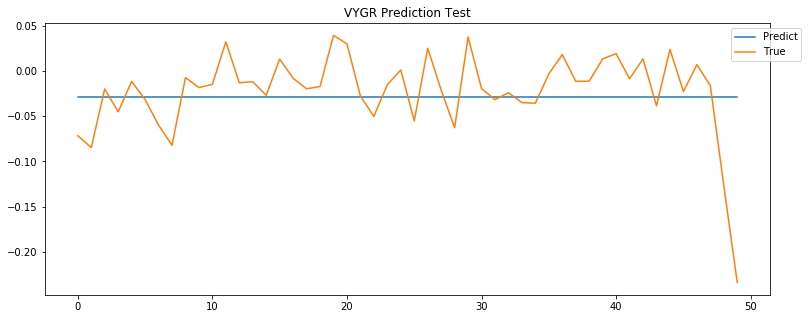

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


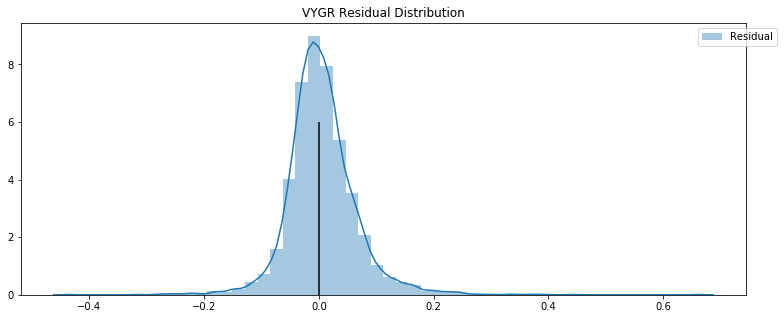

SGMO -0.019850172347994022 -0.007318031181849927


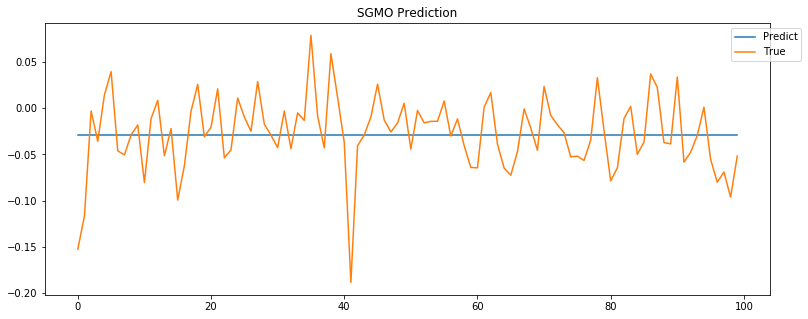

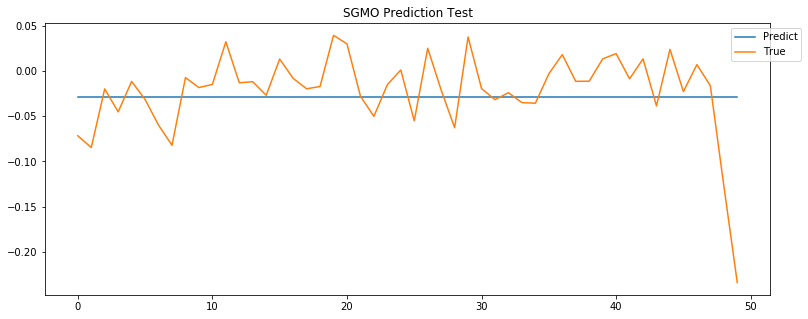

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


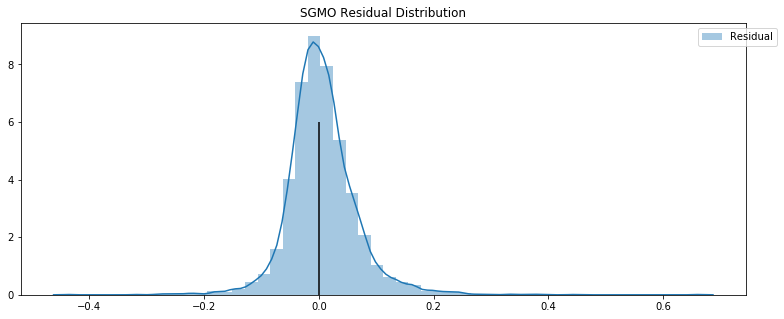

ODT -0.019850172347994022 -0.007318031181849927


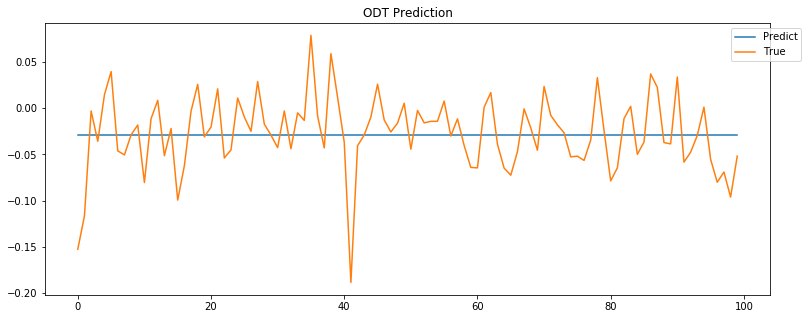

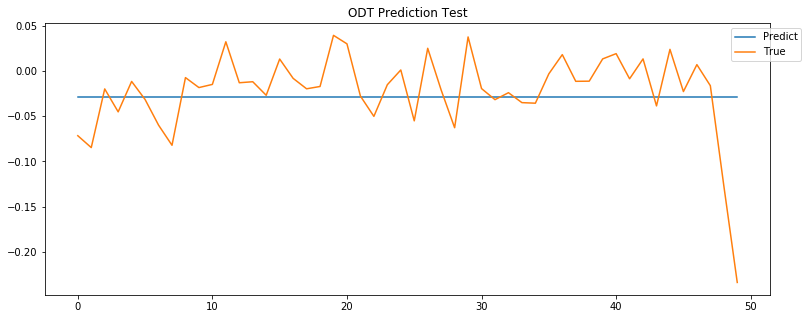

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


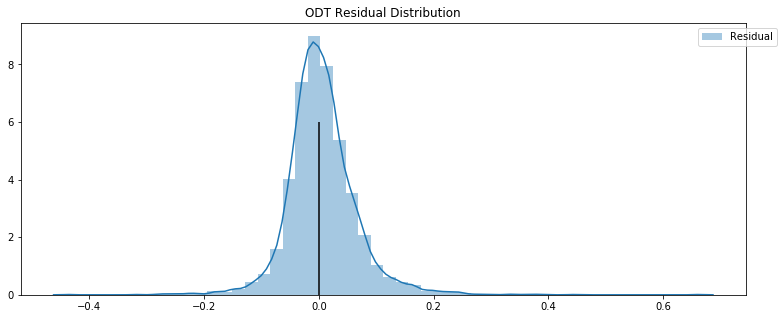

ANAB -0.019850172347994022 -0.007318031181849927


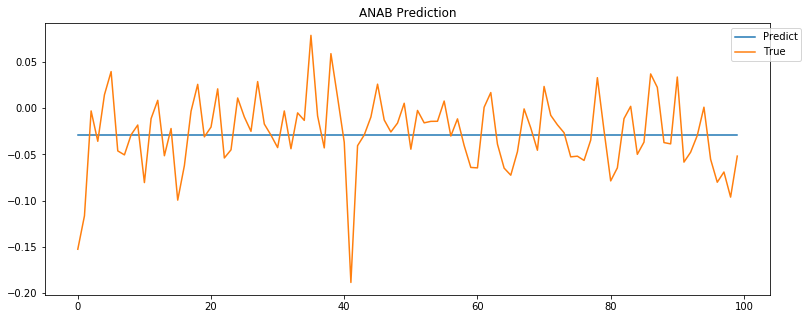

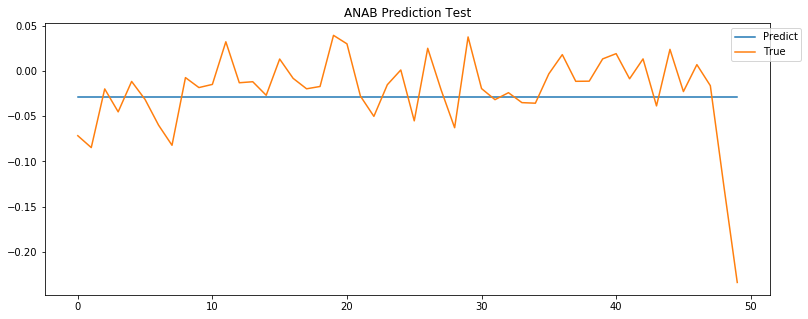

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


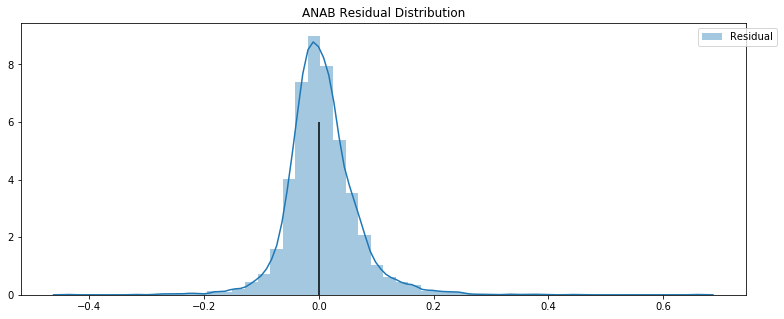

ATRA -0.019850172347994022 -0.007318031181849927


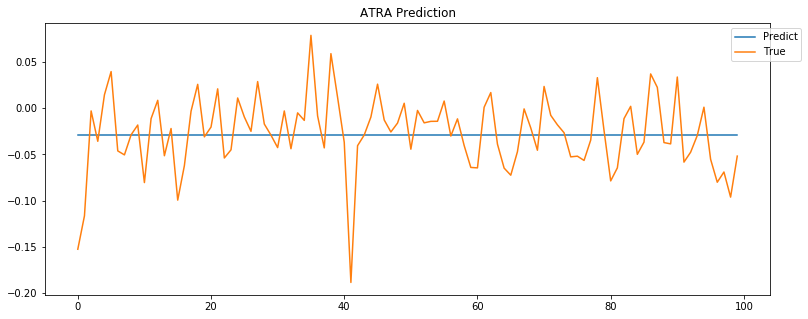

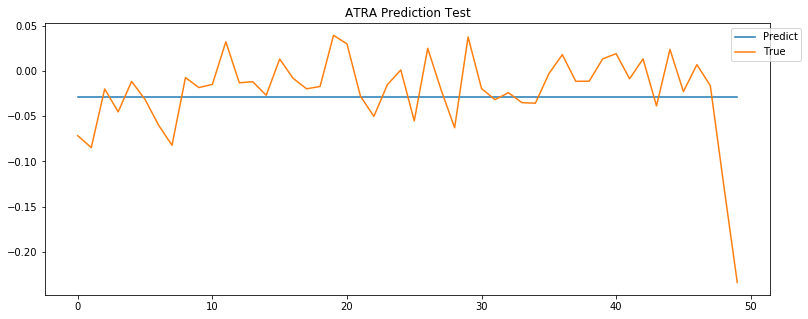

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


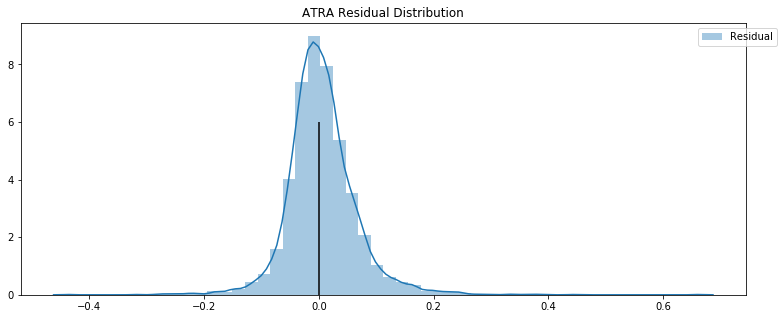

CNST -0.019850172347994022 -0.007318031181849927


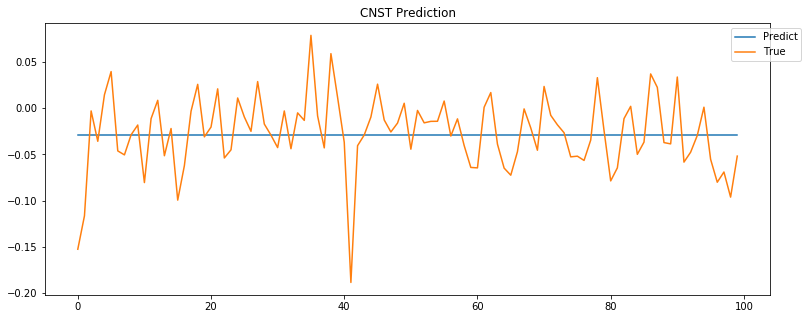

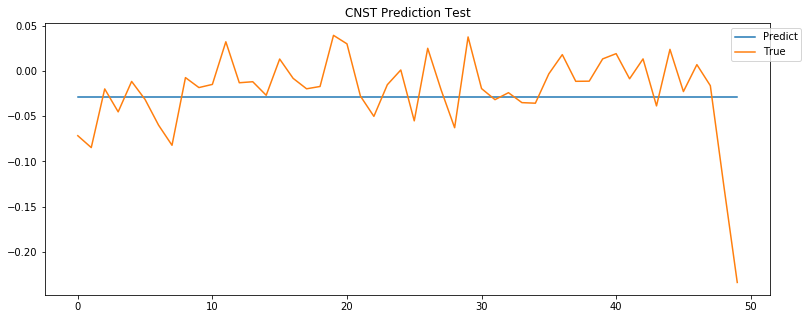

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


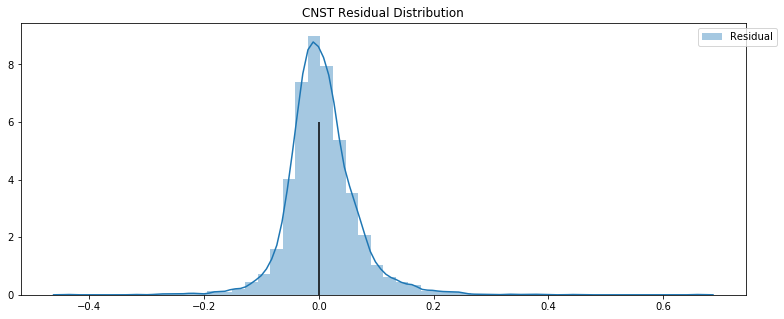

GERN -0.019850172347994022 -0.007318031181849927


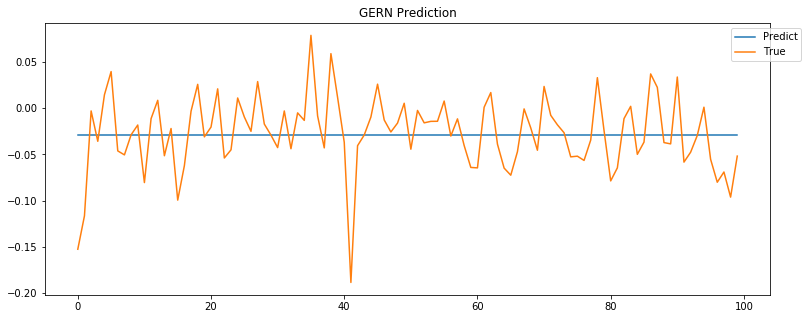

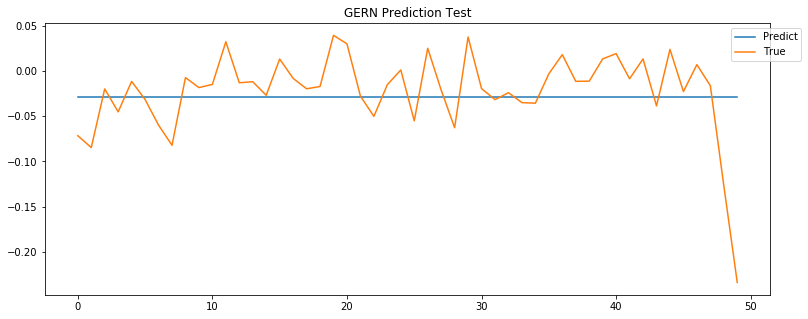

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


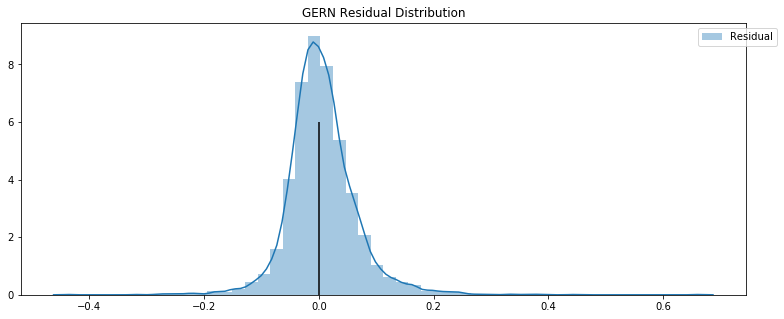

BPMC -0.019850172347994022 -0.007318031181849927


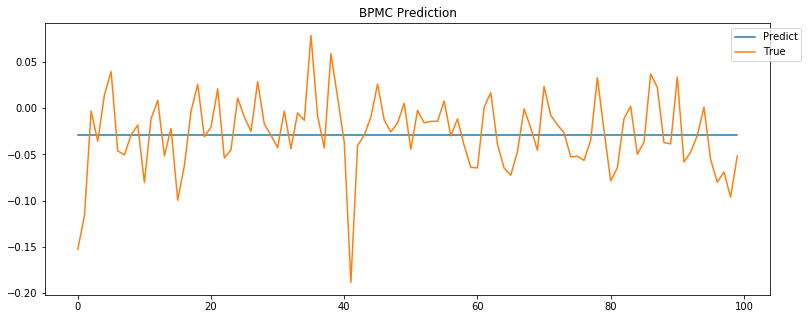

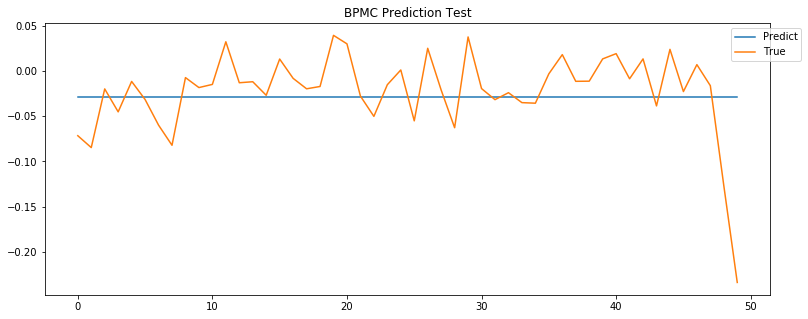

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


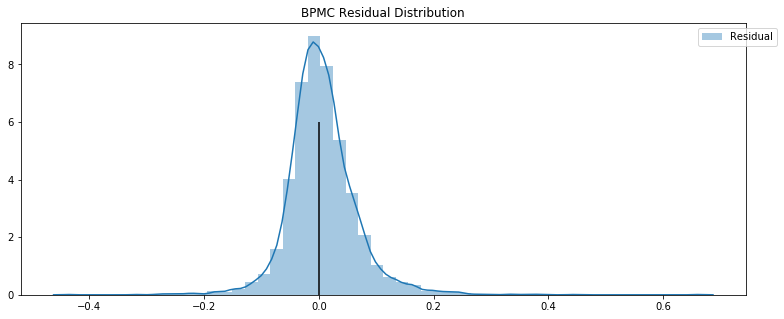

ALLO -0.019850172347994022 -0.007318031181849927


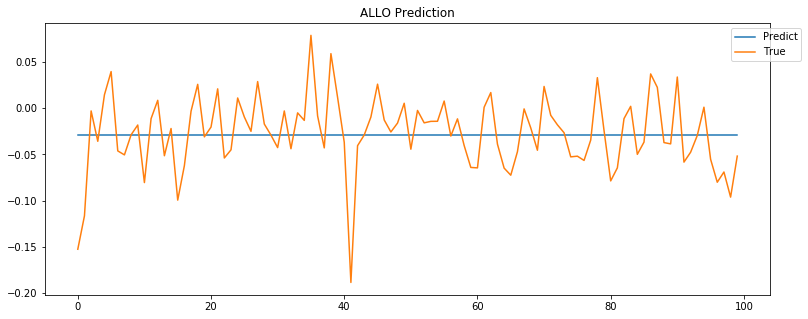

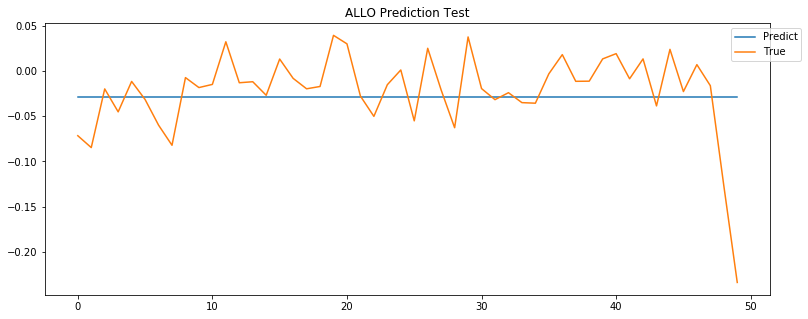

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


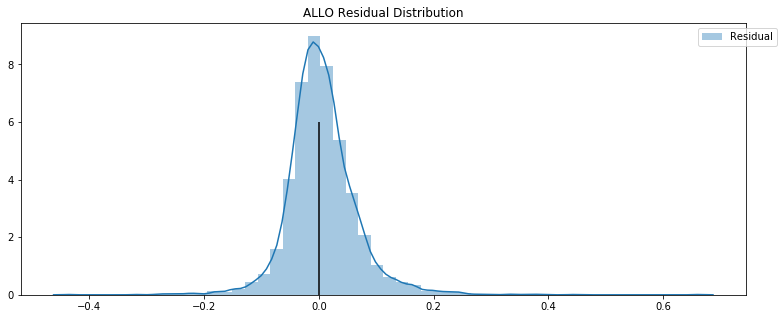

BBIO -0.019850172347994022 -0.007318031181849927


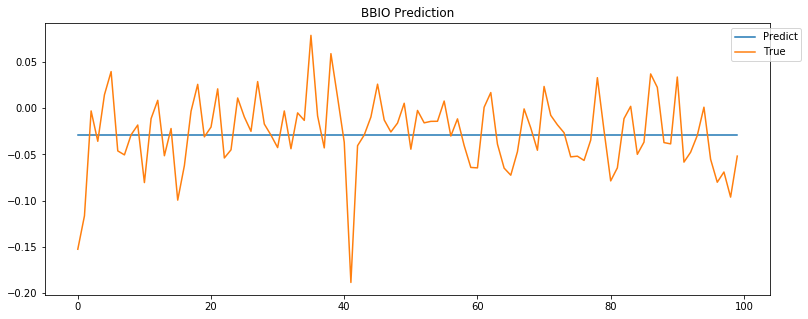

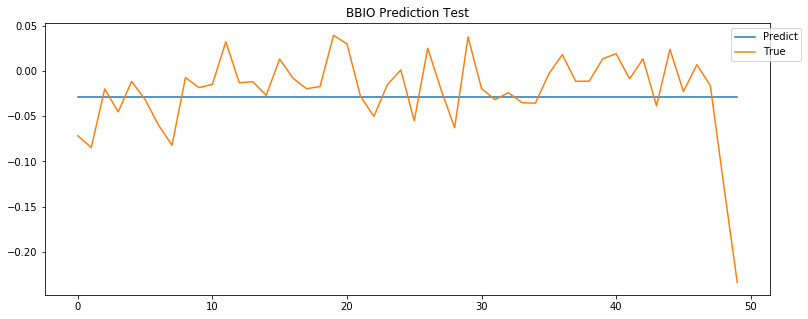

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


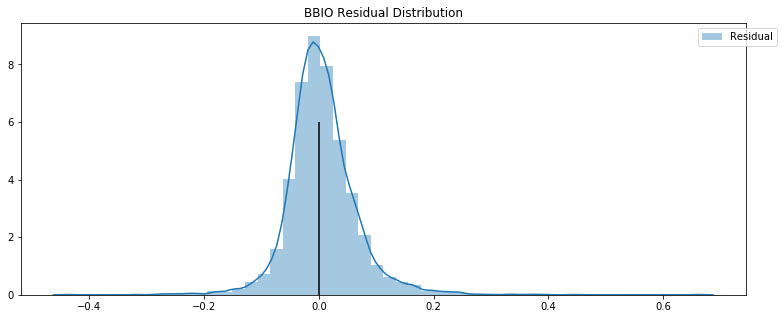

FGEN -0.019850172347994022 -0.007318031181849927


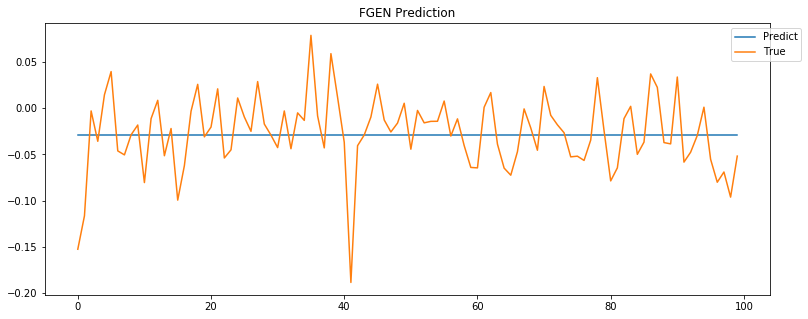

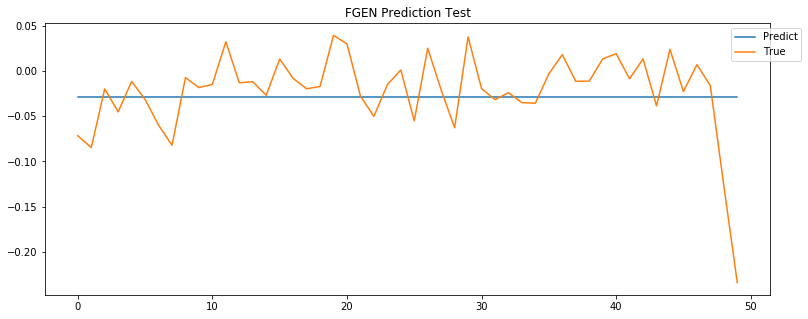

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


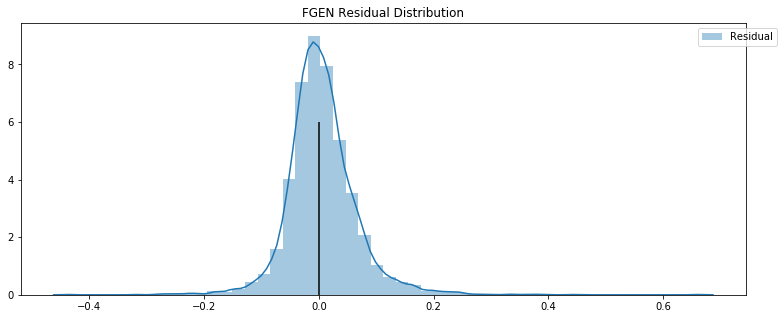

PGNX -0.019850172347994022 -0.007318031181849927


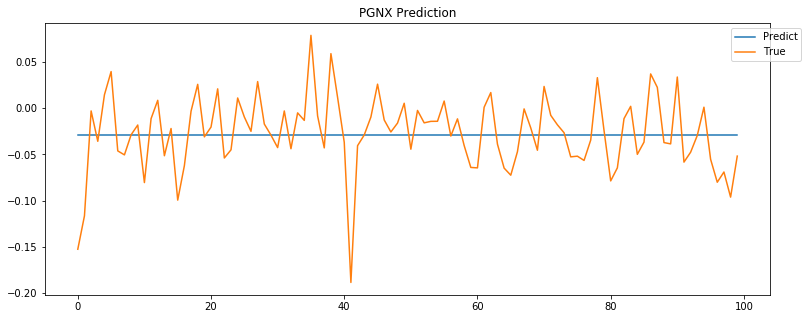

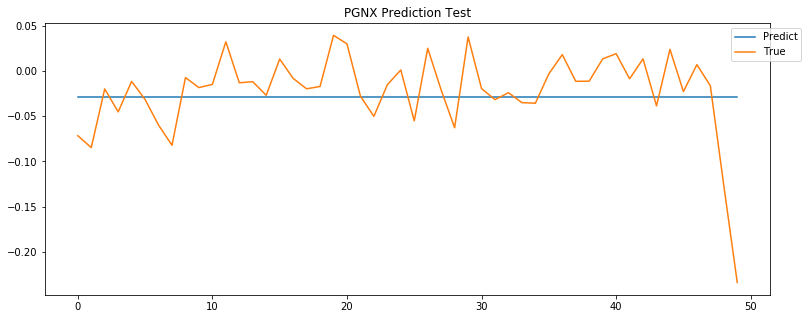

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


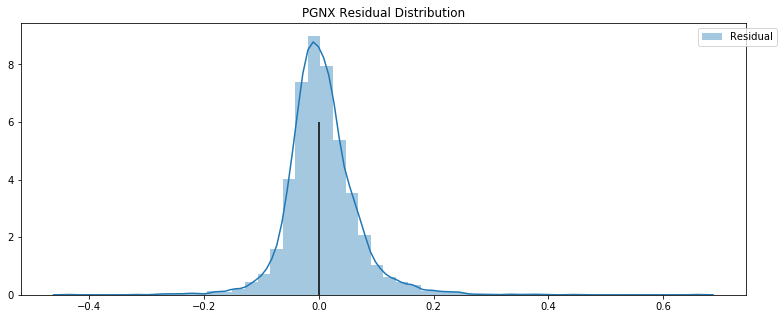

MGTX -0.019850172347994022 -0.007318031181849927


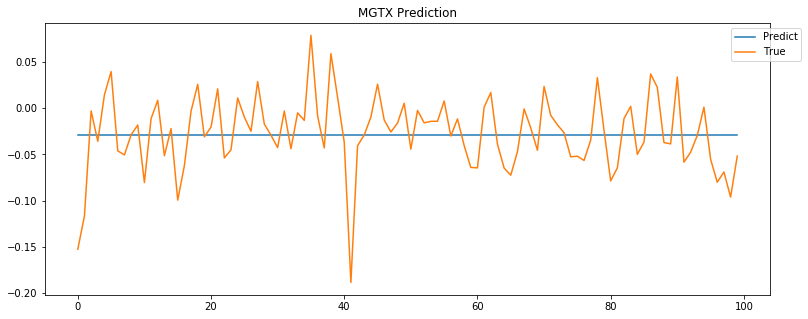

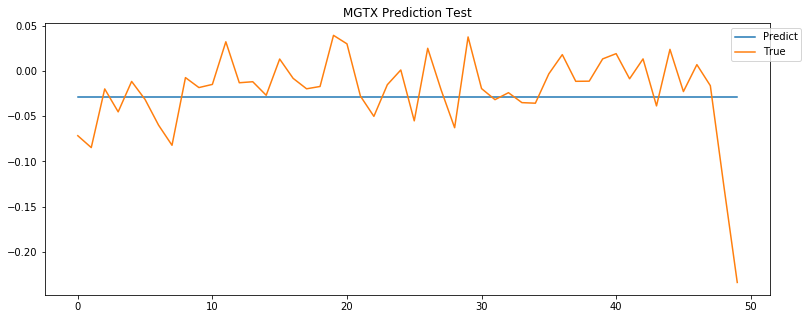

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


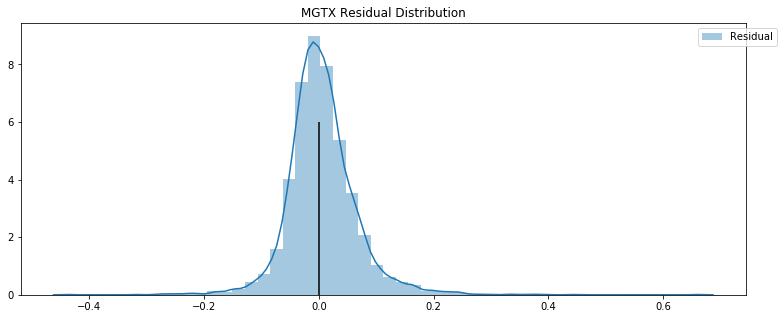

NXTC -0.019850172347994022 -0.007318031181849927


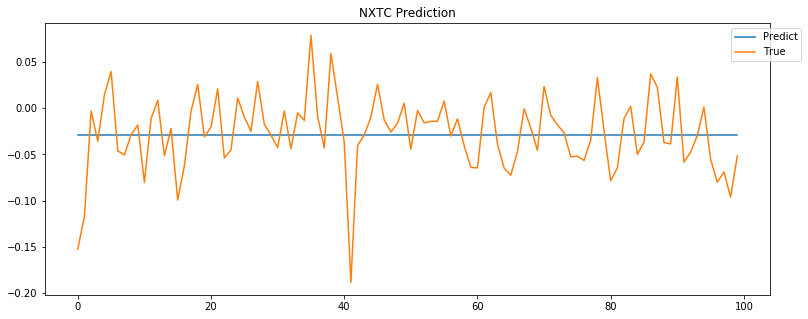

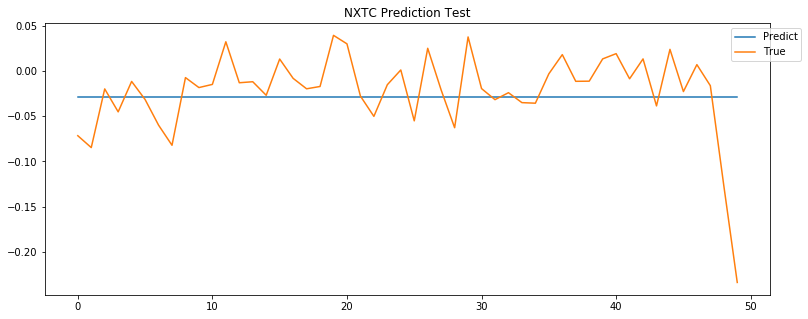

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


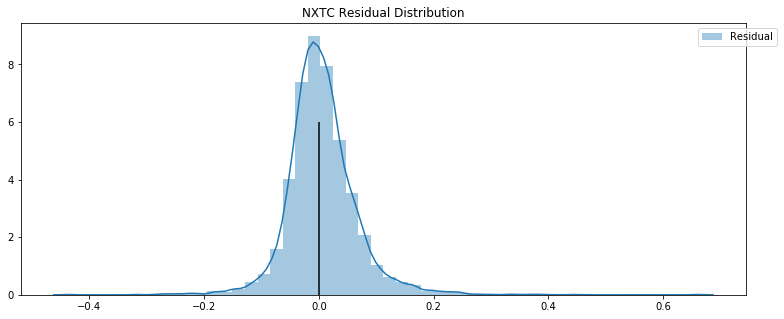

IMMU -0.019850172347994022 -0.007318031181849927


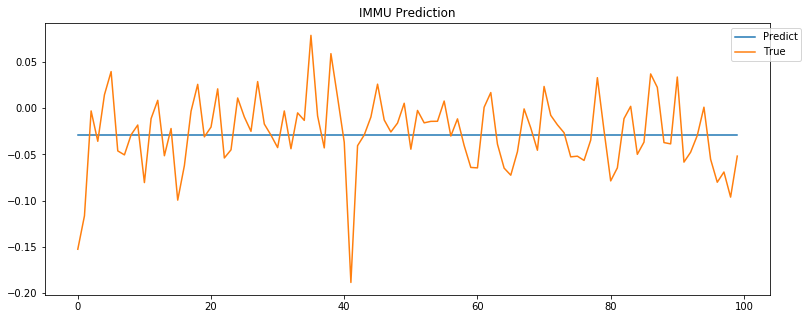

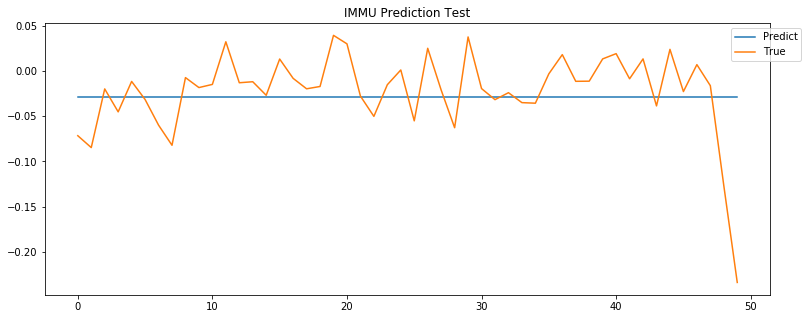

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


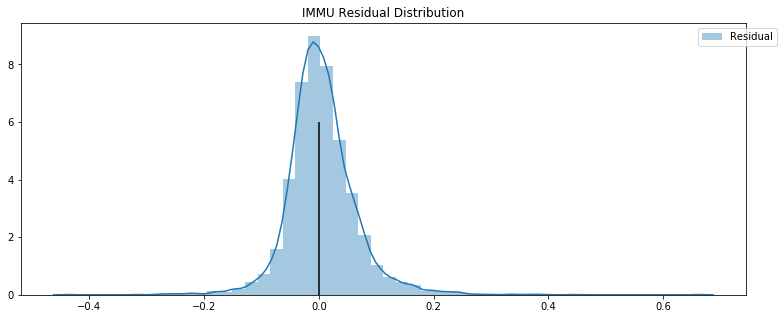

ZIOP -0.019850172347994022 -0.007318031181849927


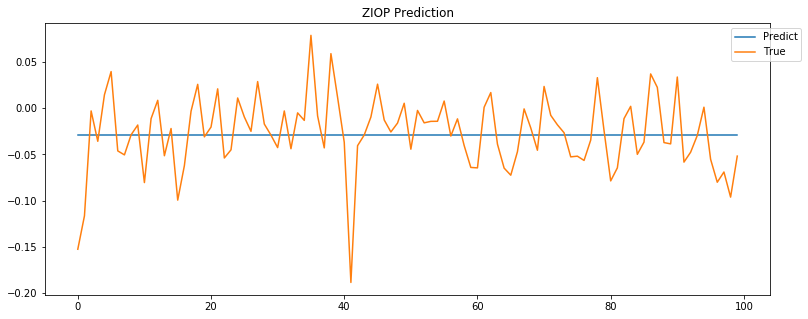

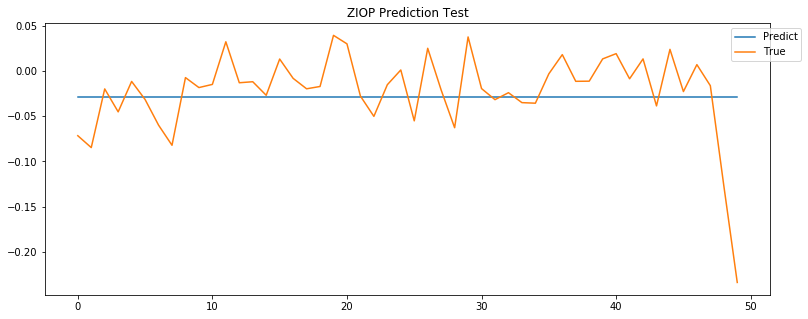

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


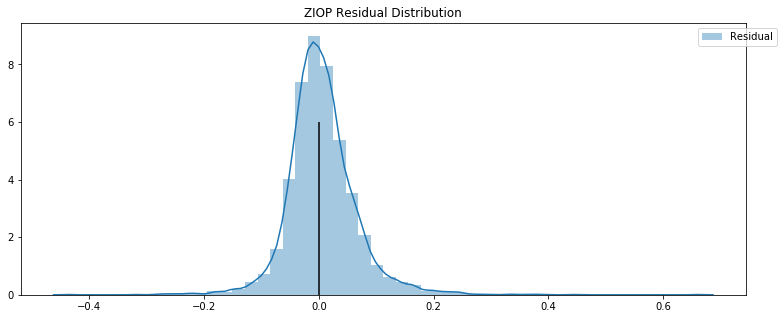

CRSP -0.019850172347994022 -0.007318031181849927


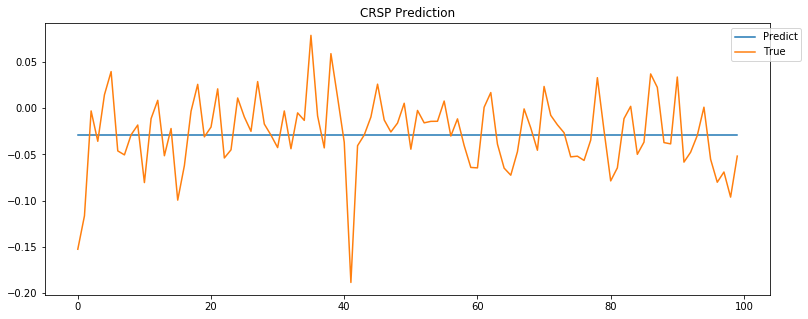

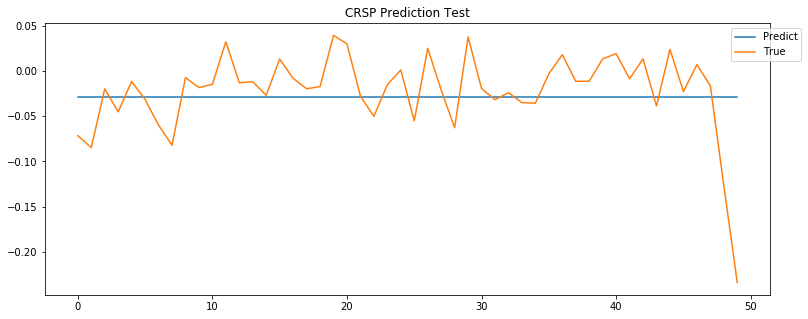

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


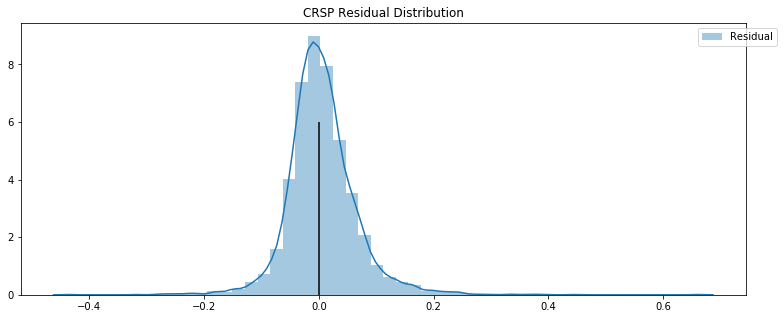

IOVA -0.019850172347994022 -0.007318031181849927


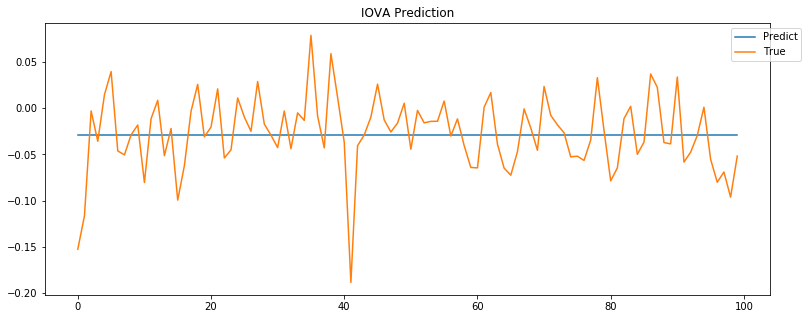

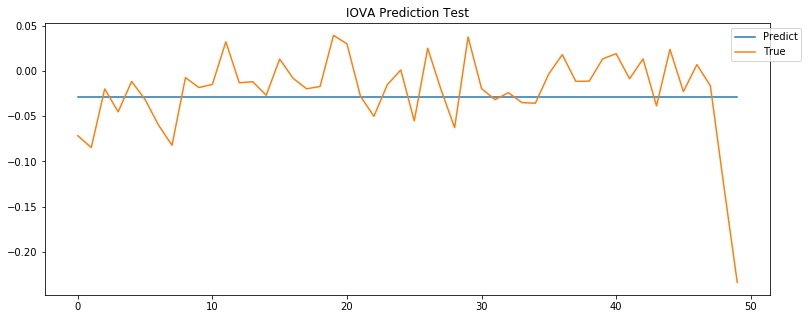

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


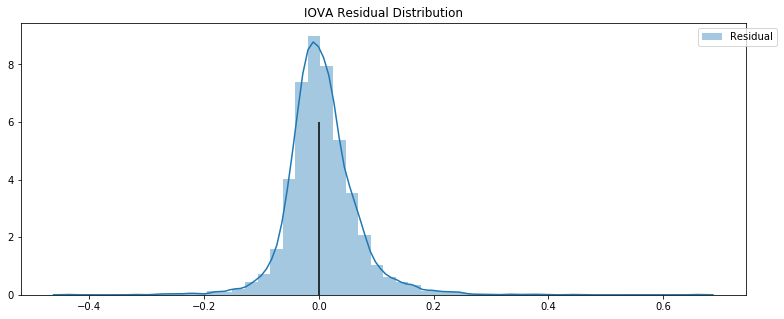

VKTX -0.019850172347994022 -0.007318031181849927


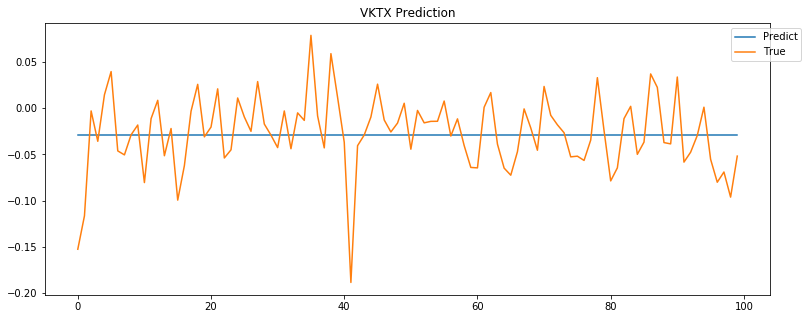

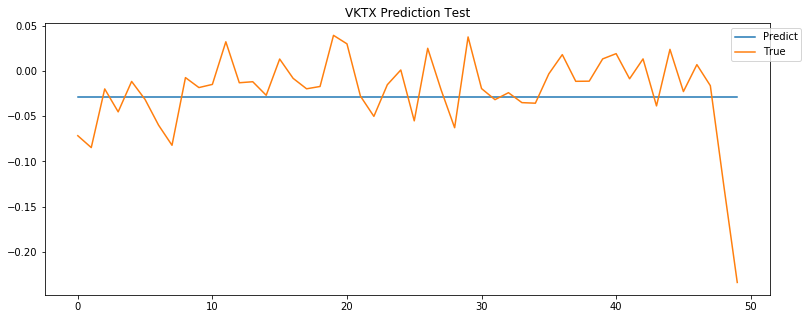

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


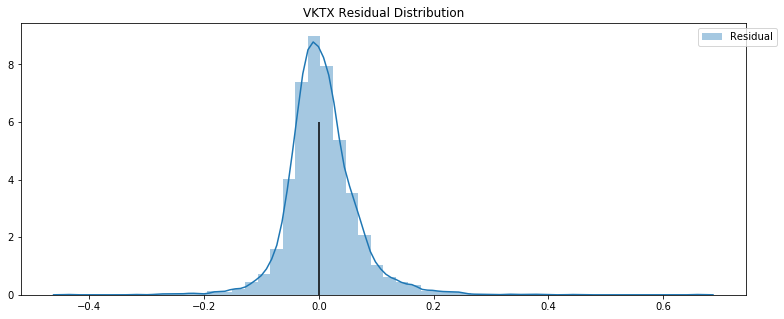

EIDX -0.019850172347994022 -0.007318031181849927


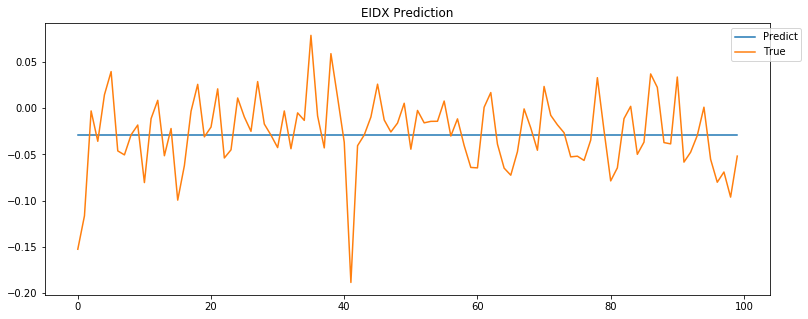

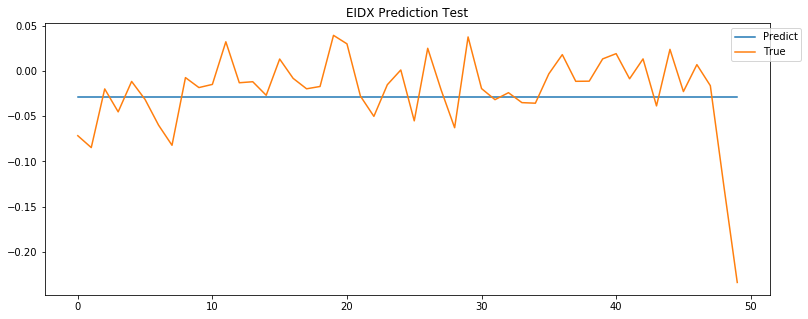

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


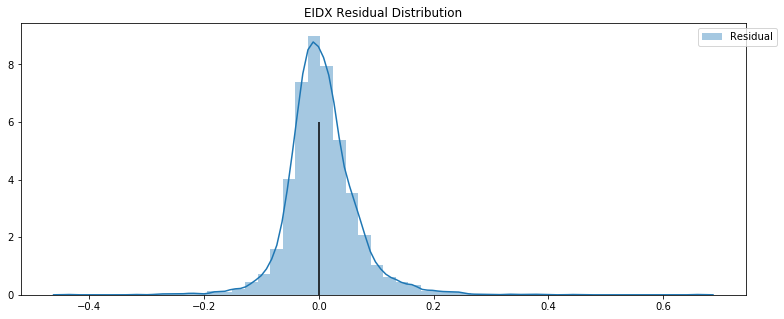

MYOV -0.019850172347994022 -0.007318031181849927


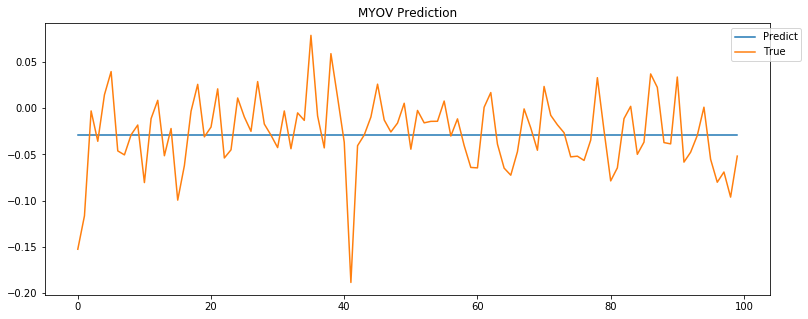

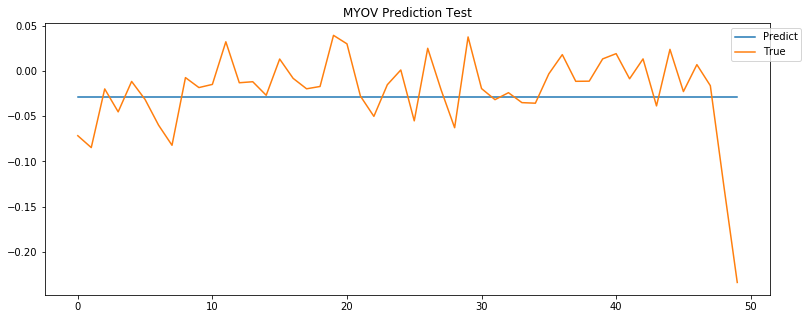

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


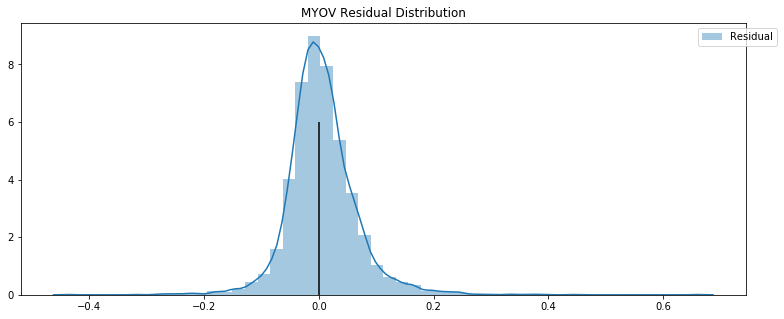

AMRS -0.019850172347994022 -0.007318031181849927


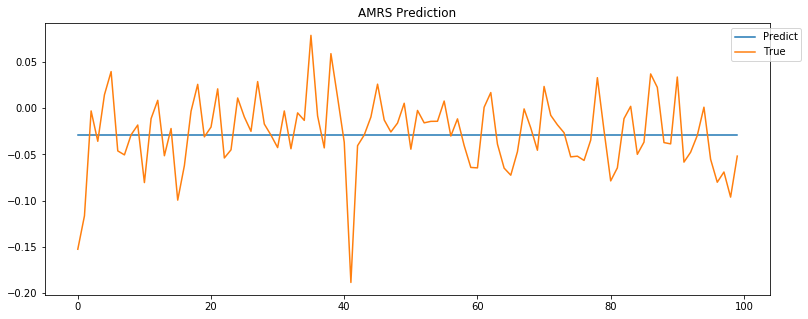

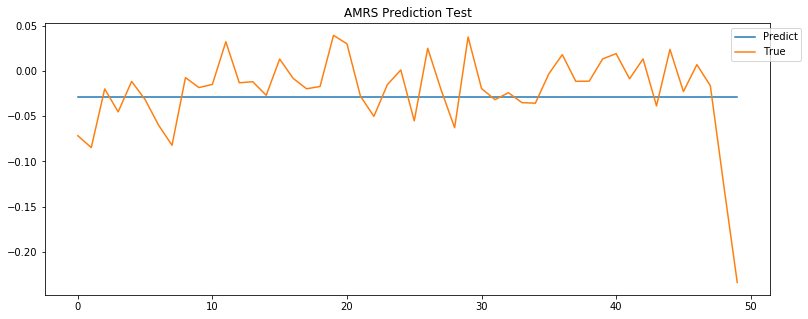

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


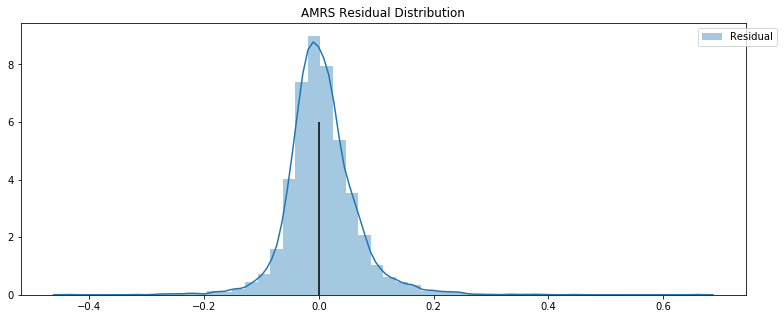

KRYS -0.019850172347994022 -0.007318031181849927


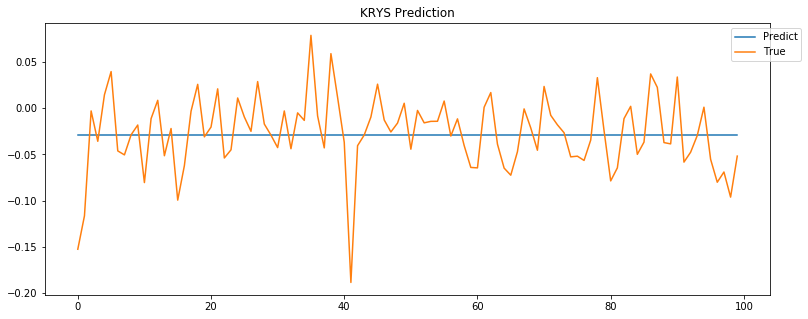

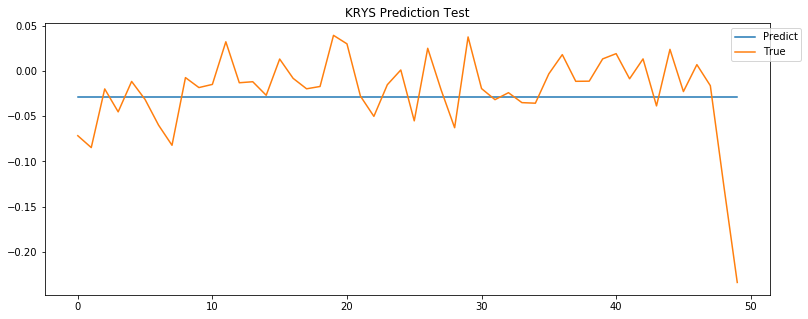

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


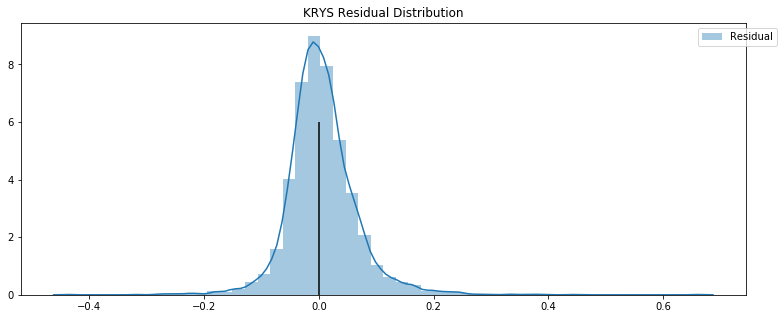

KURA -0.019850172347994022 -0.007318031181849927


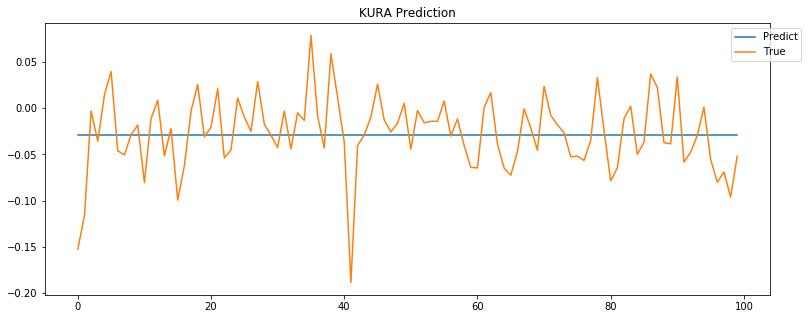

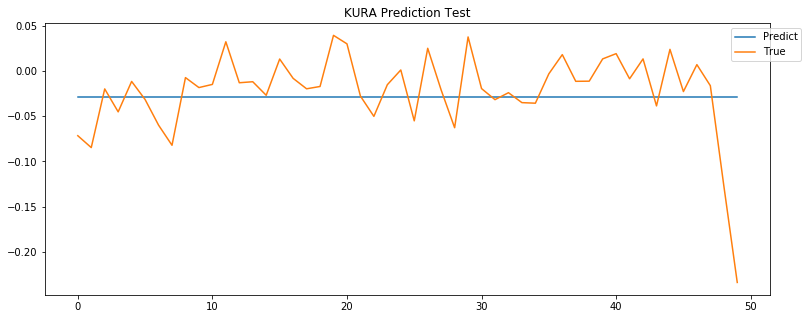

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


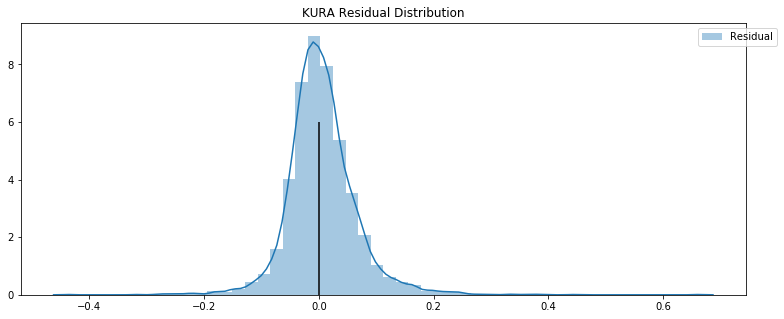

MDGL -0.019850172347994022 -0.007318031181849927


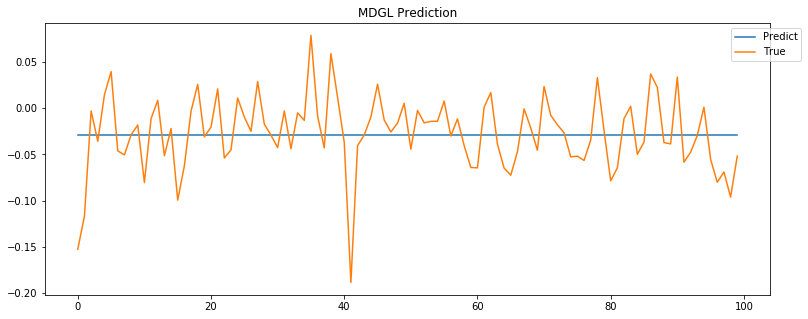

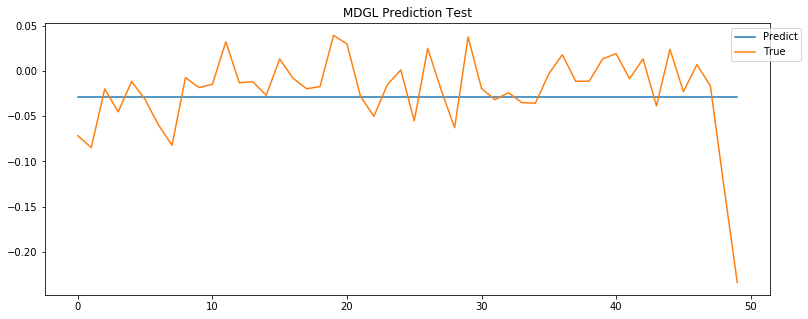

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


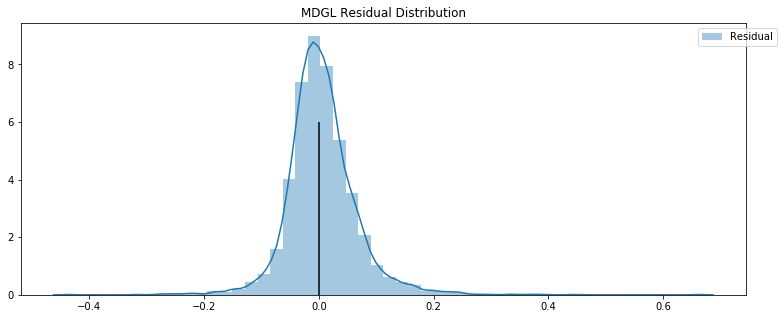

UBX -0.019850172347994022 -0.007318031181849927


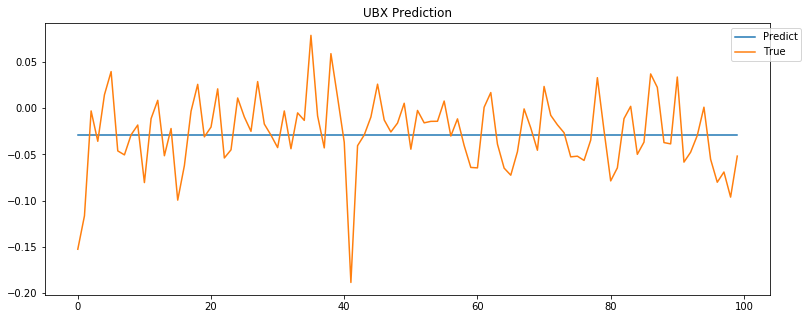

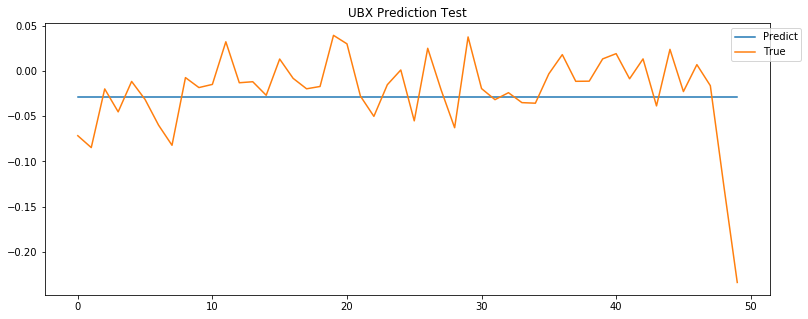

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


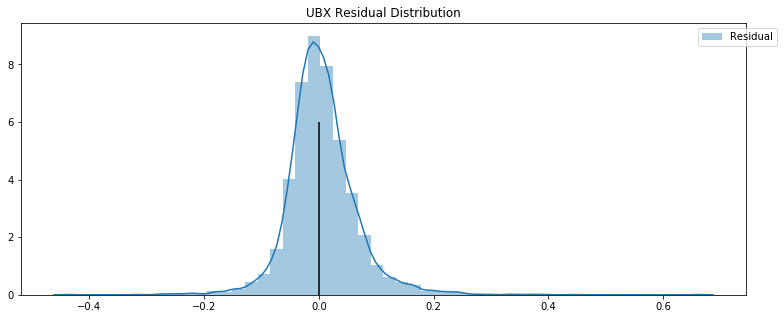

TCDA -0.019850172347994022 -0.007318031181849927


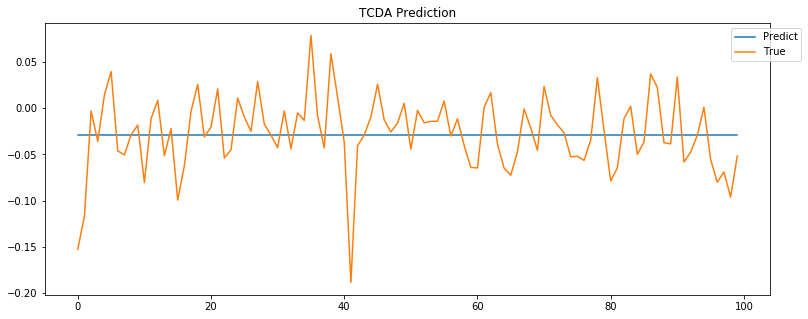

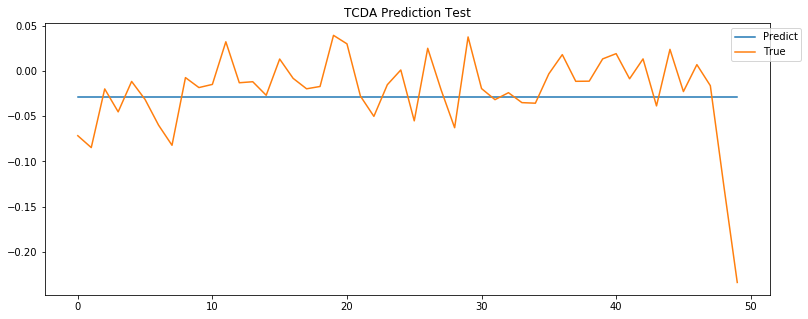

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


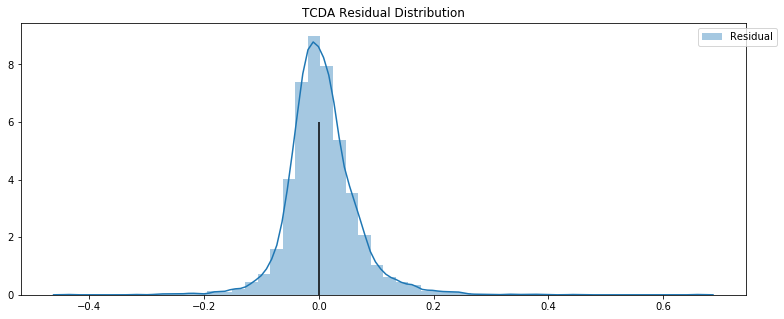

QURE -0.019850172347994022 -0.007318031181849927


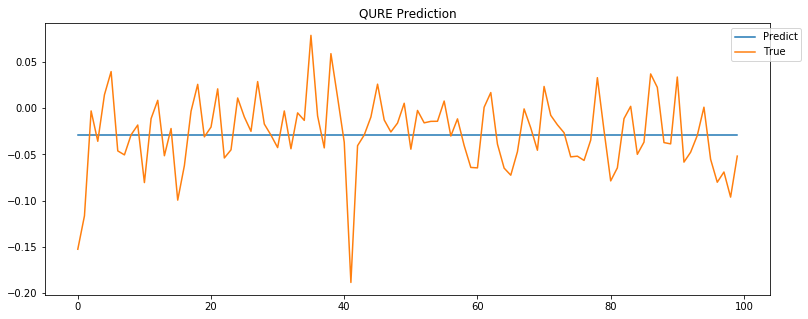

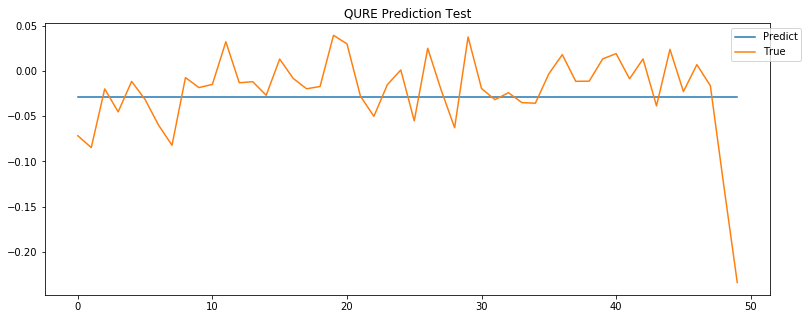

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


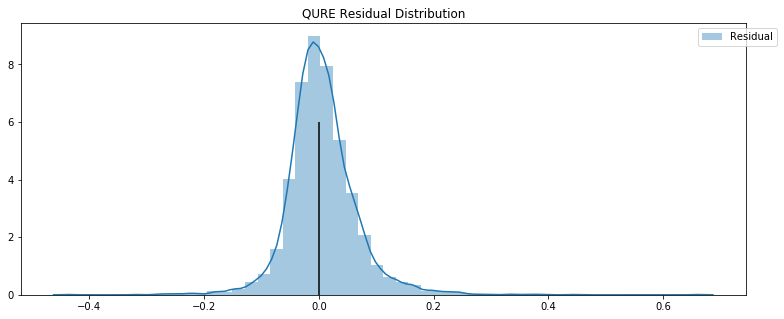

MRTX -0.019850172347994022 -0.007318031181849927


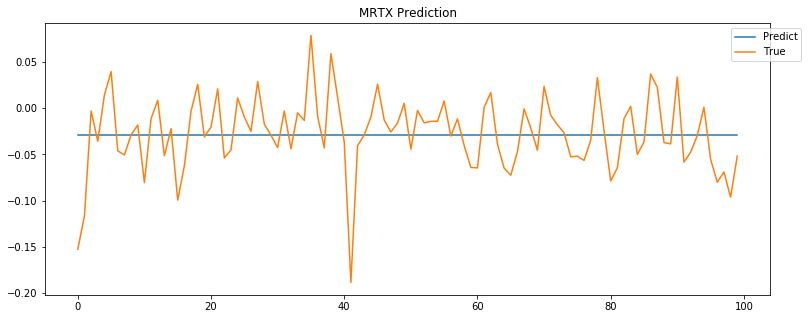

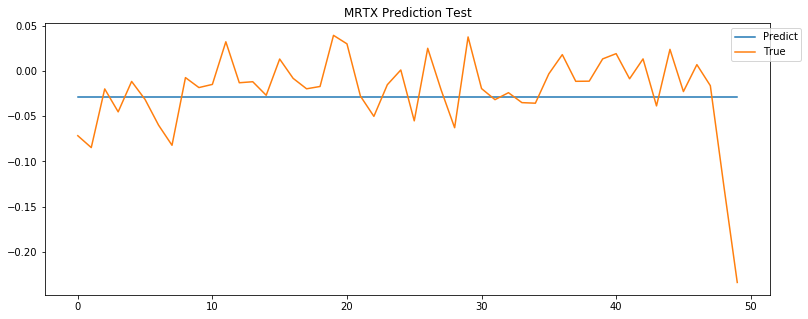

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


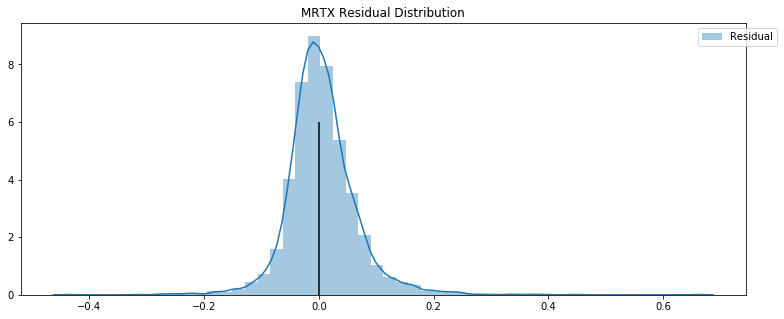

ASMB -0.019850172347994022 -0.007318031181849927


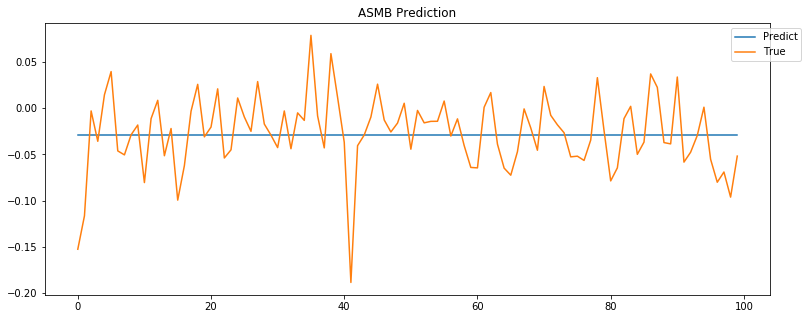

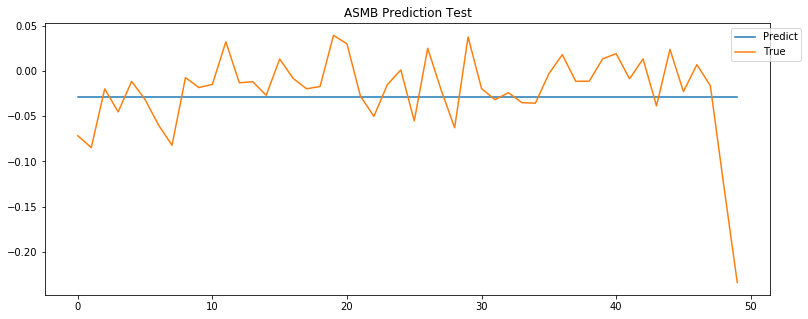

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


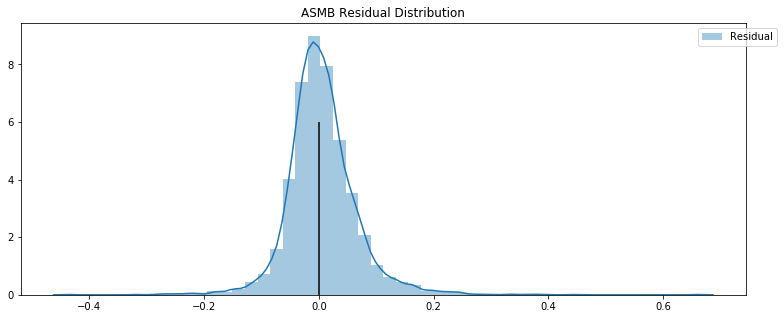

GLYC -0.019850172347994022 -0.007318031181849927


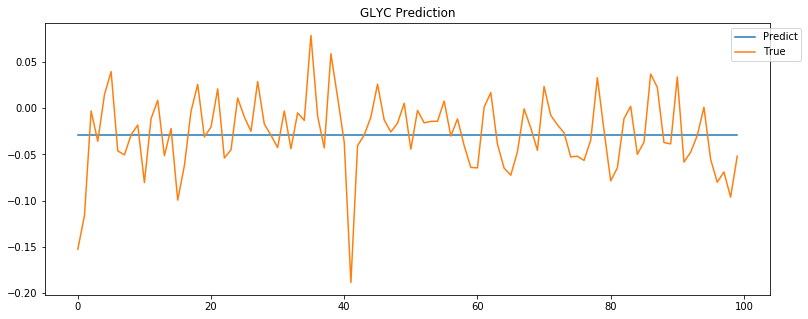

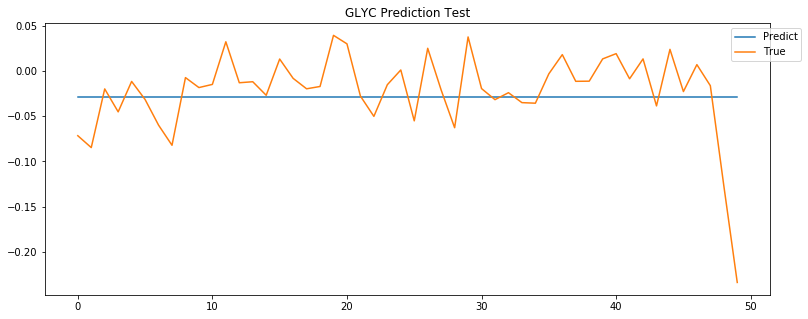

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


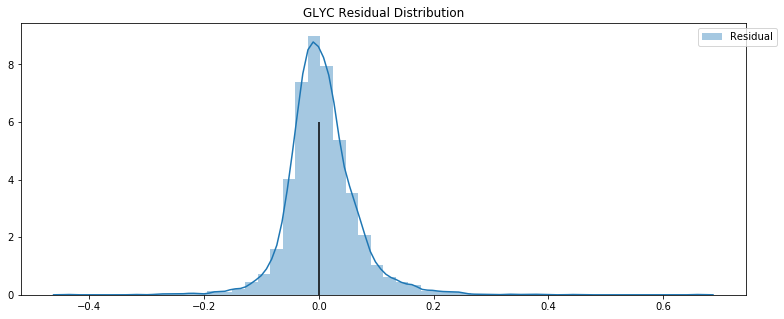

RYTM -0.019850172347994022 -0.007318031181849927


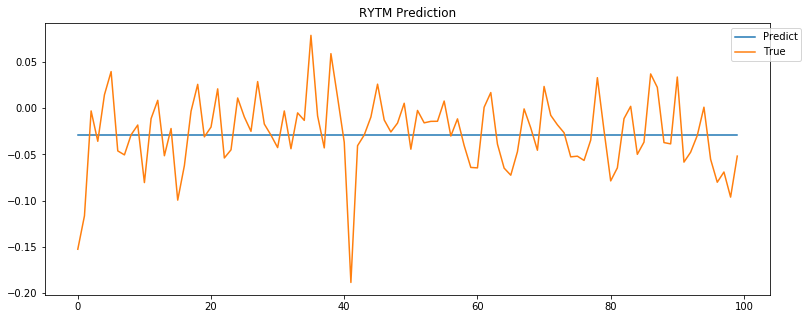

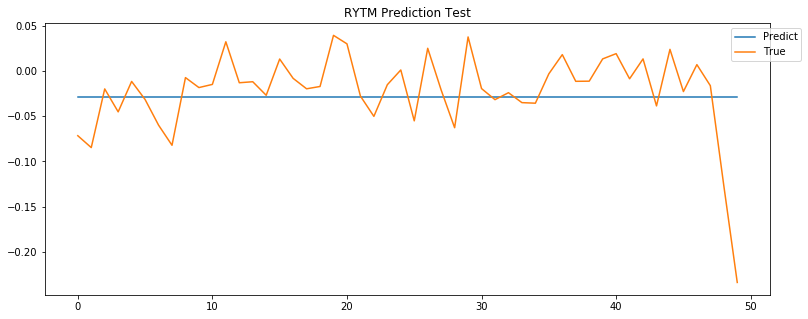

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


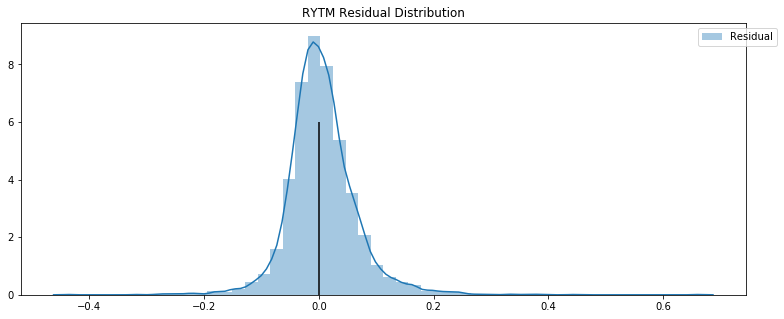

FIXX -0.019850172347994022 -0.007318031181849927


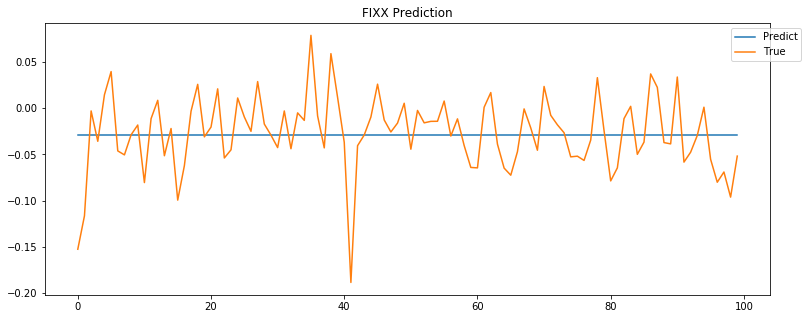

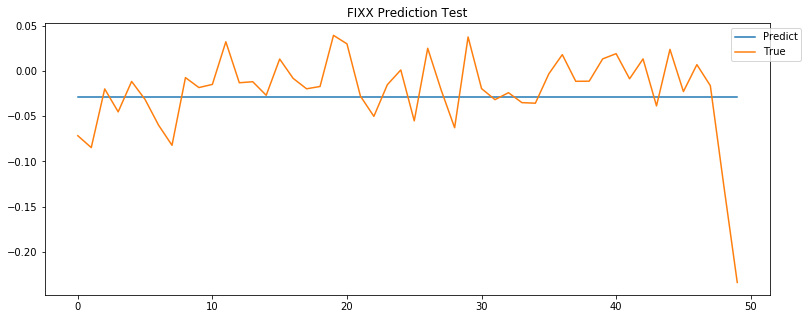

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


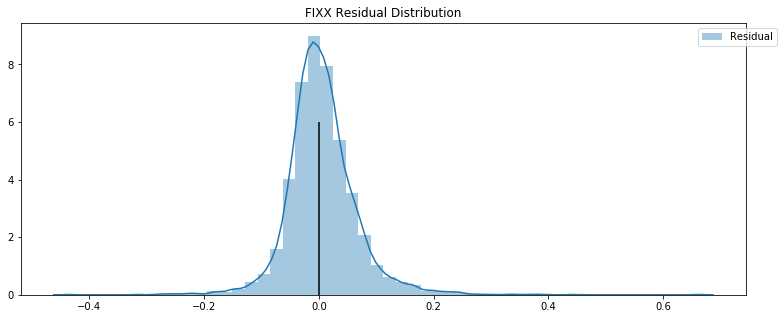

DRNA -0.019850172347994022 -0.007318031181849927


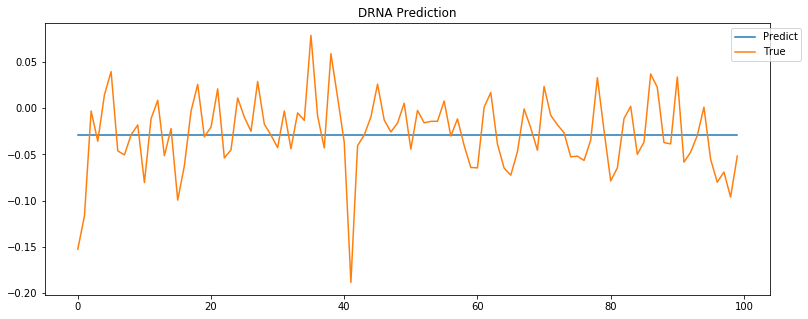

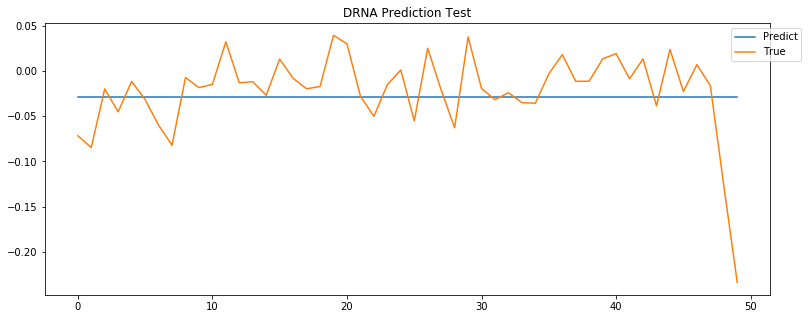

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


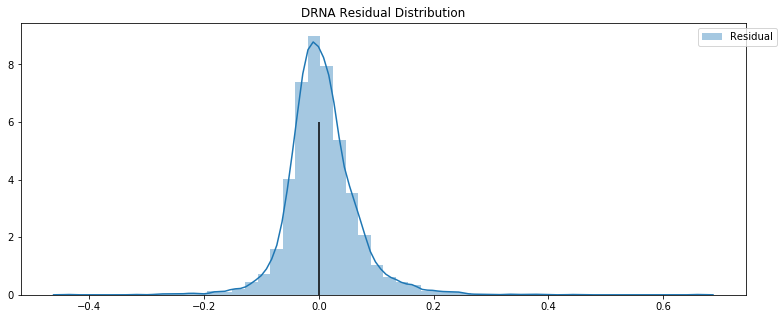

ARWR -0.019850172347994022 -0.007318031181849927


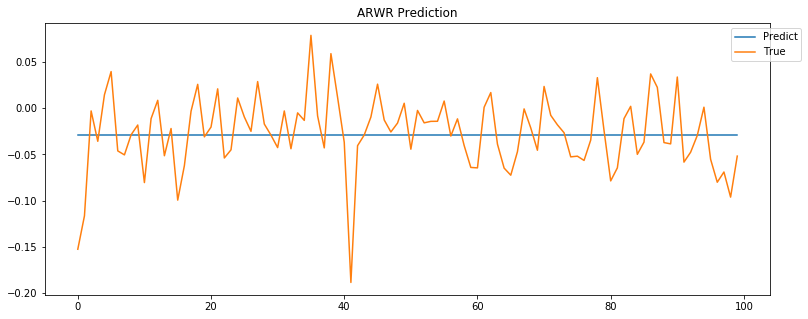

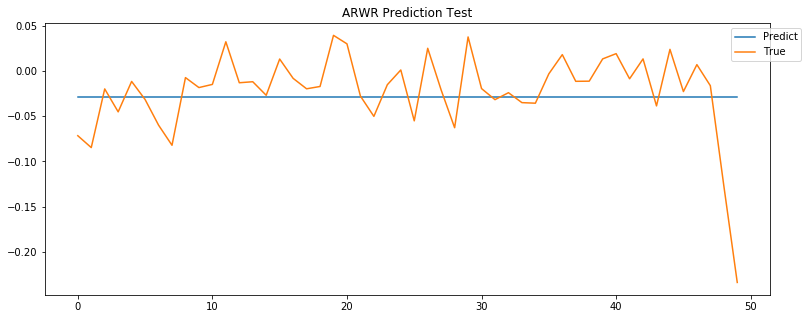

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


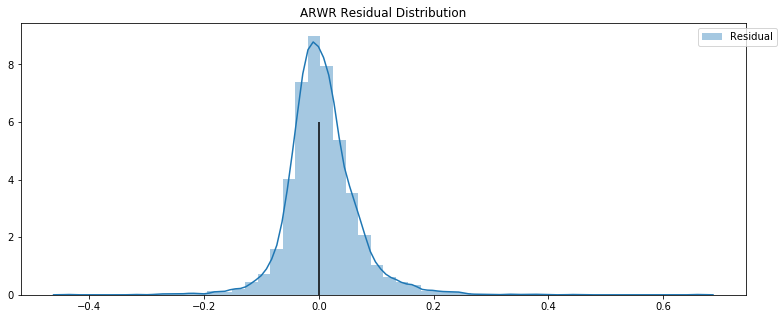

ALLK -0.019850172347994022 -0.007318031181849927


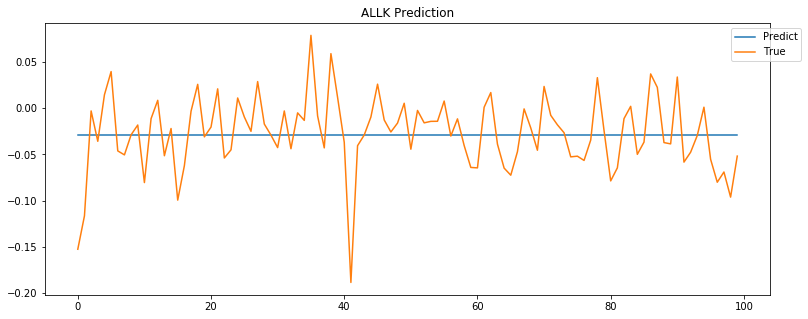

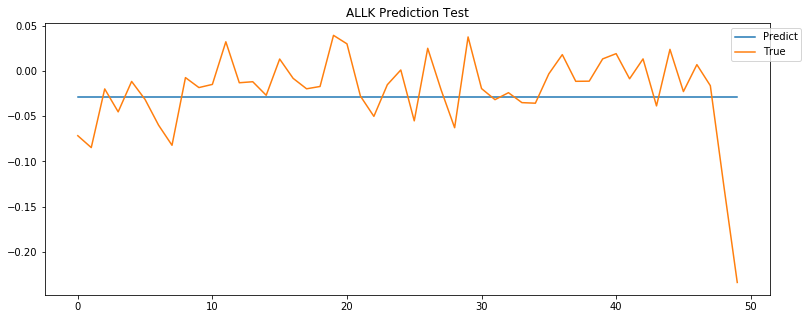

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


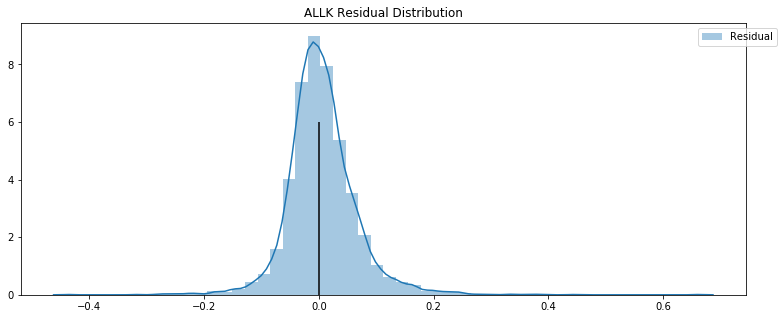

GOSS -0.019850172347994022 -0.007318031181849927


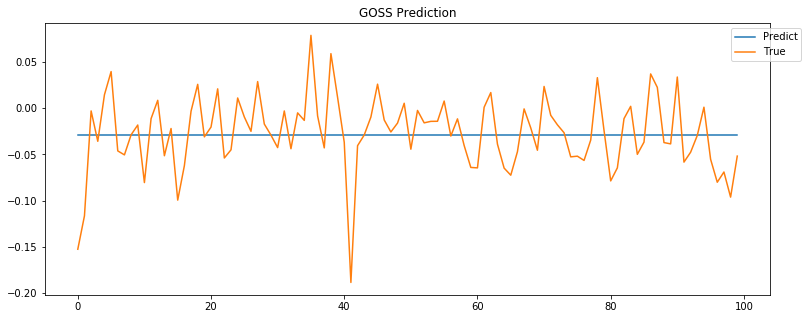

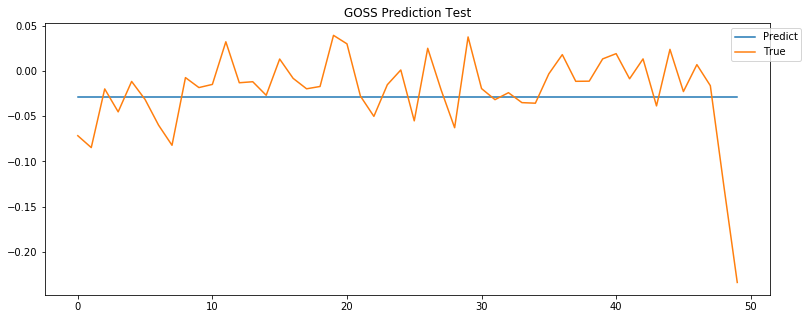

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


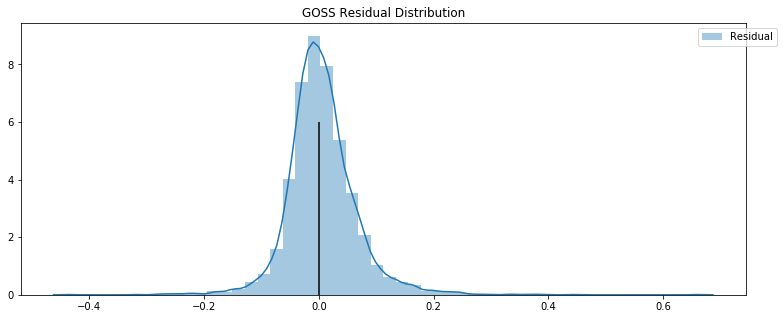

WVE -0.019850172347994022 -0.007318031181849927


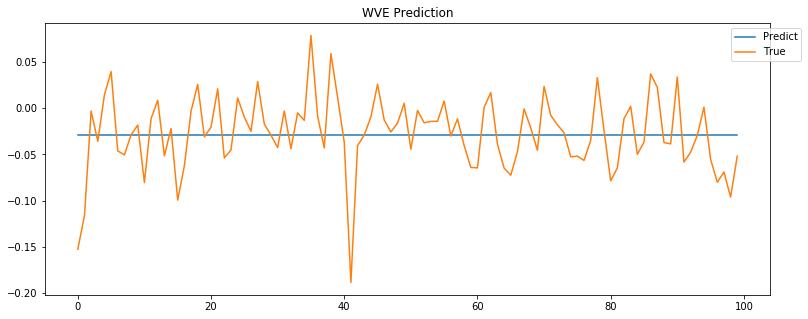

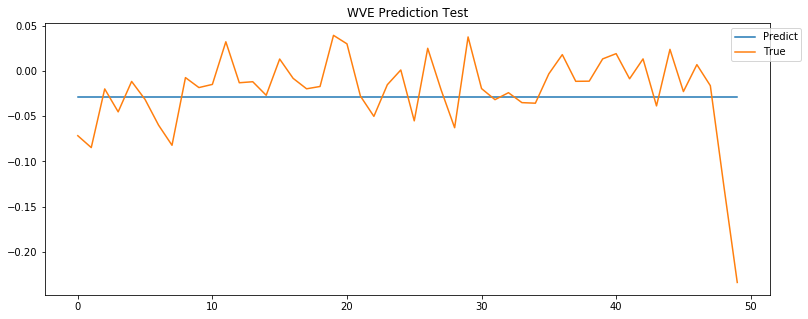

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


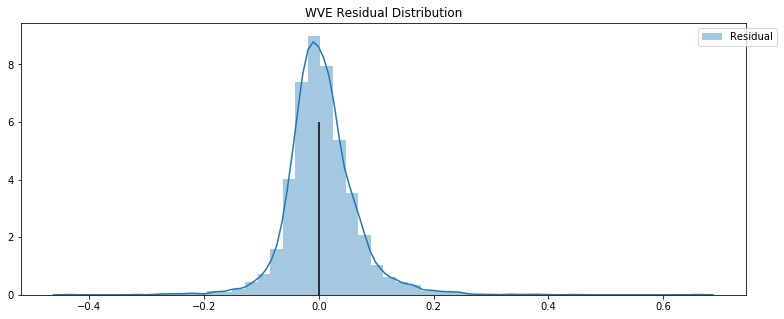

In [22]:
for stock in stocks:
    predict_train = model.predict(feature_train, batch_size=25)
    predict_test = model.predict(feature_test, batch_size=25)
    print(stock,r2_score(label_test, predict_test), r2_score(label_train, predict_train))
    plt.figure(figsize=(13,5))
    plt.title(f"{stock} Prediction")
    plt.plot(predict_train[-100:], label = 'Predict')
    plt.plot(label_train[-100:], label= 'True')
    plt.legend(bbox_to_anchor=(1.05, 1))
    plt.show()

    plt.figure(figsize=(13,5))
    plt.title(f"{stock} Prediction Test")
    plt.plot(predict_test[-100:], label = 'Predict')
    plt.plot(label_test[-100:], label= 'True')
    plt.legend(bbox_to_anchor=(1.05, 1))
    plt.show()
    plt.figure(figsize=(13,5))
    plt.title(f"{stock} Residual Distribution")
    sns.distplot(predict_train- label_train, label = 'Residual')
    plt.vlines(0,0,6)
    plt.legend(bbox_to_anchor=(1.05, 1))
    plt.show()
    

Train on 4950 samples, validate on 50 samples
Epoch 1/1000
4950/4950 [==============================] - 1s 191us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 2/1000
4950/4950 [==============================] - 1s 186us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 3/1000
4950/4950 [==============================] - 1s 186us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 4/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 5/1000
4950/4950 [==============================] - 1s 180us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 6/1000
4950/4950 [==============================] - 1s 186us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 7/1000
4950/4950 [==============================] - 1s 184us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 8/1000
4950/4950 [==============================] - 1s 176us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 9/1000
4950/4950 [==============================] - 1s 192us/step - loss: 0.0033 - val_loss: 0.0025


Epoch 77/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 78/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 79/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 80/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 81/1000
4950/4950 [==============================] - 1s 174us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 82/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 83/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 84/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 85/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 86/1000
4950/4950 [============

4950/4950 [==============================] - 1s 179us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 154/1000
4950/4950 [==============================] - 1s 181us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 155/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 156/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 157/1000
4950/4950 [==============================] - 1s 175us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 158/1000
4950/4950 [==============================] - 1s 176us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 159/1000
4950/4950 [==============================] - 1s 177us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 160/1000
4950/4950 [==============================] - 1s 176us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 161/1000
4950/4950 [==============================] - 1s 177us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 162/1000
4950/4950 [=================

Epoch 229/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 230/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 231/1000
4950/4950 [==============================] - 1s 177us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 232/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 233/1000
4950/4950 [==============================] - 1s 176us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 234/1000
4950/4950 [==============================] - 1s 175us/step - loss: 0.0033 - val_loss: 0.0024
Epoch 235/1000
4950/4950 [==============================] - 1s 187us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 236/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 237/1000
4950/4950 [==============================] - 1s 175us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 238/1000
4950/4950 [==

Epoch 305/1000
4950/4950 [==============================] - 1s 180us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 306/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 307/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 308/1000
4950/4950 [==============================] - 1s 181us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 309/1000
4950/4950 [==============================] - 1s 202us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 310/1000
4950/4950 [==============================] - 1s 204us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 311/1000
4950/4950 [==============================] - 1s 195us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 312/1000
4950/4950 [==============================] - 1s 187us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 313/1000
4950/4950 [==============================] - 1s 186us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 314/1000
4950/4950 [==

Epoch 381/1000
4950/4950 [==============================] - 1s 187us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 382/1000
4950/4950 [==============================] - 1s 185us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 383/1000
4950/4950 [==============================] - 1s 194us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 384/1000
4950/4950 [==============================] - 1s 195us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 385/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 386/1000
4950/4950 [==============================] - 1s 205us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 387/1000
4950/4950 [==============================] - 1s 187us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 388/1000
4950/4950 [==============================] - 1s 174us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 389/1000
4950/4950 [==============================] - 1s 175us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 390/1000
4950/4950 [==

4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 457/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 458/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 459/1000
4950/4950 [==============================] - 1s 180us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 460/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 461/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 462/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 463/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 464/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 465/1000
4950/4950 [=================

Epoch 532/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 533/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 534/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 535/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 536/1000
4950/4950 [==============================] - 1s 177us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 537/1000
4950/4950 [==============================] - 1s 189us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 538/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 539/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 540/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 541/1000
4950/4950 [==

Epoch 608/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 609/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 610/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 611/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 612/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 613/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 614/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 615/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 616/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 617/1000
4950/4950 [==

Epoch 684/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 685/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 686/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 687/1000
4950/4950 [==============================] - 1s 181us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 688/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 689/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 690/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 691/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 692/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 693/1000
4950/4950 [==

Epoch 760/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 761/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 762/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 763/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 764/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 765/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 766/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 767/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 768/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 769/1000
4950/4950 [==

Epoch 836/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 837/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 838/1000
4950/4950 [==============================] - 1s 184us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 839/1000
4950/4950 [==============================] - 1s 184us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 840/1000
4950/4950 [==============================] - 1s 174us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 841/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 842/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 843/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 844/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 845/1000
4950/4950 [==

Epoch 912/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 913/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 914/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 915/1000
4950/4950 [==============================] - 1s 171us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 916/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 917/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 918/1000
4950/4950 [==============================] - 1s 172us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 919/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 920/1000
4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 921/1000
4950/4950 [==

4950/4950 [==============================] - 1s 173us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 988/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 989/1000
4950/4950 [==============================] - 1s 187us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 990/1000
4950/4950 [==============================] - 1s 188us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 991/1000
4950/4950 [==============================] - 1s 196us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 992/1000
4950/4950 [==============================] - 1s 198us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 993/1000
4950/4950 [==============================] - 1s 203us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 994/1000
4950/4950 [==============================] - 1s 204us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 995/1000
4950/4950 [==============================] - 1s 214us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 996/1000
4950/4950 [=================

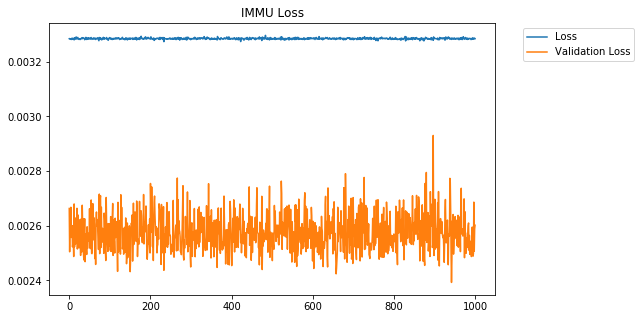

In [23]:
stock = 'IMMU'
(feature_train, label_train, feature_test, label_test) = (processed_data[stock]['data_1'],processed_data[stock]['target_1'], 
                                                                    processed_data[stock]['data_test'], processed_data[stock]['target_test']) 
model.fit(feature_train, label_train, batch_size=25, epochs=1000, validation_data = (feature_test, label_test))
dict_ = model.history.history
plt.figure(figsize=(8,5))
plt.title(f"{stock} Loss")
plt.plot(dict_['loss'], label = 'Loss')
plt.plot(dict_['val_loss'], label= 'Validation Loss')
plt.legend(bbox_to_anchor=(1.05, 1))
plt.show()
model.save('model_stateful.h5')

Train on 4950 samples, validate on 50 samples
Epoch 1/1000
4950/4950 [==============================] - 1s 177us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 2/1000
4950/4950 [==============================] - 1s 176us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 3/1000
4950/4950 [==============================] - 1s 199us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 4/1000
4950/4950 [==============================] - 1s 190us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 5/1000
4950/4950 [==============================] - 1s 183us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 6/1000
4950/4950 [==============================] - 1s 207us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 7/1000
4950/4950 [==============================] - 1s 211us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 8/1000
4950/4950 [==============================] - 1s 196us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 9/1000
4950/4950 [==============================] - 1s 210us/step - loss: 0.0049 - val_loss: 0.0027


4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 78/1000
4950/4950 [==============================] - 1s 189us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 79/1000
4950/4950 [==============================] - 1s 182us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 80/1000
4950/4950 [==============================] - 1s 186us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 81/1000
4950/4950 [==============================] - 1s 182us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 82/1000
4950/4950 [==============================] - 1s 181us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 83/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 84/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 85/1000
4950/4950 [==============================] - 1s 192us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 86/1000
4950/4950 [==========================

4950/4950 [==============================] - 1s 182us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 154/1000
4950/4950 [==============================] - 1s 182us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 155/1000
4950/4950 [==============================] - 1s 182us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 156/1000
4950/4950 [==============================] - 1s 182us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 157/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 158/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0028
Epoch 159/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 160/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 161/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 162/1000
4950/4950 [=================

Epoch 229/1000
4950/4950 [==============================] - 1s 182us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 230/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 231/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 232/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 233/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 234/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 235/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 236/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 237/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 238/1000
4950/4950 [==

Epoch 305/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 306/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 307/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 308/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 309/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 310/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 311/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 312/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 313/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 314/1000
4950/4950 [==

Epoch 381/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 382/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 383/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 384/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 385/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 386/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0028
Epoch 387/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 388/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 389/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 390/1000
4950/4950 [==

Epoch 457/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 458/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 459/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 460/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 461/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 462/1000
4950/4950 [==============================] - 1s 177us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 463/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 464/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 465/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 466/1000
4950/4950 [==

Epoch 533/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 534/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 535/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 536/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 537/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 538/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 539/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 540/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 541/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 542/1000
4950/4950 [==

4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 609/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 610/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 611/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 612/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 613/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 614/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 615/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 616/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 617/1000
4950/4950 [=================

Epoch 684/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 685/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 686/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 687/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 688/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 689/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 690/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 691/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0028
Epoch 692/1000
4950/4950 [==============================] - 1s 180us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 693/1000
4950/4950 [==

Epoch 760/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 761/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 762/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 763/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 764/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 765/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0028
Epoch 766/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0028
Epoch 767/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 768/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 769/1000
4950/4950 [==

Epoch 836/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 837/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 838/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 839/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 840/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 841/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 842/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 843/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 844/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 845/1000
4950/4950 [==

Epoch 912/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 913/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 914/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 915/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 916/1000
4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 917/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 918/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 919/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 920/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 921/1000
4950/4950 [==

4950/4950 [==============================] - 1s 179us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 988/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 989/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 990/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 991/1000
4950/4950 [==============================] - 1s 177us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 992/1000
4950/4950 [==============================] - 1s 185us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 993/1000
4950/4950 [==============================] - 1s 183us/step - loss: 0.0049 - val_loss: 0.0026
Epoch 994/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 995/1000
4950/4950 [==============================] - 1s 178us/step - loss: 0.0049 - val_loss: 0.0027
Epoch 996/1000
4950/4950 [=================

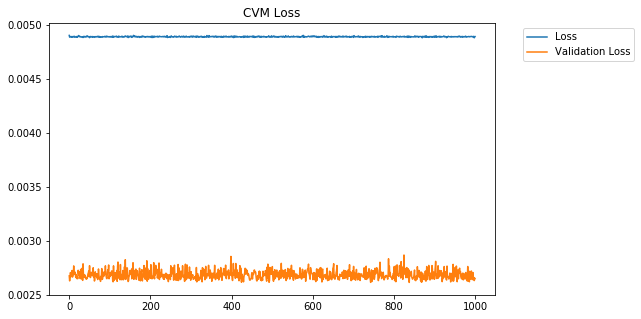

In [24]:
stock = 'CVM'
(feature_train, label_train, feature_test, label_test) = (processed_data[stock]['data_1'],processed_data[stock]['target_1'], 
                                                                    processed_data[stock]['data_test'], processed_data[stock]['target_test']) 
model.fit(feature_train, label_train, batch_size=25, epochs=1000, validation_data = (feature_test, label_test))
dict_ = model.history.history
plt.figure(figsize=(8,5))
plt.title(f"{stock} Loss")
plt.plot(dict_['loss'], label = 'Loss')
plt.plot(dict_['val_loss'], label= 'Validation Loss')
plt.legend(bbox_to_anchor=(1.05, 1))
plt.show()
model.save('model_stateful.h5')

ITCI -0.01443835573735952 -0.0008775760427972568


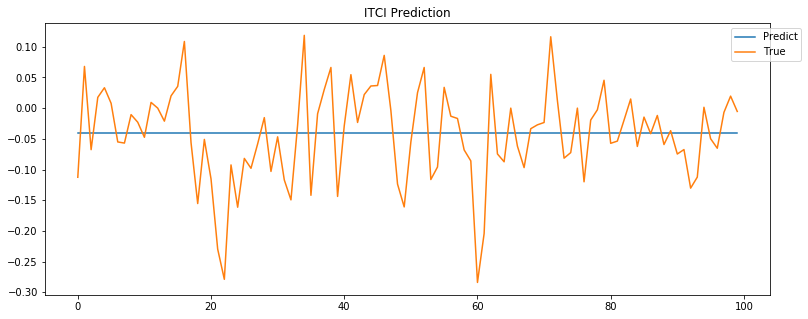

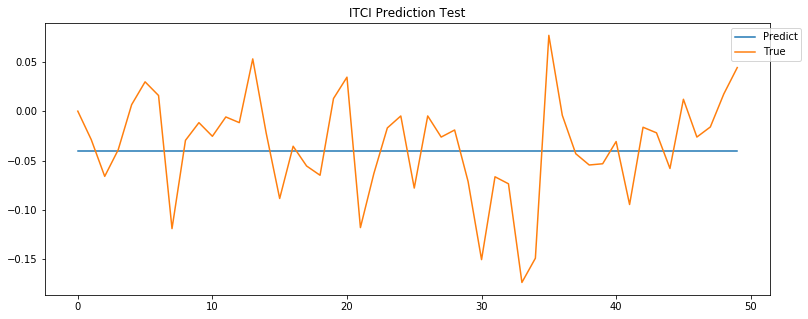

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


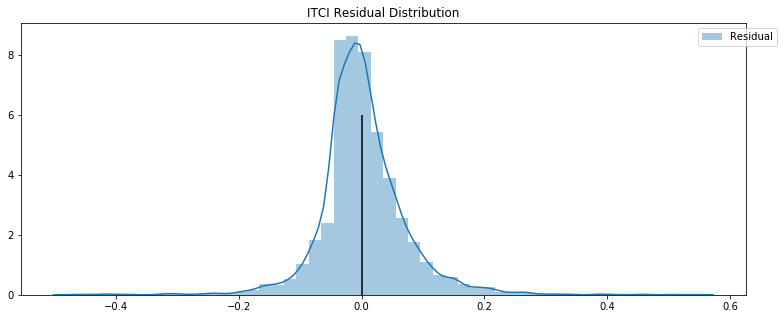

AXSM -0.01443835573735952 -0.0008775760427972568


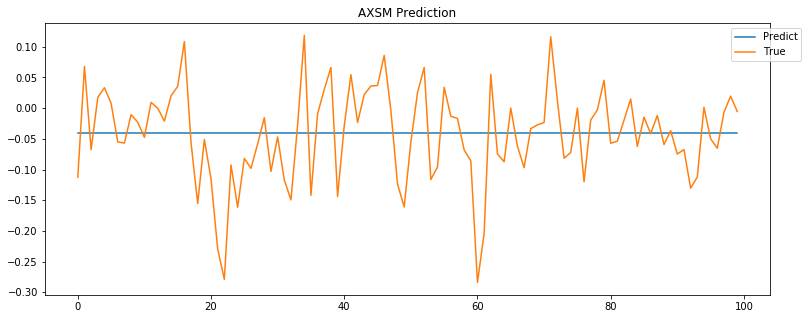

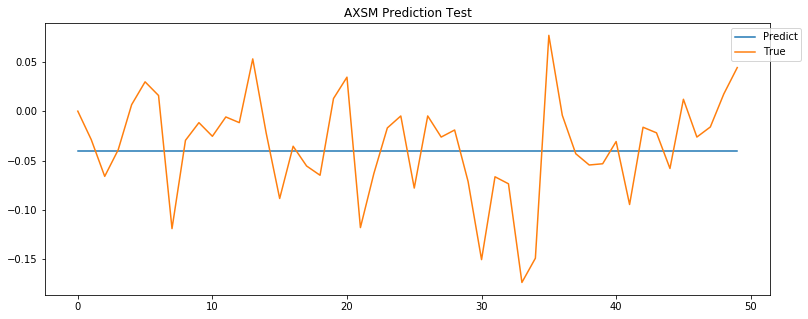

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


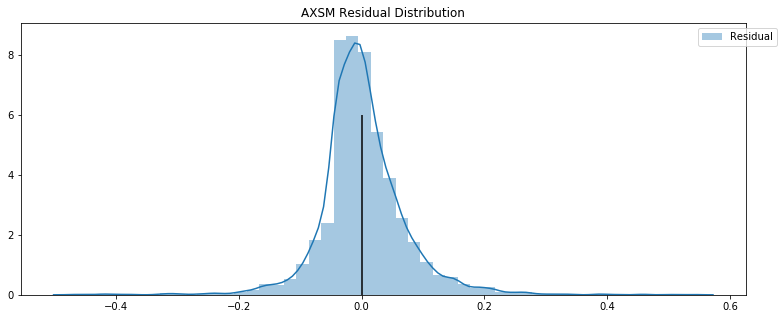

CVM -0.01443835573735952 -0.0008775760427972568


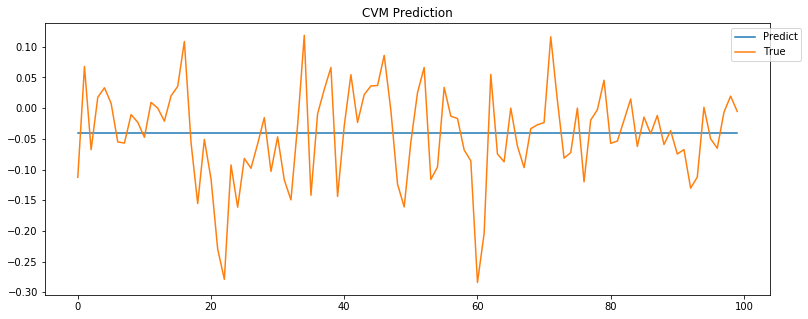

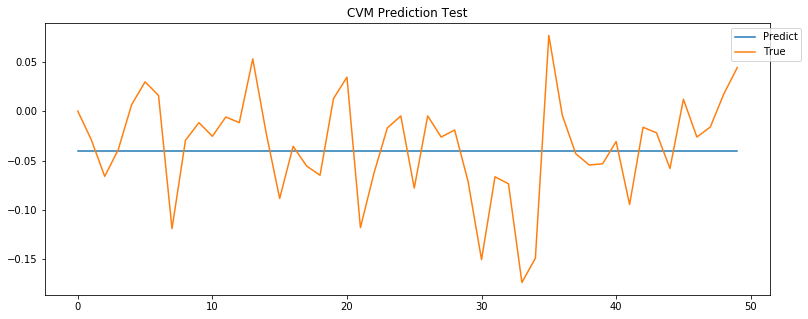

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


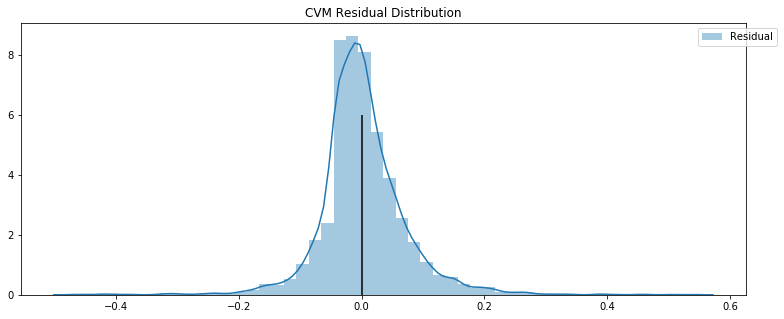

KRTX -0.01443835573735952 -0.0008775760427972568


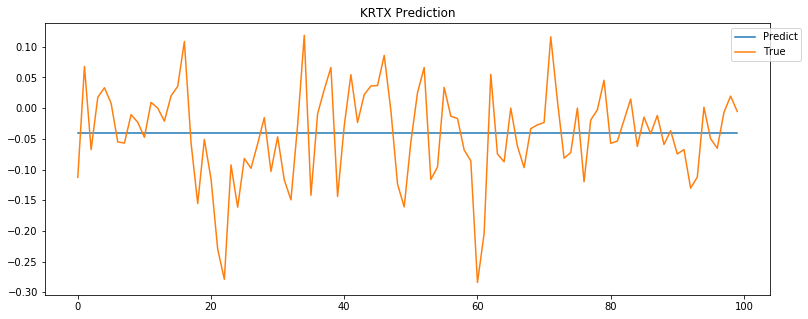

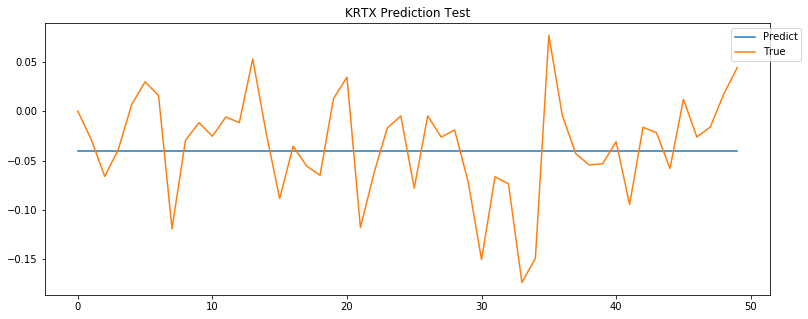

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


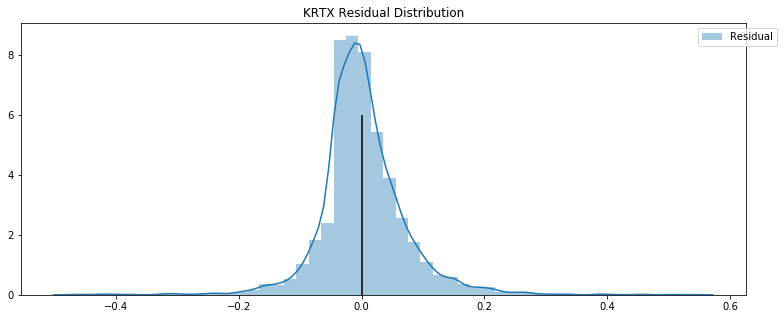

APLS -0.01443835573735952 -0.0008775760427972568


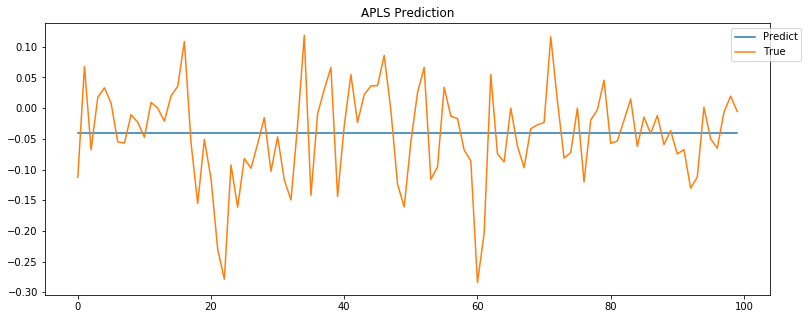

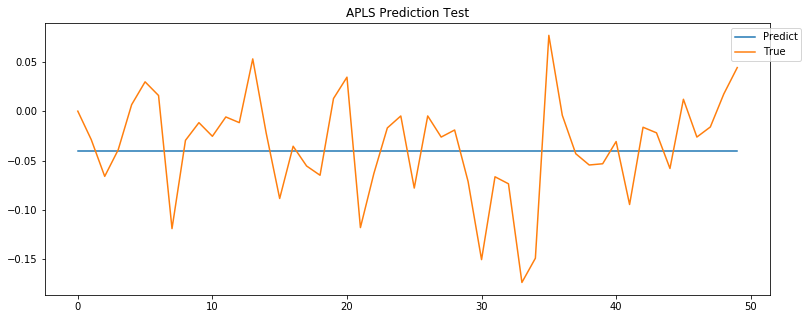

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


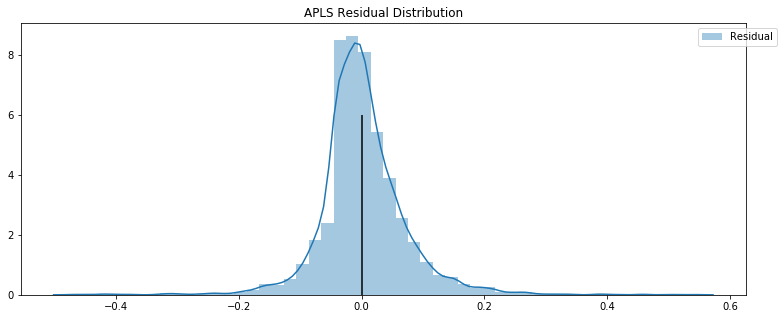

PRVB -0.01443835573735952 -0.0008775760427972568


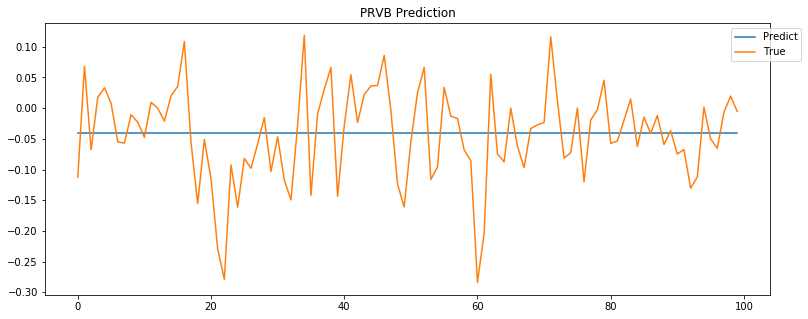

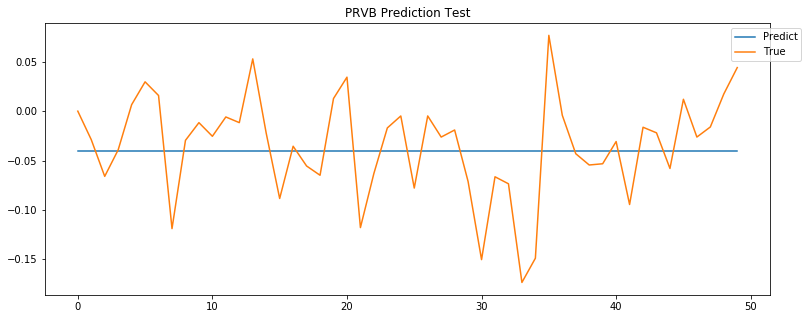

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


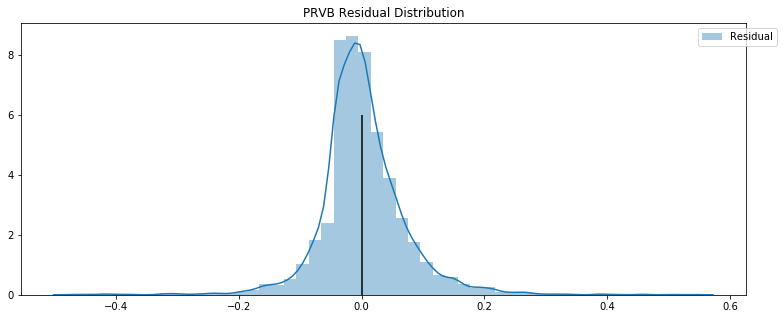

CRTX -0.01443835573735952 -0.0008775760427972568


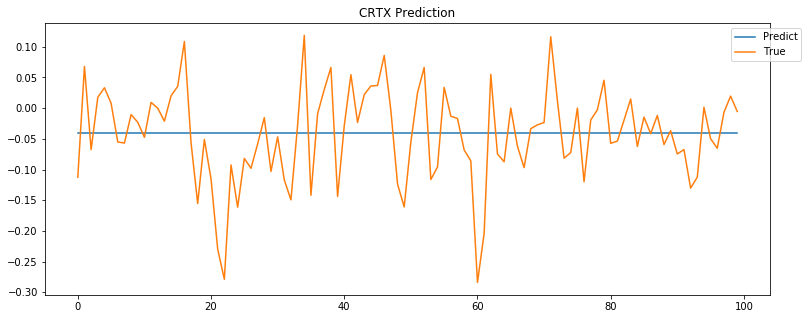

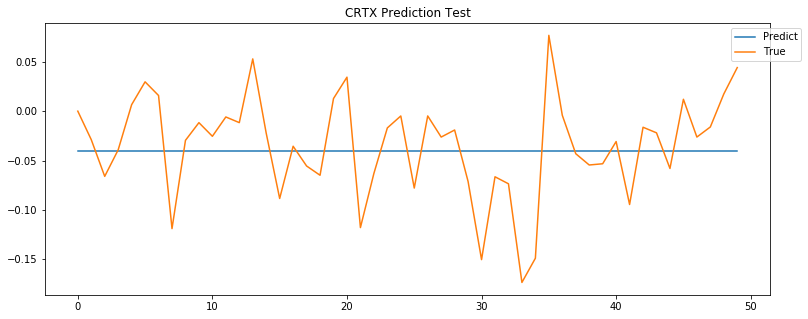

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


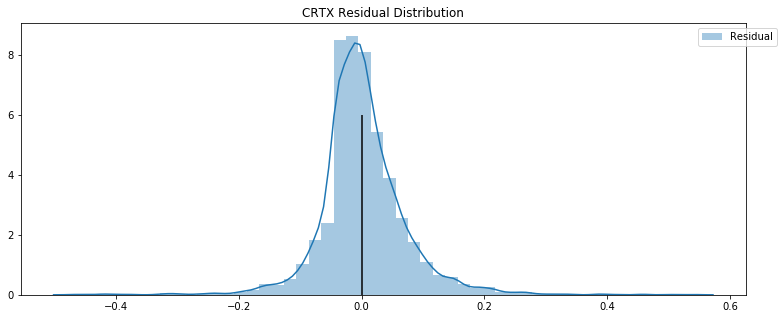

EPZM -0.01443835573735952 -0.0008775760427972568


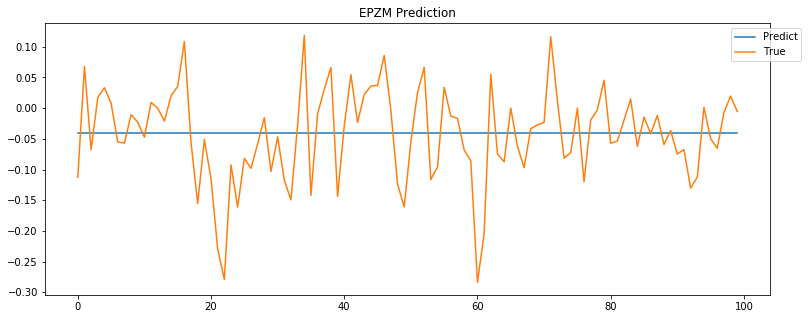

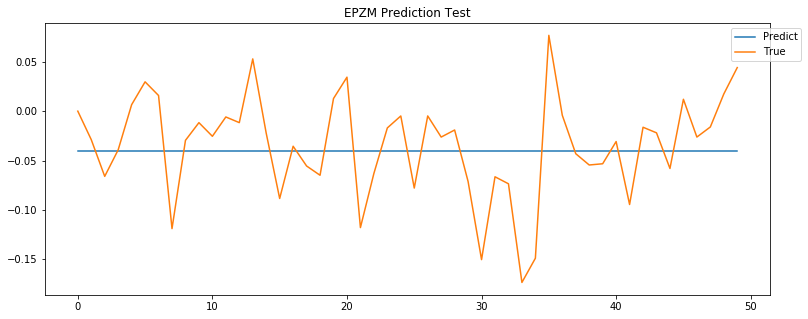

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


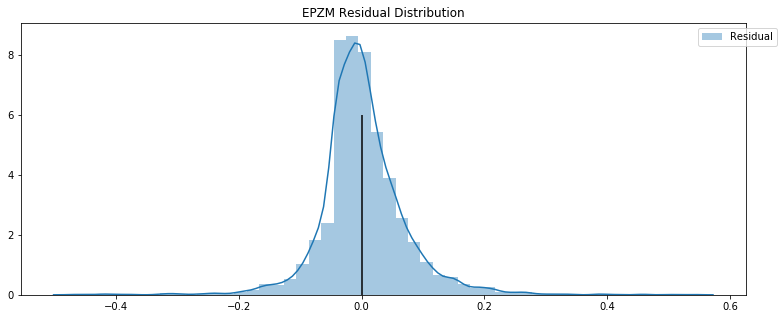

CRBP -0.01443835573735952 -0.0008775760427972568


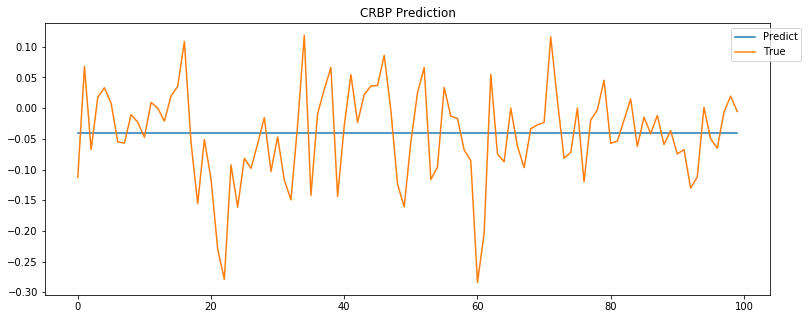

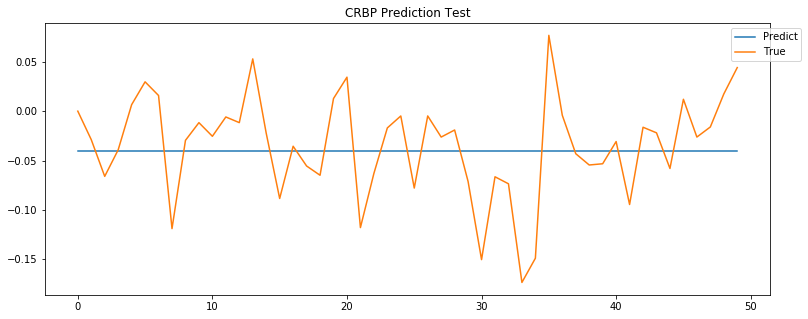

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


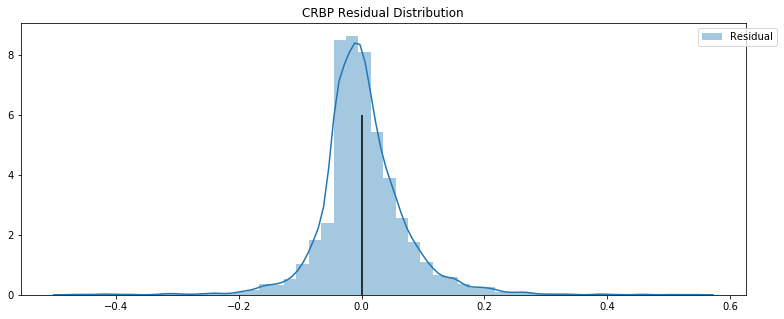

CCXI -0.01443835573735952 -0.0008775760427972568


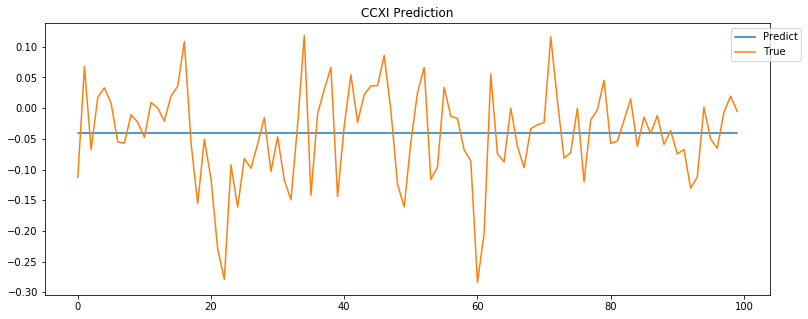

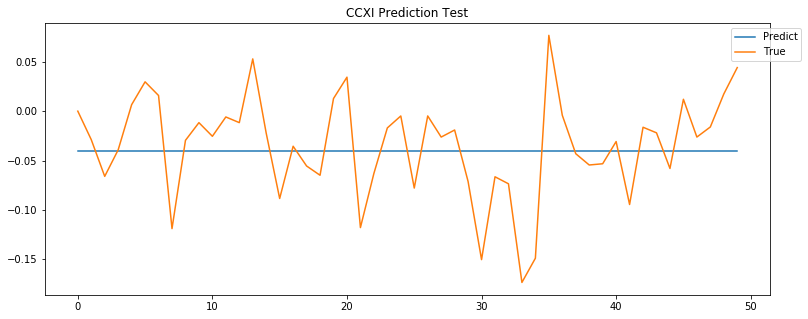

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


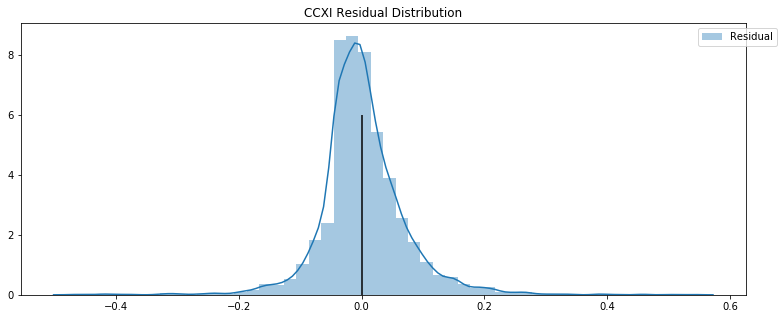

TGTX -0.01443835573735952 -0.0008775760427972568


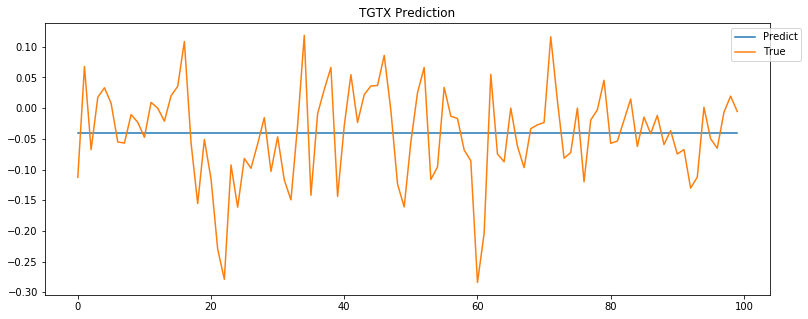

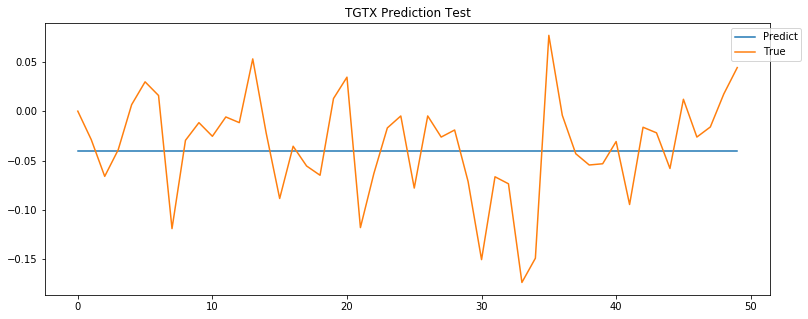

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


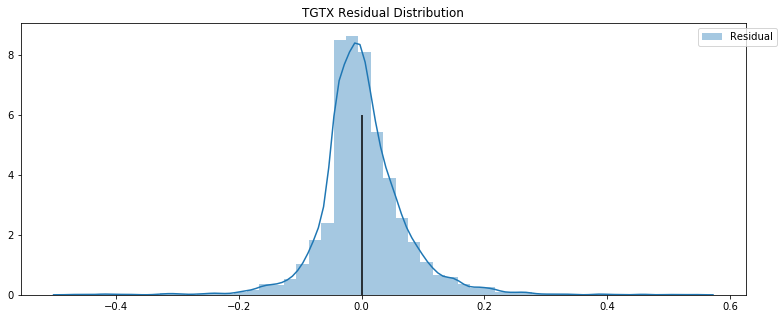

IMGN -0.01443835573735952 -0.0008775760427972568


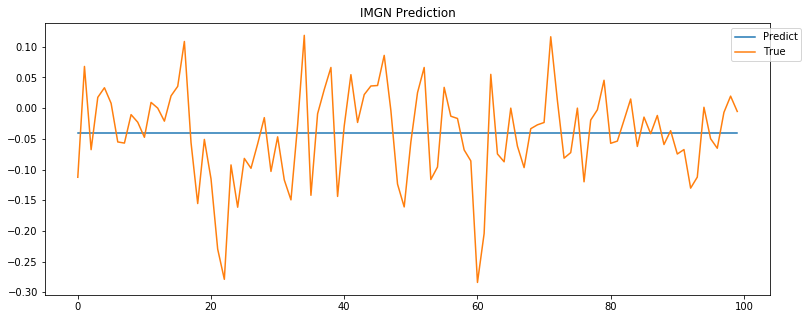

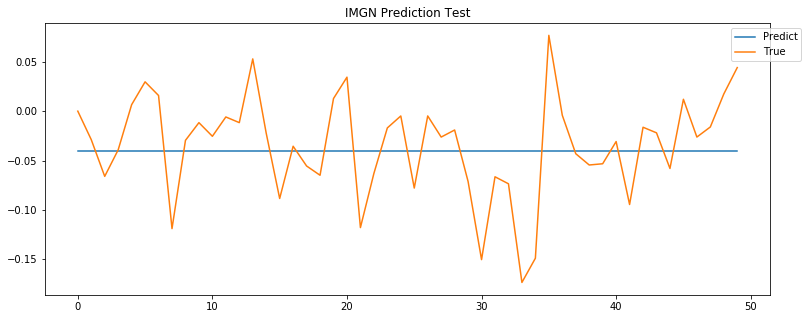

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


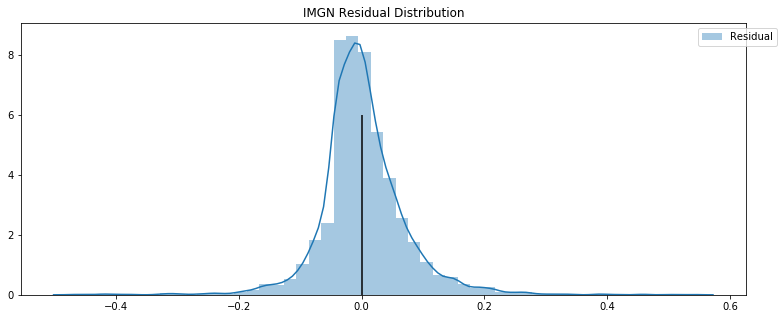

FATE -0.01443835573735952 -0.0008775760427972568


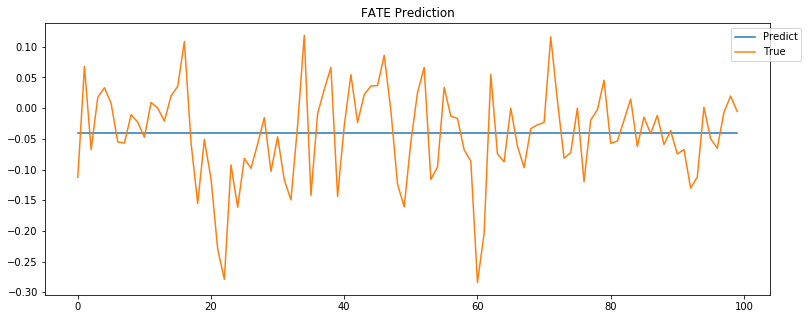

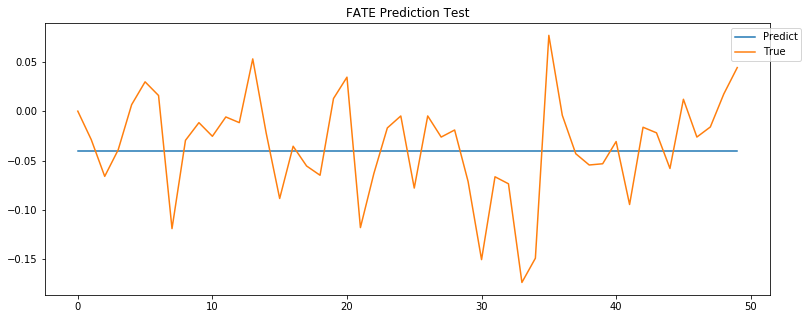

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


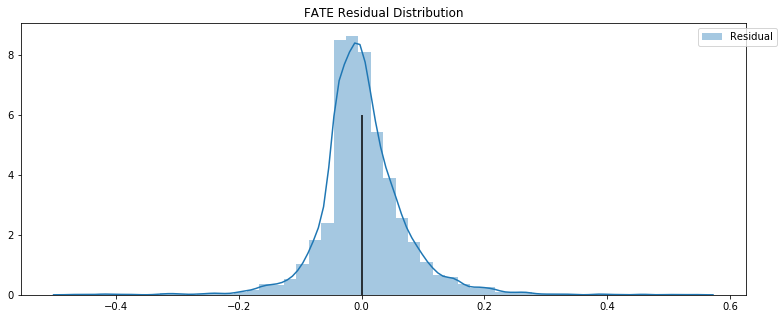

AKBA -0.01443835573735952 -0.0008775760427972568


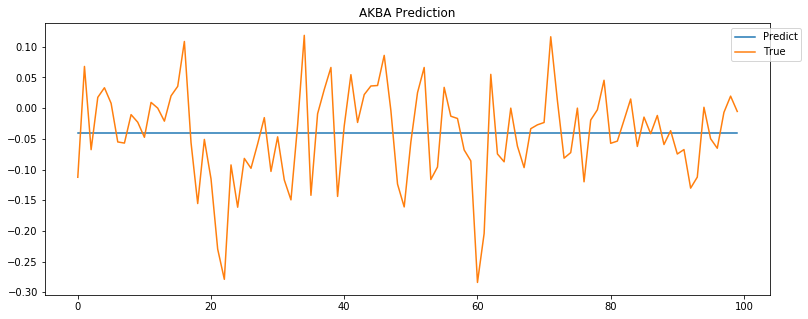

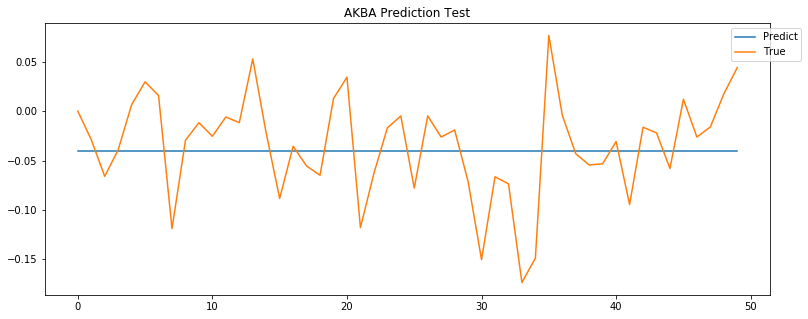

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


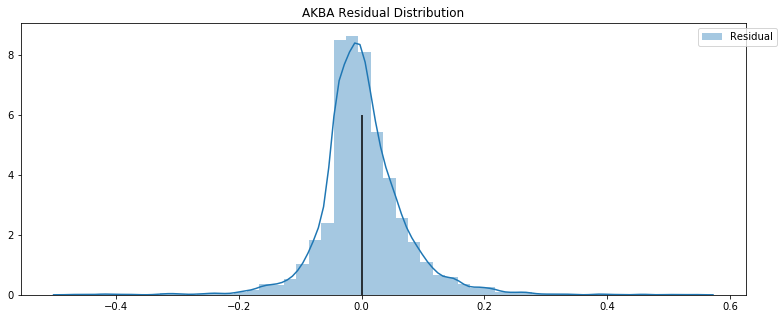

DNLI -0.01443835573735952 -0.0008775760427972568


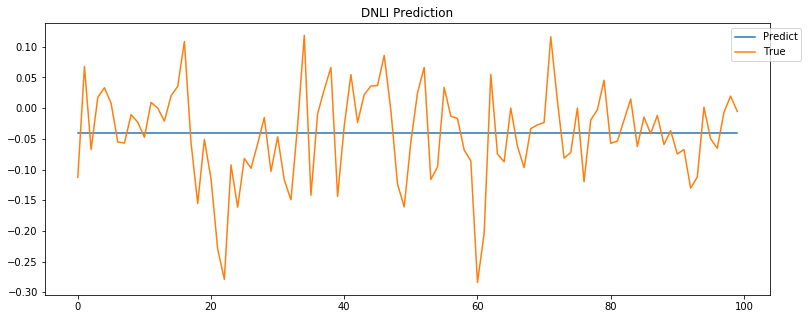

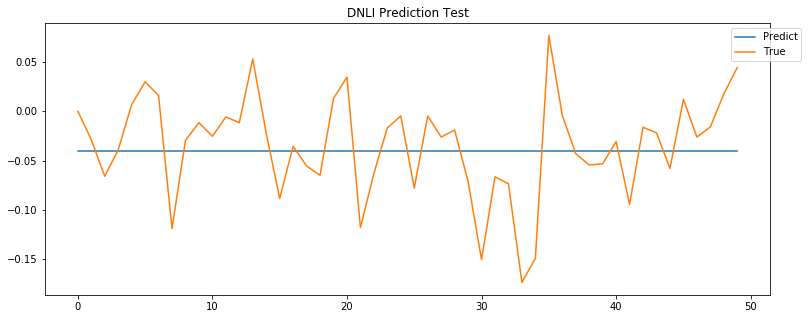

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


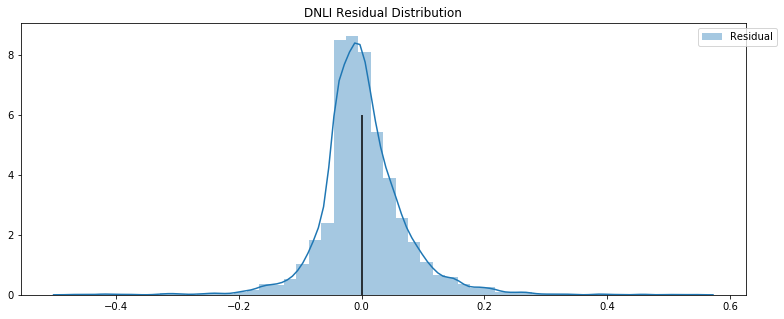

RIGL -0.01443835573735952 -0.0008775760427972568


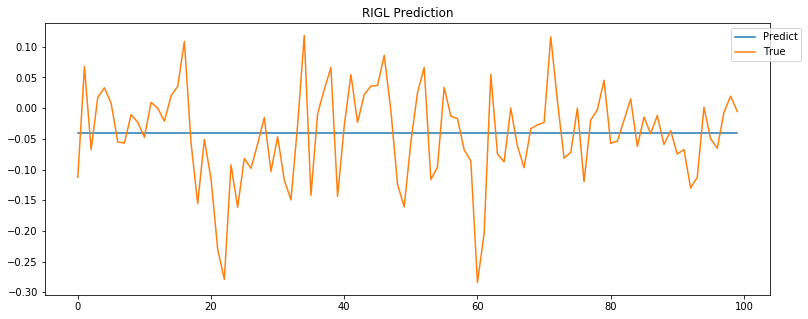

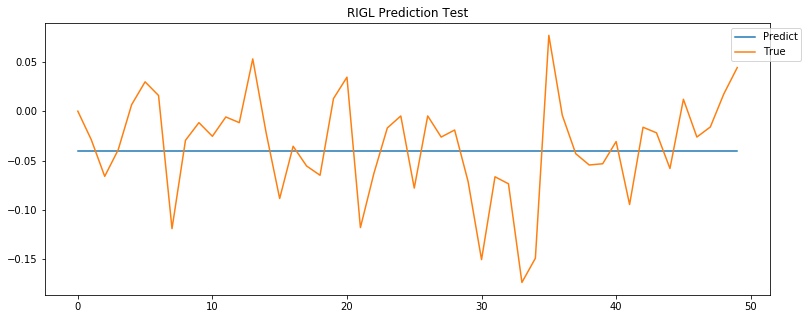

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


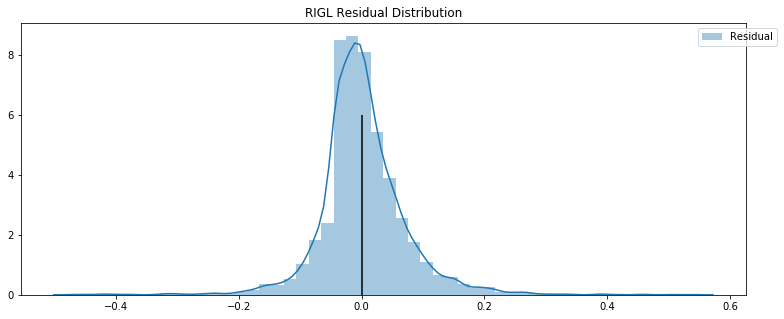

PRNB -0.01443835573735952 -0.0008775760427972568


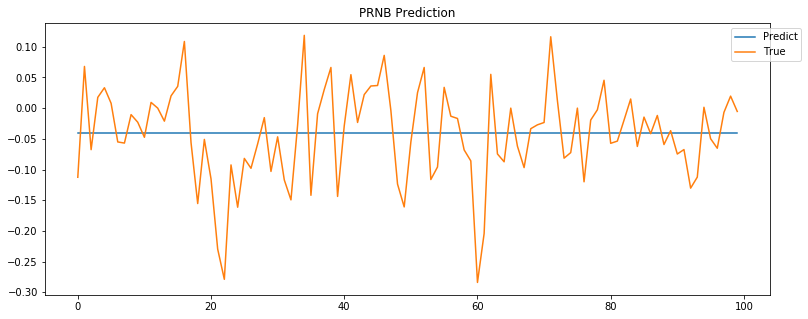

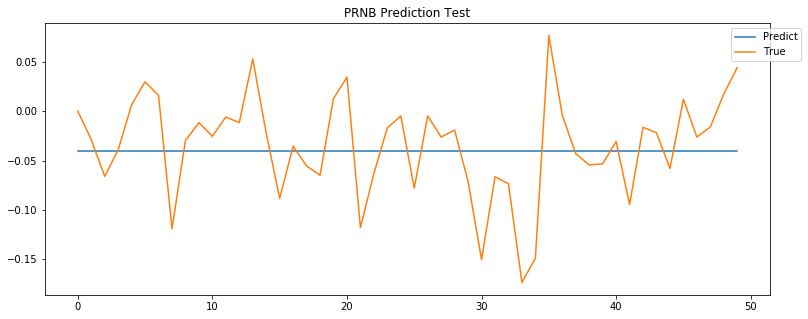

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


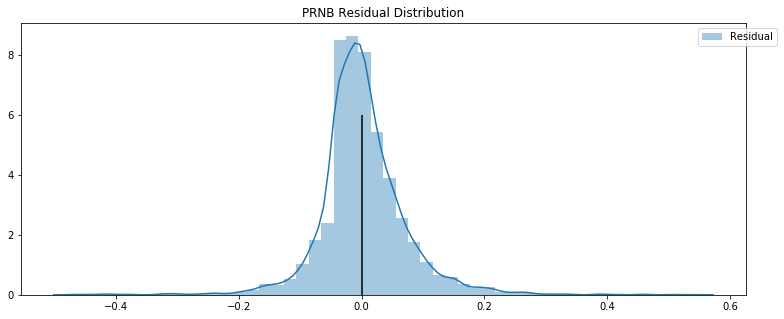

ARVN -0.01443835573735952 -0.0008775760427972568


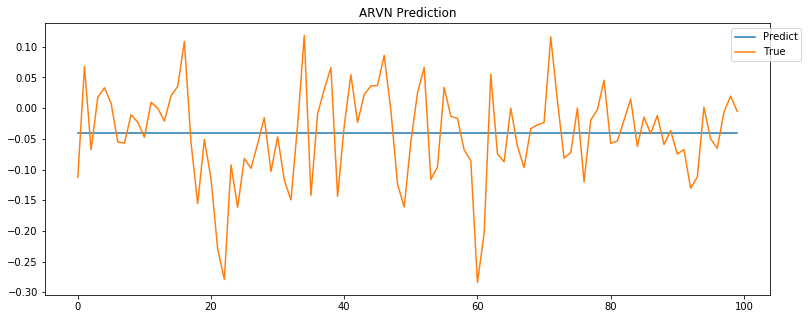

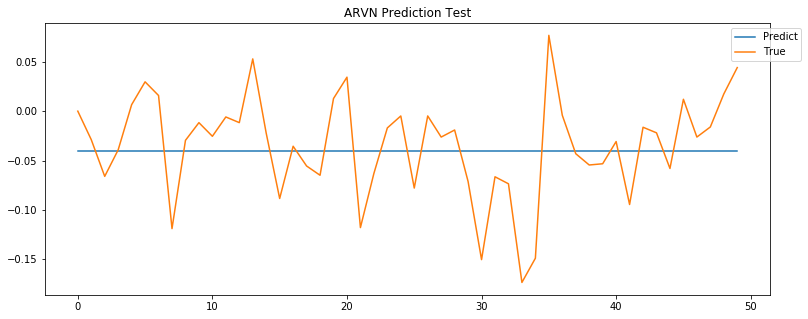

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


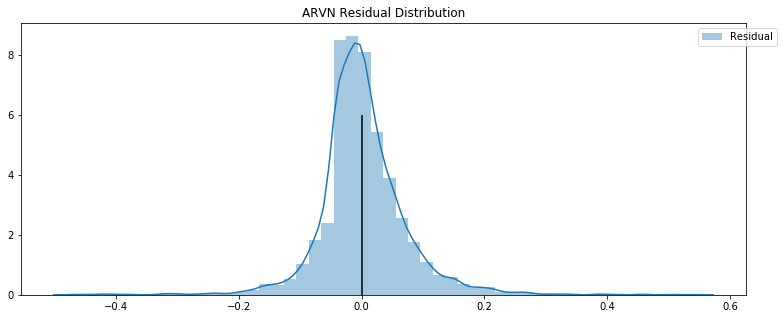

ZYME -0.01443835573735952 -0.0008775760427972568


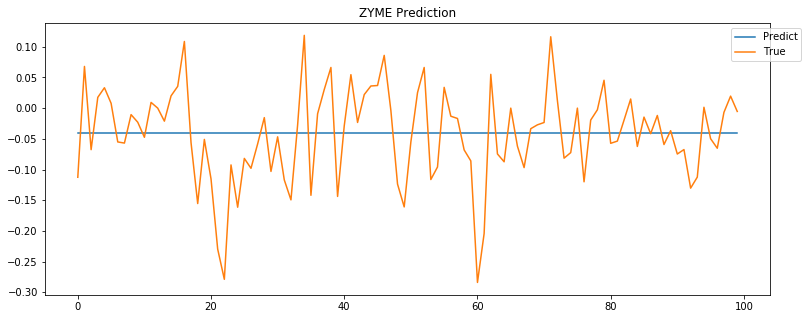

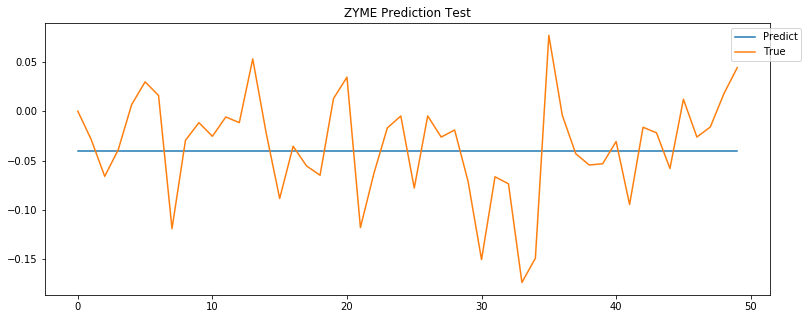

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


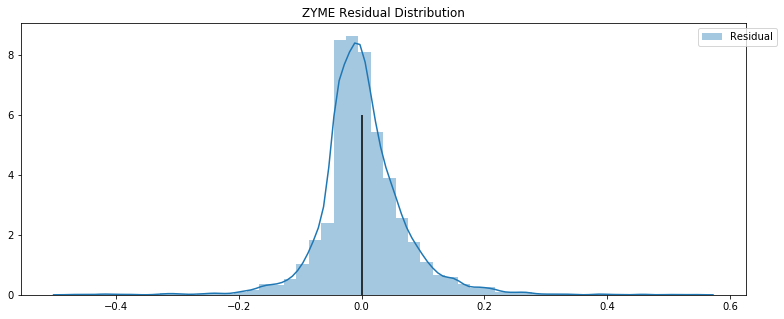

MRNA -0.01443835573735952 -0.0008775760427972568


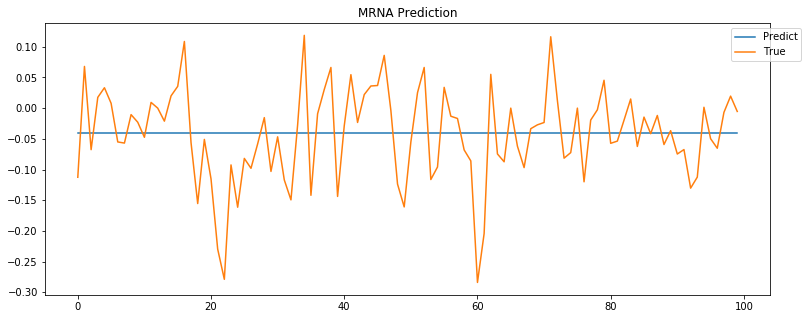

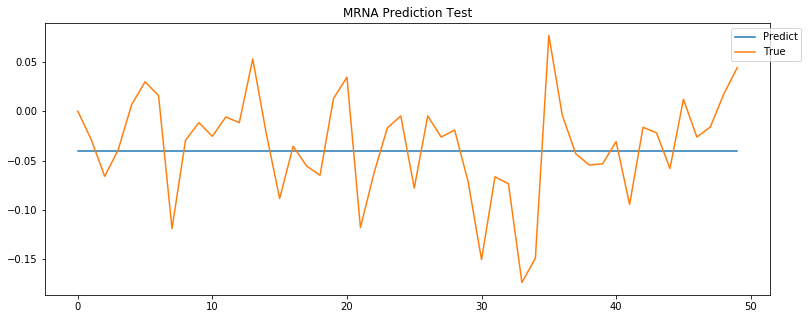

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


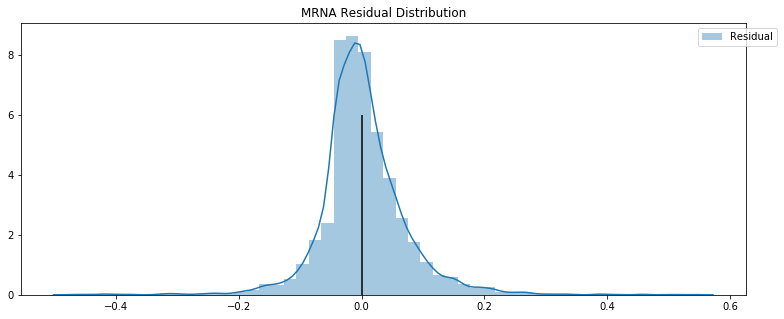

CYTK -0.01443835573735952 -0.0008775760427972568


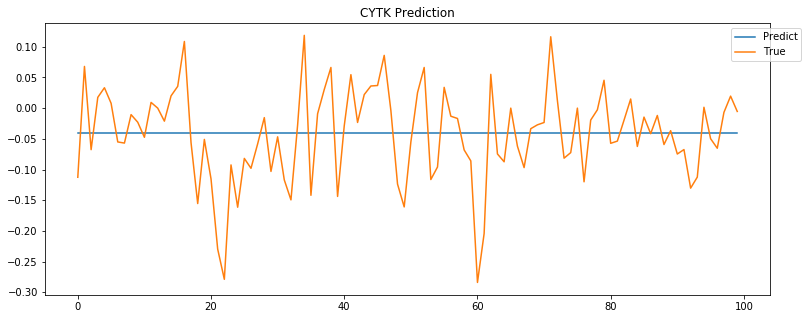

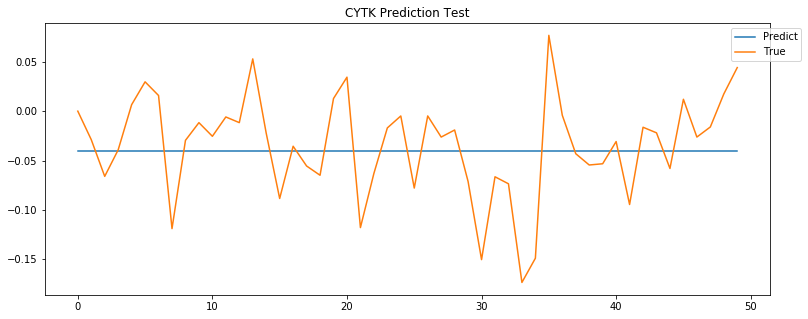

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


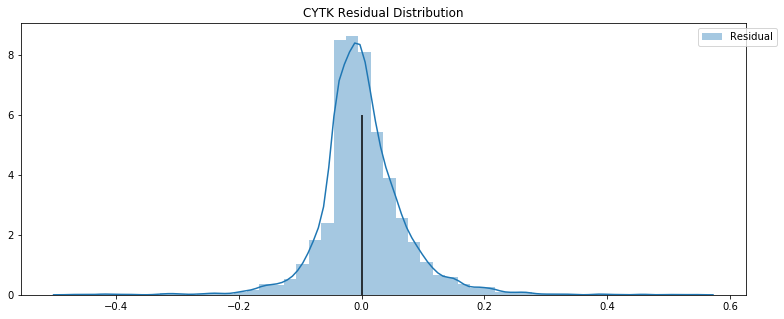

FTSV -0.01443835573735952 -0.0008775760427972568


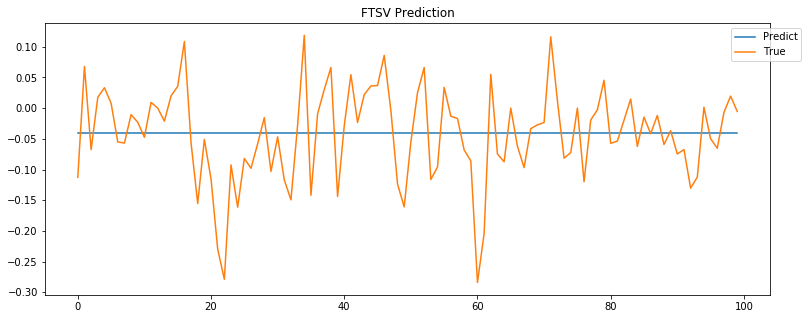

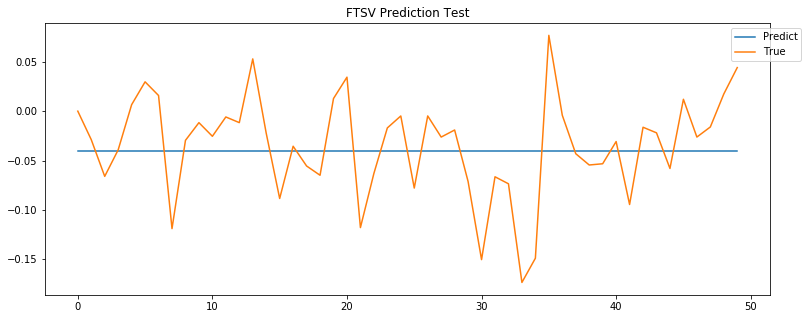

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


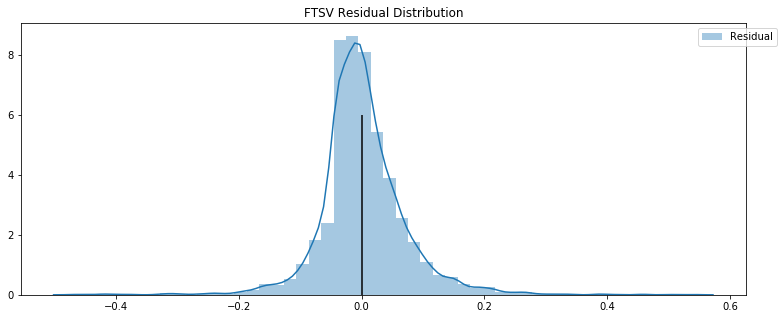

ASND -0.01443835573735952 -0.0008775760427972568


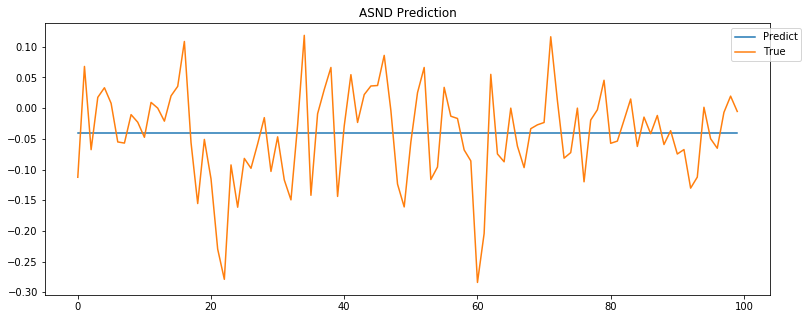

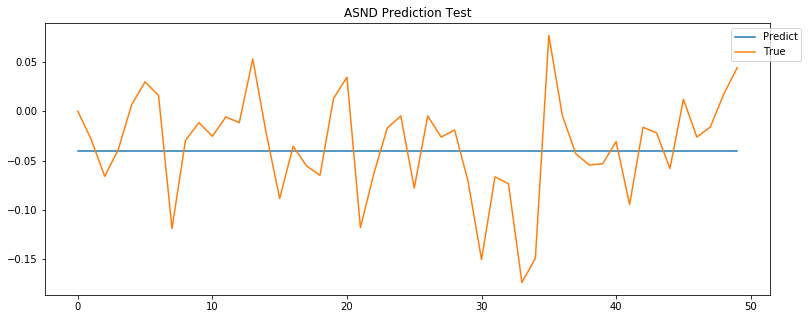

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


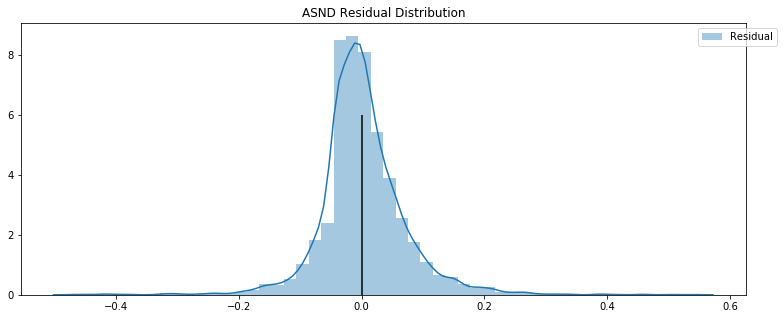

XBIT -0.01443835573735952 -0.0008775760427972568


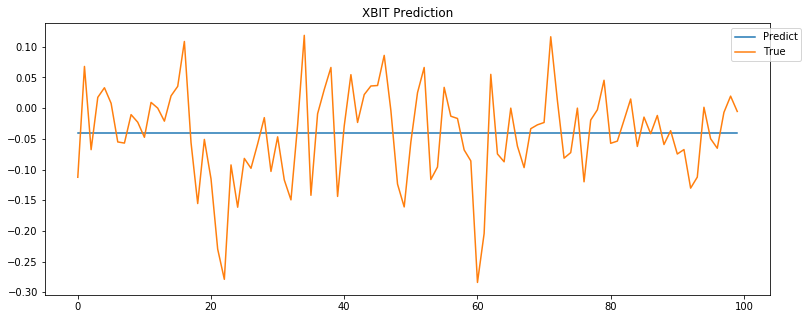

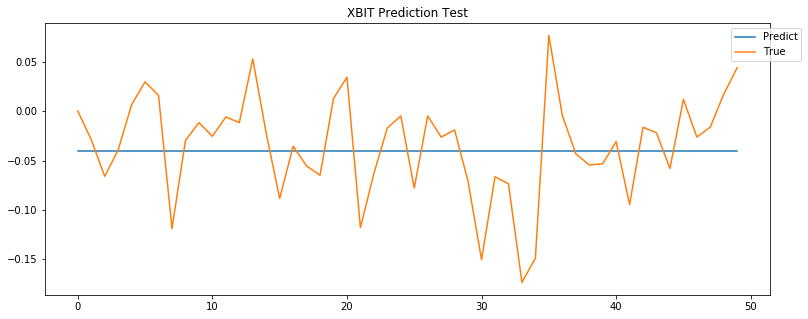

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


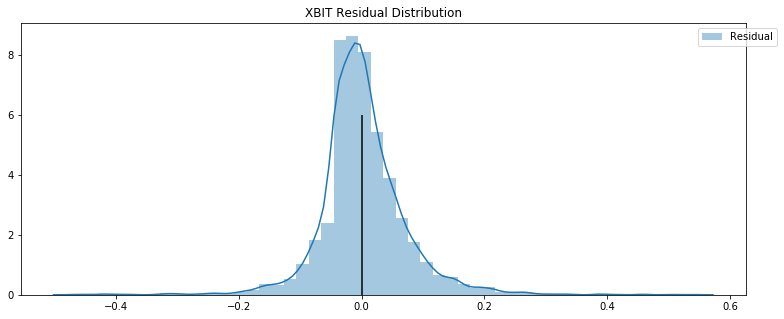

ALEC -0.01443835573735952 -0.0008775760427972568


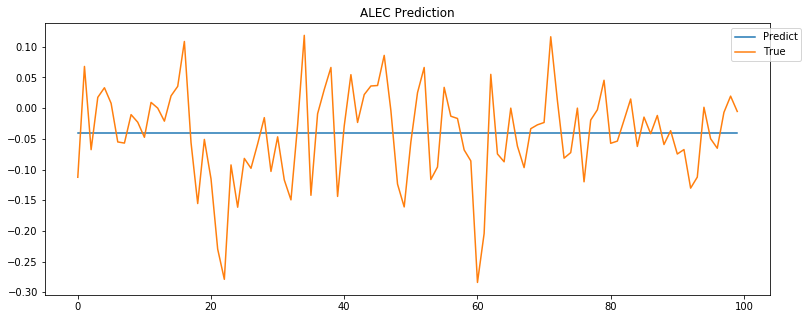

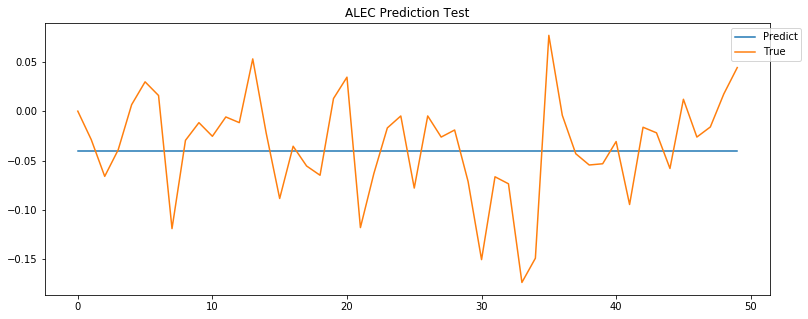

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


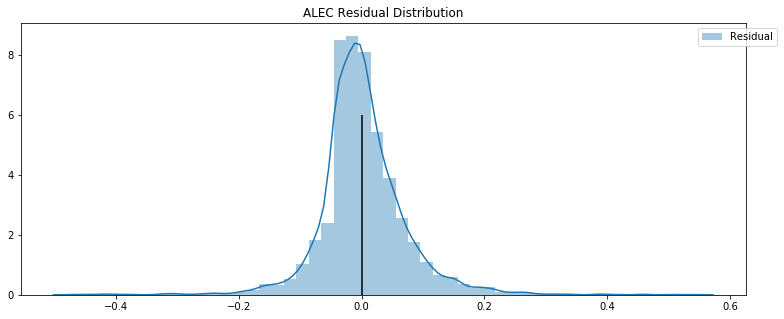

ORTX -0.01443835573735952 -0.0008775760427972568


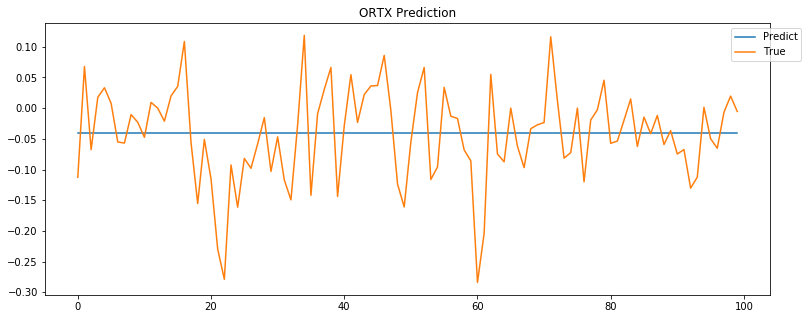

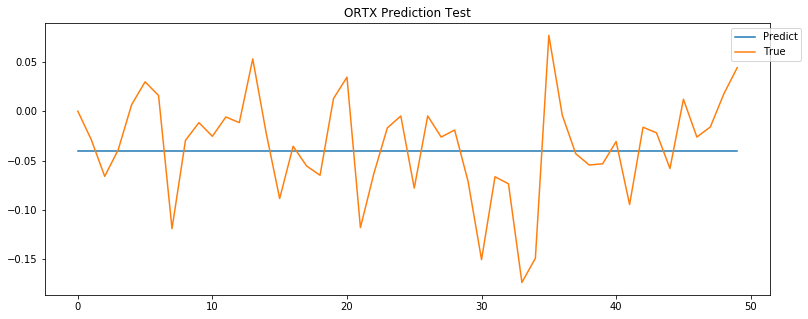

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


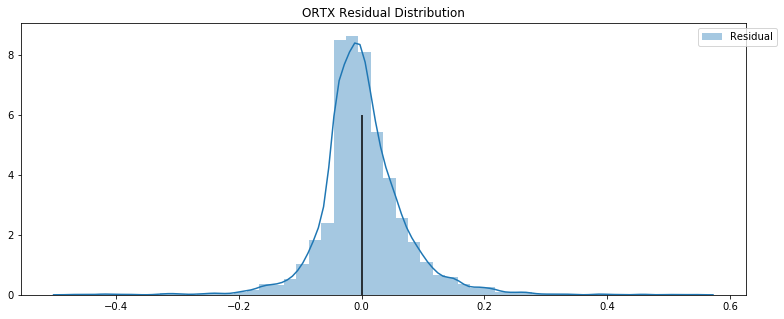

ADVM -0.01443835573735952 -0.0008775760427972568


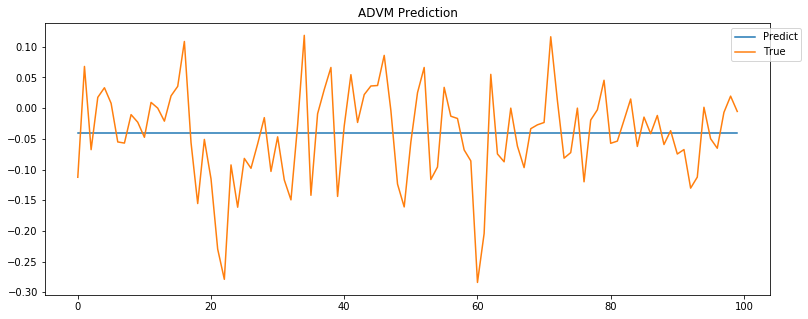

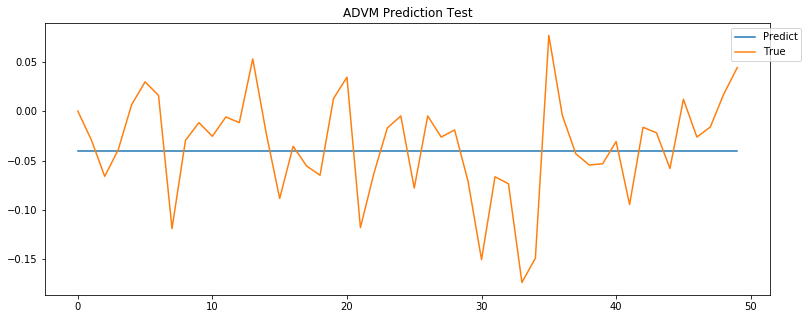

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


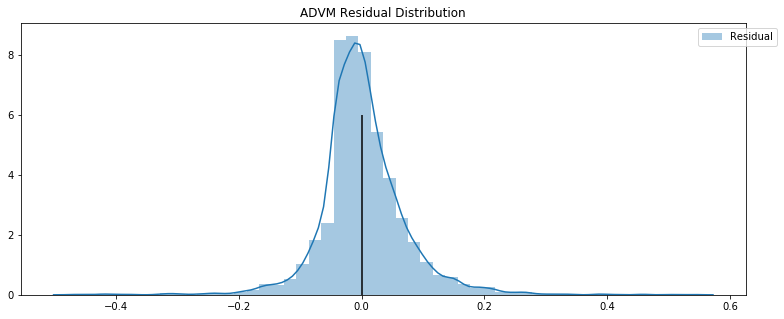

MGNX -0.01443835573735952 -0.0008775760427972568


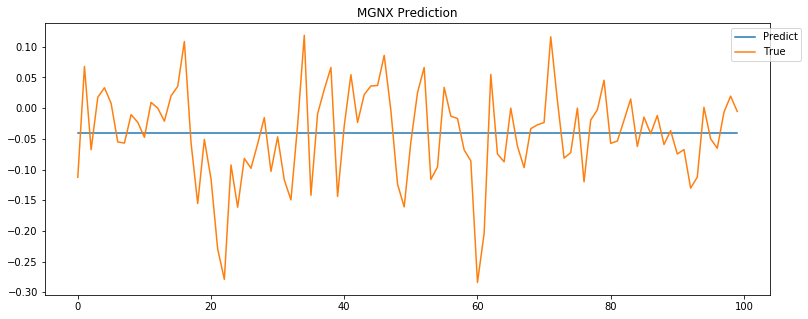

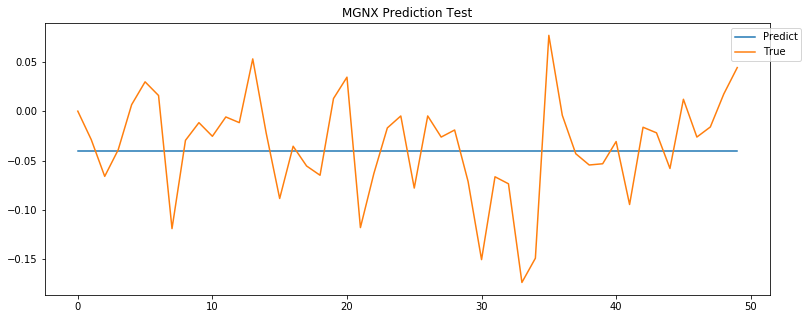

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


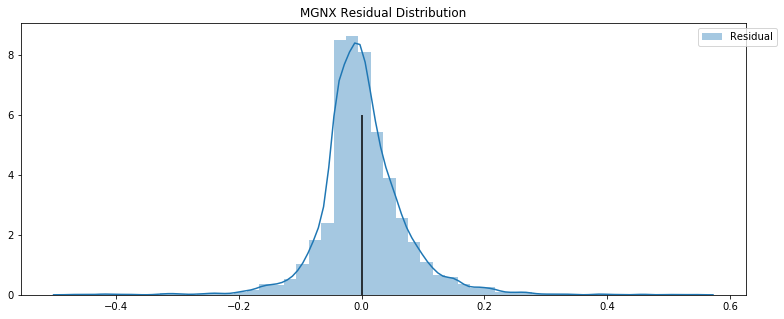

AKRO -0.01443835573735952 -0.0008775760427972568


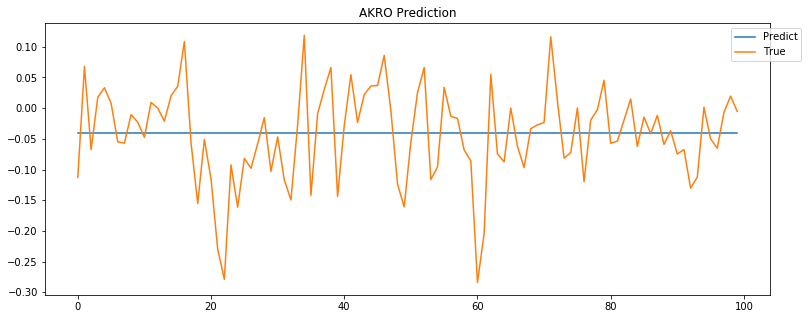

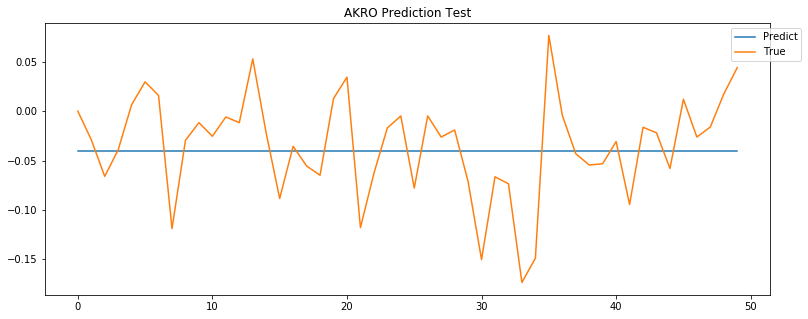

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


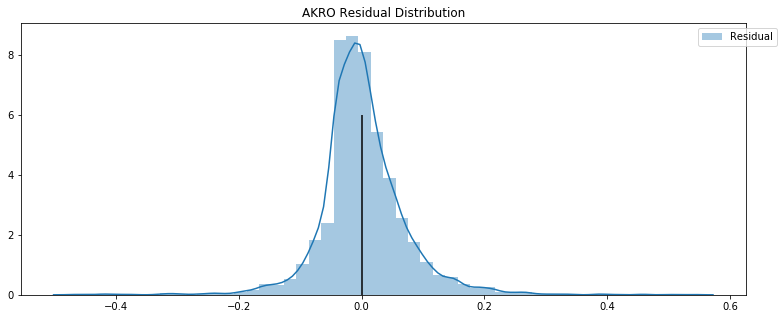

ESPR -0.01443835573735952 -0.0008775760427972568


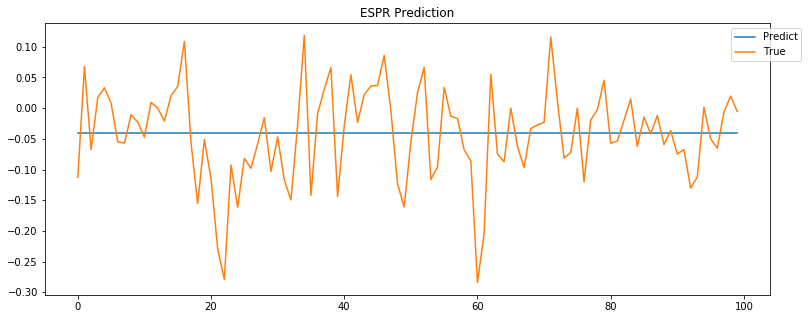

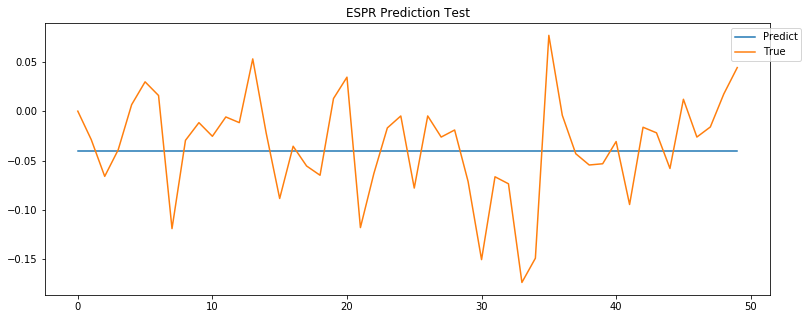

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


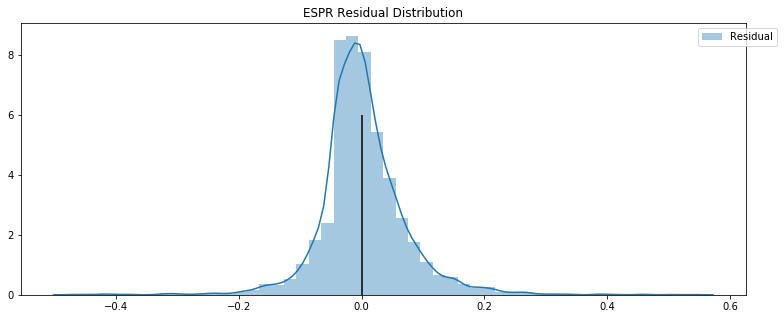

BHVN -0.01443835573735952 -0.0008775760427972568


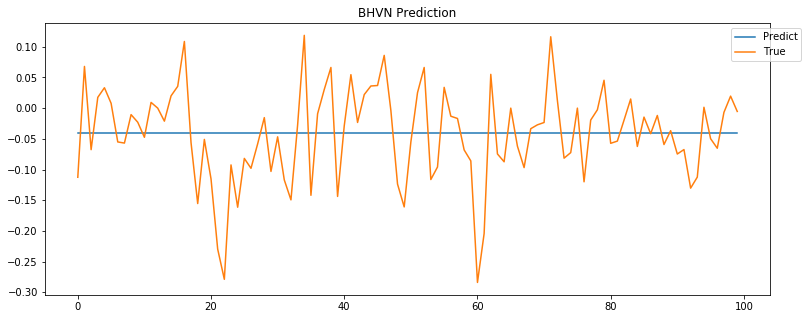

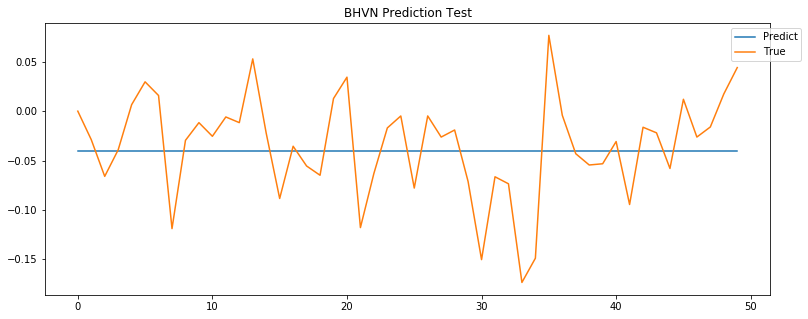

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


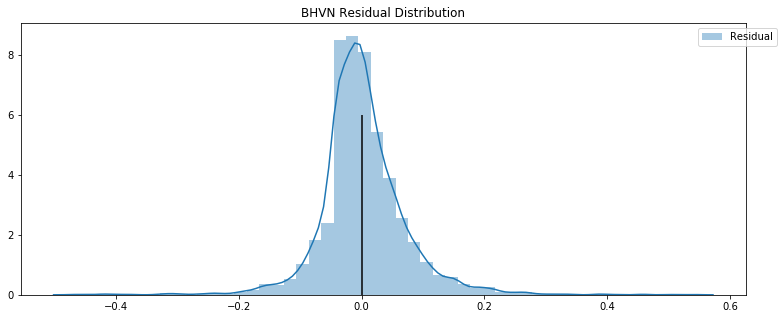

YMAB -0.01443835573735952 -0.0008775760427972568


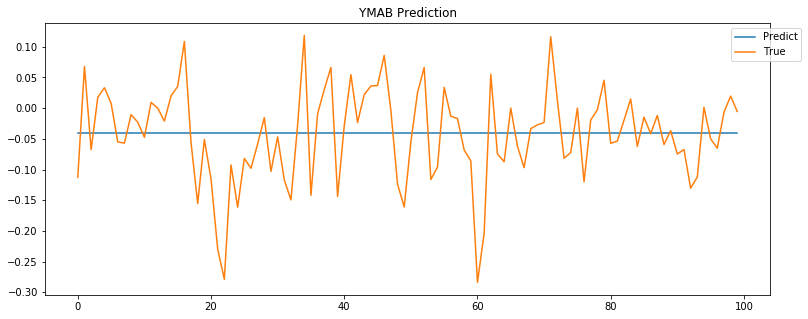

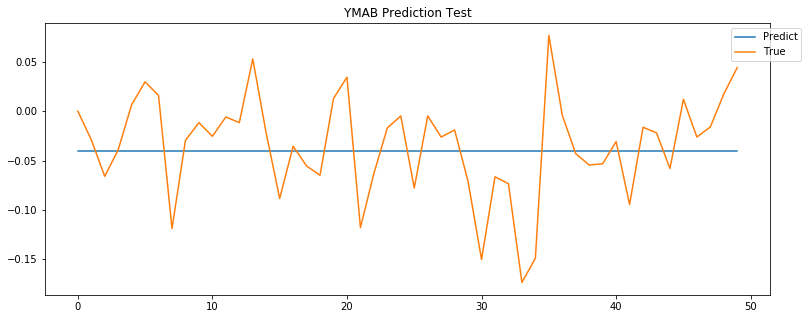

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


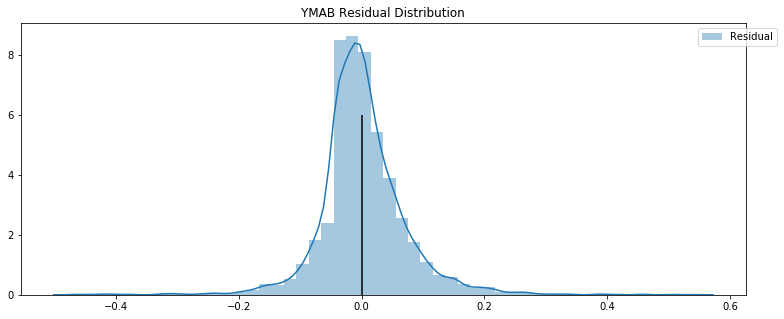

RGNX -0.01443835573735952 -0.0008775760427972568


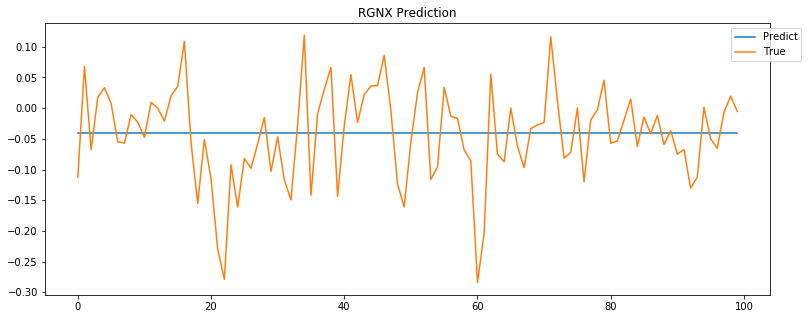

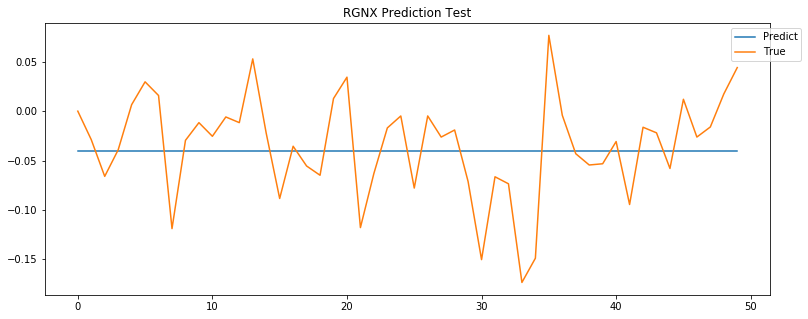

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


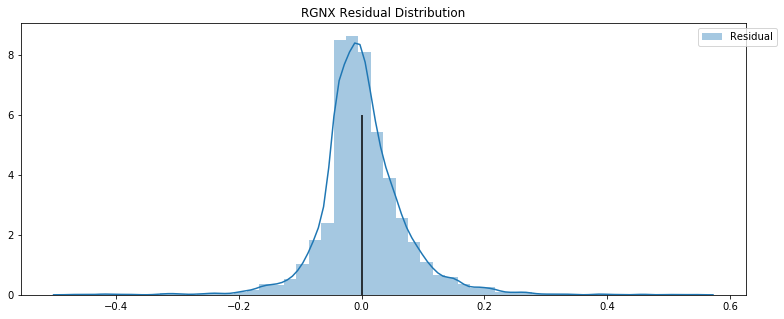

MYOK -0.01443835573735952 -0.0008775760427972568


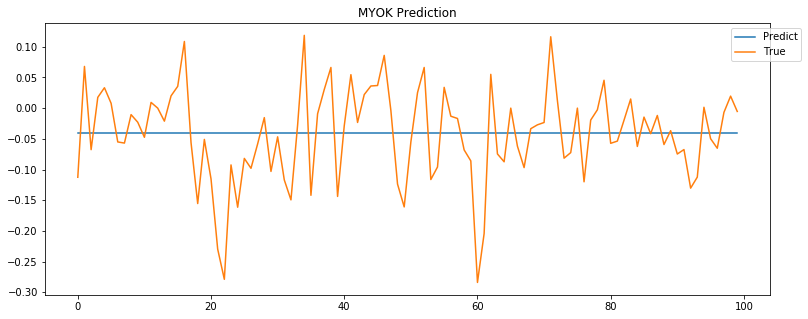

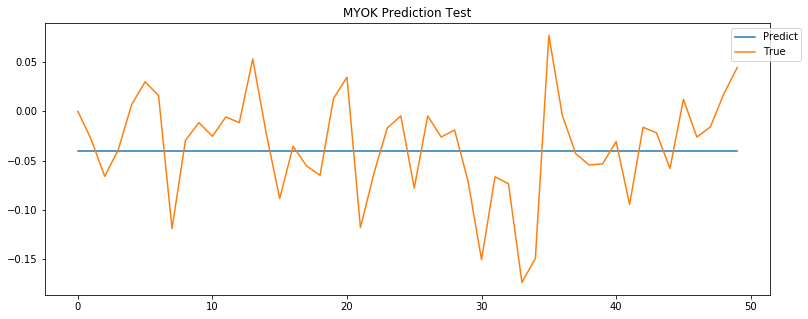

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


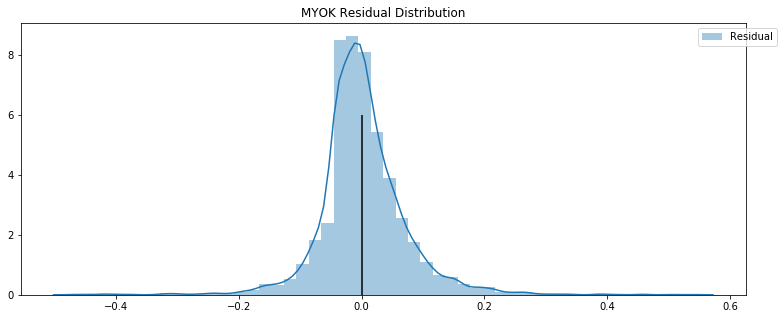

TPTX -0.01443835573735952 -0.0008775760427972568


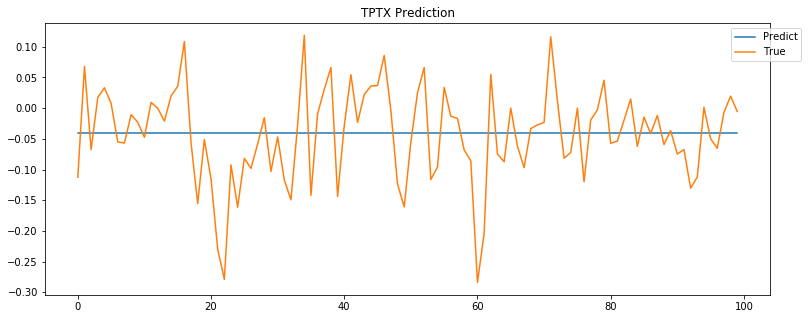

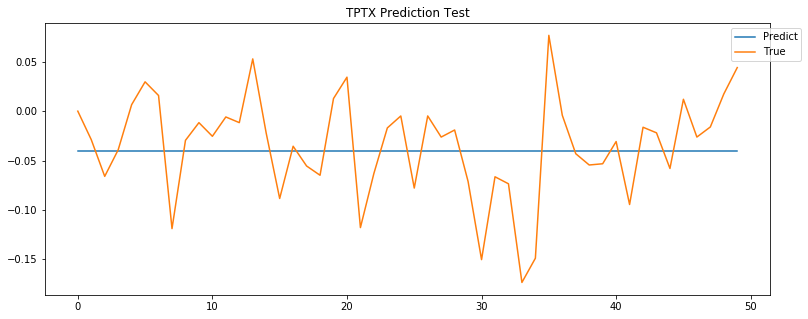

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


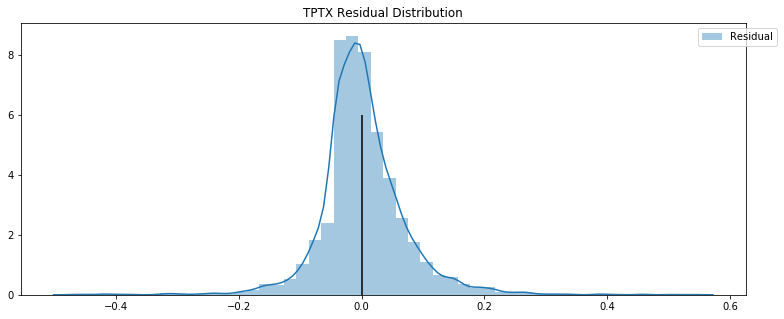

ATNX -0.01443835573735952 -0.0008775760427972568


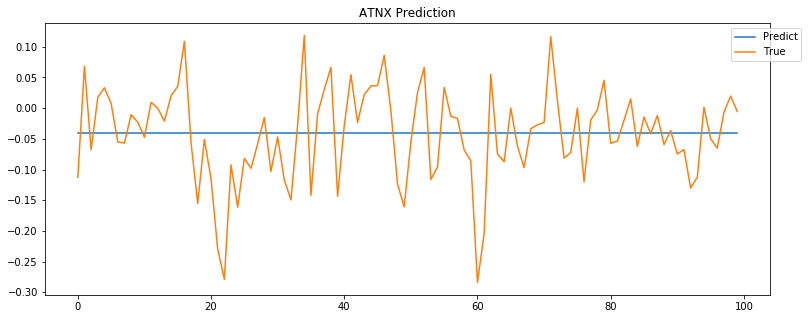

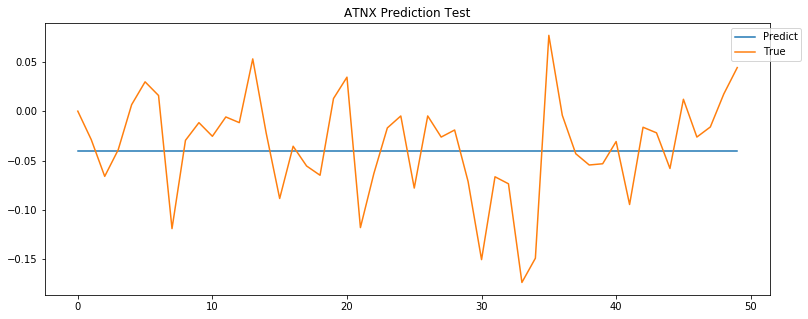

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


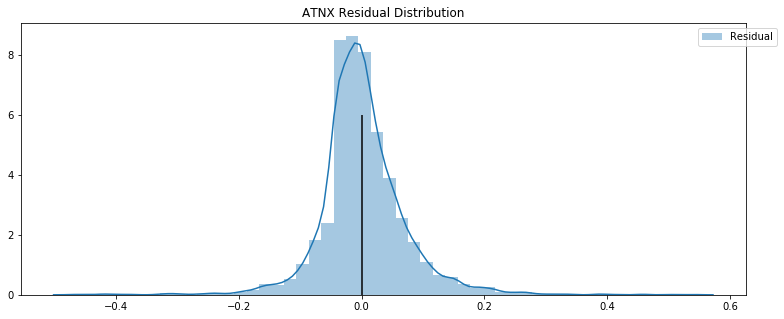

BLUE -0.01443835573735952 -0.0008775760427972568


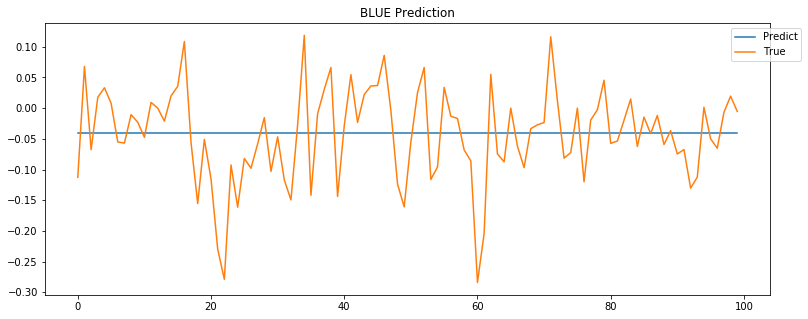

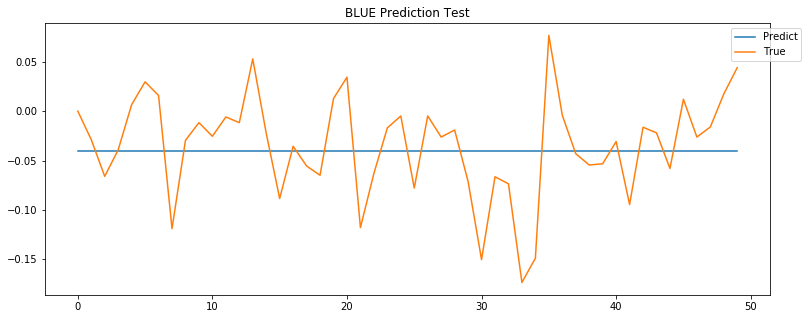

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


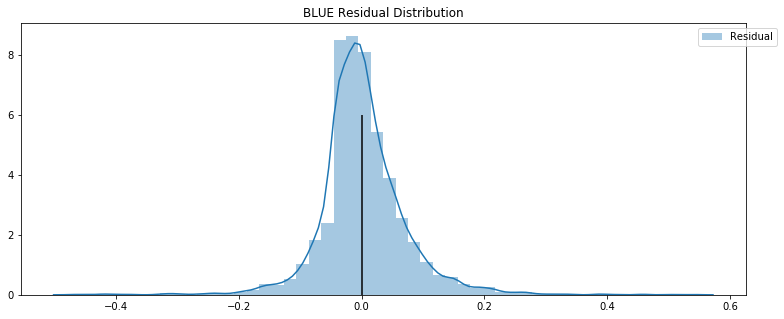

AGEN -0.01443835573735952 -0.0008775760427972568


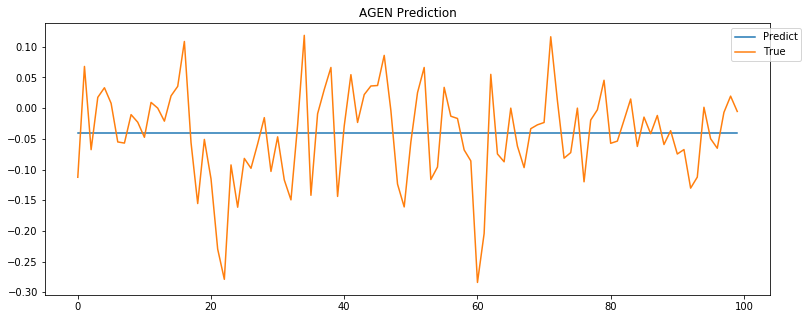

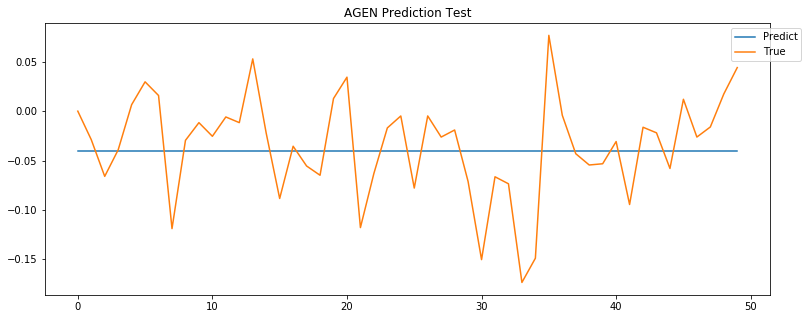

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


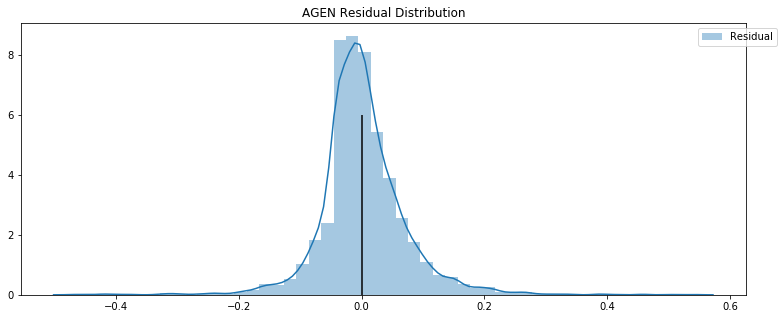

AVRO -0.01443835573735952 -0.0008775760427972568


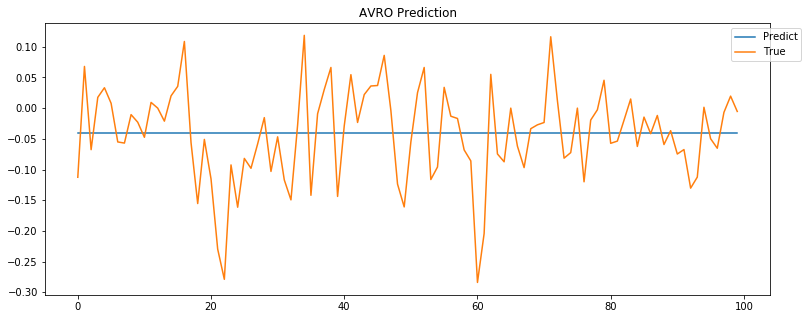

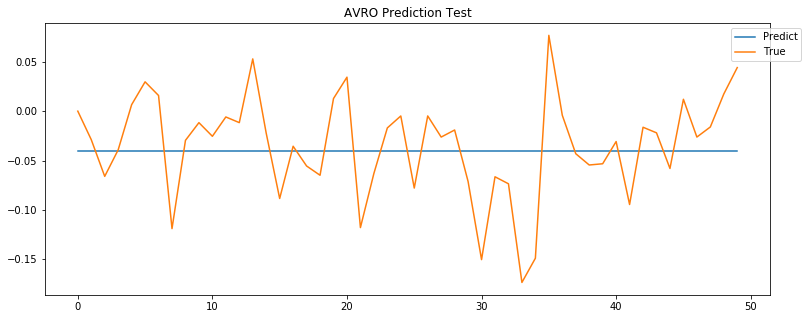

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


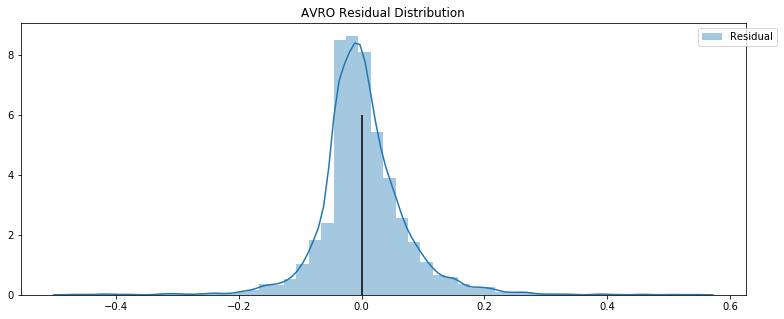

DCPH -0.01443835573735952 -0.0008775760427972568


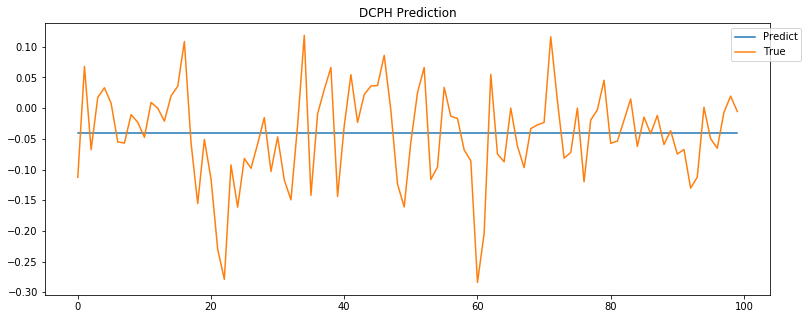

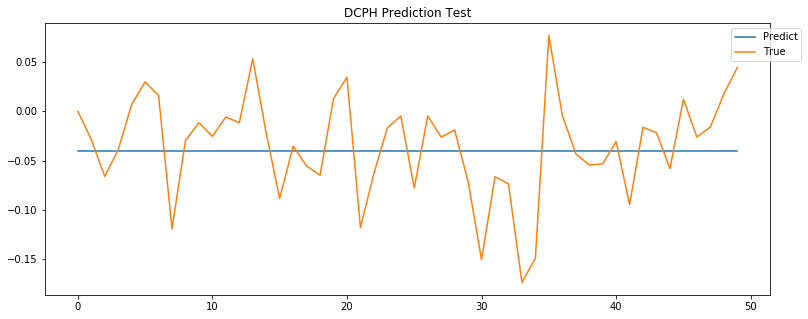

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


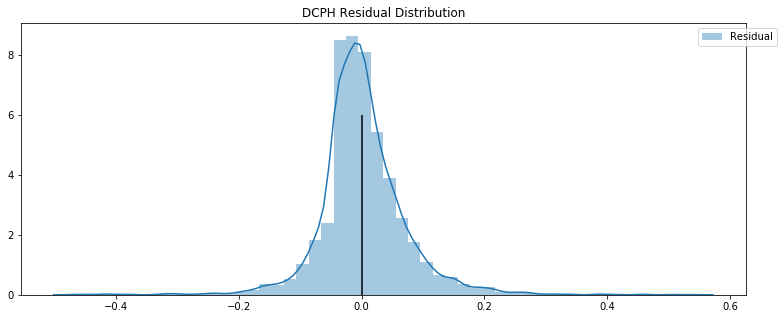

CTMX -0.01443835573735952 -0.0008775760427972568


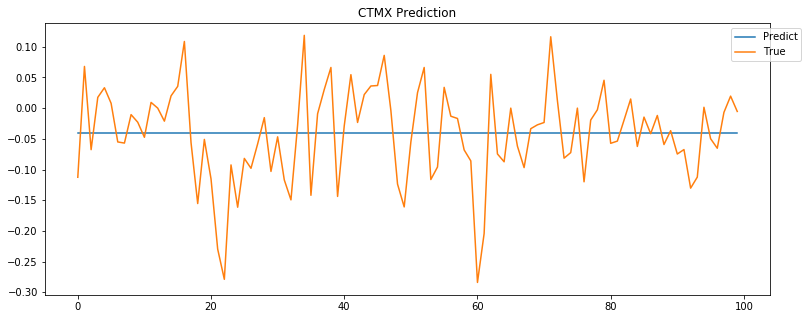

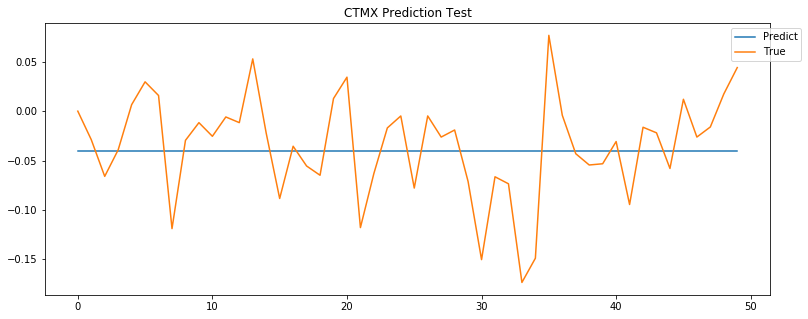

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


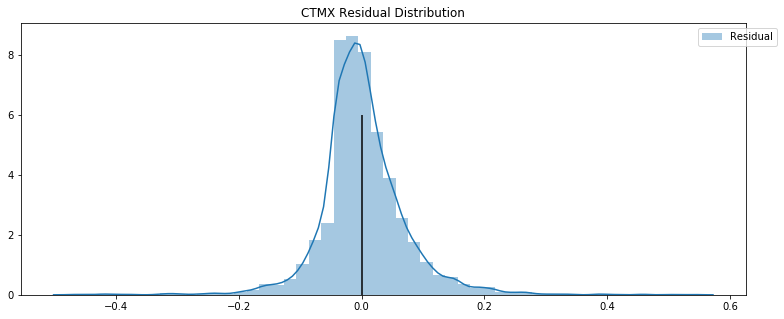

SRNE -0.01443835573735952 -0.0008775760427972568


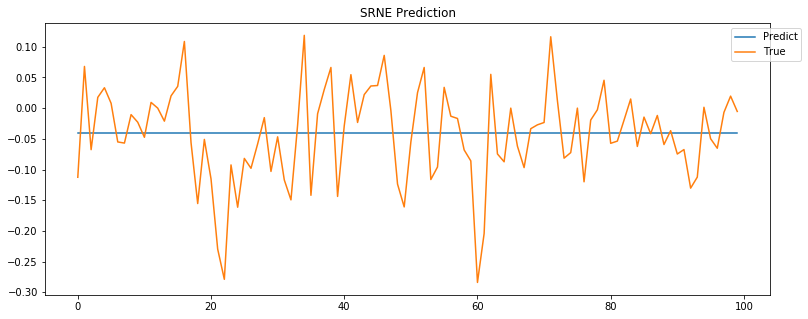

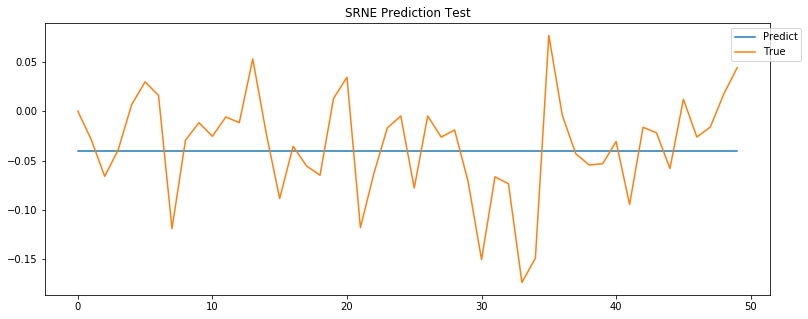

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


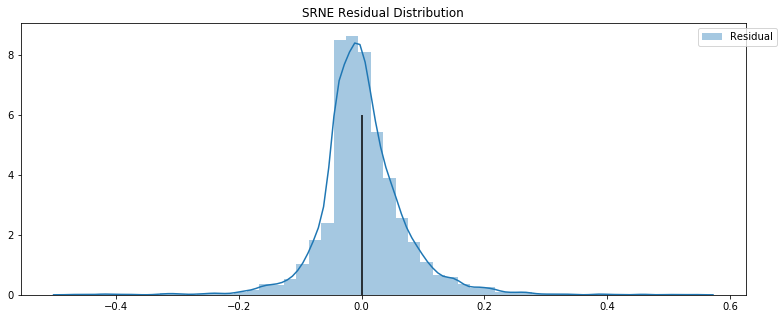

ARDX -0.01443835573735952 -0.0008775760427972568


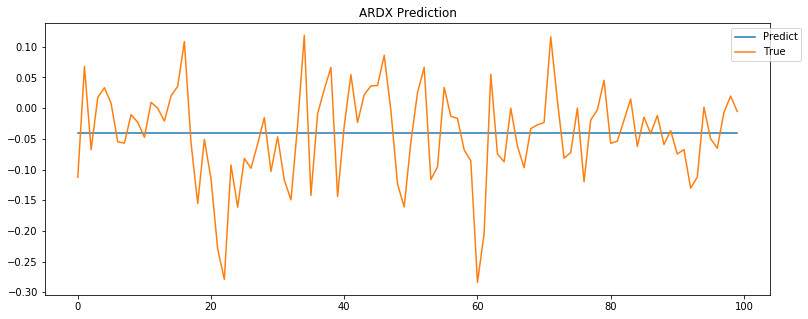

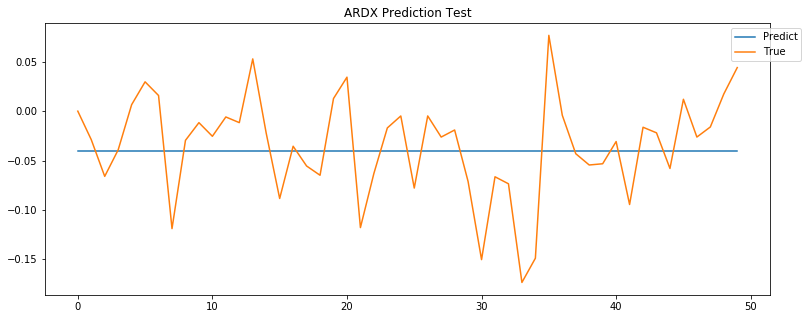

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


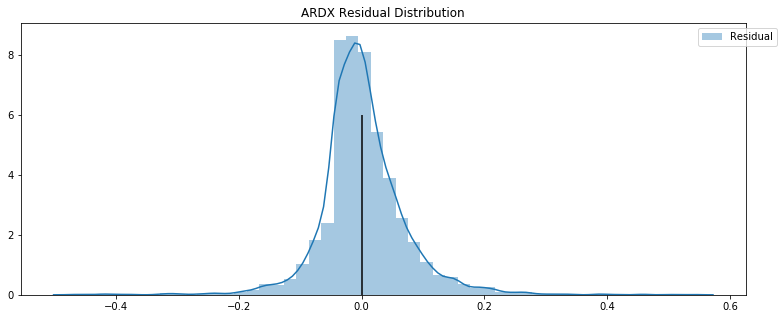

BCRX -0.01443835573735952 -0.0008775760427972568


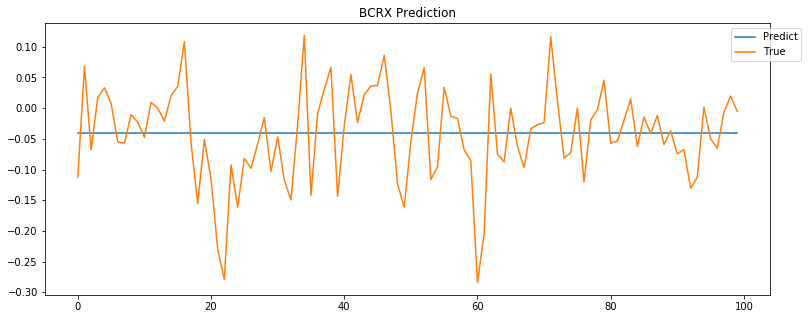

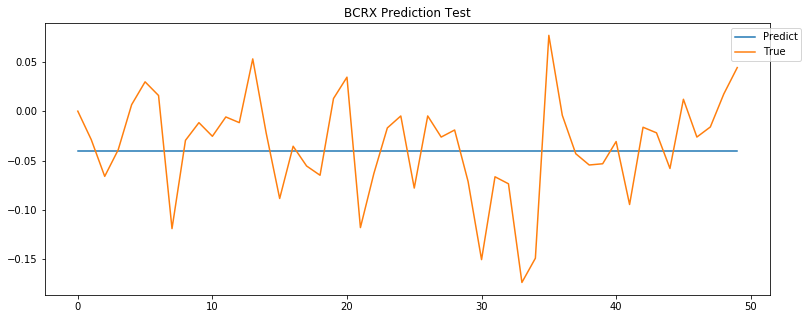

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


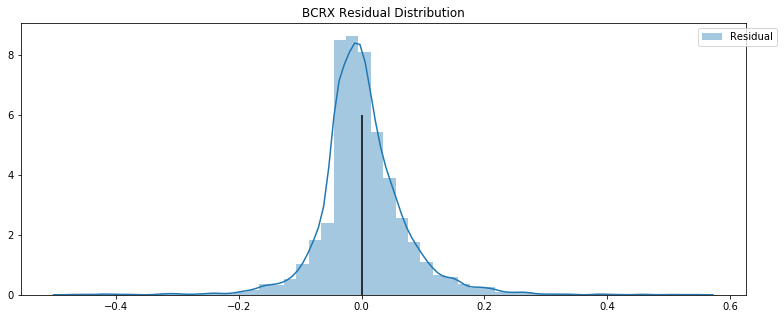

RETA -0.01443835573735952 -0.0008775760427972568


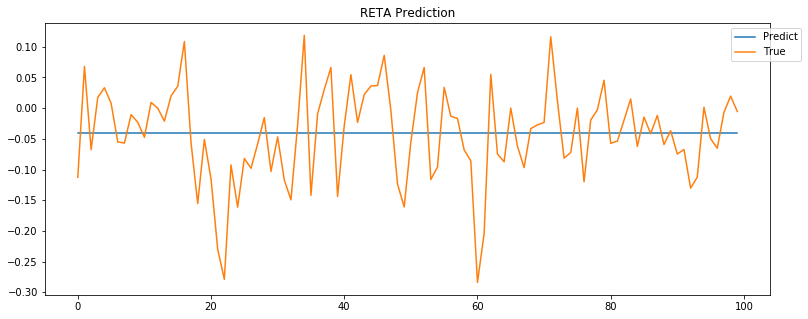

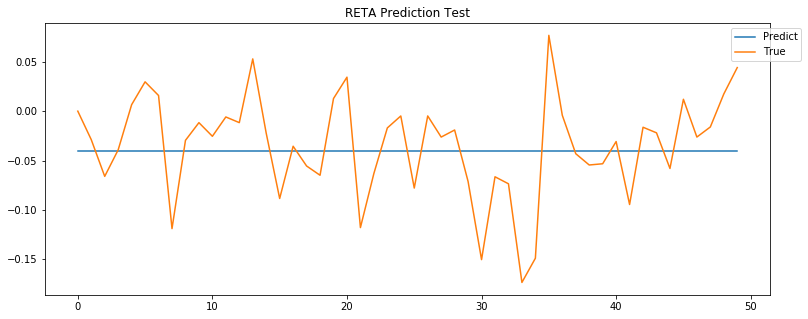

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


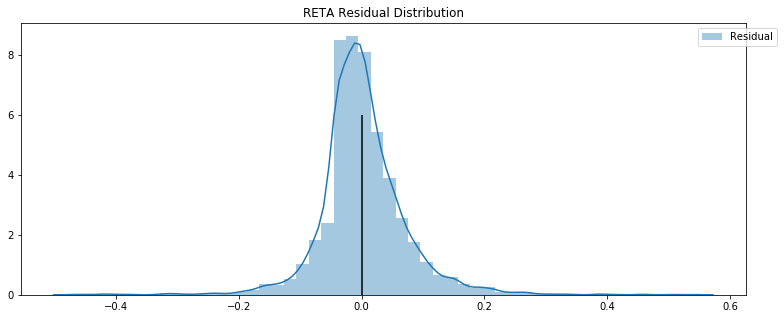

KOD -0.01443835573735952 -0.0008775760427972568


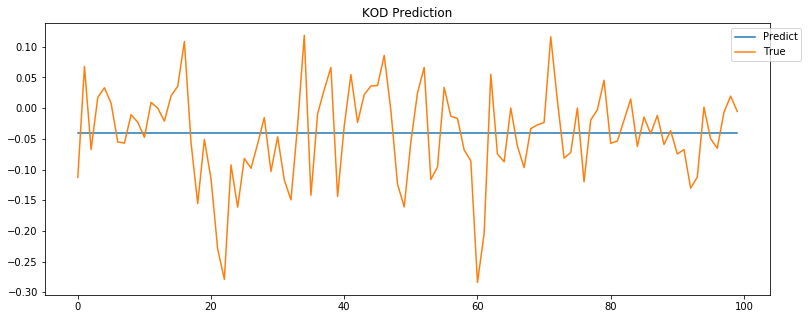

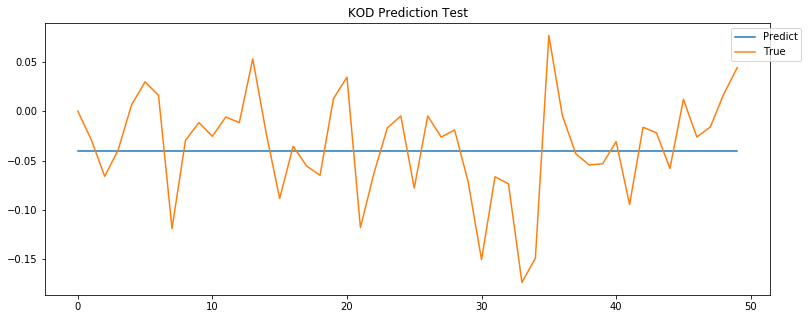

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


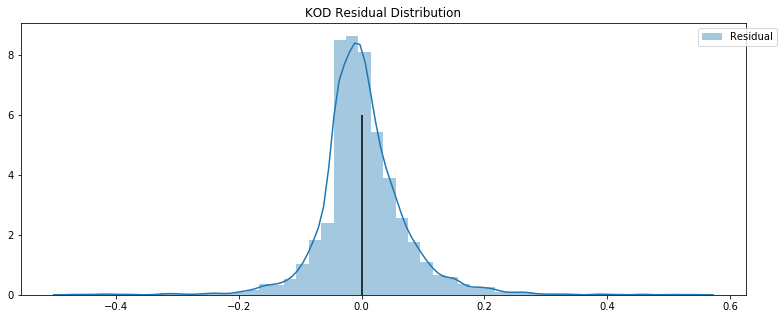

DTIL -0.01443835573735952 -0.0008775760427972568


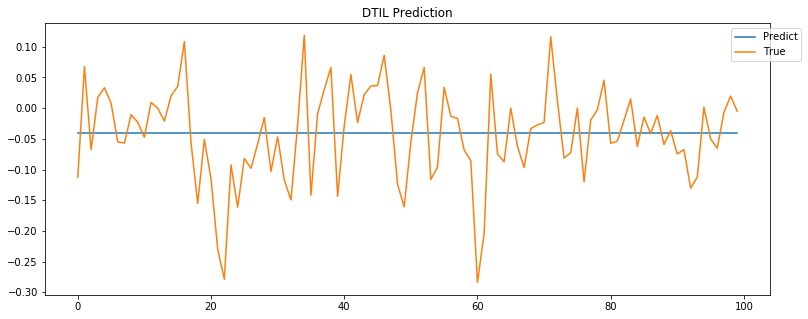

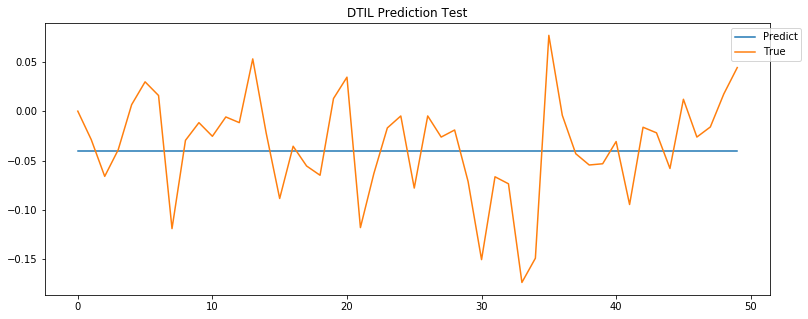

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


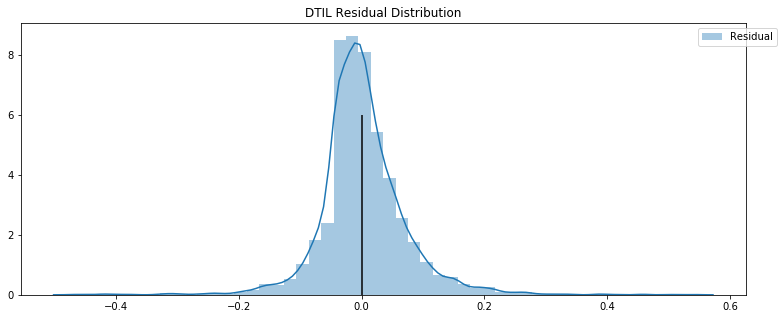

RARX -0.01443835573735952 -0.0008775760427972568


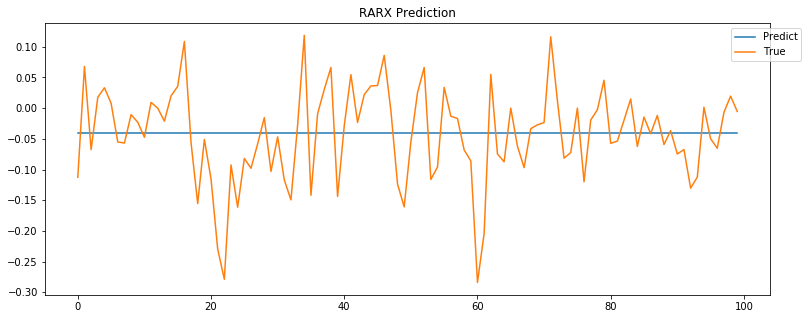

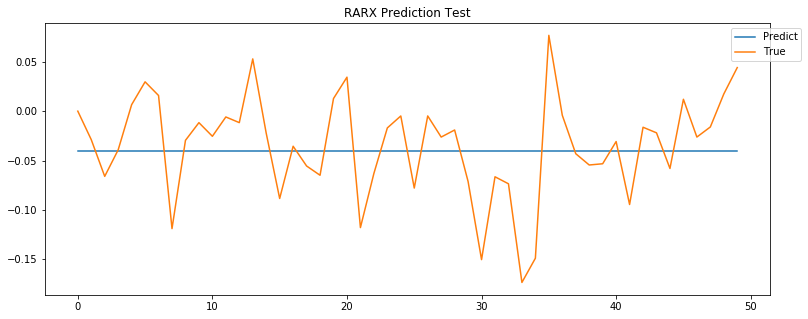

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


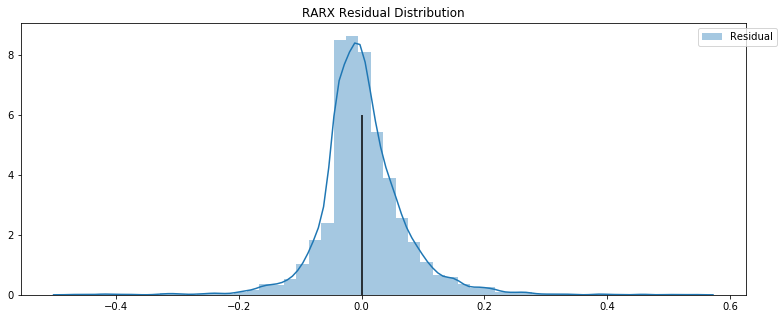

AUTL -0.01443835573735952 -0.0008775760427972568


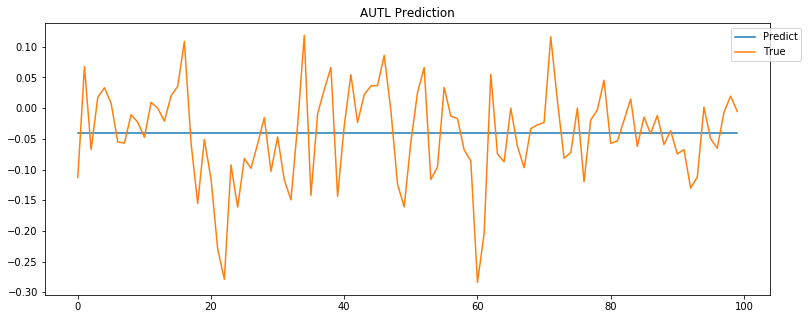

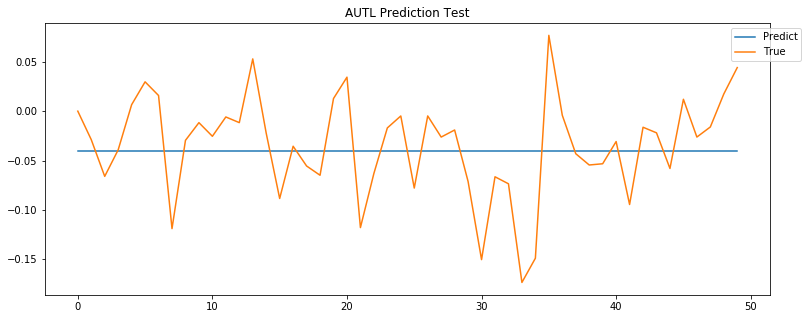

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


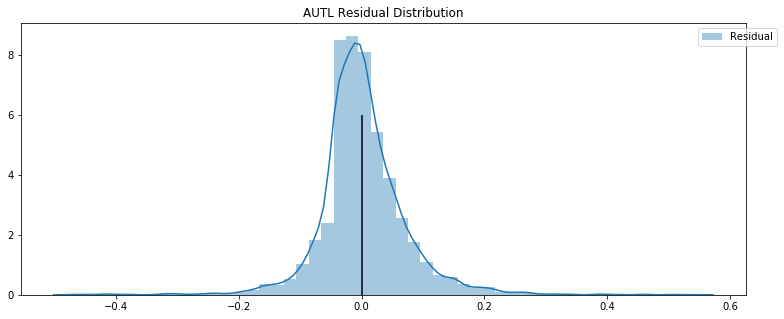

GTHX -0.01443835573735952 -0.0008775760427972568


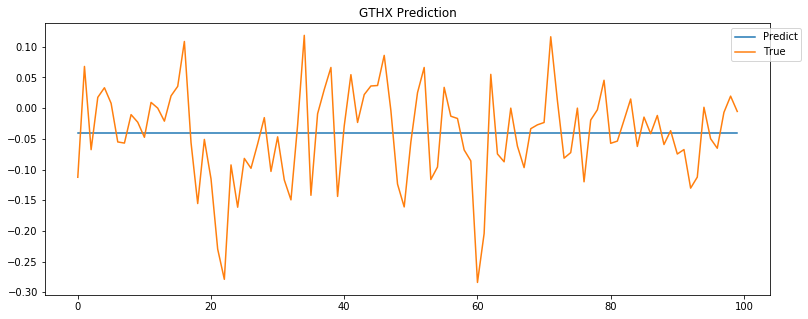

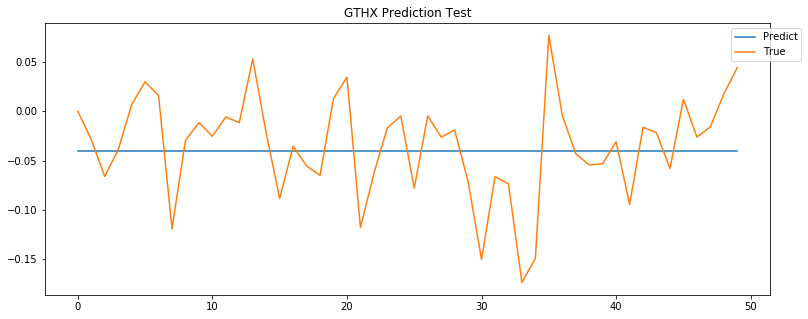

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


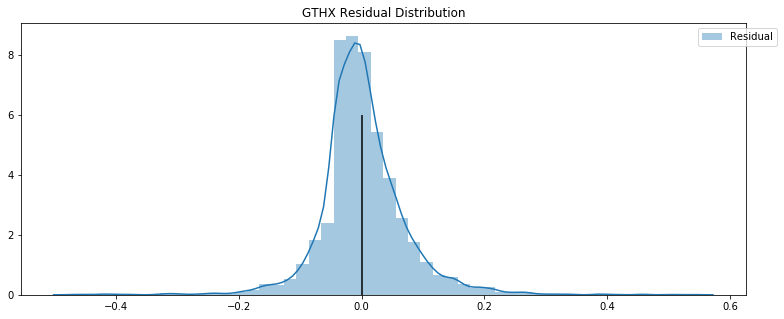

CARA -0.01443835573735952 -0.0008775760427972568


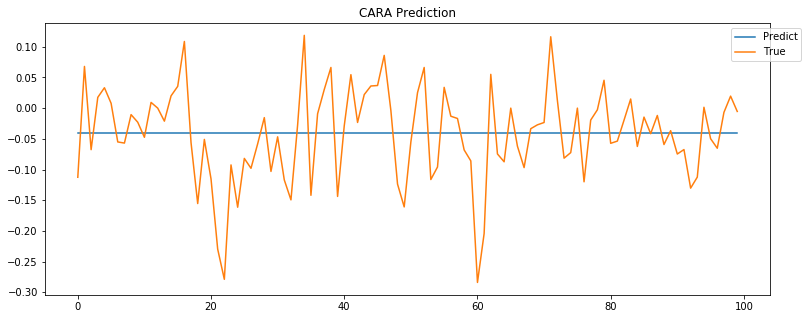

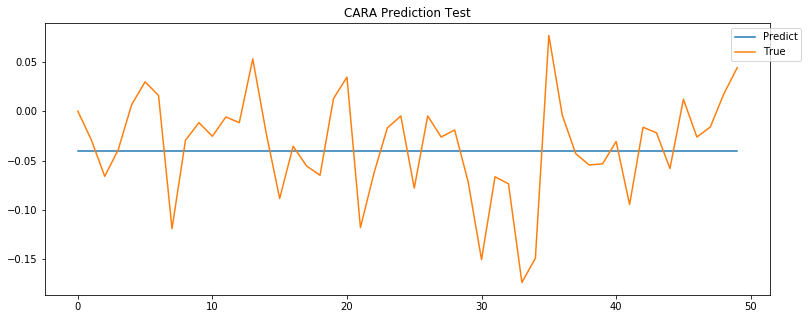

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


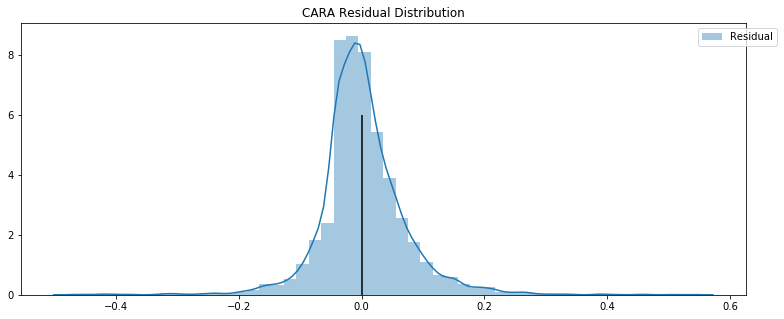

KDMN -0.01443835573735952 -0.0008775760427972568


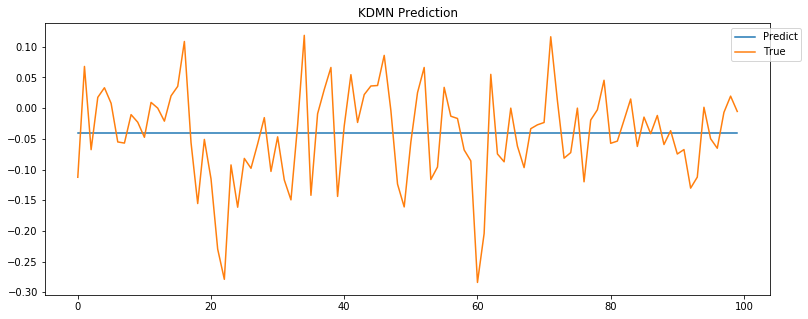

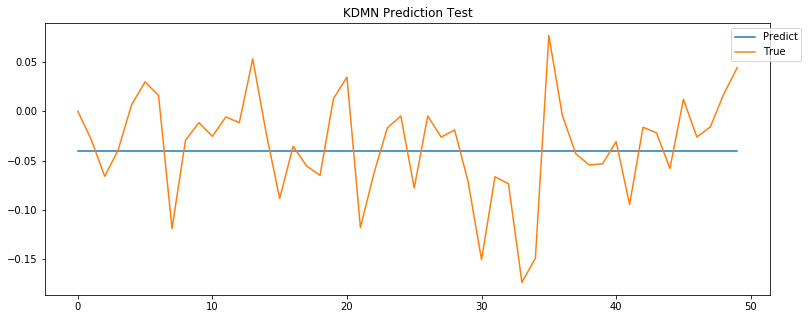

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


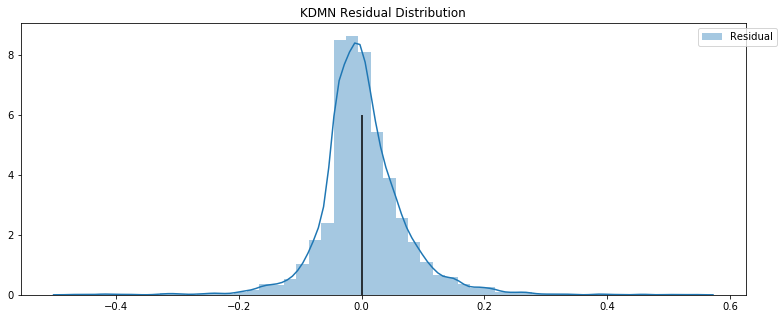

XNCR -0.01443835573735952 -0.0008775760427972568


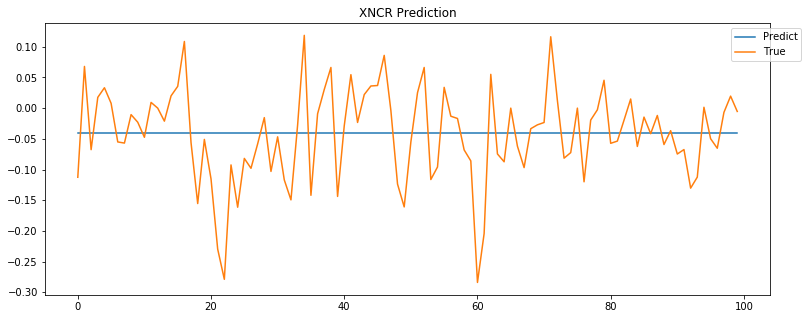

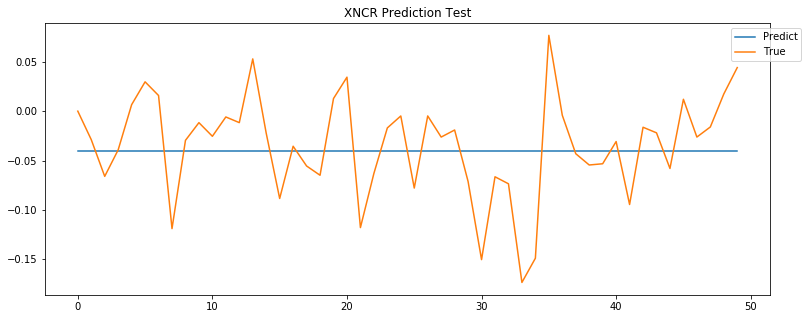

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


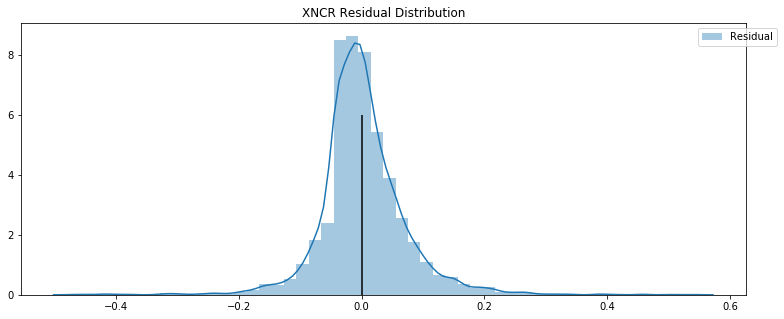

ACHN -0.01443835573735952 -0.0008775760427972568


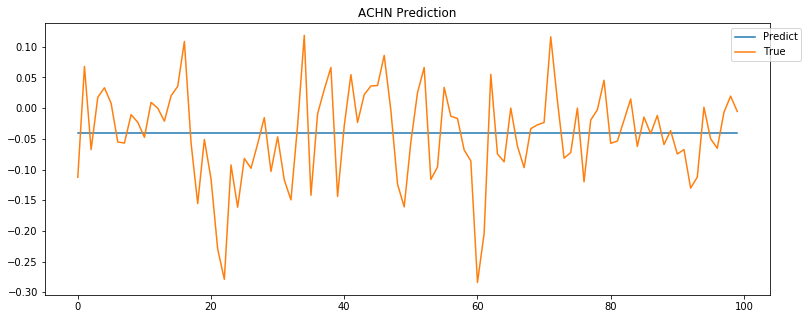

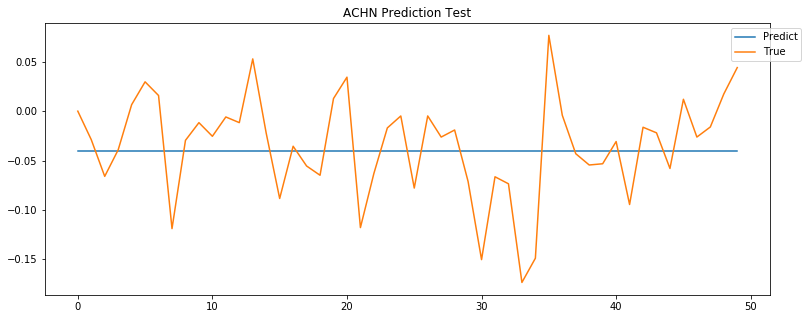

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


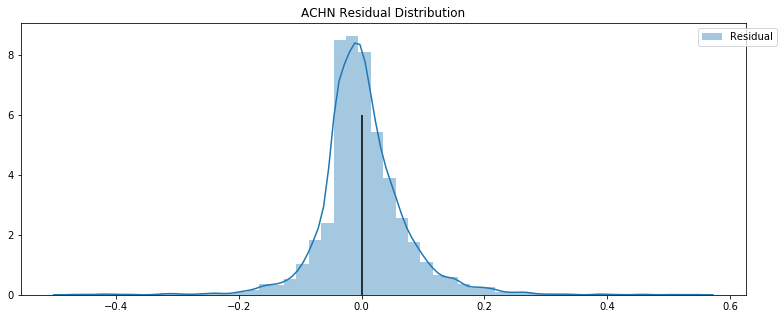

ARNA -0.01443835573735952 -0.0008775760427972568


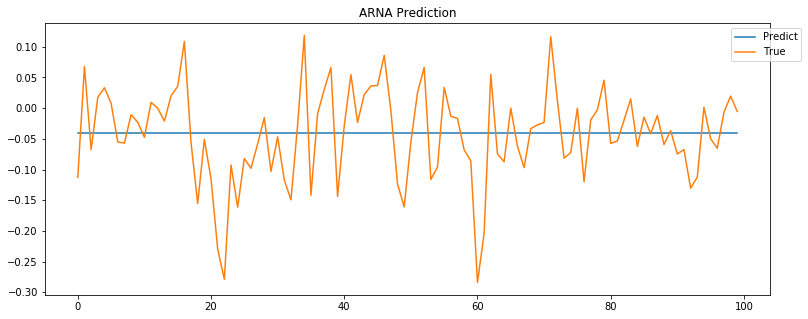

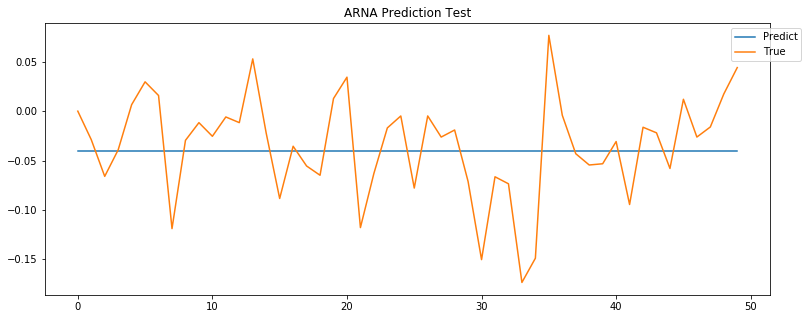

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


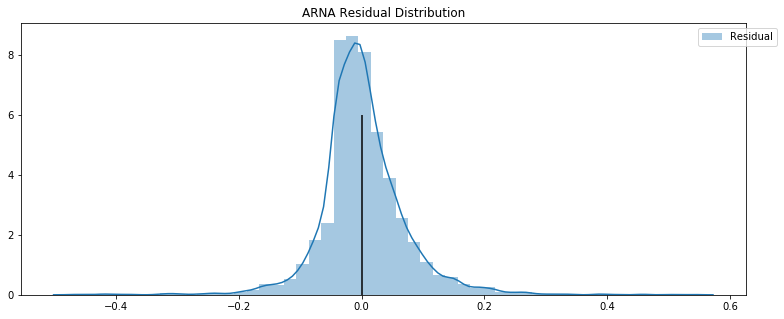

RCKT -0.01443835573735952 -0.0008775760427972568


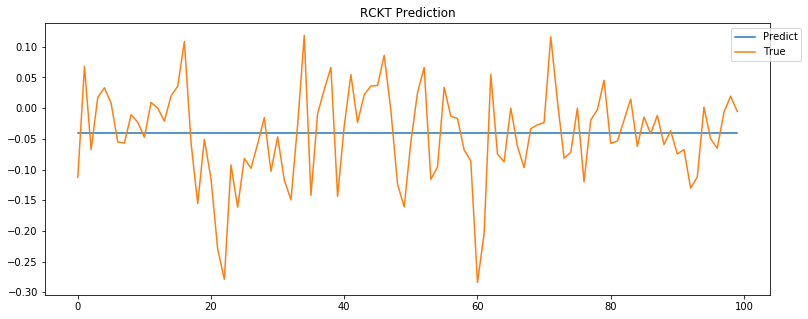

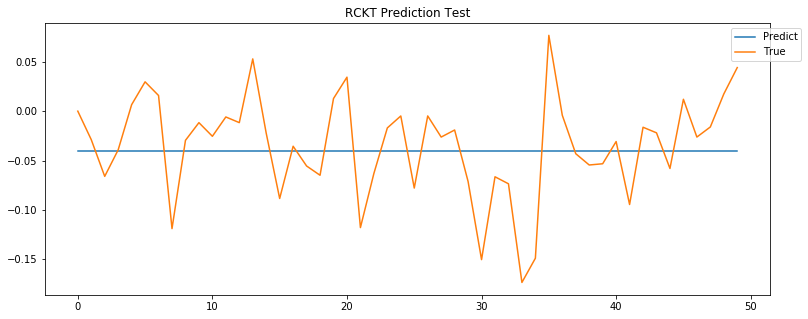

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


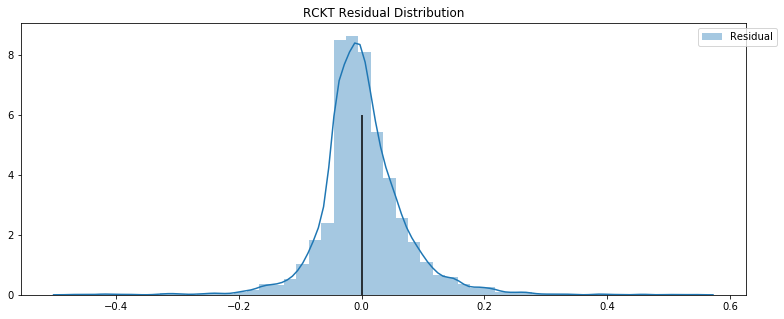

TBIO -0.01443835573735952 -0.0008775760427972568


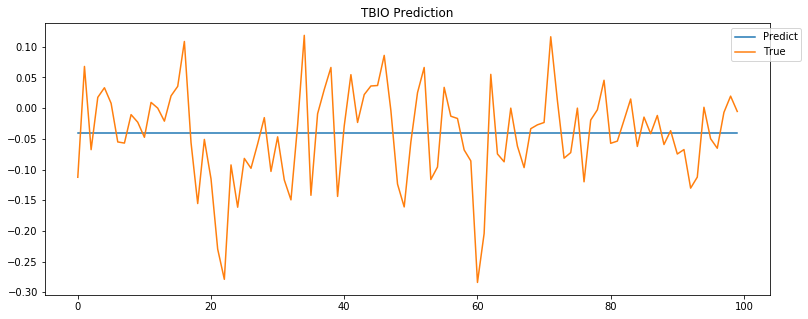

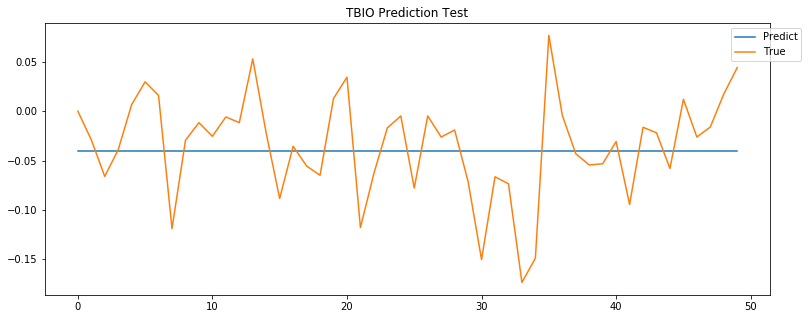

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


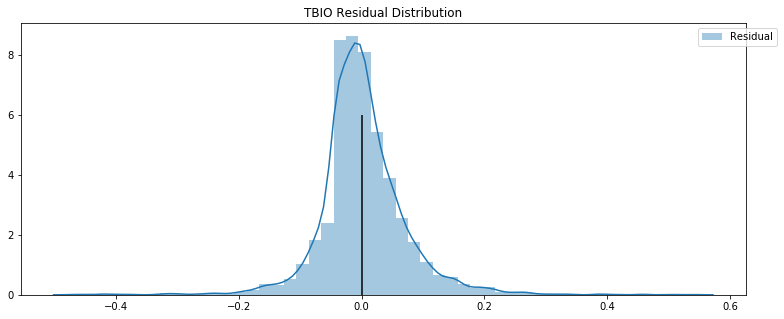

VYGR -0.01443835573735952 -0.0008775760427972568


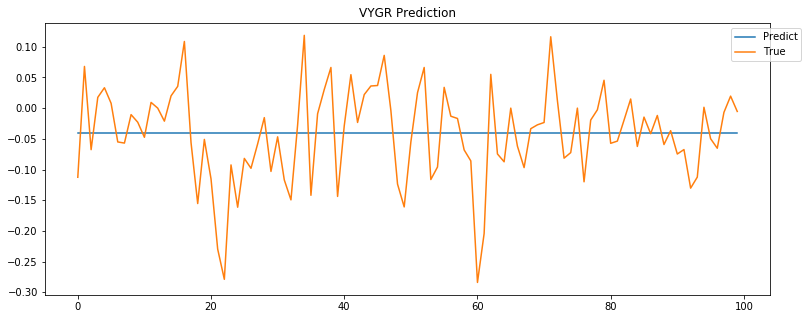

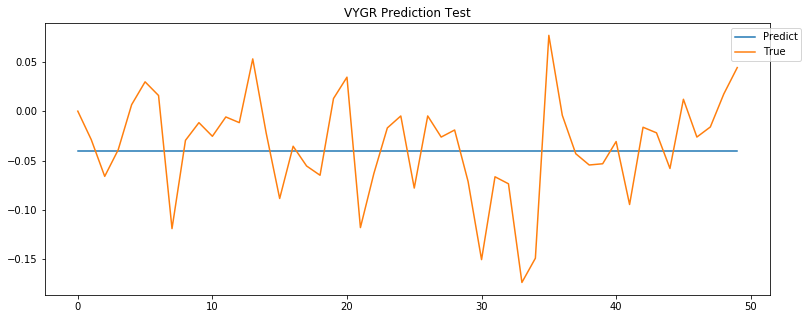

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


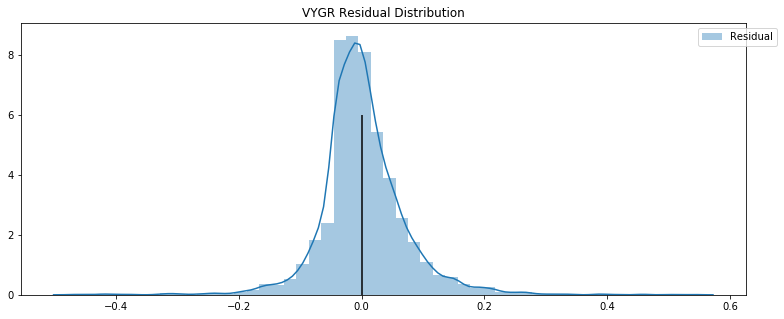

SGMO -0.01443835573735952 -0.0008775760427972568


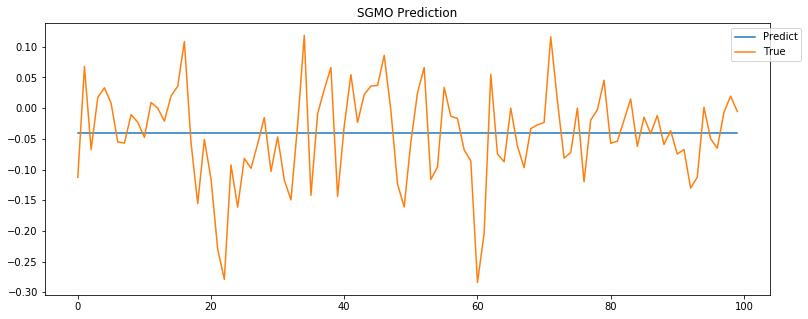

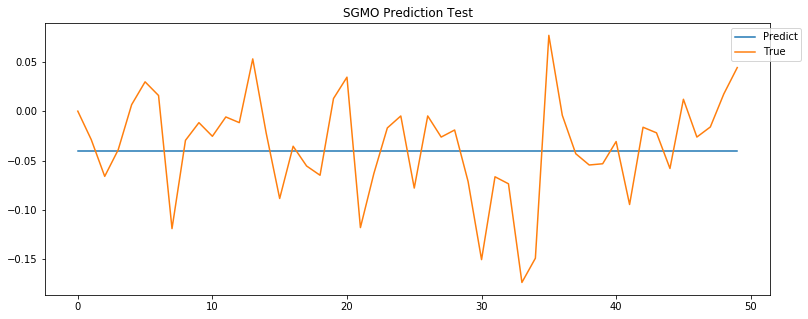

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


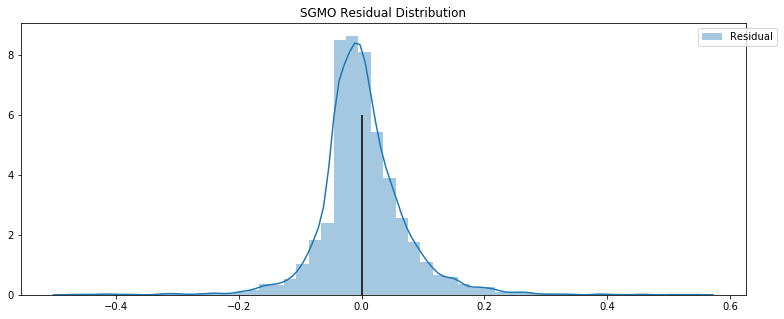

ODT -0.01443835573735952 -0.0008775760427972568


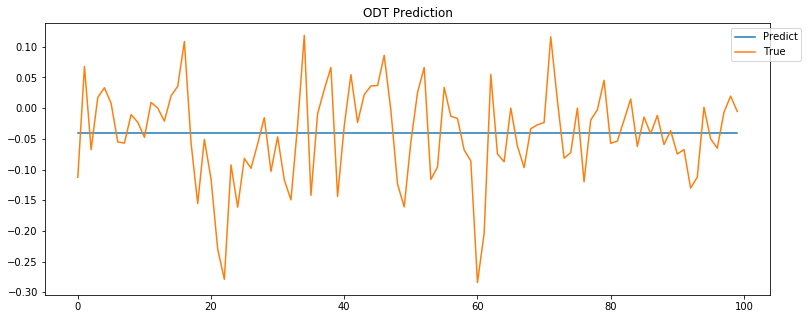

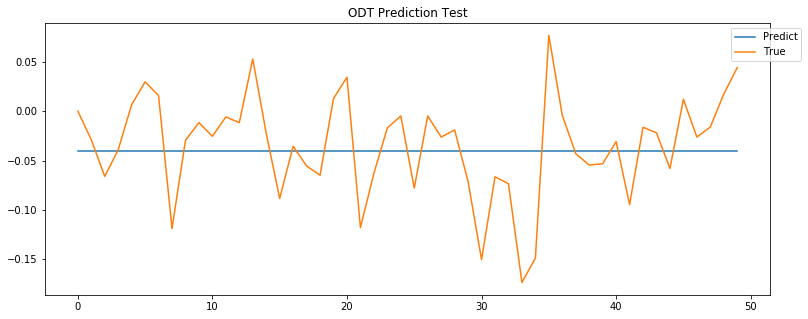

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


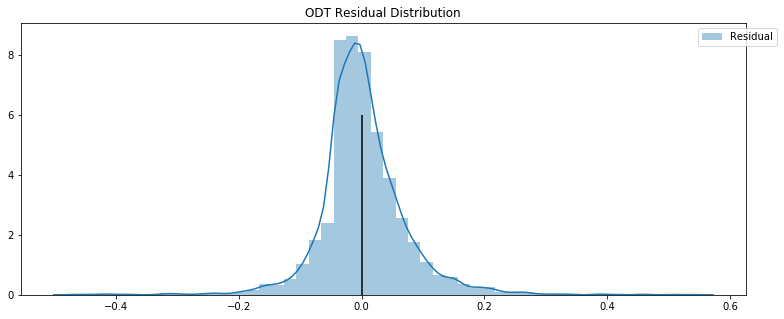

ANAB -0.01443835573735952 -0.0008775760427972568


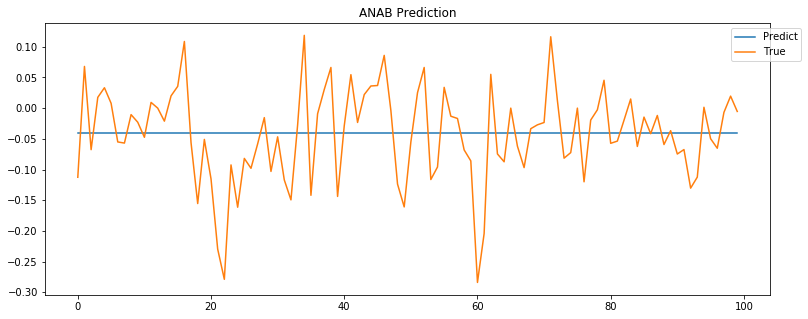

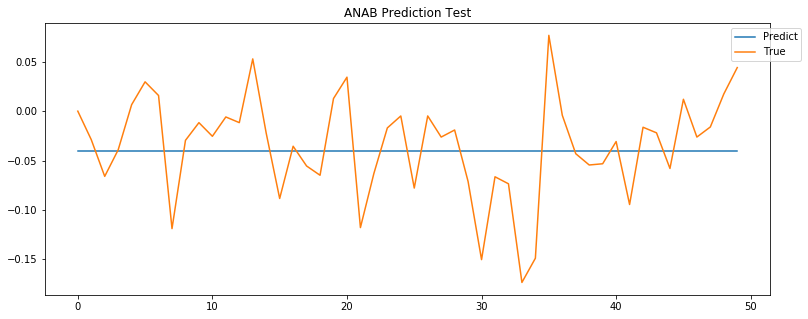

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


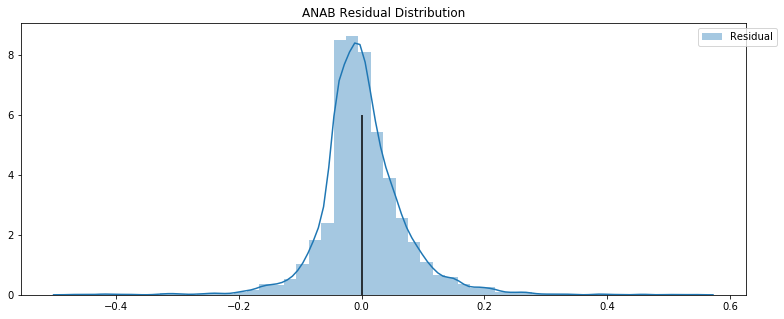

ATRA -0.01443835573735952 -0.0008775760427972568


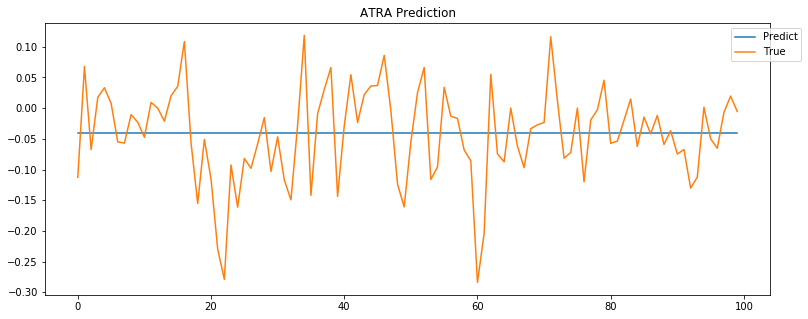

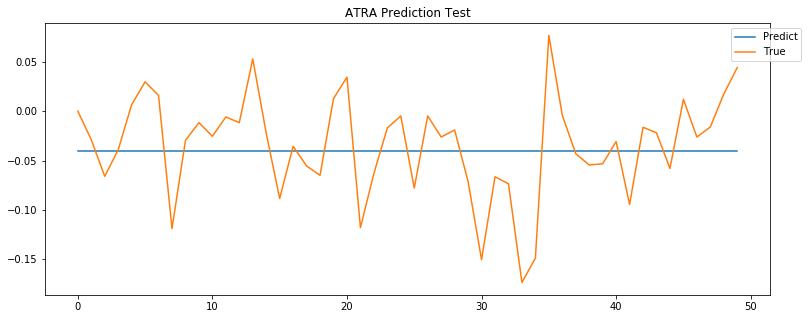

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


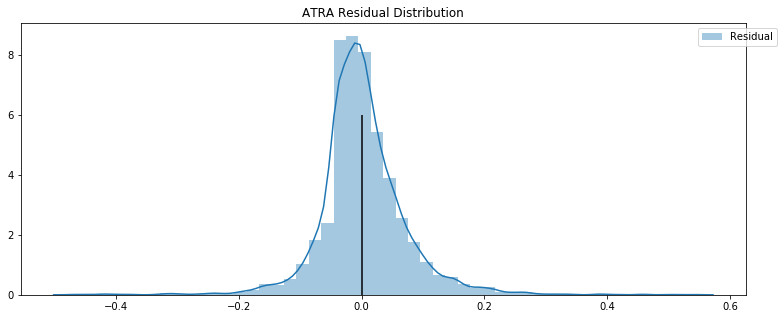

CNST -0.01443835573735952 -0.0008775760427972568


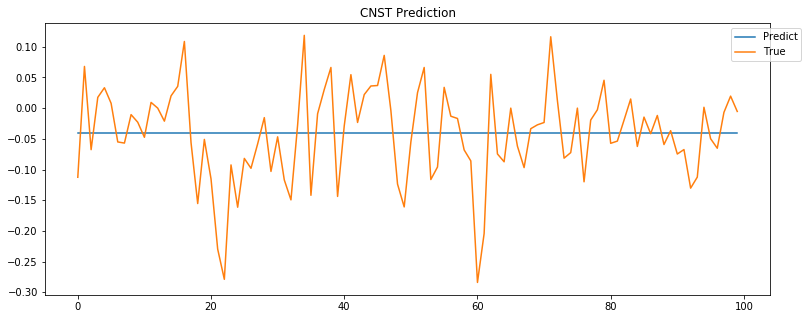

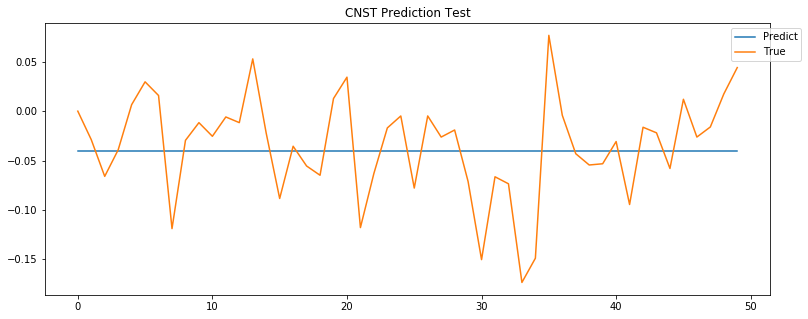

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


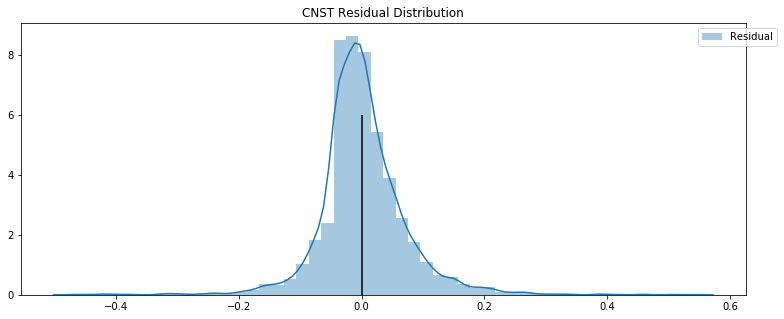

GERN -0.01443835573735952 -0.0008775760427972568


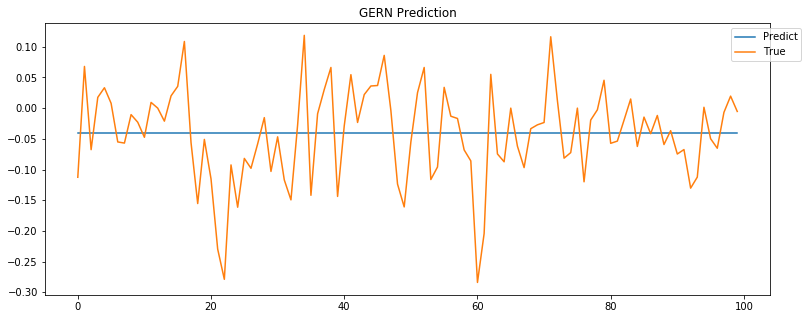

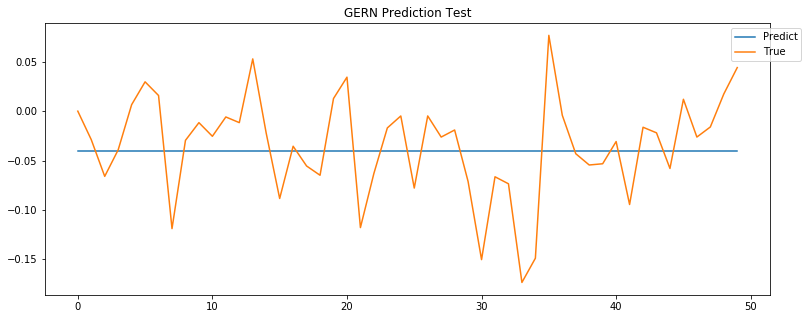

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


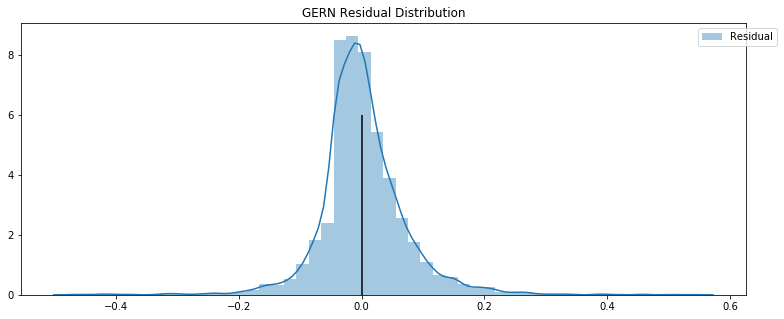

BPMC -0.01443835573735952 -0.0008775760427972568


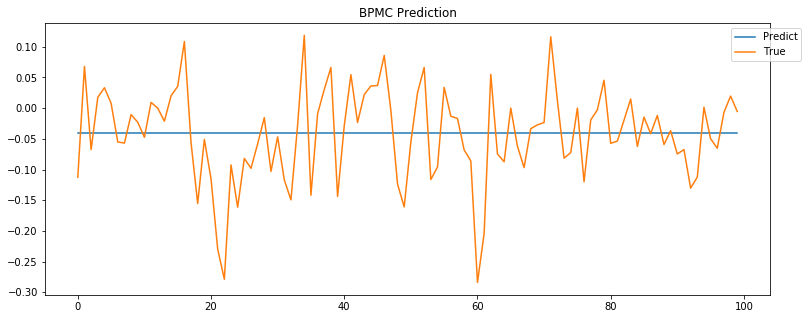

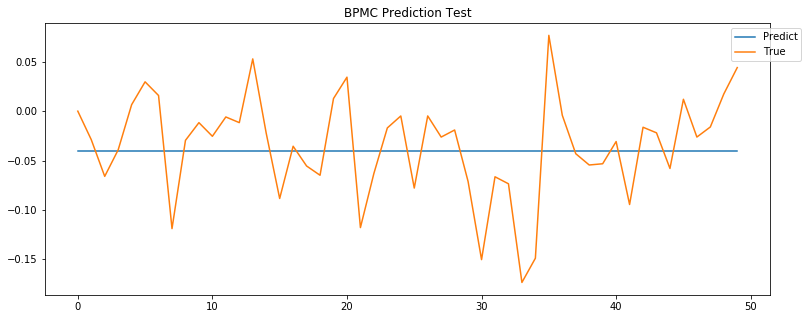

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


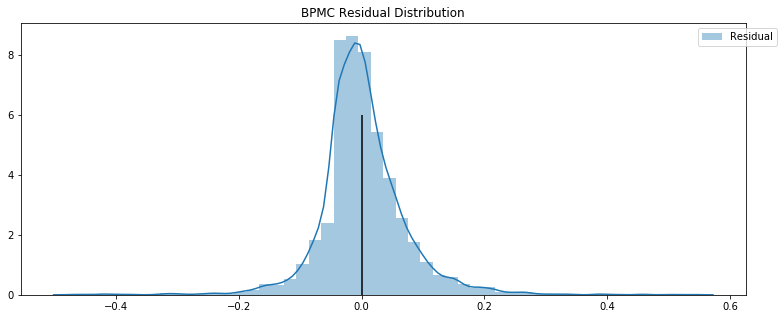

ALLO -0.01443835573735952 -0.0008775760427972568


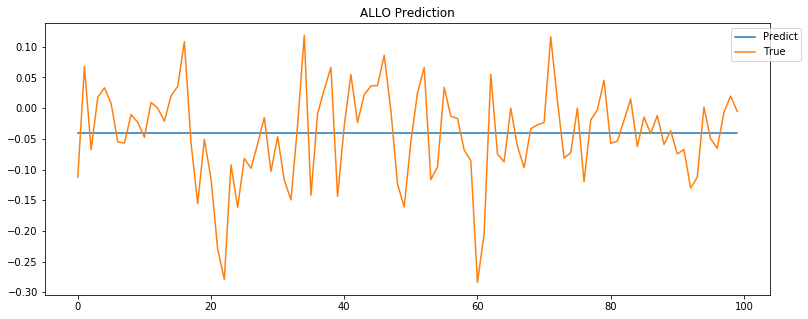

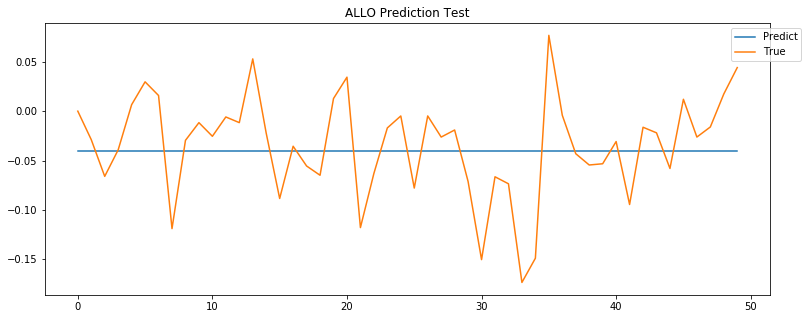

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


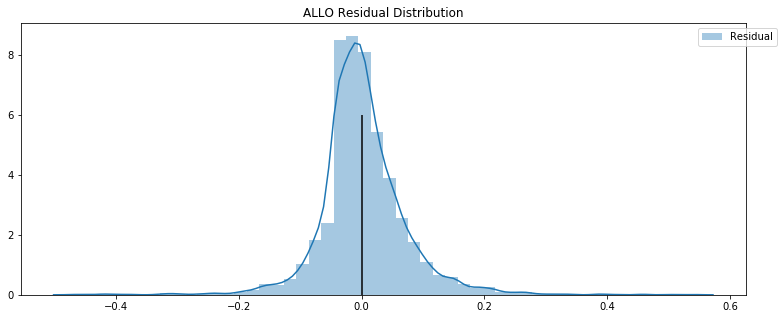

BBIO -0.01443835573735952 -0.0008775760427972568


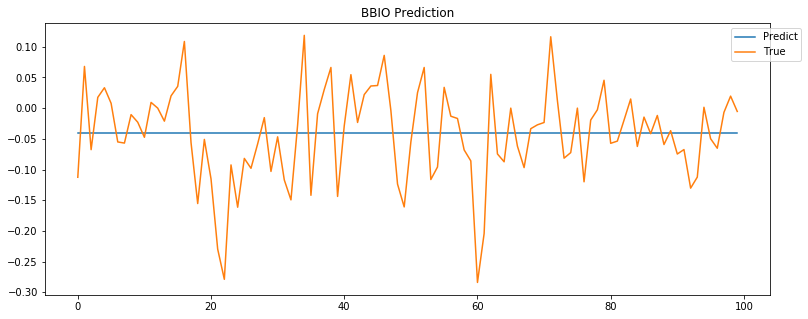

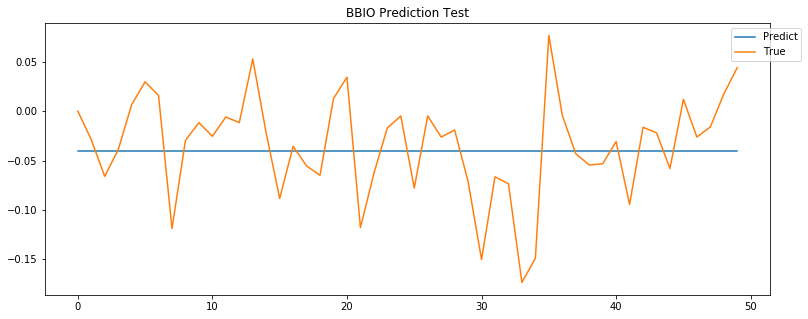

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


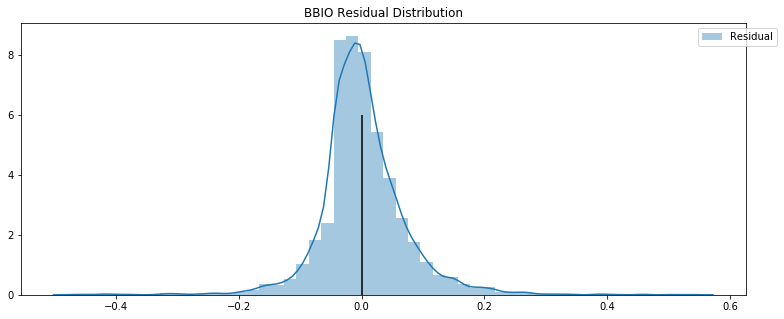

FGEN -0.01443835573735952 -0.0008775760427972568


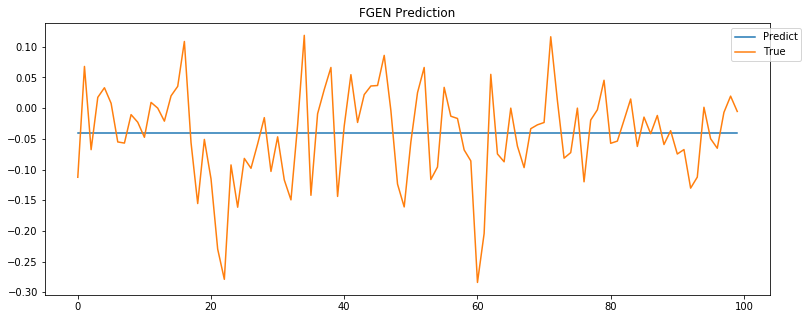

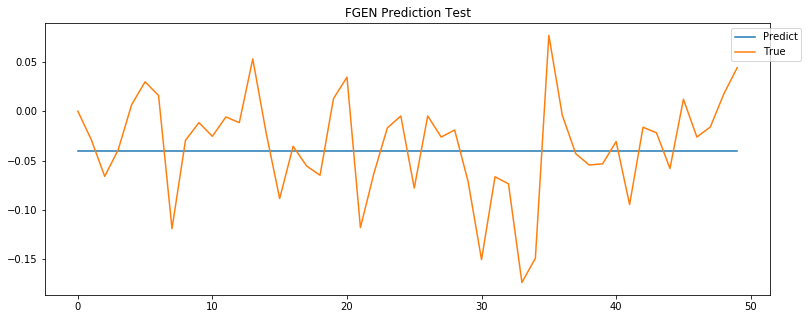

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


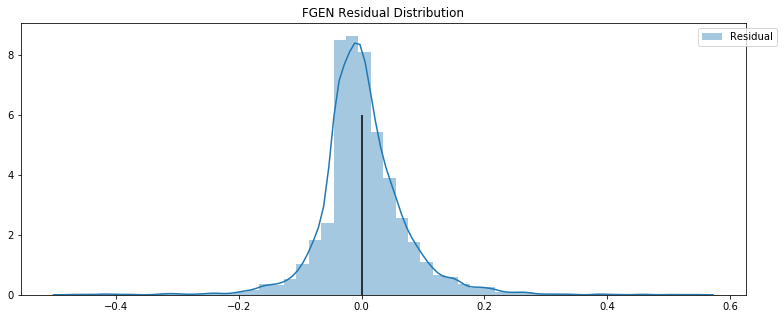

PGNX -0.01443835573735952 -0.0008775760427972568


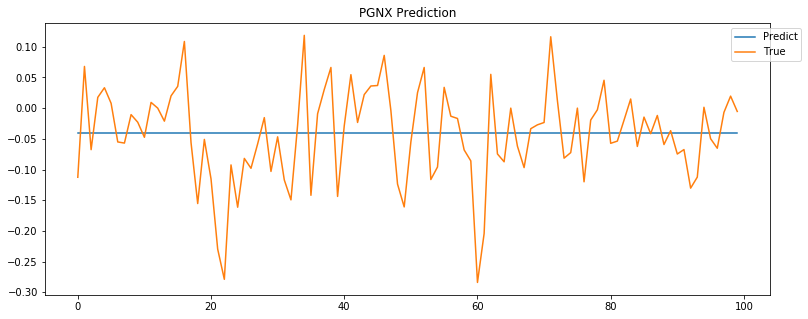

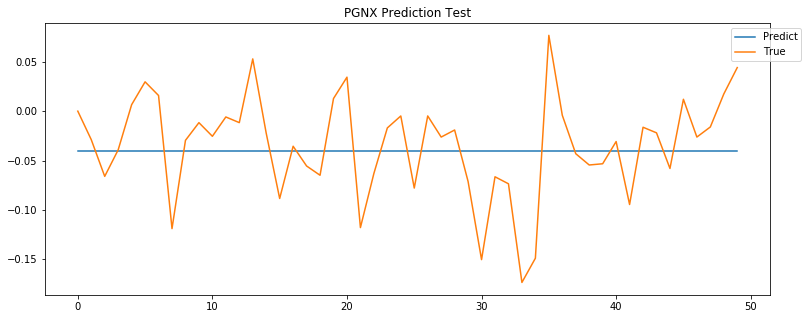

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


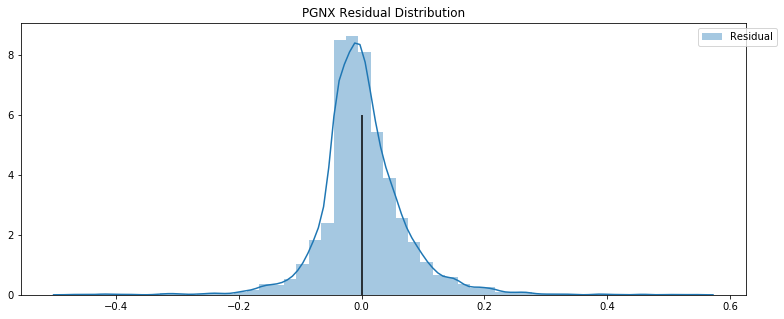

MGTX -0.01443835573735952 -0.0008775760427972568


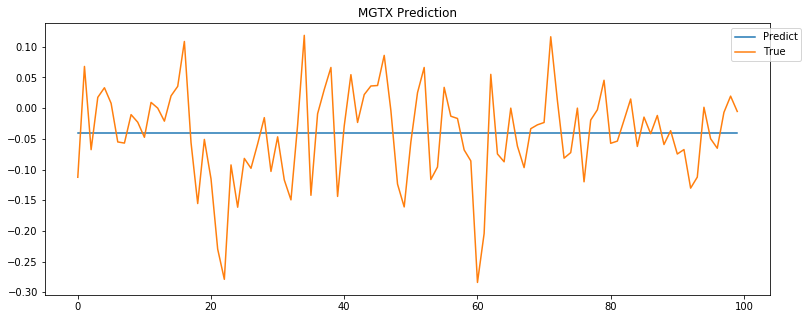

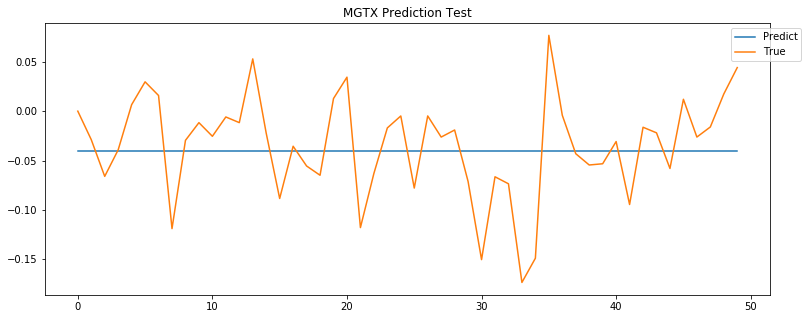

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


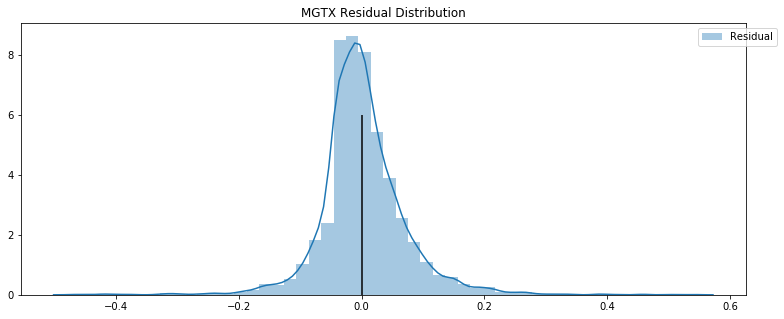

NXTC -0.01443835573735952 -0.0008775760427972568


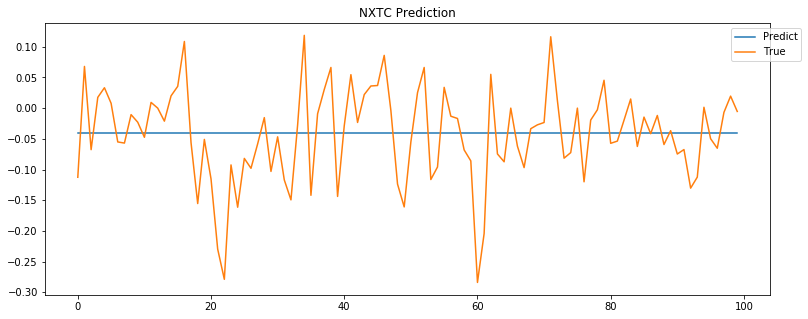

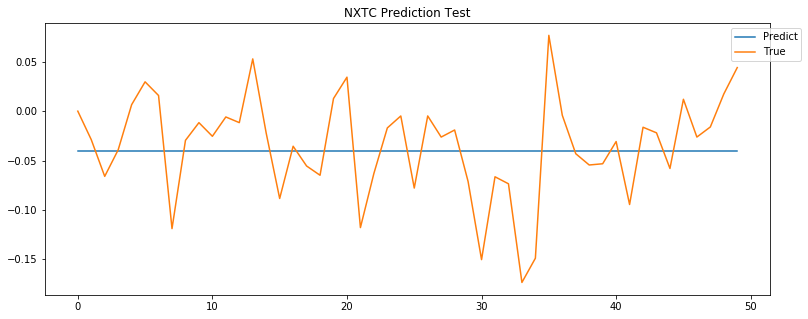

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


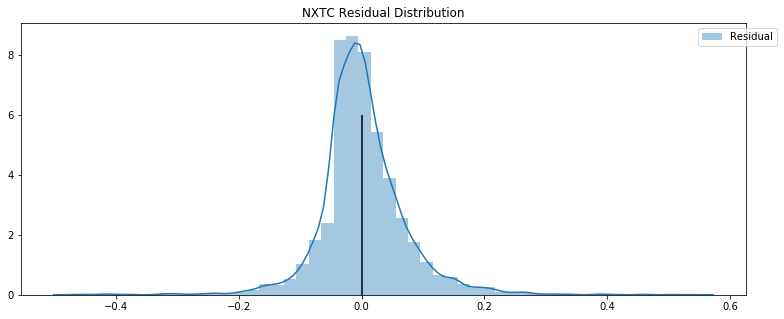

IMMU -0.01443835573735952 -0.0008775760427972568


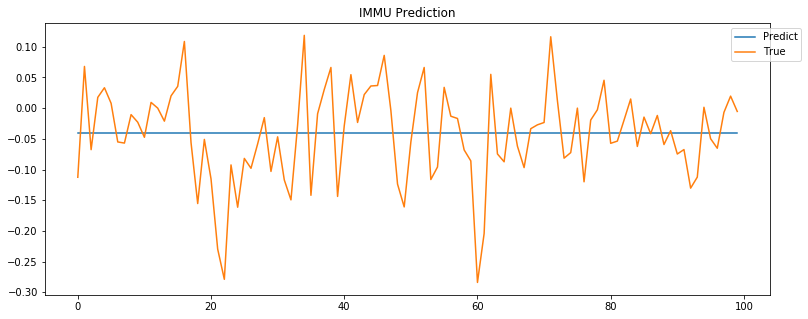

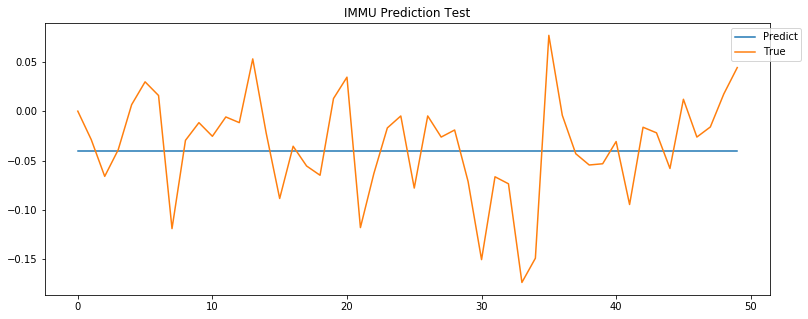

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


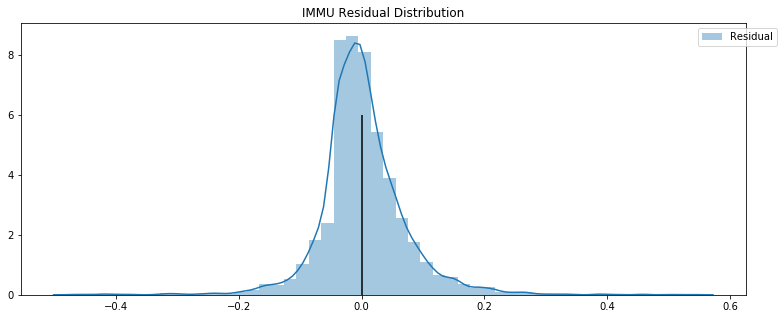

ZIOP -0.01443835573735952 -0.0008775760427972568


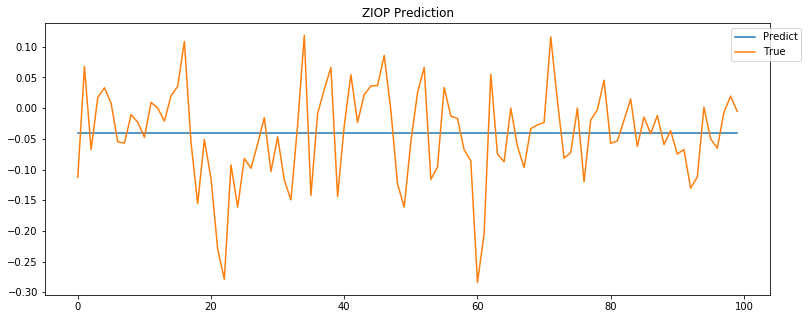

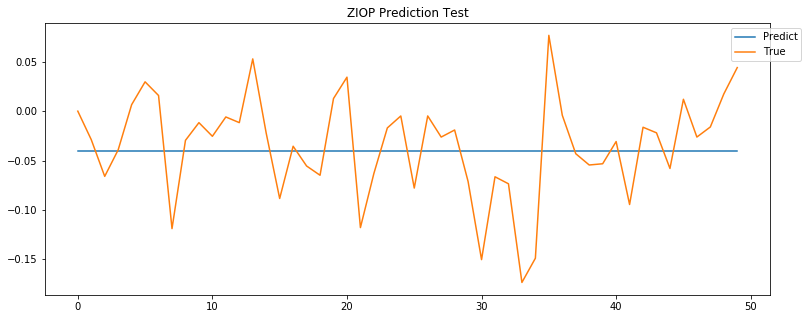

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


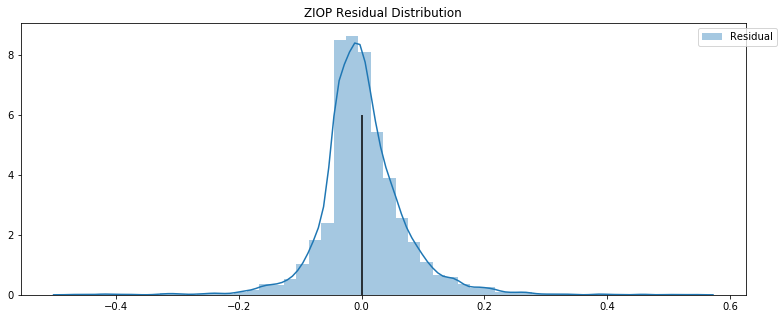

CRSP -0.01443835573735952 -0.0008775760427972568


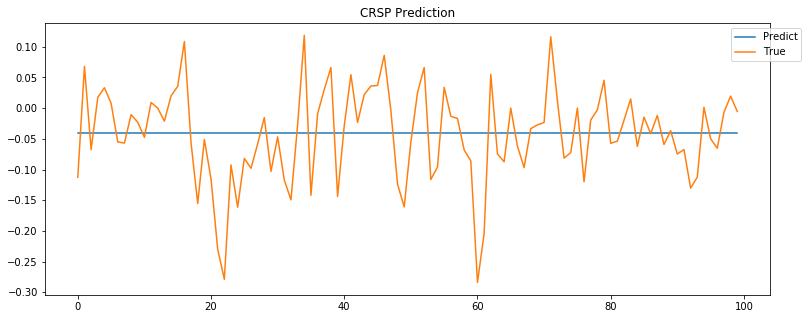

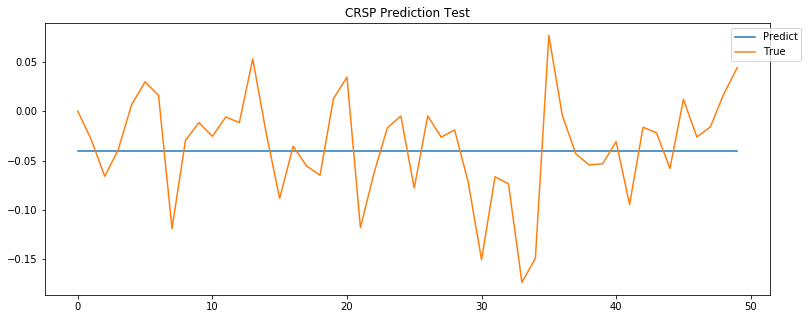

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


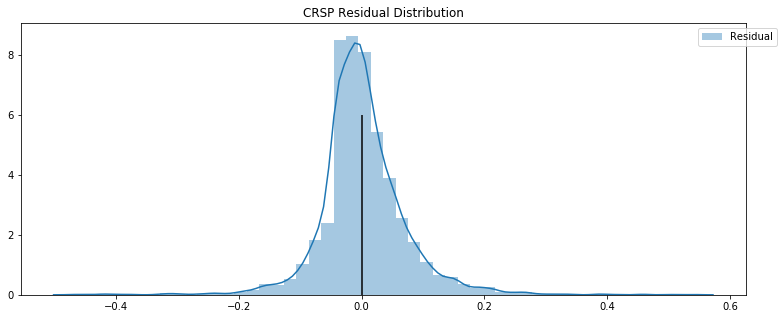

IOVA -0.01443835573735952 -0.0008775760427972568


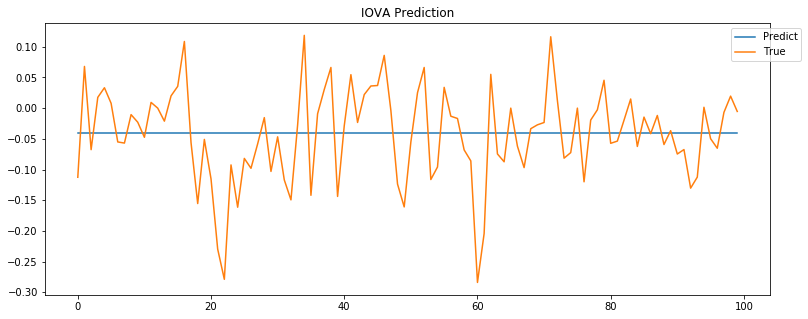

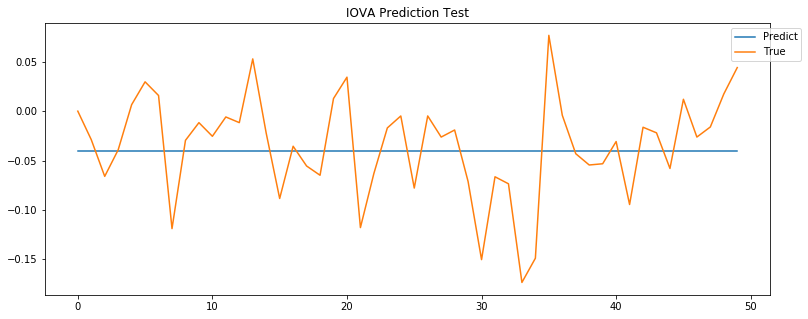

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


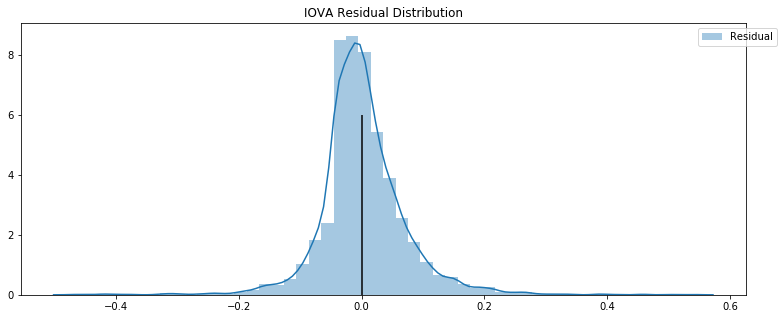

VKTX -0.01443835573735952 -0.0008775760427972568


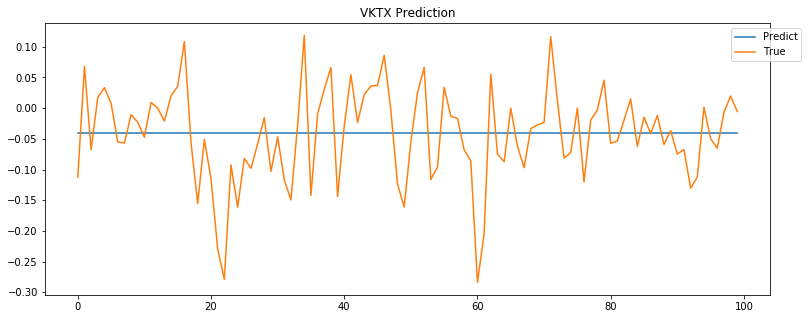

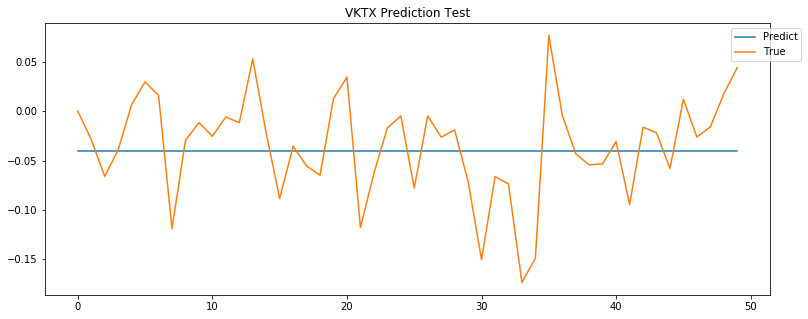

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


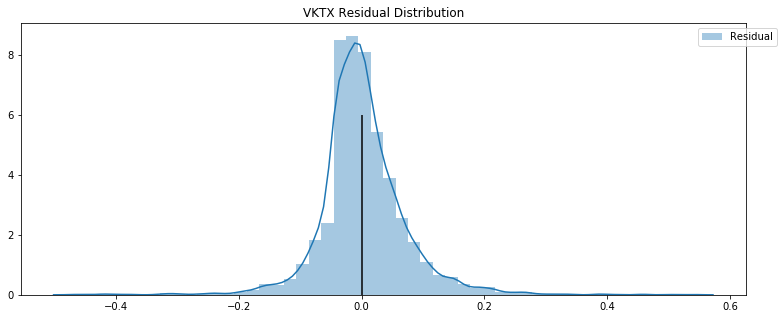

EIDX -0.01443835573735952 -0.0008775760427972568


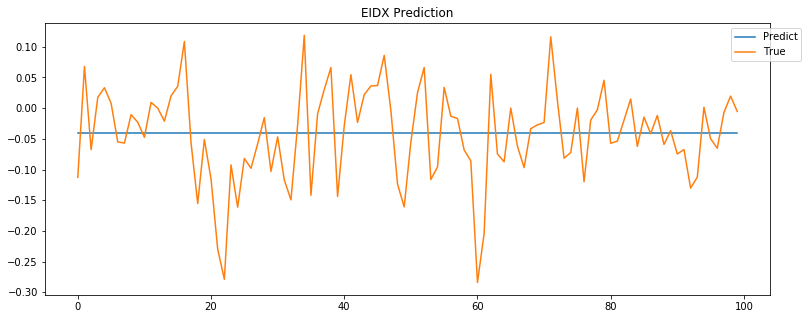

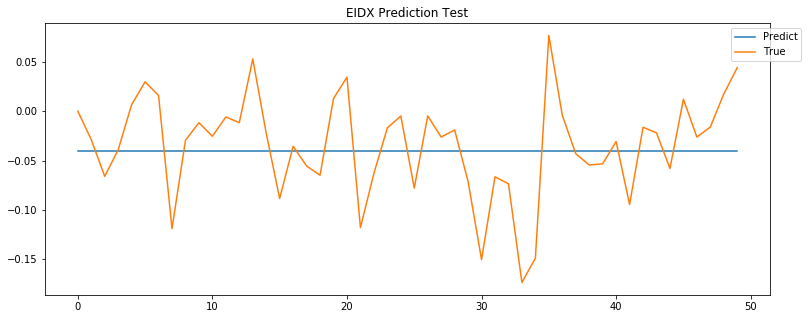

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


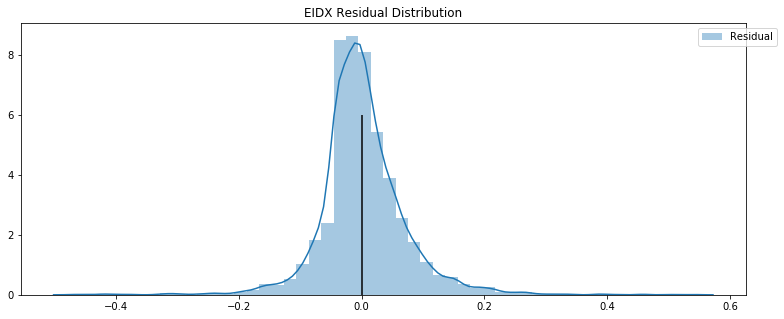

MYOV -0.01443835573735952 -0.0008775760427972568


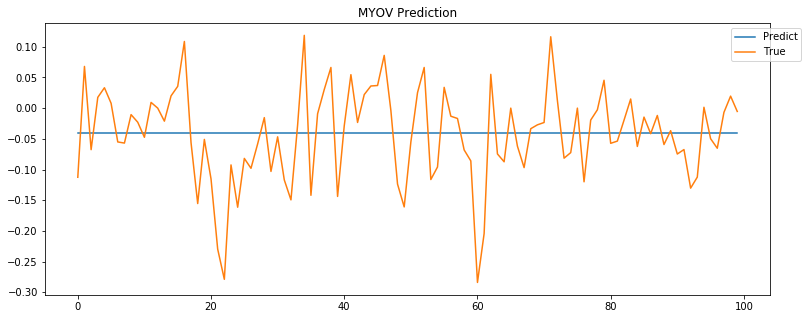

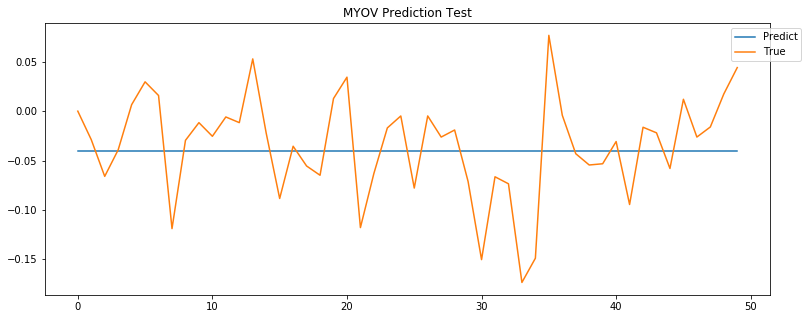

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


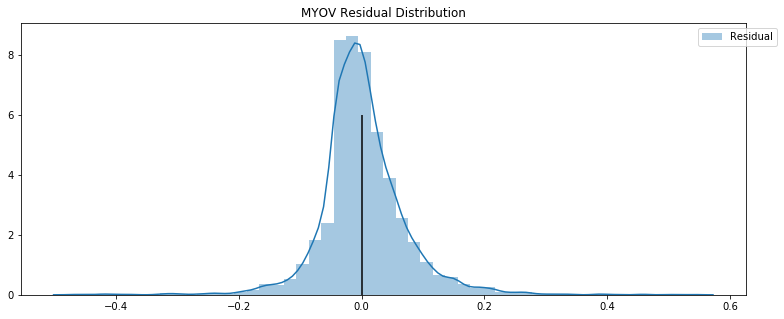

AMRS -0.01443835573735952 -0.0008775760427972568


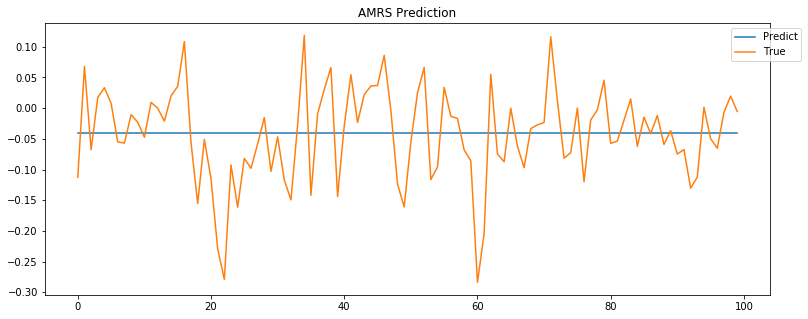

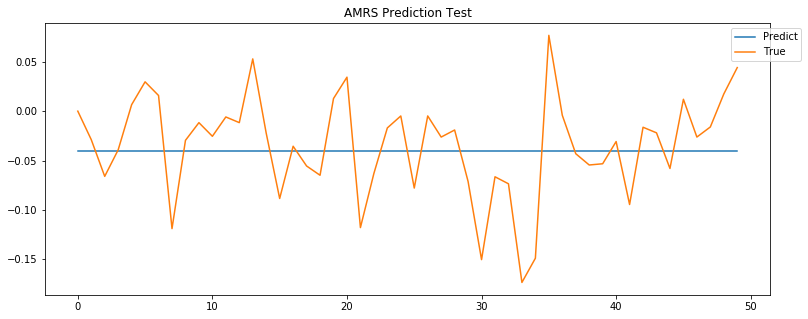

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


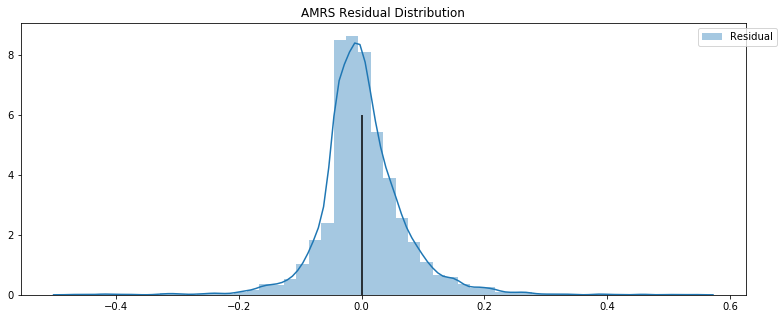

KRYS -0.01443835573735952 -0.0008775760427972568


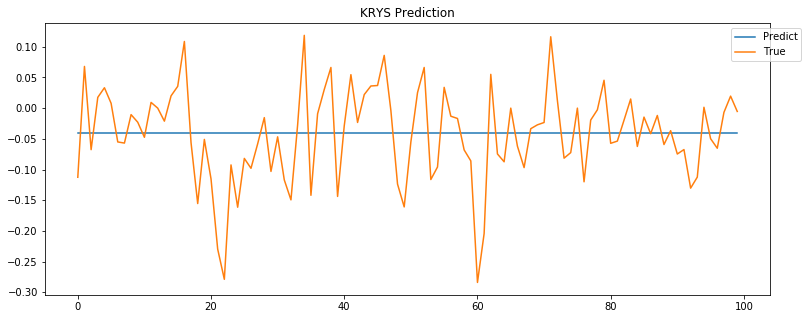

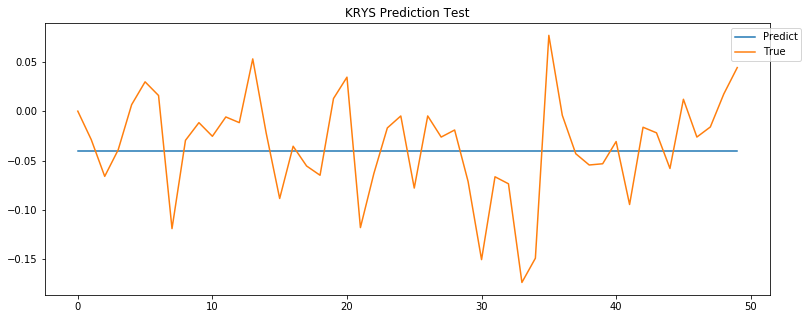

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


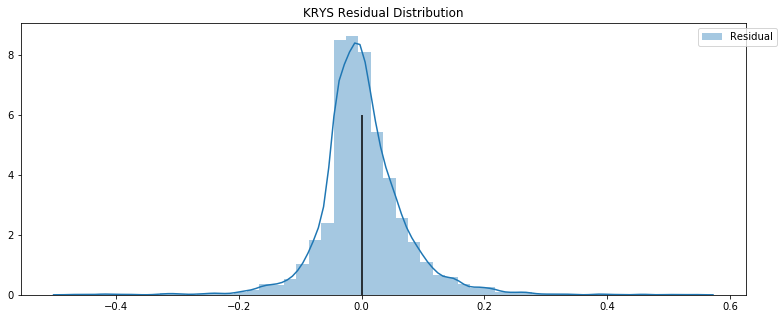

KURA -0.01443835573735952 -0.0008775760427972568


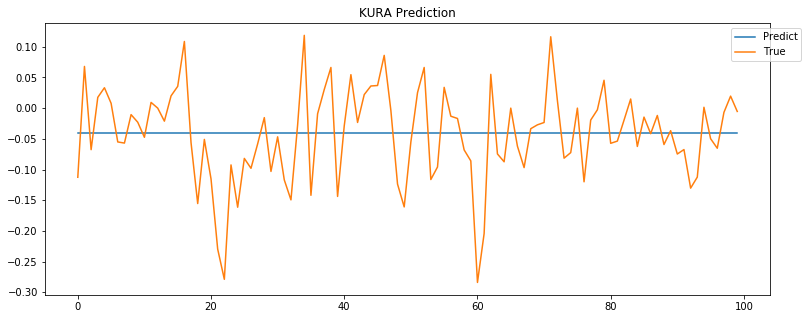

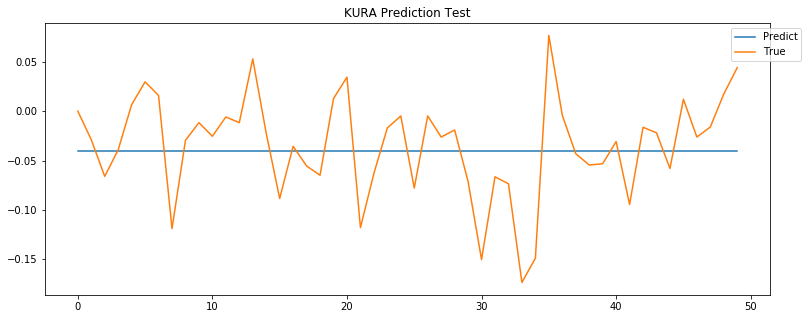

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


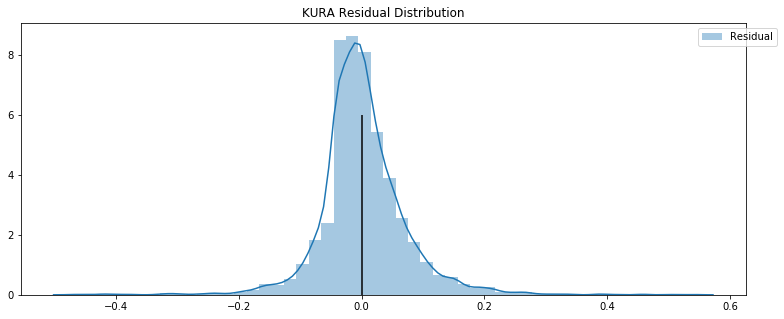

MDGL -0.01443835573735952 -0.0008775760427972568


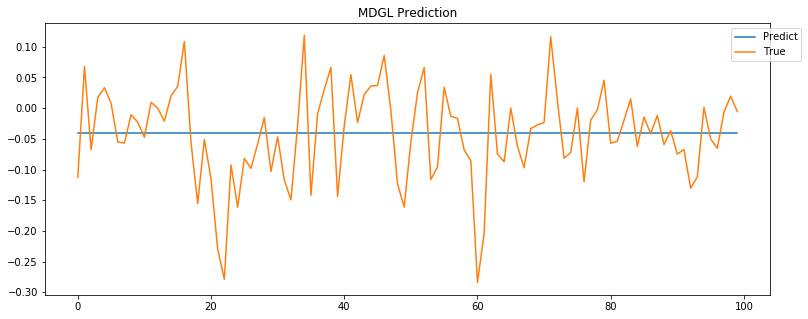

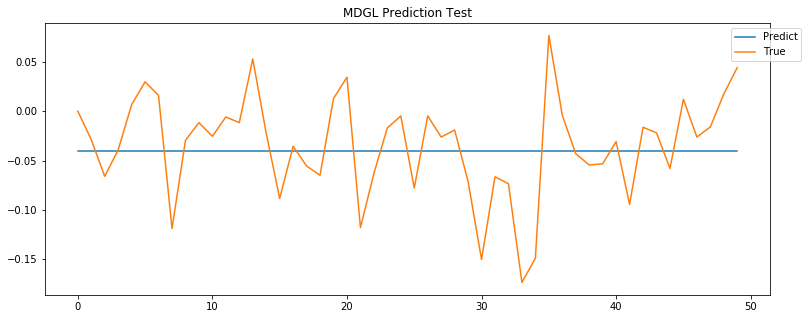

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


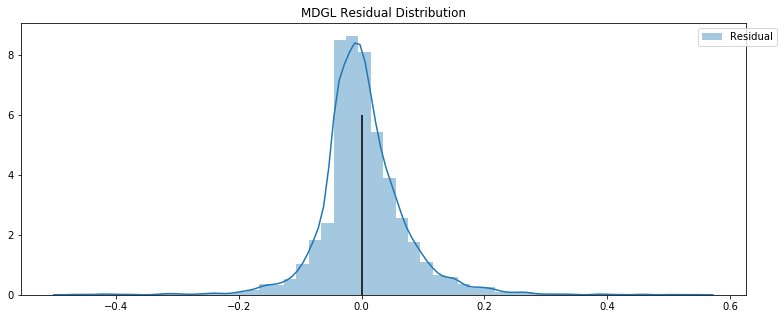

UBX -0.01443835573735952 -0.0008775760427972568


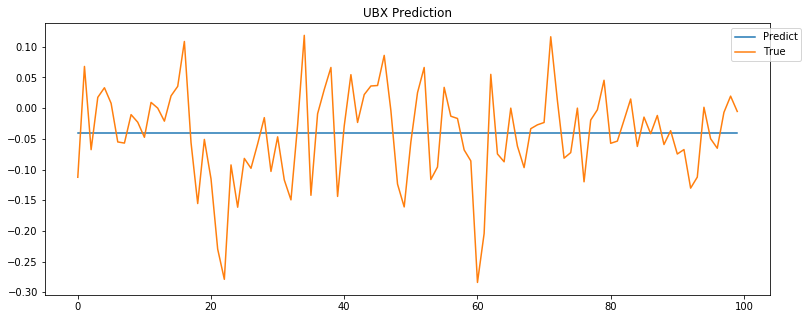

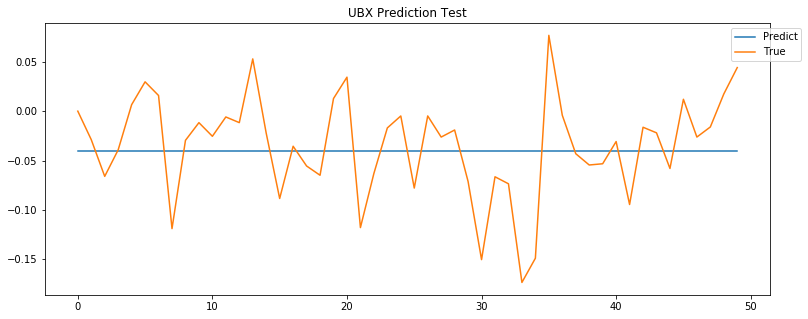

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


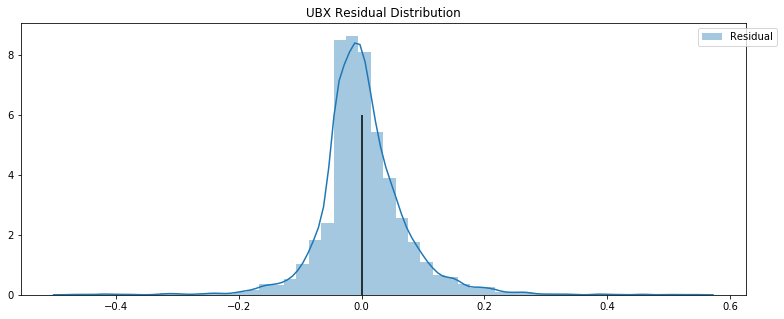

TCDA -0.01443835573735952 -0.0008775760427972568


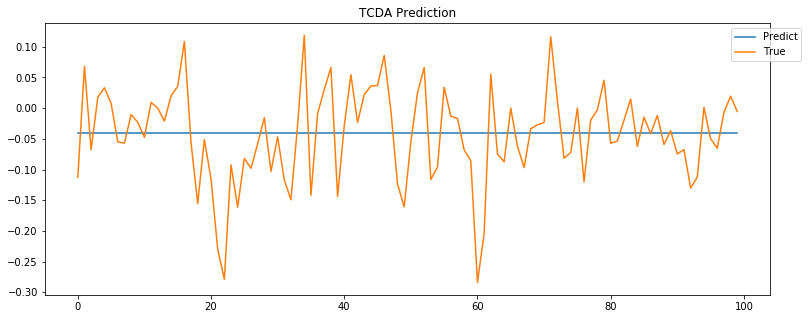

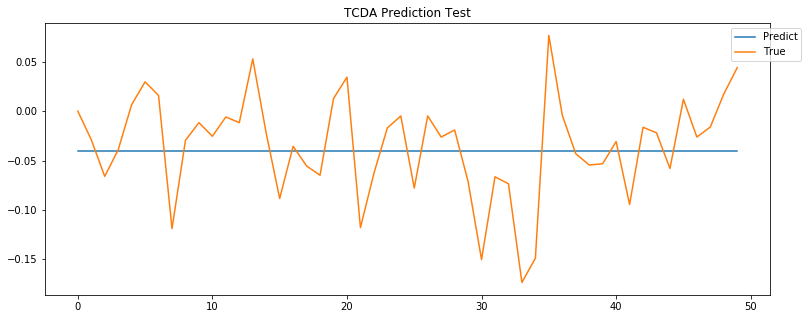

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


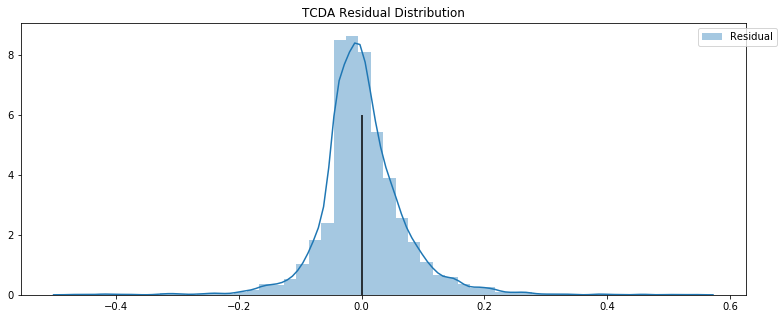

QURE -0.01443835573735952 -0.0008775760427972568


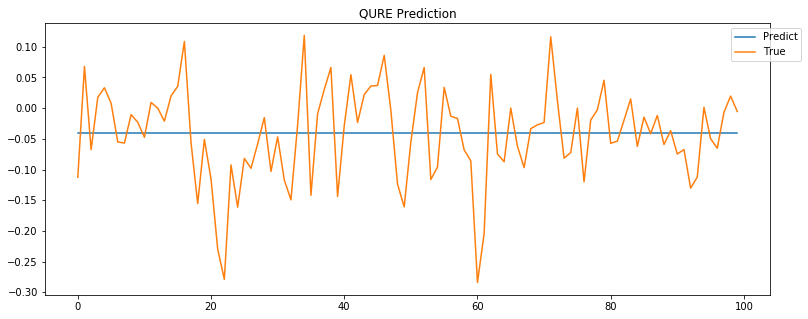

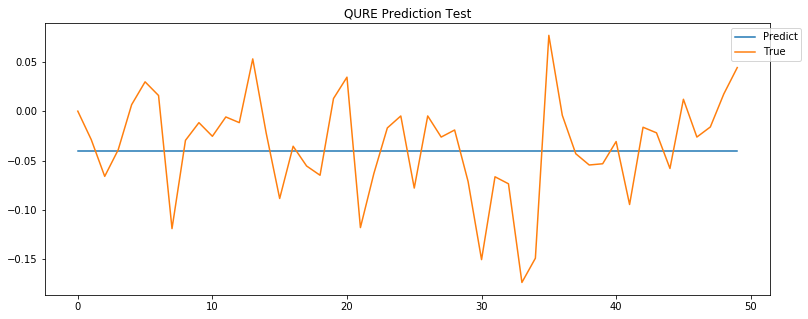

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


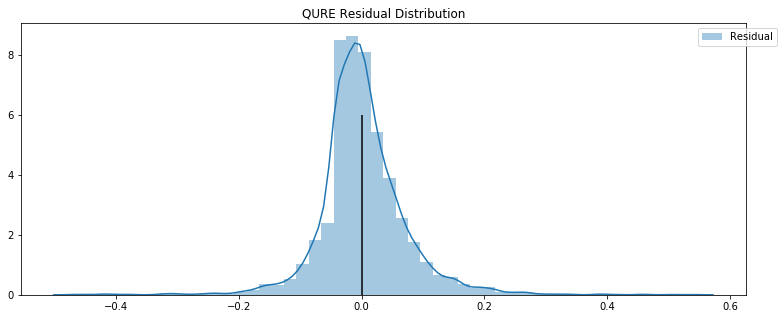

MRTX -0.01443835573735952 -0.0008775760427972568


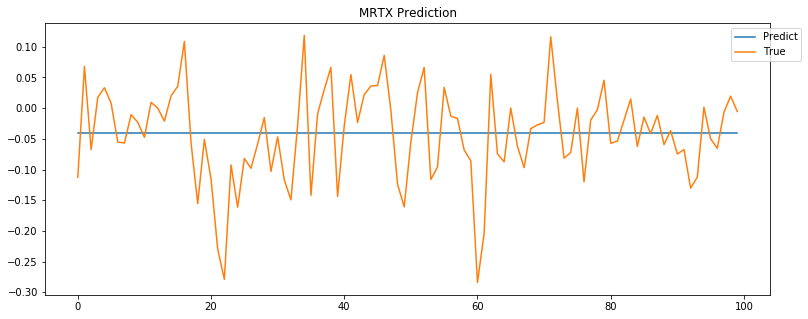

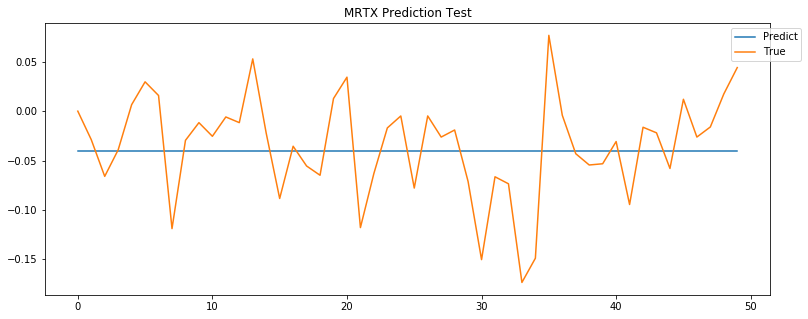

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


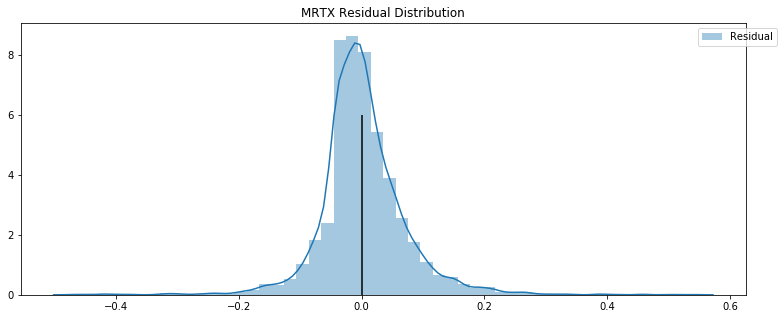

ASMB -0.01443835573735952 -0.0008775760427972568


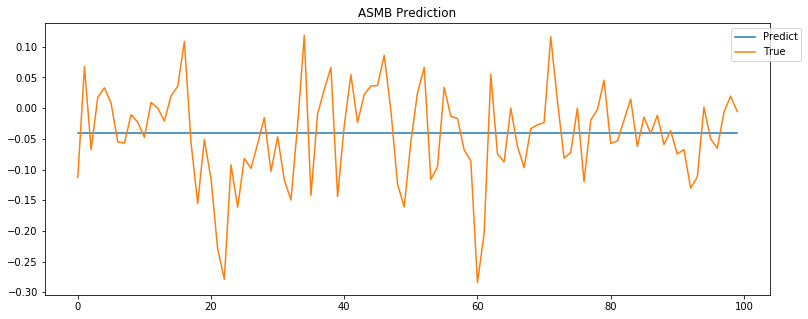

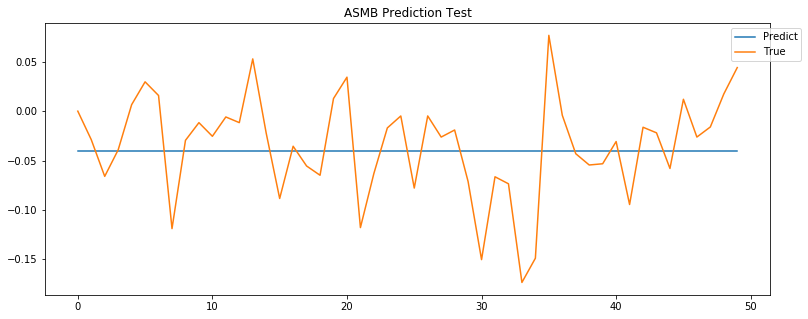

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


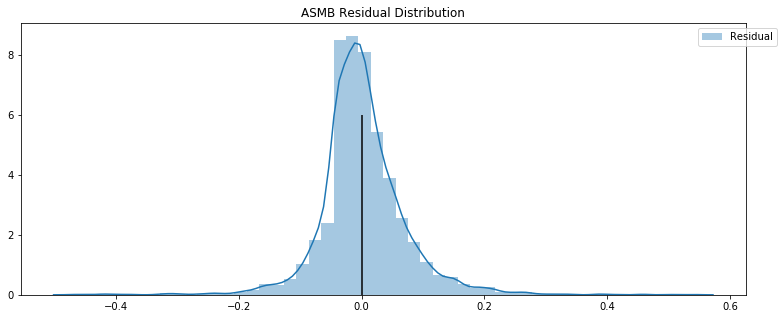

GLYC -0.01443835573735952 -0.0008775760427972568


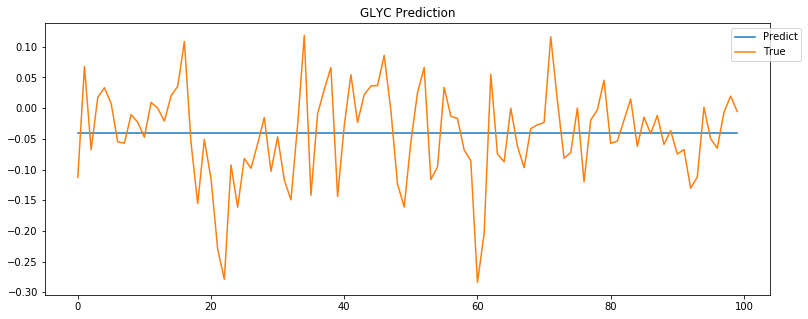

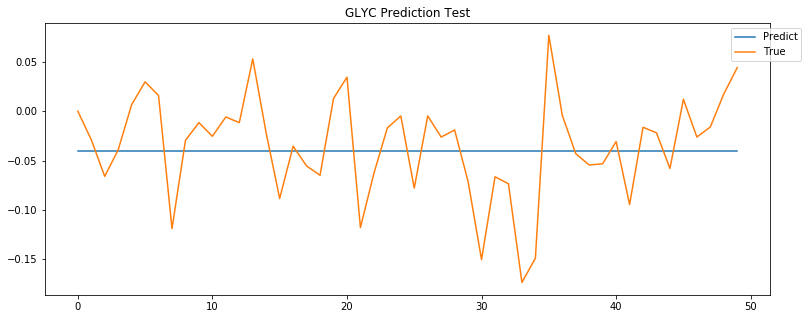

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


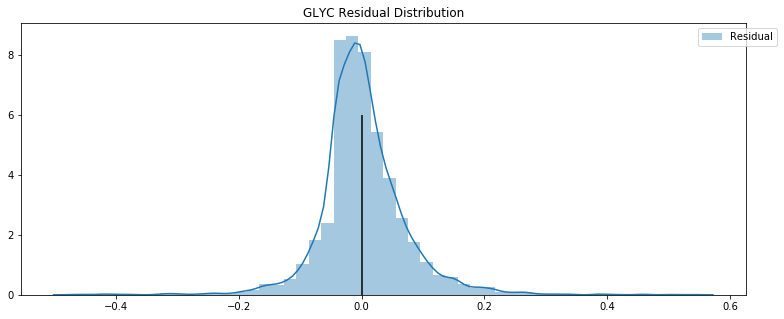

RYTM -0.01443835573735952 -0.0008775760427972568


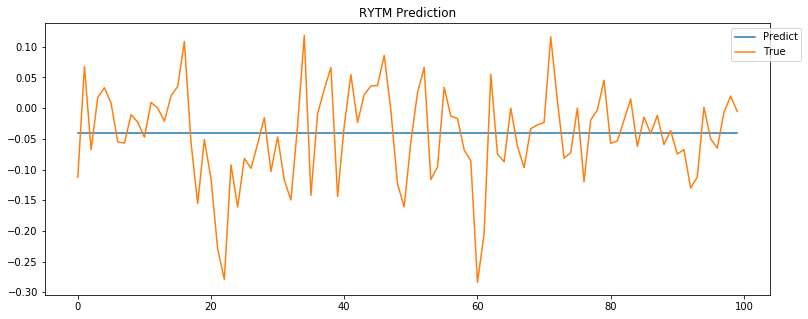

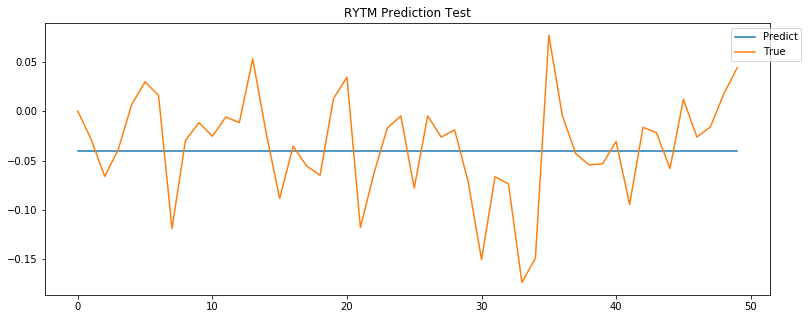

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


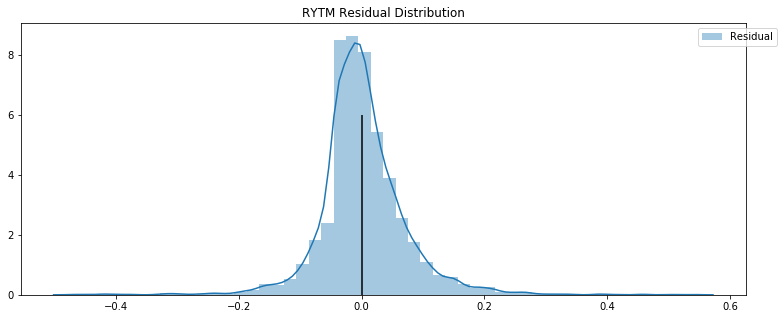

FIXX -0.01443835573735952 -0.0008775760427972568


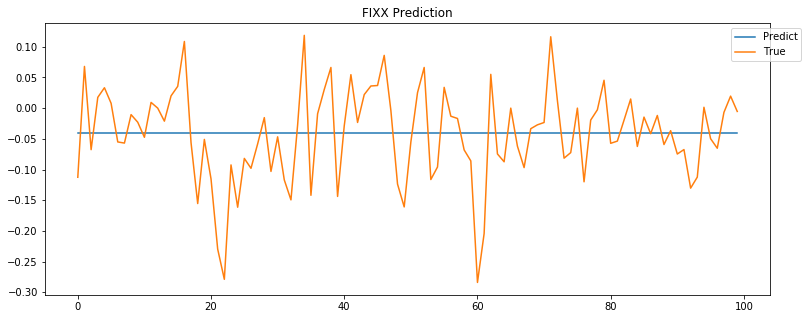

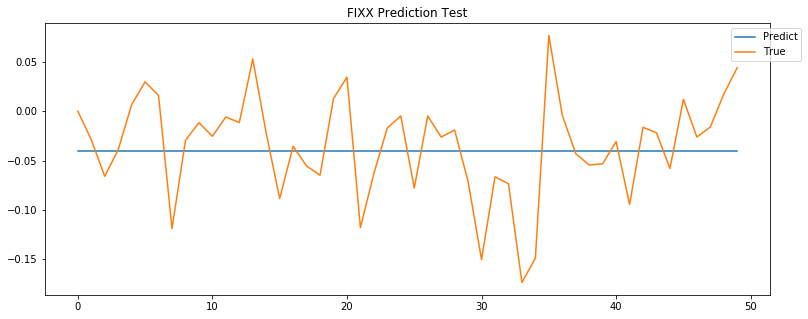

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


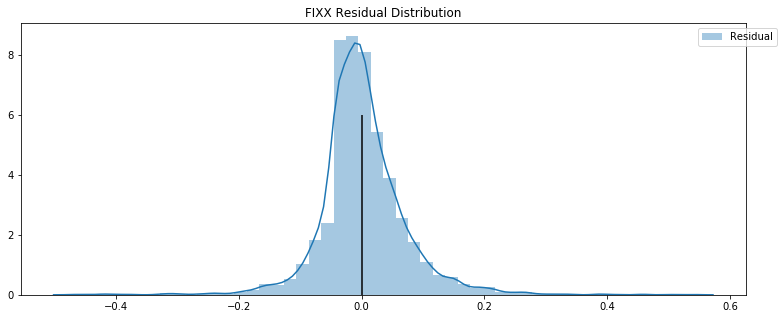

DRNA -0.01443835573735952 -0.0008775760427972568


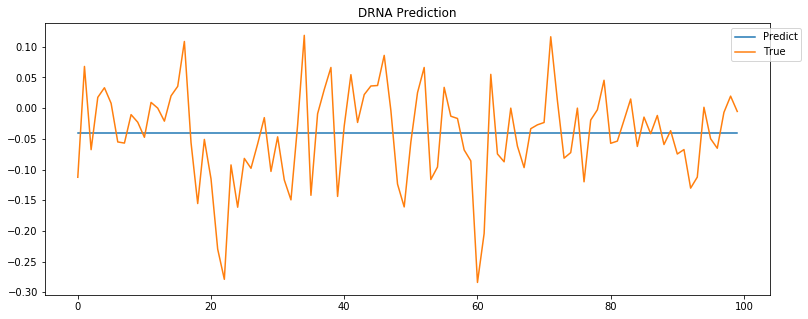

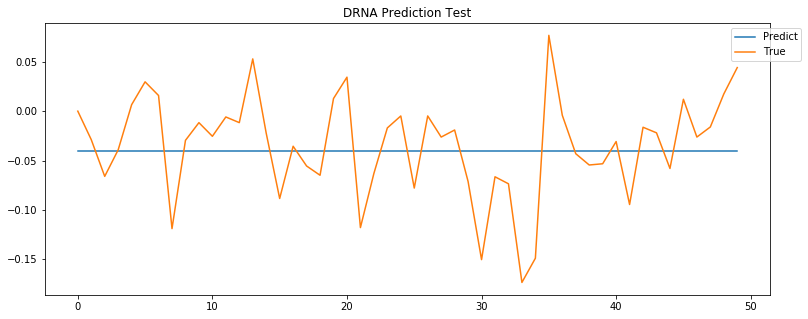

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


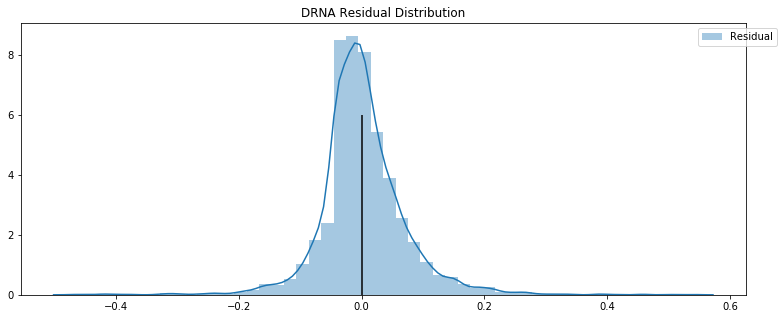

ARWR -0.01443835573735952 -0.0008775760427972568


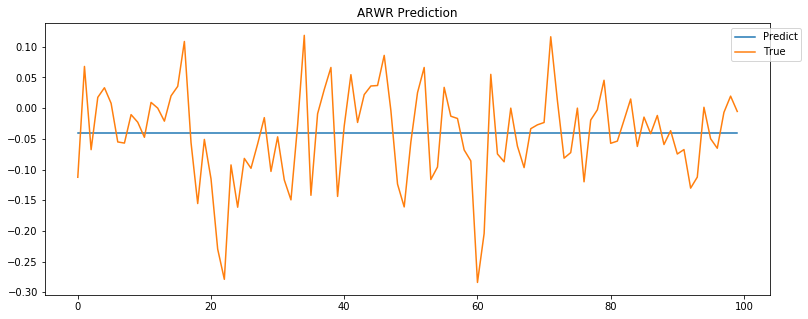

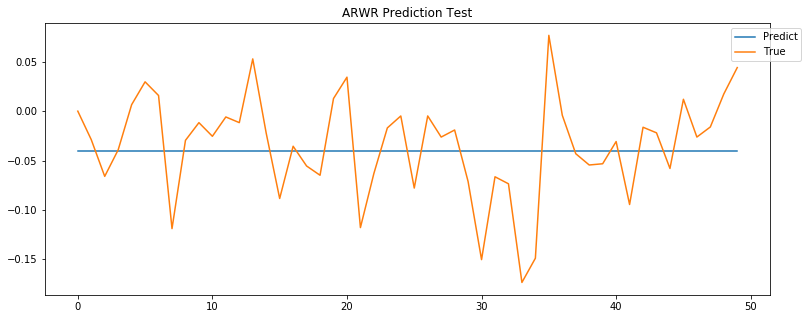

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


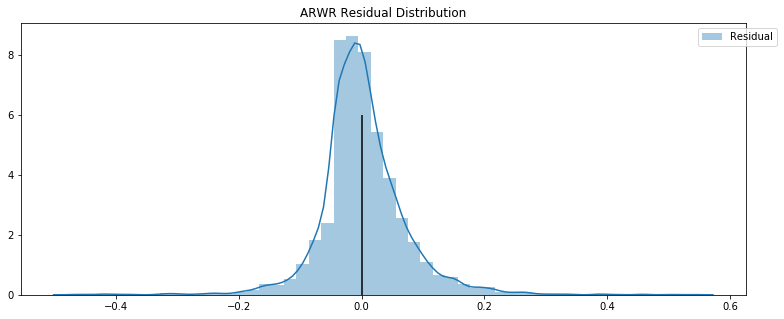

ALLK -0.01443835573735952 -0.0008775760427972568


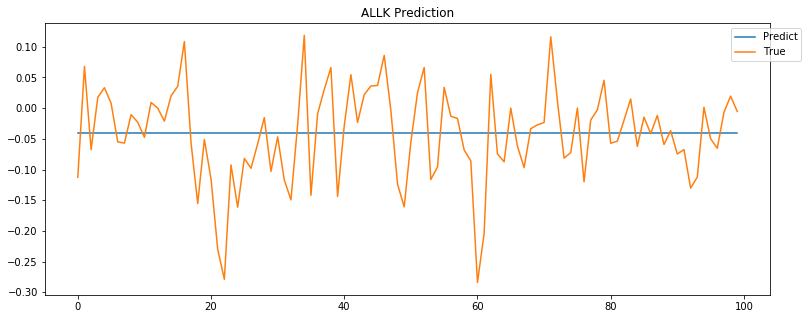

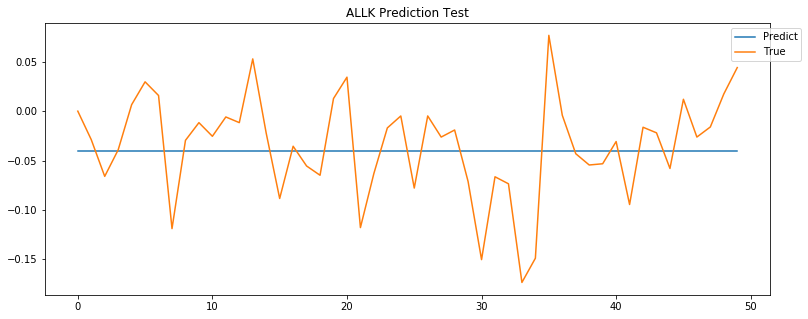

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


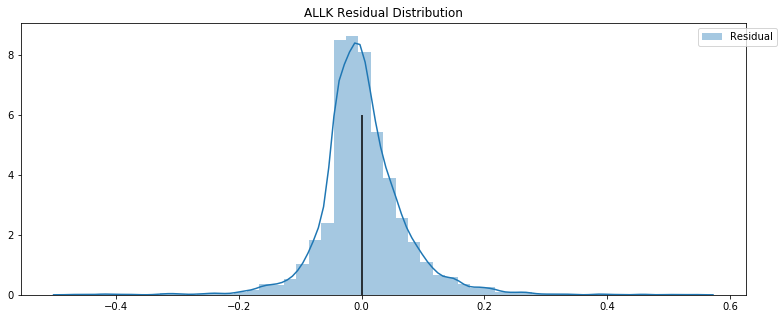

GOSS -0.01443835573735952 -0.0008775760427972568


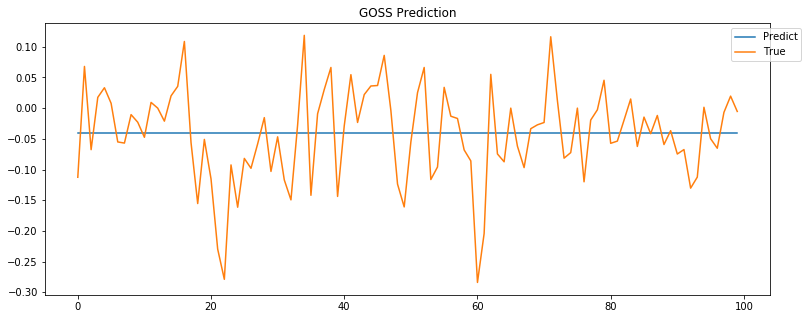

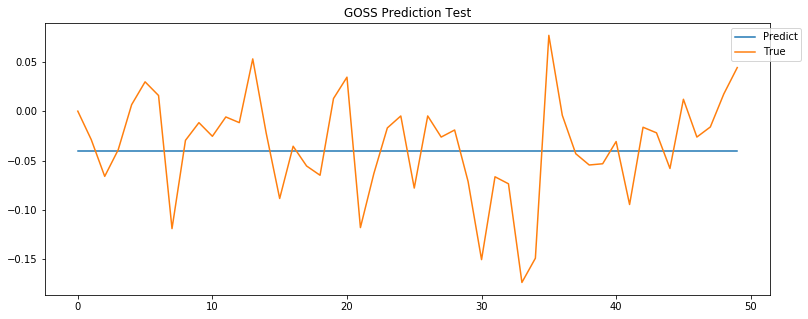

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


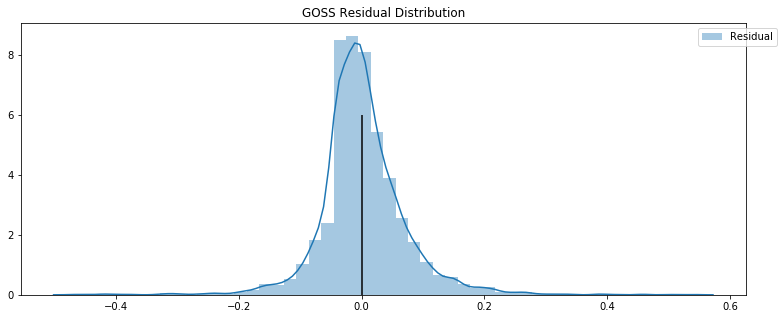

WVE -0.01443835573735952 -0.0008775760427972568


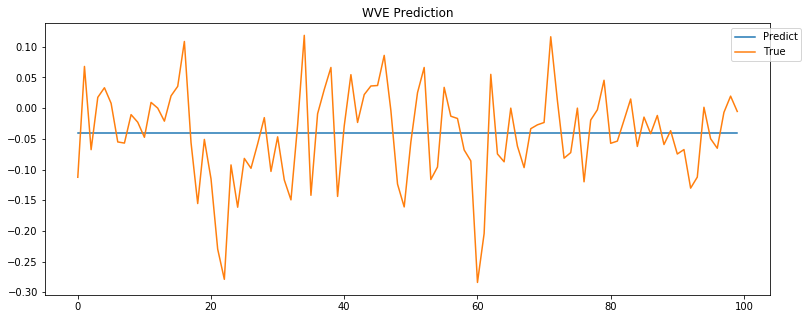

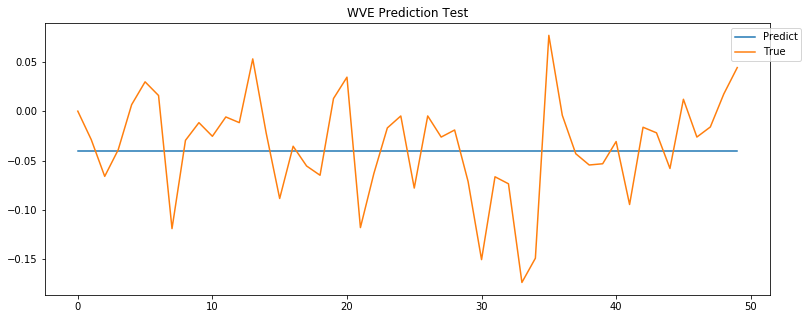

C:\Users\FlatIron_User\.conda\envs\learn-env12_12_19\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


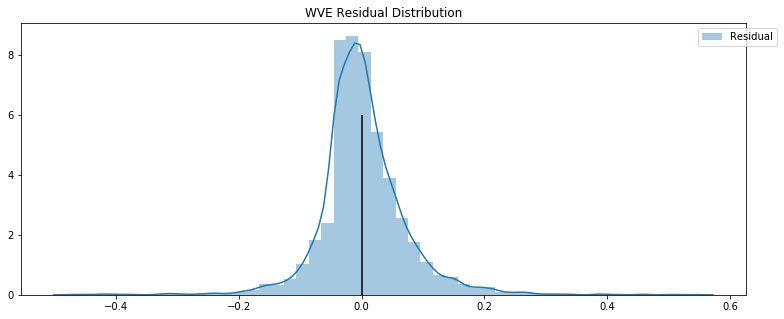

In [25]:
for stock in stocks:
    predict_train = model.predict(feature_train, batch_size=25)
    predict_test = model.predict(feature_test, batch_size=25)
    print(stock,r2_score(label_test, predict_test), r2_score(label_train, predict_train))
    plt.figure(figsize=(13,5))
    plt.title(f"{stock} Prediction")
    plt.plot(predict_train[-100:], label = 'Predict')
    plt.plot(label_train[-100:], label= 'True')
    plt.legend(bbox_to_anchor=(1.05, 1))
    plt.show()

    plt.figure(figsize=(13,5))
    plt.title(f"{stock} Prediction Test")
    plt.plot(predict_test[-100:], label = 'Predict')
    plt.plot(label_test[-100:], label= 'True')
    plt.legend(bbox_to_anchor=(1.05, 1))
    plt.show()
    plt.figure(figsize=(13,5))
    plt.title(f"{stock} Residual Distribution")
    sns.distplot(predict_train- label_train, label = 'Residual')
    plt.vlines(0,0,6)
    plt.legend(bbox_to_anchor=(1.05, 1))
    plt.show()